# Importing Libraries

In [1]:
!pip install datasets

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 527.3/527.3 kB 8.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 9.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 39.9/39.9 MB 12.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 7.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 194.1/194.1 kB 12.2 MB/s eta 0:00:00
  Attempting uninstall: pyarrow
    Found existing installation: pyarrow 14.0.2
    Uninstalling pyarrow-14.0.2:
      Successfully uninstalled pyarrow-14.0.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
cudf-cu12 24.4.1 requires pyarrow<15.0.0a0,>=14.0.1, but you have pyarrow 17.0.0 which is incompatible.
ibis-framework 8.0.0 requires pyarrow<16,>=2, but you have pyarrow 17.0.0 which is incompatible.


In [ ]:
pip install wrds

In [1]:
import pandas as pd
#import wrds
import plotly.express as px
import numpy as np
import nltk
nltk.download('stopwords')

import nltk
from wordcloud import WordCloud
import matplotlib.pyplot as plt
from sklearn.feature_extraction.text import CountVectorizer
from nltk.corpus import stopwords

import os
import torch
from transformers import DistilBertTokenizer, DistilBertForSequenceClassification, BertTokenizer, BertForSequenceClassification
from transformers import Trainer, TrainingArguments
#from datasets import load_metric
from sklearn.metrics import accuracy_score
from transformers import RobertaTokenizer, RobertaForSequenceClassification
from transformers import EarlyStoppingCallback
from transformers import AutoTokenizer, AutoModelForSequenceClassification
from tqdm import tqdm

import warnings
warnings.filterwarnings('ignore')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


In [ ]:
# Connect to WRDS
conn = wrds.Connection()

Enter your WRDS username [root]:abhishek_0598
Enter your password:··········
WRDS recommends setting up a .pgpass file.
Create .pgpass file now [y/n]?: y
Created .pgpass file successfully.
You can create this file yourself at any time with the create_pgpass_file() function.
Loading library list...
Done


**{user_specified_path} - Replace this with user custom path**

In [2]:
base_path = '{user_specified_path}'

#CRSP
1. In sample data
2. Out sample data

**CRSP insample data**

In [ ]:
# date ranges
estimation_start_date = '2005-01-01'
estimation_end_date = '2015-12-31'
out_sample_start_date = '2016-01-01'
end_date = '2023-12-31'

# SIC range for the finance sector
sic_range_start = '6000'
sic_range_end = '6499'

Querying using WRDS API

In [ ]:
# CRSP data for the estimation period
crsp_estimation_data = conn.raw_sql(f"""
    SELECT a.cusip, a.permno, a.permco, b.comnam, b.ticker, a.hsiccd, a.date, a.prc, a.vol, a.cfacpr, a.shrout, a.ret, a.retx
    FROM crsp.dsf a
    JOIN crsp.dsenames b
    ON a.permno = b.permno
    WHERE b.siccd BETWEEN '{sic_range_start}' AND '{sic_range_end}' AND a.date BETWEEN '{estimation_start_date}' AND '{estimation_end_date}'
""")


*  Calculating Market Capitalization by each ticker.
*  Selecting Top 25 ticker based on Market Capitalization.



In [ ]:
# Calculate market capitalization
crsp_estimation_data['market_cap'] = crsp_estimation_data['prc'] * crsp_estimation_data['shrout']

# Group by permno and ticker, and calculate average market cap
company_market_cap = crsp_estimation_data.groupby(['permno', 'ticker']).agg(
    market_cap=('market_cap', 'mean'),
    comnam=('comnam', 'first')  # Assuming 'comnam' is constant for each permno-ticker combination
).reset_index()

# Find the most recent ticker for each permno (optional step if multiple tickers exist for the same permno)
company_market_cap = company_market_cap.sort_values(by=['permno', 'ticker']).drop_duplicates(subset=['permno'], keep='last')

# Select the top 25 companies based on market capitalization
top_25_companies = company_market_cap.nlargest(30, 'market_cap')

# Ensure uniqueness of permno and ticker
top_25_companies_unique = top_25_companies.drop_duplicates(subset=['permno'])

# Extract permno, ticker, and company name separately
top_25_permnos = top_25_companies_unique['permno'].tolist()
top_25_tickers = top_25_companies_unique['ticker'].tolist()
top_25_company_names = top_25_companies_unique['comnam'].tolist()

# Create a DataFrame for easier viewing
top_25_data = pd.DataFrame({
    'permno': top_25_permnos,
    'ticker': top_25_tickers,
    'company_name': top_25_company_names
})

# Filter the original estimation dataset to include only the top 25 unique companies
top_25_estimation_data = crsp_estimation_data[
    crsp_estimation_data['permno'].isin(top_25_permnos)
]

# Display the top 25 companies data
print("Top 25 Companies by Market Capitalization:")
print(top_25_data)


Top 25 Companies by Market Capitalization:
    permno ticker                      company_name
0    47896    JPM               JPMORGAN CHASE & CO
1    38703    WFC              WELLS FARGO & CO NEW
2    59408    BAC              BANK OF AMERICA CORP
3    70519    TRV               TRAVELERS GROUP INC
4    17778    BRK        BERKSHIRE HATHAWAY INC DEL
5    66800    AIG  AMERICAN INTERNATIONAL GROUP INC
6    83443    BRK        BERKSHIRE HATHAWAY INC DEL
7    36469     WB             WACHOVIA CORP 2ND NEW
8    88239    UBS                          U B S AG
9    82654     RY    ROYAL BANK CANADA MONTREAL QUE
10   15054    UBS                   U B S GROUP A G
11   86868     GS           GOLDMAN SACHS GROUP INC
12   92611      V                          VISA INC
13   59176    AXP               AMERICAN EXPRESS CO
14   92655    UNH            UNITEDHEALTH GROUP INC
15   83835     TD         TORONTO DOMINION BANK ONT
16   66157    USB                   U S BANCORP DEL
17   52919    MER    

In [ ]:
# Filter the original estimation dataset to include only the top 25 companies
top_25_estimation_data = crsp_estimation_data[crsp_estimation_data['permno'].isin(top_25_permnos)]

In [ ]:
top_25_estimation_data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 568919 entries, 494051 to 154233
Data columns (total 14 columns):
 #   Column      Non-Null Count   Dtype  
---  ------      --------------   -----  
 0   cusip       568919 non-null  object 
 1   permno      568919 non-null  int64  
 2   permco      568919 non-null  int64  
 3   comnam      568919 non-null  object 
 4   ticker      568919 non-null  object 
 5   hsiccd      568919 non-null  int64  
 6   date        568919 non-null  object 
 7   prc         568919 non-null  float64
 8   vol         568855 non-null  float64
 9   cfacpr      568919 non-null  float64
 10  shrout      568919 non-null  float64
 11  ret         568914 non-null  float64
 12  retx        568914 non-null  float64
 13  market_cap  568919 non-null  float64
dtypes: float64(7), int64(3), object(4)
memory usage: 65.1+ MB


Handling Null Values

In [ ]:
top_25_estimation_data = top_25_estimation_data.dropna()

In [ ]:
# Drop duplicates from the key_dev DataFrame based on all columns
top_25_estimation_data.drop_duplicates(inplace=True)

In [ ]:
top_25_estimation_data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 136931 entries, 494054 to 154233
Data columns (total 14 columns):
 #   Column      Non-Null Count   Dtype  
---  ------      --------------   -----  
 0   cusip       136931 non-null  object 
 1   permno      136931 non-null  int64  
 2   permco      136931 non-null  int64  
 3   comnam      136931 non-null  object 
 4   ticker      136931 non-null  object 
 5   hsiccd      136931 non-null  int64  
 6   date        136931 non-null  object 
 7   prc         136931 non-null  float64
 8   vol         136931 non-null  float64
 9   cfacpr      136931 non-null  float64
 10  shrout      136931 non-null  float64
 11  ret         136931 non-null  float64
 12  retx        136931 non-null  float64
 13  market_cap  136931 non-null  float64
dtypes: float64(7), int64(3), object(4)
memory usage: 15.7+ MB


In [ ]:
# top_25_estimation_data.to_csv("top_25_estimation_data.csv",index=False)

In [ ]:
top_25_estimation_data

,cusip,permno,permco,comnam,ticker,hsiccd,date,prc,vol,cfacpr,shrout,ret,retx,market_cap
494054,H4209710,15054,55100,U B S GROUP A G,UBS,6159,2014-12-01,17.90,450011.0,1.0,3384540.0,-0.005003,-0.005003,6.058327e+07
494057,H4209710,15054,55100,U B S GROUP A G,UBS,6159,2014-12-02,18.00,567380.0,1.0,3384540.0,0.005587,0.005587,6.092172e+07
494060,H4209710,15054,55100,U B S GROUP A G,UBS,6159,2014-12-03,18.11,798088.0,1.0,3384540.0,0.006111,0.006111,6.129402e+07
494063,H4209710,15054,55100,U B S GROUP A G,UBS,6159,2014-12-04,18.16,804024.0,1.0,3384540.0,0.002761,0.002761,6.146325e+07
494066,H4209710,15054,55100,U B S GROUP A G,UBS,6159,2014-12-05,18.19,837178.0,1.0,3384540.0,0.001652,0.001652,6.156478e+07
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
154225,91324P10,92655,7267,UNITED HEALTHCARE CORP,UNH,6324,2015-12-29,119.82,2027647.0,1.0,953108.0,0.012592,0.012592,1.142014e+08
154226,91324P10,92655,7267,UNITEDHEALTH GROUP INC,UNH,6324,2015-12-30,118.92,1747681.0,1.0,953108.0,-0.007511,-0.007511,1.133436e+08
154229,91324P10,92655,7267,UNITED HEALTHCARE CORP,UNH,6324,2015-12-30,118.92,1747681.0,1.0,953108.0,-0.007511,-0.007511,1.133436e+08
154230,91324P10,92655,7267,UNITEDHEALTH GROUP INC,UNH,6324,2015-12-31,117.64,2372492.0,1.0,953108.0,-0.010764,-0.010764,1.121236e+08


**CRSP out sample data**

In [ ]:
# CRSP data for the out-of-sample period
crsp_out_sample_data = conn.raw_sql(f"""
    SELECT a.cusip, a.permno, a.permco, b.comnam, b.ticker, a.hsiccd, a.date, a.prc, a.vol, a.cfacpr, a.shrout, a.ret, a.retx
    FROM crsp.dsf a
    JOIN crsp.dsenames b
    ON a.permno = b.permno
    WHERE b.siccd BETWEEN '{sic_range_start}' AND '{sic_range_end}' AND a.date BETWEEN '{out_sample_start_date}' AND '{end_date}'
""")

In [ ]:
# Convert date column to datetime format
crsp_out_sample_data['date'] = pd.to_datetime(crsp_out_sample_data['date'])

# Filter the out-of-sample dataset to include only the top 25 companies
top_25_out_sample_data = crsp_out_sample_data[crsp_out_sample_data['permno'].isin(top_25_permnos)]

In [ ]:
top_25_out_sample_data = top_25_out_sample_data.dropna()

In [ ]:
# Drop duplicates
top_25_out_sample_data.drop_duplicates(inplace=True)

In [ ]:
# Disconnect from WRDS
conn.close()

In [ ]:
top_25_estimation_data = top_25_estimation_data.sort_values(by='date')
top_25_out_sample_data = top_25_out_sample_data.sort_values(by='date')

In [ ]:
print("Top 25 Companies based on Market Capitalization during the Estimation Period:")
top_25_estimation_data

Top 25 Companies based on Market Capitalization during the Estimation Period:


,cusip,permno,permco,comnam,ticker,hsiccd,date,prc,vol,cfacpr,shrout,ret,retx,market_cap
331109,06414910,89428,43264,BANK OF NOVA SCOTIA,BNS,6021,2005-01-03,33.90,11600.0,1.0,1008718.0,0.001477,0.001477,3.419554e+07
149699,08467070,83443,540,BERKSHIRE HATHAWAY INC DEL,BRK,6331,2005-01-03,2899.00,13770.0,50.0,8054.0,-0.012602,-0.012602,2.334855e+07
274290,89116050,83835,29152,TORONTO DOMINION BANK ONT,TD,6021,2005-01-03,41.03,39300.0,2.0,656954.0,-0.015595,-0.015595,2.695482e+07
414491,38141G10,86868,35048,GOLDMAN SACHS GROUP INC,GS,6211,2005-01-03,104.95,4239100.0,1.0,484186.0,0.008747,0.008747,5.081532e+07
205454,46625H10,47896,20436,CHEMICAL NEW YORK CORP,CHL,6021,2005-01-03,39.15,14964400.0,1.0,3562463.0,0.003589,0.003589,1.394704e+08
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
105054,03675210,89179,42273,ANTHEM INC,ATH,6321,2015-12-31,139.44,706709.0,1.0,261070.0,-0.010783,-0.010783,3.640360e+07
308686,17296742,70519,20483,CITIGROUP INC,C,6021,2015-12-31,51.75,11281771.0,1.0,2978990.0,-0.010516,-0.010516,1.541627e+08
308696,17296742,70519,20483,CITIGROUP INC,CCI,6021,2015-12-31,51.75,11281771.0,1.0,2978990.0,-0.010516,-0.010516,1.541627e+08
154230,91324P10,92655,7267,UNITEDHEALTH GROUP INC,UNH,6324,2015-12-31,117.64,2372492.0,1.0,953108.0,-0.010764,-0.010764,1.121236e+08


In [ ]:
print("\nTop 25 Companies based on Market Capitalization during the Out-of-Sample Period:")
top_25_out_sample_data


Top 25 Companies based on Market Capitalization during the Out-of-Sample Period:


,cusip,permno,permco,comnam,ticker,hsiccd,date,prc,vol,cfacpr,shrout,ret,retx
148926,H4209710,15054,55100,U B S GROUP A G,UBS,6159,2016-01-04,19.13000,1936781.0,1.0,3758844.0,-0.012390,-0.012390
25407,90297330,66157,1645,U S BANCORP DEL,USB,6021,2016-01-04,41.48000,9258086.0,1.0,1749177.0,-0.027888,-0.027888
183785,46625H10,47896,20436,JPMORGAN CHASE & CO,JPM,6021,2016-01-04,63.62000,25393155.0,1.0,3681130.0,-0.029835,-0.036499
183792,46625H10,47896,20436,J P MORGAN CHASE & CO,JPM,6021,2016-01-04,63.62000,25393155.0,1.0,3681130.0,-0.029835,-0.036499
183795,46625H10,47896,20436,CHASE MANHATTAN CORP NEW,CMB,6021,2016-01-04,63.62000,25393155.0,1.0,3681130.0,-0.029835,-0.036499
...,...,...,...,...,...,...,...,...,...,...,...,...,...
372343,17296742,70519,20483,COMMERCIAL CREDIT GROUP INC,CCC,6021,2023-12-29,51.44000,13149408.0,1.0,1913882.0,-0.001553,-0.001553
372344,17296742,70519,20483,COMMERCIAL CREDIT CO,CCC,6021,2023-12-29,51.44000,13149408.0,1.0,1913882.0,-0.001553,-0.001553
449598,06050510,59408,3151,BANKAMERICA CORP NEW,BAC,6029,2023-12-29,33.67000,28060739.0,1.0,7913732.0,-0.006198,-0.006198
230348,46625H10,47896,20436,CHEMICAL NEW YORK CORP,CHL,6021,2023-12-29,170.10001,6435102.0,1.0,2891008.0,-0.001174,-0.001174


In [ ]:
# Save the filtered data to CSV files
top_25_estimation_data.to_csv(f'{base_path}/BM16_LLMs/Finance/data/top_25_estimation_data.csv', index=False)
top_25_out_sample_data.to_csv(f'{base_path}/BM16_LLMs/Finance/data/top_25_out_sample_data.csv', index=False)

# Extraction of GV Key

In [ ]:
conn = wrds.Connection()

Enter your WRDS username [root]:abhishek_0598
Enter your password:··········
WRDS recommends setting up a .pgpass file.
Create .pgpass file now [y/n]?: y
Created .pgpass file successfully.
You can create this file yourself at any time with the create_pgpass_file() function.
Loading library list...
Done


In [ ]:
conn.list_tables(library='crsp')

['acti',
 'asia',
 'asib',
 'asic',
 'asio',
 'asix',
 'bmdebt',
 'bmheader',
 'bmpaymts',
 'bmquotes',
 'bmyield',
 'bndprt06',
 'bndprt12',
 'bxcalind',
 'bxdlyind',
 'bxmthind',
 'bxquotes',
 'bxyield',
 'cap',
 'ccm_lookup',
 'ccm_qvards',
 'ccmxpf_linktable',
 'ccmxpf_lnkhist',
 'ccmxpf_lnkrng',
 'ccmxpf_lnkused',
 'comphead',
 'comphist',
 'compmaster',
 'contact_info',
 'core',
 'crsp_cik_map',
 'crsp_daily_data',
 'crsp_header',
 'crsp_monthly_data',
 'crsp_names',
 'crsp_portno_map',
 'crsp_ziman_daily_index',
 'crsp_ziman_monthly_index',
 'cs20yr',
 'cs5yr',
 'cs90d',
 'cst_hist',
 'daily_nav',
 'daily_nav_ret',
 'daily_returns',
 'dividends',
 'dport1',
 'dport2',
 'dport3',
 'dport4',
 'dport5',
 'dport6',
 'dport7',
 'dport8',
 'dport9',
 'dsbc',
 'dsbo',
 'dse',
 'dse62',
 'dse62delist',
 'dse62dist',
 'dse62exchdates',
 'dse62names',
 'dse62nasdin',
 'dse62shares',
 'dseall',
 'dseall62',
 'dsedelist',
 'dsedist',
 'dseexchdates',
 'dsenames',
 'dsenasdin',
 'dseshares',

In [ ]:
# Construct the SQL query
gvkey_query = f"""
    SELECT DISTINCT gvkey, lpermno, lpermco
    FROM crsp.ccm_lookup
    WHERE lpermno IN ({','.join(map(str, top_25_permnos))})
"""

# Execute the query
gvkey_data = conn.raw_sql(gvkey_query)

In [ ]:
gvkey_data

,gvkey,lpermno,lpermco
0,001447,59176.0,90.0
1,001487,66800.0,137.0
2,002019,49656.0,20265.0
3,002176,17778.0,540.0
4,002176,83443.0,540.0
5,002968,47896.0,20436.0
6,003243,70519.0,20483.0
7,003735,49680.0,20557.0
8,004601,51043.0,20695.0
9,004682,66157.0,1645.0


In [ ]:
gvkey_data_unique = gvkey_data.drop_duplicates()

Exporting GVKey Data

In [ ]:
#gvkey_data_unique.to_csv("gvkey_data_unique.csv",index=False)
gvkey_data_unique = pd.read_csv(f'{base_path}/BM16_LLMs/Finance/data/gvkey_data_unique.csv')

In [ ]:
gvkeys = gvkey_data_unique['gvkey'].tolist()

#Capital IQKD

In [ ]:
conn.list_tables(library='ciq_keydev')

['ciqkeydev',
 'ciqkeydevcategorytype',
 'ciqkeydeveventtype',
 'ciqkeydevobjectroletype',
 'ciqkeydevsplitinfo',
 'ciqkeydevstatus',
 'ciqkeydevtimezone',
 'ciqkeydevtoobjecttoeventtype',
 'ciqkeydevtosourcetype',
 'ciqsourcetype',
 'wrds_keydev',
 'wrds_keydev_div']

In [ ]:
# Define the date ranges
estimation_start_date = '2005-01-01'
estimation_end_date = '2015-12-31'
out_sample_start_date = '2016-01-01'
end_date = '2023-12-31'

In [ ]:
# key development data from ciq_keydev.wrds_keydev within the date ranges
keydev_data_estimation = conn.raw_sql(f"""
    SELECT *
    FROM ciq_keydev.wrds_keydev
    WHERE gvkey IN ({','.join("'" + str(gvkey) + "'" for gvkey in gvkeys)})
    AND announcedate BETWEEN '{estimation_start_date}' AND '{estimation_end_date}'
""")

keydev_data_out_sample = conn.raw_sql(f"""
    SELECT *
    FROM ciq_keydev.wrds_keydev
    WHERE gvkey IN ({','.join("'" + str(gvkey) + "'" for gvkey in gvkeys)})
    AND announcedate BETWEEN '{out_sample_start_date}' AND '{end_date}'
""")

In [ ]:
# Merge key development data with gvkey_data_unique to get lpermno and lpermco
merged_data_estimation = pd.merge(keydev_data_estimation, gvkey_data_unique, on='gvkey', how='left')
merged_data_out_sample = pd.merge(keydev_data_out_sample, gvkey_data_unique, on='gvkey', how='left')

In [ ]:
selected_columns = ['keydevid', 'companyid', 'companyname', 'headline', 'keydeveventtypeid', 'eventtype', 'announcedate', 'announcetime', 'mostimportantdateutc', 'gvkey','lpermco', 'lpermno']

In [ ]:
key_data_estimation = merged_data_estimation[selected_columns]
key_data_out_sample = merged_data_out_sample[selected_columns]

In [ ]:
# Convert date column to datetime format
key_data_estimation['announcedate'] = pd.to_datetime(key_data_estimation['announcedate'])
key_data_out_sample['announcedate'] = pd.to_datetime(key_data_out_sample['announcedate'])

<ipython-input-15-79f0325f5ad3>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  key_data_estimation['announcedate'] = pd.to_datetime(key_data_estimation['announcedate'])
<ipython-input-15-79f0325f5ad3>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  key_data_out_sample['announcedate'] = pd.to_datetime(key_data_out_sample['announcedate'])


In [ ]:
key_data_estimation = key_data_estimation.rename(columns={'lpermco': 'permco'})
key_data_estimation = key_data_estimation.rename(columns={'lpermno': 'permno'})

In [ ]:
key_data_out_sample = key_data_out_sample.rename(columns={'lpermco': 'permco'})
key_data_out_sample = key_data_out_sample.rename(columns={'lpermno': 'permno'})

In [ ]:
key_data_estimation.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 97941 entries, 0 to 97940
Data columns (total 12 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   keydevid              97941 non-null  float64       
 1   companyid             97941 non-null  float64       
 2   companyname           97941 non-null  object        
 3   headline              97941 non-null  object        
 4   keydeveventtypeid     97941 non-null  int64         
 5   eventtype             97941 non-null  object        
 6   announcedate          97941 non-null  datetime64[ns]
 7   announcetime          97941 non-null  object        
 8   mostimportantdateutc  97941 non-null  object        
 9   gvkey                 97941 non-null  int64         
 10  permco                97941 non-null  float64       
 11  permno                97941 non-null  float64       
dtypes: datetime64[ns](1), float64(4), int64(2), object(5)
memory usage: 9.0+ M

In [ ]:
key_data_out_sample.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 63851 entries, 0 to 63850
Data columns (total 12 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   keydevid              63851 non-null  float64       
 1   companyid             63851 non-null  float64       
 2   companyname           63851 non-null  object        
 3   headline              63851 non-null  object        
 4   keydeveventtypeid     63851 non-null  int64         
 5   eventtype             63851 non-null  object        
 6   announcedate          63851 non-null  datetime64[ns]
 7   announcetime          63851 non-null  object        
 8   mostimportantdateutc  63851 non-null  object        
 9   gvkey                 63851 non-null  int64         
 10  permco                63851 non-null  float64       
 11  permno                63851 non-null  float64       
dtypes: datetime64[ns](1), float64(4), int64(2), object(5)
memory usage: 5.8+ M

In [ ]:
key_data_estimation

,keydevid,companyid,companyname,headline,keydeveventtypeid,eventtype,announcedate,announcetime,mostimportantdateutc,gvkey,permco,permno
0,821433.0,92001.0,American Express Company,American Express Co. Appoints PricewaterhouseC...,150,Auditor Changes,2005-01-10,1960-01-01 00:00:00,2005-01-10 00:00:00,1447,90.0,59176.0
1,1041768.0,92001.0,American Express Company,"American Express Company, Q4 2004 Earnings Cal...",48,Earnings Calls,2005-01-14,1960-01-01 00:00:00,2005-01-24 22:00:00,1447,90.0,59176.0
2,64512652.0,92001.0,American Express Company,"American Express Co. to Report Q4, 2004 Result...",55,Earnings Release Date,2005-01-14,1960-01-01 00:00:00,2005-01-24 00:00:00,1447,90.0,59176.0
3,2143872.0,92001.0,American Express Company,Siebel Systems Inc. completed the acquisition ...,81,M&A Transaction Closings,2005-01-14,1960-01-01 00:00:00,2005-01-14 05:00:00,1447,90.0,59176.0
4,2143872.0,92001.0,American Express Company,Siebel Systems Inc. completed the acquisition ...,81,M&A Transaction Closings,2005-01-14,1960-01-01 00:00:00,2005-01-14 00:00:00,1447,90.0,59176.0
...,...,...,...,...,...,...,...,...,...,...,...,...
97936,319150896.0,38043467.0,Visa Inc.,TD Securities (USA) LLC has been added as a Co...,136,Public Offering Lead Underwriter Change,2015-12-09,1960-01-01 00:00:00,2015-12-09 05:00:00,179534,52983.0,92611.0
97937,319397482.0,38043467.0,Visa Inc.,Visa Mulls Acquisitions,3,Seeking Acquisitions/Investments,2015-12-11,1960-01-01 00:00:00,2015-12-11 05:00:00,179534,52983.0,92611.0
97938,319119813.0,38043467.0,Visa Inc.,Visa Inc. - Shareholder/Analyst Call,50,Shareholder/Analyst Calls,2015-12-11,1960-01-01 11:11:00,2016-02-03 16:30:00,179534,52983.0,92611.0
97939,320021079.0,38043467.0,Visa Inc.,"HSBC Bank Oman S.A.O.G., Investment Arm sold a...",81,M&A Transaction Closings,2015-12-20,1960-01-01 00:00:00,2015-12-20 00:00:00,179534,52983.0,92611.0


In [ ]:
key_data_estimation = key_data_estimation.drop_duplicates(subset=['companyid', 'headline', 'keydeveventtypeid', 'announcedate', 'announcetime', 'gvkey', 'permco', 'permno'])

In [ ]:
key_data_out_sample = key_data_out_sample.drop_duplicates(subset=['companyid', 'headline', 'keydeveventtypeid', 'announcedate', 'announcetime', 'gvkey', 'permco', 'permno'])

Exporting the processed CapitalIQ data

In [ ]:
keydev_data_estimation.to_csv(f'{base_path}/BM16_LLMs/Finance/data/key_data_estimation.csv')
keydev_data_out_sample.to_csv(f'{base_path}/BM16_LLMs/Finance/data/key_data_out_sample.csv')

<ipython-input-17-c09bbce0b6a4>:11: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.barplot(x='count', y='eventtype', data=event_counts, palette='viridis')


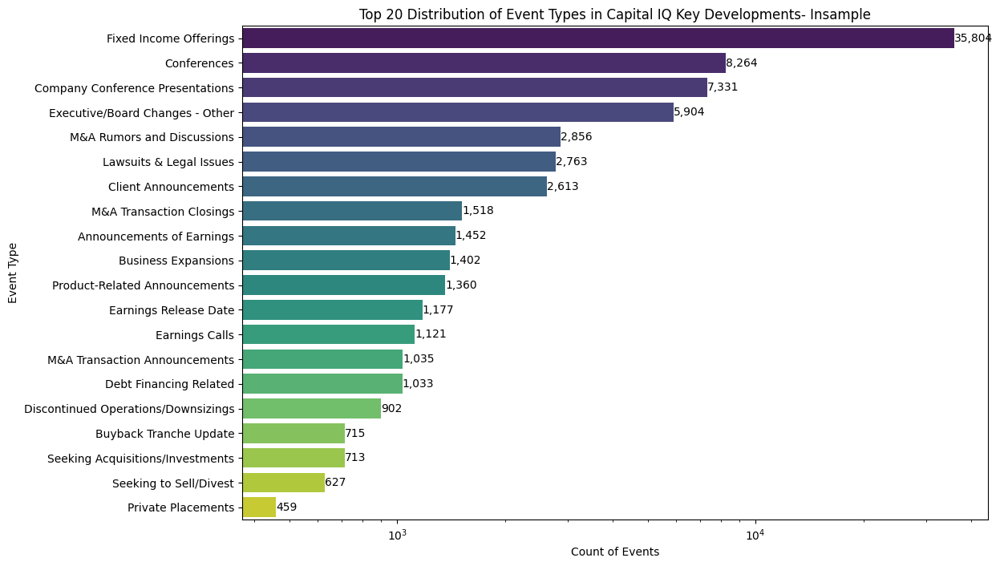

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming event_counts DataFrame is already defined as in your code
event_counts = key_data_estimation['eventtype'].value_counts().nlargest(20).reset_index()
event_counts.columns = ['eventtype', 'count']

# Plot using Matplotlib and Seaborn
plt.figure(figsize=(12, 8))
ax = sns.barplot(x='count', y='eventtype', data=event_counts, palette='viridis')

# Adding titles and labels
plt.title('Top 20 Distribution of Event Types in Capital IQ Key Developments- Insample')
plt.xlabel('Count of Events')
plt.ylabel('Event Type')

# Optional: Use a log scale for x-axis if counts vary widely
plt.xscale('log')

# Ensure the y-axis labels are sorted in descending order of counts
#plt.gca().invert_yaxis()

# Annotate each bar with the count value
for index, value in enumerate(event_counts['count']):
    ax.text(value, index, f'{value:,}', color='black', ha="left", va="center")

plt.show()


<ipython-input-18-0d2f5d114b8e>:7: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.barplot(x='count', y='eventtype', data=event_counts, palette='viridis')


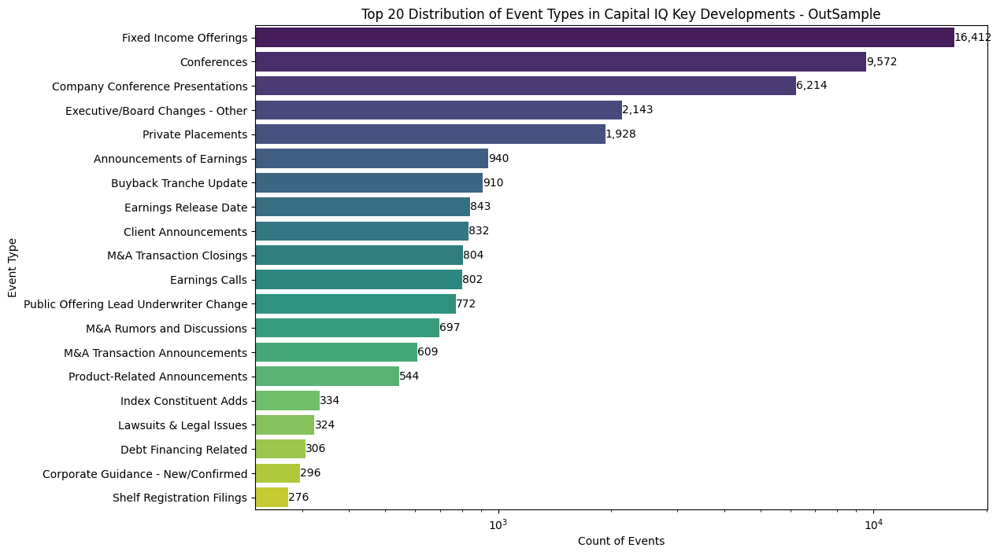

In [ ]:
# Calculating the top 20 most frequent event types
event_counts = key_data_out_sample['eventtype'].value_counts().nlargest(20).reset_index()
event_counts.columns = ['eventtype', 'count']

# Plot using Matplotlib and Seaborn
plt.figure(figsize=(12, 8))
ax = sns.barplot(x='count', y='eventtype', data=event_counts, palette='viridis')

# Adding titles and labels
plt.title('Top 20 Distribution of Event Types in Capital IQ Key Developments - OutSample')
plt.xlabel('Count of Events')
plt.ylabel('Event Type')

# Optional: Use a log scale for x-axis if counts vary widely
plt.xscale('log')

# Ensure the y-axis labels are sorted in descending order of counts
#plt.gca().invert_yaxis()

# Annotate each bar with the count value
for index, value in enumerate(event_counts['count']):
    ax.text(value, index, f'{value:,}', color='black', ha="left", va="center")

plt.show()

#Adjusted Prices + Weekly return + Price-Direction

In [ ]:
!pip uninstall wrds

In [ ]:
!pip install pandas==2.1.4

  Using cached pandas-2.0.3-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (12.3 MB)
  Attempting uninstall: pandas
    Found existing installation: pandas 2.2.2
    Uninstalling pandas-2.2.2:
      Successfully uninstalled pandas-2.2.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
cudf-cu12 24.4.1 requires pyarrow<15.0.0a0,>=14.0.1, but you have pyarrow 16.1.0 which is incompatible.
google-colab 1.0.0 requires requests==2.31.0, but you have requests 2.32.3 which is incompatible.
ibis-framework 8.0.0 requires pyarrow<16,>=2, but you have pyarrow 16.1.0 which is incompatible.


**Insample**

In [7]:
top_25_estimation_data

,cusip,permno,permco,comnam,ticker,hsiccd,date,prc,vol,cfacpr,shrout,ret,retx,market_cap
0,H4209710,15054,55100,U B S GROUP A G,UBS,6159,2014-12-01,17.90,450011.0,1.0,3384540.0,-0.005003,-0.005003,6.058327e+07
1,H4209710,15054,55100,U B S GROUP A G,UBS,6159,2014-12-02,18.00,567380.0,1.0,3384540.0,0.005587,0.005587,6.092172e+07
2,H4209710,15054,55100,U B S GROUP A G,UBS,6159,2014-12-03,18.11,798088.0,1.0,3384540.0,0.006111,0.006111,6.129402e+07
3,H4209710,15054,55100,U B S GROUP A G,UBS,6159,2014-12-04,18.16,804024.0,1.0,3384540.0,0.002761,0.002761,6.146325e+07
4,H4209710,15054,55100,U B S GROUP A G,UBS,6159,2014-12-05,18.19,837178.0,1.0,3384540.0,0.001652,0.001652,6.156478e+07
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
136926,91324P10,92655,7267,UNITED HEALTHCARE CORP,UNH,6324,2015-12-29,119.82,2027647.0,1.0,953108.0,0.012592,0.012592,1.142014e+08
136927,91324P10,92655,7267,UNITEDHEALTH GROUP INC,UNH,6324,2015-12-30,118.92,1747681.0,1.0,953108.0,-0.007511,-0.007511,1.133436e+08
136928,91324P10,92655,7267,UNITED HEALTHCARE CORP,UNH,6324,2015-12-30,118.92,1747681.0,1.0,953108.0,-0.007511,-0.007511,1.133436e+08
136929,91324P10,92655,7267,UNITEDHEALTH GROUP INC,UNH,6324,2015-12-31,117.64,2372492.0,1.0,953108.0,-0.010764,-0.010764,1.121236e+08


For in-sample data

*   Converting Returns to Weekly
*   Calculating Adjusted Price



In [ ]:
# Filter null and negative price and return
crsp_train_filtered = top_25_estimation_data[(top_25_estimation_data['prc'] > 0) & ~top_25_estimation_data['ret'].isna()]

# Calculate adjusted price
crsp_train_filtered['adj_prc'] = crsp_train_filtered['prc'] / crsp_train_filtered['cfacpr']

# Set date column to datetime type
crsp_train_filtered['date'] = pd.to_datetime(crsp_train_filtered['date'])

# Group by permco, ticker, and weekly frequency ending on Sunday
weekly_data = crsp_train_filtered.groupby(['permco', 'ticker', pd.Grouper(key='date', freq='W-FRI')]).agg({
    'adj_prc': lambda x: x.iloc[-1],  # Adjusted price at the end of the week
    'ret': (lambda x: (np.exp(np.sum(np.log(1 + x))) - 1) * 100)  # Weekly return calculation
}).reset_index()

# Rename columns for clarity
weekly_data.rename(columns={'date': 'end_date', 'ret': 'weekly_ret'}, inplace=True)

# Add start_date column (beginning of the week)
weekly_data['start_date'] = weekly_data['end_date'] - pd.DateOffset(days=4)

weekly_data_crsp_insample = weekly_data[['permco', 'ticker', 'start_date', 'end_date', 'weekly_ret', 'adj_prc']]


# Display the resulting DataFrame
weekly_data_crsp_insample


,permco,ticker,start_date,end_date,weekly_ret,adj_prc
0,90,AEXP,2005-01-03,2005-01-07,-4.419877,47.292762
1,90,AEXP,2005-01-10,2005-01-14,-1.934524,46.377872
2,90,AEXP,2005-01-17,2005-01-21,-1.498459,45.682908
3,90,AEXP,2005-01-24,2005-01-28,1.675448,46.448248
4,90,AEXP,2005-01-31,2005-02-04,5.719662,49.104948
...,...,...,...,...,...,...
21866,55100,UBS,2015-11-30,2015-12-04,2.398300,19.640000
21867,55100,UBS,2015-12-07,2015-12-11,-6.568228,18.350000
21868,55100,UBS,2015-12-14,2015-12-18,4.250775,19.130000
21869,55100,UBS,2015-12-21,2015-12-25,2.875043,19.680000


Calculating direction based on Adjusted Price

In [ ]:
# Calculate direction based on adjusted prices
weekly_data_crsp_insample['direction'] = weekly_data_crsp_insample['adj_prc'].diff().apply(lambda x: 'Down' if x < 0 else 'Up')

# Display the resulting DataFrame with direction
weekly_data_crsp_insample[['permco', 'ticker', 'start_date', 'end_date', 'weekly_ret', 'adj_prc', 'direction']]

<ipython-input-25-bea834cb9a4f>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  weekly_data_crsp_insample['direction'] = weekly_data_crsp_insample['adj_prc'].diff().apply(lambda x: 'Down' if x < 0 else 'Up')


,permco,ticker,start_date,end_date,weekly_ret,adj_prc,direction
0,90,AEXP,2005-01-03,2005-01-07,-4.419877,47.292762,Up
1,90,AEXP,2005-01-10,2005-01-14,-1.934524,46.377872,Down
2,90,AEXP,2005-01-17,2005-01-21,-1.498459,45.682908,Down
3,90,AEXP,2005-01-24,2005-01-28,1.675448,46.448248,Up
4,90,AEXP,2005-01-31,2005-02-04,5.719662,49.104948,Up
...,...,...,...,...,...,...,...
21866,55100,UBS,2015-11-30,2015-12-04,2.398300,19.640000,Up
21867,55100,UBS,2015-12-07,2015-12-11,-6.568228,18.350000,Down
21868,55100,UBS,2015-12-14,2015-12-18,4.250775,19.130000,Up
21869,55100,UBS,2015-12-21,2015-12-25,2.875043,19.680000,Up


In [ ]:
pip install kaleido

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.9/79.9 MB 7.1 MB/s eta 0:00:00


In [ ]:
import matplotlib.pyplot as plt
import plotly.graph_objs as go
import plotly.subplots as sp

weekly_data_crsp_insample['start_date'] = pd.to_datetime(weekly_data_crsp_insample['start_date'])

# Group the data by ticker
grouped_data = weekly_data_crsp_insample.groupby('ticker')

# Calculate the number of rows and columns for subplots
num_tickers = len(grouped_data)
cols = 2
rows = (num_tickers + cols - 1) // cols

# Create subplots
fig = sp.make_subplots(rows=rows, cols=cols, subplot_titles=[ticker for ticker, _ in grouped_data])

# Generate a list of unique colors
colors = np.random.rand(num_tickers, 3) * 255

# Iterate over each ticker group and assign a unique color
for idx, (ticker, data) in enumerate(grouped_data):
    row = idx // cols + 1
    col = idx % cols + 1

    # Create a trace for the ticker
    trace = go.Scatter(
        x=data['start_date'],
        y=data['weekly_ret'],
        mode='lines',
        name=ticker,
        line=dict(color=f'rgb({colors[idx][0]},{colors[idx][1]},{colors[idx][2]})')
    )

    # Add the trace to the subplots
    fig.add_trace(trace, row=row, col=col)

    # Add x-axis and y-axis titles
    fig.update_xaxes(title_text='Date', row=row, col=col)
    fig.update_yaxes(title_text='Weekly Return', row=row, col=col)

# Update layout
fig.update_layout(title='Weekly Returns by Ticker', height=rows * 400, showlegend=False)
# Export the plot as a PNG image file
#fig.write_image('weekly_returns_by_ticker.png', engine='kaleido')
# Show the plot
fig.show()

<ipython-input-24-2a23fd14545d>:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/usr/local/lib/python3.10/dist-packages/_plotly_utils/basevalidators.py:105: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



**Out-of-sample**

In [ ]:
top_25_out_sample_data

,cusip,permno,permco,comnam,ticker,hsiccd,date,prc,vol,cfacpr,shrout,ret,retx
0,H4209710,15054,55100,U B S GROUP A G,UBS,6159,2016-01-04,19.13000,1936781.0,1.0,3758844.0,-0.012390,-0.012390
1,90297330,66157,1645,U S BANCORP DEL,USB,6021,2016-01-04,41.48000,9258086.0,1.0,1749177.0,-0.027888,-0.027888
2,46625H10,47896,20436,JPMORGAN CHASE & CO,JPM,6021,2016-01-04,63.62000,25393155.0,1.0,3681130.0,-0.029835,-0.036499
3,46625H10,47896,20436,J P MORGAN CHASE & CO,JPM,6021,2016-01-04,63.62000,25393155.0,1.0,3681130.0,-0.029835,-0.036499
4,46625H10,47896,20436,CHASE MANHATTAN CORP NEW,CMB,6021,2016-01-04,63.62000,25393155.0,1.0,3681130.0,-0.029835,-0.036499
...,...,...,...,...,...,...,...,...,...,...,...,...,...
94559,17296742,70519,20483,COMMERCIAL CREDIT GROUP INC,CCC,6021,2023-12-29,51.44000,13149408.0,1.0,1913882.0,-0.001553,-0.001553
94560,17296742,70519,20483,COMMERCIAL CREDIT CO,CCC,6021,2023-12-29,51.44000,13149408.0,1.0,1913882.0,-0.001553,-0.001553
94561,06050510,59408,3151,BANKAMERICA CORP NEW,BAC,6029,2023-12-29,33.67000,28060739.0,1.0,7913732.0,-0.006198,-0.006198
94562,46625H10,47896,20436,CHEMICAL NEW YORK CORP,CHL,6021,2023-12-29,170.10001,6435102.0,1.0,2891008.0,-0.001174,-0.001174


For Out-of-Sample

*   Converting Returns to Weekly
*   Calculating Adjusted Price




In [ ]:
import pandas as pd
import numpy as np

# Filter null and negative price and return
crsp_train_filtered_out = top_25_out_sample_data[(top_25_out_sample_data['prc'] > 0) & ~top_25_out_sample_data['ret'].isna()]

# Calculate adjusted price
crsp_train_filtered_out['adj_prc'] = crsp_train_filtered_out['prc'] / crsp_train_filtered_out['cfacpr']

# Set date column to datetime type
crsp_train_filtered_out['date'] = pd.to_datetime(crsp_train_filtered_out['date'])

# Group by permco, ticker, and weekly frequency ending on Sunday
weekly_data_out = crsp_train_filtered_out.groupby(['permco', 'ticker', pd.Grouper(key='date', freq='W-FRI')]).agg({
    'adj_prc': lambda x: x.iloc[-1],  # Adjusted price at the end of the week
    'ret': (lambda x: (np.exp(np.sum(np.log(1 + x))) - 1) * 100)  # Weekly return calculation
}).reset_index()

# Rename columns for clarity
weekly_data_out.rename(columns={'date': 'end_date', 'ret': 'weekly_ret'}, inplace=True)

# Add start_date column (beginning of the week)
weekly_data_out['start_date'] = weekly_data_out['end_date'] - pd.DateOffset(days=4)

weekly_data_crsp_outsample = weekly_data_out[['permco', 'ticker', 'start_date', 'end_date', 'weekly_ret', 'adj_prc']]


# Display the resulting DataFrame
weekly_data_crsp_outsample


,permco,ticker,start_date,end_date,weekly_ret,adj_prc
0,90,AEXP,2016-01-04,2016-01-08,-8.099980,63.63
1,90,AEXP,2016-01-11,2016-01-15,-1.131492,62.91
2,90,AEXP,2016-01-18,2016-01-22,-12.478209,55.06
3,90,AEXP,2016-01-25,2016-01-29,-2.833278,53.50
4,90,AEXP,2016-02-01,2016-02-05,0.897152,53.98
...,...,...,...,...,...,...
15007,55100,UBS,2023-11-27,2023-12-01,8.925214,28.68
15008,55100,UBS,2023-12-04,2023-12-08,-0.592826,28.51
15009,55100,UBS,2023-12-11,2023-12-15,2.700904,29.28
15010,55100,UBS,2023-12-18,2023-12-22,5.498591,30.89


Calculating direction based on Adjusted Price




In [ ]:
# Calculate direction based on adjusted prices
weekly_data_crsp_outsample['direction'] = weekly_data_crsp_outsample['adj_prc'].diff().apply(lambda x: 'Down' if x < 0 else 'Up')

# Display the resulting DataFrame with direction
weekly_data_crsp_outsample[['permco', 'ticker', 'start_date', 'end_date', 'weekly_ret', 'adj_prc', 'direction']]

<ipython-input-28-616ccb7273f3>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  weekly_data_crsp_outsample['direction'] = weekly_data_crsp_outsample['adj_prc'].diff().apply(lambda x: 'Down' if x < 0 else 'Up')


,permco,ticker,start_date,end_date,weekly_ret,adj_prc,direction
0,90,AEXP,2016-01-04,2016-01-08,-8.099980,63.63,Up
1,90,AEXP,2016-01-11,2016-01-15,-1.131492,62.91,Down
2,90,AEXP,2016-01-18,2016-01-22,-12.478209,55.06,Down
3,90,AEXP,2016-01-25,2016-01-29,-2.833278,53.50,Down
4,90,AEXP,2016-02-01,2016-02-05,0.897152,53.98,Up
...,...,...,...,...,...,...,...
15007,55100,UBS,2023-11-27,2023-12-01,8.925214,28.68,Up
15008,55100,UBS,2023-12-04,2023-12-08,-0.592826,28.51,Down
15009,55100,UBS,2023-12-11,2023-12-15,2.700904,29.28,Up
15010,55100,UBS,2023-12-18,2023-12-22,5.498591,30.89,Up


In [ ]:
import matplotlib.pyplot as plt
import plotly.graph_objs as go
import plotly.subplots as sp

weekly_data_crsp_outsample['start_date'] = pd.to_datetime(weekly_data_crsp_outsample['start_date'])

# Group the data by ticker
grouped_data = weekly_data_crsp_outsample.groupby('ticker')

# Calculate the number of rows and columns for subplots
num_tickers = len(grouped_data)
cols = 2
rows = (num_tickers + cols - 1) // cols

# Create subplots
fig = sp.make_subplots(rows=rows, cols=cols, subplot_titles=[ticker for ticker, _ in grouped_data])

# Generate a list of unique colors
colors = np.random.rand(num_tickers, 3) * 255

# Iterate over each ticker group and assign a unique color
for idx, (ticker, data) in enumerate(grouped_data):
    row = idx // cols + 1
    col = idx % cols + 1

    # Create a trace for the ticker
    trace = go.Scatter(
        x=data['start_date'],
        y=data['weekly_ret'],
        mode='lines',
        name=ticker,
        line=dict(color=f'rgb({colors[idx][0]},{colors[idx][1]},{colors[idx][2]})')
    )

    # Add the trace to the subplots
    fig.add_trace(trace, row=row, col=col)

    # Add x-axis and y-axis titles
    fig.update_xaxes(title_text='Date', row=row, col=col)
    fig.update_yaxes(title_text='Weekly Return', row=row, col=col)

# Update layout
fig.update_layout(title='Weekly Returns by Ticker', height=rows * 400, showlegend=False)

# Show the plot
fig.show()

<ipython-input-28-309e9dd23e4c>:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/usr/local/lib/python3.10/dist-packages/_plotly_utils/basevalidators.py:105: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



####Summary Statistics of weekly returns

In [ ]:
combined_sample_x = pd.concat([weekly_data_crsp_insample, weekly_data_crsp_outsample], ignore_index=True)

In [ ]:
combined_sample_x['start_date'] = pd.to_datetime(combined_sample_x['start_date'])
combined_sample_x['end_date'] = pd.to_datetime(combined_sample_x['end_date'])

summary_stats = combined_sample_x.groupby('ticker')['weekly_ret'].agg(
    count='count',
    mean='mean',
    std='std',
    min='min',
    q25=lambda x: x.quantile(0.25),
    median='median',
    q75=lambda x: x.quantile(0.75),
    max='max'
).reset_index()

# Display the summary statistics
summary_stats

,ticker,count,mean,std,min,q25,median,q75,max
0,AEXP,991,0.273688,4.707664,-25.582353,-1.818987,0.289108,2.301402,28.831584
1,AIG,991,0.122048,9.212126,-68.286660,-2.083515,0.071490,2.360039,152.000170
2,ANTM,991,0.322135,4.203309,-29.842045,-1.796678,0.361373,2.536052,19.262111
3,ATH,991,0.322135,4.203309,-29.842045,-1.796678,0.361373,2.536052,19.262111
4,AXP,991,0.273688,4.707664,-25.582353,-1.818987,0.289108,2.301402,28.831584
5,BAC,991,0.849785,14.421749,-69.448681,-4.981202,0.263461,5.222955,236.500267
6,BK,991,0.533446,8.533764,-32.992520,-3.697728,0.263255,4.529113,68.217189
7,BMO,991,0.221938,3.572295,-24.223610,-1.377254,0.385253,1.988545,17.641751
8,BNS,991,0.177151,3.410057,-20.918577,-1.357331,0.263499,1.908281,16.167152
9,BRK,991,0.534627,5.837760,-33.617867,-2.565555,0.406146,3.248129,42.020819


#STEP - 3: WEEKLY FORECASTING

#### in sample

In [ ]:
weekly_data_crsp_insample.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21871 entries, 0 to 21870
Data columns (total 7 columns):
 #   Column      Non-Null Count  Dtype         
---  ------      --------------  -----         
 0   permco      21871 non-null  int64         
 1   ticker      21871 non-null  object        
 2   start_date  21871 non-null  datetime64[ns]
 3   end_date    21871 non-null  datetime64[ns]
 4   weekly_ret  21871 non-null  float64       
 5   adj_prc     21871 non-null  float64       
 6   direction   21871 non-null  object        
dtypes: datetime64[ns](2), float64(2), int64(1), object(2)
memory usage: 1.2+ MB


In [ ]:
key_data_estimation = key_data_estimation.sort_values(by=['announcedate'])

In [ ]:
key_data_estimation

,keydevid,companyid,companyname,headline,keydeveventtypeid,eventtype,announcedate,announcetime,mostimportantdateutc,gvkey,permco,permno
94892,5936823.0,160077.0,"Elevance Health, Inc.",WellPoint Inc. added to AMEX Institutional Index,95,Index Constituent Adds,2005-01-01,1960-01-01 00:00:00,2005-01-01 05:00:00,145046,42273.0,89179.0
30633,1023672.0,305304.0,U.S. Bancorp,"US Bancorp, Q4 2004 Earnings Call, Jan-18-2005",48,Earnings Calls,2005-01-03,1960-01-01 00:00:00,2005-01-18 19:00:00,4723,1645.0,66157.0
32233,809301.0,21803.0,"Merrill Lynch & Co., Inc.",Merrill Lynch & Co. Inc. Announces Appointment...,16,Executive/Board Changes - Other,2005-01-03,1960-01-01 00:00:00,2005-01-03 00:00:00,7267,21190.0,52919.0
2888,1032263.0,135506.0,The Bank of New York Mellon Corporation,The Bank of New York Mellon Corporation - Shar...,50,Shareholder/Analyst Calls,2005-01-03,1960-01-01 00:00:00,2005-01-25 18:30:00,2019,20265.0,49656.0
30634,64072724.0,305304.0,U.S. Bancorp,"US Bancorp (DE) to Report Q4, 2004 Results on ...",55,Earnings Release Date,2005-01-03,1960-01-01 00:00:00,2005-01-18 14:00:00,4723,1645.0,66157.0
...,...,...,...,...,...,...,...,...,...,...,...,...
60768,321227505.0,873647.0,The Bank of Nova Scotia,"Euromoney Seminars Ltd., 10th Anniversary Lati...",149,Conferences,2015-12-31,1960-01-01 08:42:00,2016-03-14 04:00:00,15582,43264.0,89428.0
60767,321219482.0,873647.0,The Bank of Nova Scotia,"Euromoney Seminars Ltd., IJGlobal, Asia Pacifi...",149,Conferences,2015-12-31,1960-01-01 08:38:00,2016-03-02 16:00:00,15582,43264.0,89428.0
60766,321127378.0,873647.0,The Bank of Nova Scotia,"InfraAmericas, 8th Annual Infrastructure Inves...",149,Conferences,2015-12-31,1960-01-01 09:11:00,2016-02-23 05:00:00,15582,43264.0,89428.0
28780,321126810.0,391687.0,Citigroup Inc.,"The Financial Times Ltd., Asia Investor Outloo...",149,Conferences,2015-12-31,1960-01-01 09:59:00,2016-01-26 16:00:00,3243,20483.0,70519.0


In [ ]:
key_data_estimation.info()

<class 'pandas.core.frame.DataFrame'>
Index: 85057 entries, 94892 to 2887
Data columns (total 12 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   keydevid              85057 non-null  float64       
 1   companyid             85057 non-null  float64       
 2   companyname           85057 non-null  object        
 3   headline              85057 non-null  object        
 4   keydeveventtypeid     85057 non-null  int64         
 5   eventtype             85057 non-null  object        
 6   announcedate          85057 non-null  datetime64[ns]
 7   announcetime          85057 non-null  object        
 8   mostimportantdateutc  85057 non-null  object        
 9   gvkey                 85057 non-null  int64         
 10  permco                85057 non-null  float64       
 11  permno                85057 non-null  float64       
dtypes: datetime64[ns](1), float64(4), int64(2), object(5)
memory usage: 10.5+ MB

Merging CRSP data with Capital IQ on weekly basis. (insample)

In [ ]:
from datetime import timedelta
import pandas as pd

# Assuming 'key_data_estimation' and 'weekly_data_crsp_insample' are your input DataFrames

# Step 1: Prepare the Key Development Data
key_data_estimation['announcedate'] = pd.to_datetime(key_data_estimation['announcedate'])
key_data_estimation['fri_of_week'] = key_data_estimation['announcedate'].dt.to_period('W-FRI').apply(lambda r: r.end_time).dt.date
key_data_estimation['next_fri_of_week'] = key_data_estimation['fri_of_week'] + timedelta(days=7)
key_data_estimation['next_fri_of_week'] = key_data_estimation['next_fri_of_week'].astype(str)

# Step 2: Prepare the CRSP Weekly Data
weekly_data_crsp_insample['end_date'] = pd.to_datetime(weekly_data_crsp_insample['end_date'])
weekly_data_crsp_insample['fri_of_week'] = weekly_data_crsp_insample['end_date'].dt.to_period('W-FRI').apply(lambda r: r.end_time).dt.date.astype(str)

# Step 3: Merge the Key Development Data with the CRSP Weekly Data
merged_data = pd.merge(weekly_data_crsp_insample, key_data_estimation,
                       left_on=['permco', 'fri_of_week'],
                       right_on=['permco', 'next_fri_of_week'],
                       how='left')

# Step 4: Fill Missing Headlines with 'No_Headlines'
merged_data['headline'] = merged_data['headline'].fillna('No_Headlines')

# Step 5: Select and reorder columns
in_sample_structured = merged_data[['permco', 'ticker', 'start_date', 'end_date', 'announcedate', 'weekly_ret', 'adj_prc', 'headline', 'direction']]

# Display the resulting DataFrame
in_sample_structured


<ipython-input-35-e178e392f843>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  weekly_data_crsp_insample['end_date'] = pd.to_datetime(weekly_data_crsp_insample['end_date'])
<ipython-input-35-e178e392f843>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  weekly_data_crsp_insample['fri_of_week'] = weekly_data_crsp_insample['end_date'].dt.to_period('W-FRI').apply(lambda r: r.end_time).dt.date.astype(str)


,permco,ticker,start_date,end_date,announcedate,weekly_ret,adj_prc,headline,direction
0,90,AEXP,2005-01-03,2005-01-07,NaT,-4.419877,47.292762,No_Headlines,Up
1,90,AEXP,2005-01-10,2005-01-14,NaT,-1.934524,46.377872,No_Headlines,Down
2,90,AEXP,2005-01-17,2005-01-21,2005-01-10,-1.498459,45.682908,American Express Co. Appoints PricewaterhouseC...,Down
3,90,AEXP,2005-01-17,2005-01-21,2005-01-14,-1.498459,45.682908,"American Express Company, Q4 2004 Earnings Cal...",Down
4,90,AEXP,2005-01-17,2005-01-21,2005-01-14,-1.498459,45.682908,"American Express Co. to Report Q4, 2004 Result...",Down
...,...,...,...,...,...,...,...,...,...
144642,55100,UBS,2015-12-14,2015-12-18,2015-12-08,4.250775,19.130000,Postal Savings Bank of China Corporation Limit...,Up
144643,55100,UBS,2015-12-14,2015-12-18,2015-12-10,4.250775,19.130000,"Deutsche Bank Securities Inc., DbAccess German...",Up
144644,55100,UBS,2015-12-14,2015-12-18,2015-12-10,4.250775,19.130000,"Postal Savings Bank of China Co., Ltd. announc...",Up
144645,55100,UBS,2015-12-21,2015-12-25,NaT,2.875043,19.680000,No_Headlines,Up


####**out-sample**

In [ ]:
key_data_out_sample

,keydevid,companyid,companyname,headline,keydeveventtypeid,eventtype,announcedate,announcetime,mostimportantdateutc,gvkey,permco,permno
0,3.213183e+08,92001.0,American Express Company,"American Express Company, Q4 2015 Earnings Cal...",48,Earnings Calls,2016-01-05,1960-01-01 15:35:00,2016-01-21 22:00:00,1447,90.0,59176.0
1,3.213189e+08,92001.0,American Express Company,"American Express Company to Report Q4, 2015 Re...",55,Earnings Release Date,2016-01-05,1960-01-01 15:35:00,2016-01-21 22:00:00,1447,90.0,59176.0
2,3.216751e+08,92001.0,American Express Company,"Keefe, Bruyette, & Woods, Inc., Keefe, Bruyett...",149,Conferences,2016-01-07,1960-01-01 09:06:00,2016-02-22 05:00:00,1447,90.0,59176.0
3,3.220368e+08,92001.0,American Express Company,"William Blair & Company, L.L.C., the William B...",149,Conferences,2016-01-13,1960-01-01 06:52:00,2016-06-14 05:00:00,1447,90.0,59176.0
4,3.227830e+08,92001.0,American Express Company,American Express Company Reports Consolidated ...,28,Announcements of Earnings,2016-01-21,1960-01-01 21:14:00,2016-01-21 21:14:00,1447,90.0,59176.0
...,...,...,...,...,...,...,...,...,...,...,...,...
63843,1.864737e+09,38043467.0,Visa Inc.,"Clarion Events Limited, Transport Ticketing Gl...",149,Conferences,2023-12-13,1960-01-01 05:26:00,2024-03-05 05:00:00,179534,52983.0,92611.0
63845,1.864786e+09,38043467.0,Visa Inc.,Visa Provisioning Intelligence Launches to Com...,41,Product-Related Announcements,2023-12-13,1960-01-01 14:00:00,2023-12-13 14:00:00,179534,52983.0,92611.0
63846,1.865365e+09,38043467.0,Visa Inc.,"JPMorgan Chase & Co., the 52nd J.P. Morgan Ann...",149,Conferences,2023-12-14,1960-01-01 00:00:00,2024-05-20 04:00:00,179534,52983.0,92611.0
63847,1.865145e+09,38043467.0,Visa Inc.,Visa Inc. (NYSE:V) entered into a definitive a...,80,M&A Transaction Announcements,2023-12-15,1960-01-01 00:00:00,2023-12-15 00:00:00,179534,52983.0,92611.0


In [ ]:
weekly_data_crsp_outsample.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 15012 entries, 0 to 15011
Data columns (total 7 columns):
 #   Column      Non-Null Count  Dtype         
---  ------      --------------  -----         
 0   permco      15012 non-null  int64         
 1   ticker      15012 non-null  object        
 2   start_date  15012 non-null  datetime64[ns]
 3   end_date    15012 non-null  datetime64[ns]
 4   weekly_ret  15012 non-null  float64       
 5   adj_prc     15012 non-null  float64       
 6   direction   15012 non-null  object        
dtypes: datetime64[ns](2), float64(2), int64(1), object(2)
memory usage: 821.1+ KB


Merging CRSP data with Capital IQ on weekly basis. (out-of-sample)

In [ ]:
from datetime import timedelta

# Step 1: Prepare the Key Development Data
key_data_out_sample['fri_of_week'] = key_data_out_sample['announcedate'].dt.to_period('W-FRI').apply(lambda r: r.end_time).dt.date
key_data_out_sample['next_fri_of_week'] = key_data_out_sample['fri_of_week'] + timedelta(days=7)
key_data_out_sample['next_fri_of_week'] = key_data_out_sample['next_fri_of_week'].astype(str)

# Step 2: Prepare the CRSP Weekly Data
weekly_data_crsp_outsample['end_date'] = pd.to_datetime(weekly_data_crsp_outsample['end_date'])
weekly_data_crsp_outsample['fri_of_week'] = weekly_data_crsp_outsample['end_date'].dt.to_period('W-FRI').apply(lambda r: r.end_time).dt.date.astype(str)

# Step 3: Merge the Key Development Data with the CRSP Weekly Data
merged_data = pd.merge(weekly_data_crsp_outsample, key_data_out_sample,
                       left_on=['permco', 'fri_of_week'],
                       right_on=['permco', 'next_fri_of_week'],
                       how='left')

# Step 4: Fill Missing Headlines with 'No_Headlines'
merged_data['headline'] = merged_data['headline'].fillna('No_Headlines')

# Step 5: Select and reorder columns
out_sample_structured = merged_data[['permco', 'ticker', 'start_date', 'end_date','announcedate', 'weekly_ret', 'adj_prc', 'headline', 'direction']]

# Display the resulting DataFrame
out_sample_structured


<ipython-input-38-ad6b64f4f2ad>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  weekly_data_crsp_outsample['end_date'] = pd.to_datetime(weekly_data_crsp_outsample['end_date'])
<ipython-input-38-ad6b64f4f2ad>:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  weekly_data_crsp_outsample['fri_of_week'] = weekly_data_crsp_outsample['end_date'].dt.to_period('W-FRI').apply(lambda r: r.end_time).dt.date.astype(str)


,permco,ticker,start_date,end_date,announcedate,weekly_ret,adj_prc,headline,direction
0,90,AEXP,2016-01-04,2016-01-08,NaT,-8.099980,63.63,No_Headlines,Up
1,90,AEXP,2016-01-11,2016-01-15,2016-01-05,-1.131492,62.91,"American Express Company, Q4 2015 Earnings Cal...",Down
2,90,AEXP,2016-01-11,2016-01-15,2016-01-05,-1.131492,62.91,"American Express Company to Report Q4, 2015 Re...",Down
3,90,AEXP,2016-01-11,2016-01-15,2016-01-07,-1.131492,62.91,"Keefe, Bruyette, & Woods, Inc., Keefe, Bruyett...",Down
4,90,AEXP,2016-01-18,2016-01-22,2016-01-13,-12.478209,55.06,"William Blair & Company, L.L.C., the William B...",Down
...,...,...,...,...,...,...,...,...,...
82023,55100,UBS,2023-12-25,2023-12-29,2023-12-17,0.032307,30.90,CRH plc (NYSE:CRH) agreed to acquire 57% stake...,Up
82024,55100,UBS,2023-12-25,2023-12-29,2023-12-17,0.032307,30.90,CRH plc (NYSE:CRH) agreed to acquire 57.3% sta...,Up
82025,55100,UBS,2023-12-25,2023-12-29,2023-12-18,0.032307,30.90,"Ledman Optoelectronic Co., Ltd. announced that...",Up
82026,55100,UBS,2023-12-25,2023-12-29,2023-12-19,0.032307,30.90,UBS Reportedly Wants to Sell Loans That Credit...,Up


In [ ]:
in_sample_structured = in_sample_structured.drop_duplicates(subset=['headline', 'announcedate', 'permco'])

In [ ]:
in_sample_structured

,permco,ticker,start_date,end_date,announcedate,weekly_ret,adj_prc,headline,direction
0,90,AEXP,2005-01-03,2005-01-07,NaT,-4.419877,47.292762,No_Headlines,Up
2,90,AEXP,2005-01-17,2005-01-21,2005-01-10,-1.498459,45.682908,American Express Co. Appoints PricewaterhouseC...,Down
3,90,AEXP,2005-01-17,2005-01-21,2005-01-14,-1.498459,45.682908,"American Express Company, Q4 2004 Earnings Cal...",Down
4,90,AEXP,2005-01-17,2005-01-21,2005-01-14,-1.498459,45.682908,"American Express Co. to Report Q4, 2004 Result...",Down
5,90,AEXP,2005-01-17,2005-01-21,2005-01-14,-1.498459,45.682908,Siebel Systems Inc. completed the acquisition ...,Down
...,...,...,...,...,...,...,...,...,...
144641,55100,UBS,2015-12-07,2015-12-11,2015-12-04,-6.568228,18.350000,UBS Group AG Presents at UBS 43rd Annual Globa...,Down
144642,55100,UBS,2015-12-14,2015-12-18,2015-12-08,4.250775,19.130000,Postal Savings Bank of China Corporation Limit...,Up
144643,55100,UBS,2015-12-14,2015-12-18,2015-12-10,4.250775,19.130000,"Deutsche Bank Securities Inc., DbAccess German...",Up
144644,55100,UBS,2015-12-14,2015-12-18,2015-12-10,4.250775,19.130000,"Postal Savings Bank of China Co., Ltd. announc...",Up


In [ ]:
out_sample_structured = out_sample_structured.drop_duplicates(subset=['headline', 'announcedate', 'permco'])

In [ ]:
out_sample_structured

,permco,ticker,start_date,end_date,announcedate,weekly_ret,adj_prc,headline,direction
0,90,AEXP,2016-01-04,2016-01-08,NaT,-8.099980,63.63,No_Headlines,Up
1,90,AEXP,2016-01-11,2016-01-15,2016-01-05,-1.131492,62.91,"American Express Company, Q4 2015 Earnings Cal...",Down
2,90,AEXP,2016-01-11,2016-01-15,2016-01-05,-1.131492,62.91,"American Express Company to Report Q4, 2015 Re...",Down
3,90,AEXP,2016-01-11,2016-01-15,2016-01-07,-1.131492,62.91,"Keefe, Bruyette, & Woods, Inc., Keefe, Bruyett...",Down
4,90,AEXP,2016-01-18,2016-01-22,2016-01-13,-12.478209,55.06,"William Blair & Company, L.L.C., the William B...",Down
...,...,...,...,...,...,...,...,...,...
82023,55100,UBS,2023-12-25,2023-12-29,2023-12-17,0.032307,30.90,CRH plc (NYSE:CRH) agreed to acquire 57% stake...,Up
82024,55100,UBS,2023-12-25,2023-12-29,2023-12-17,0.032307,30.90,CRH plc (NYSE:CRH) agreed to acquire 57.3% sta...,Up
82025,55100,UBS,2023-12-25,2023-12-29,2023-12-18,0.032307,30.90,"Ledman Optoelectronic Co., Ltd. announced that...",Up
82026,55100,UBS,2023-12-25,2023-12-29,2023-12-19,0.032307,30.90,UBS Reportedly Wants to Sell Loans That Credit...,Up


In [ ]:
# Save the filtered data to CSV files
in_sample_structured.to_csv(f'{base_path}/BM16_LLMs/Finance/data/in_sample_structured.csv', index=False)
out_sample_structured.to_csv(f'{base_path}/BM16_LLMs/Finance/data/out_sample_structured.csv', index=False)

#### News Count Analysis

<ipython-input-61-10097b629be0>:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  in_sample_structured['announcedate'] = pd.to_datetime(in_sample_structured['announcedate'])
<ipython-input-61-10097b629be0>:24: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=yearly_count.index, y=yearly_count.values, ax=axs[0], palette=colors_year)
<ipython-input-61-10097b629be0>:35: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=monthly_average_count.index, y=monthly

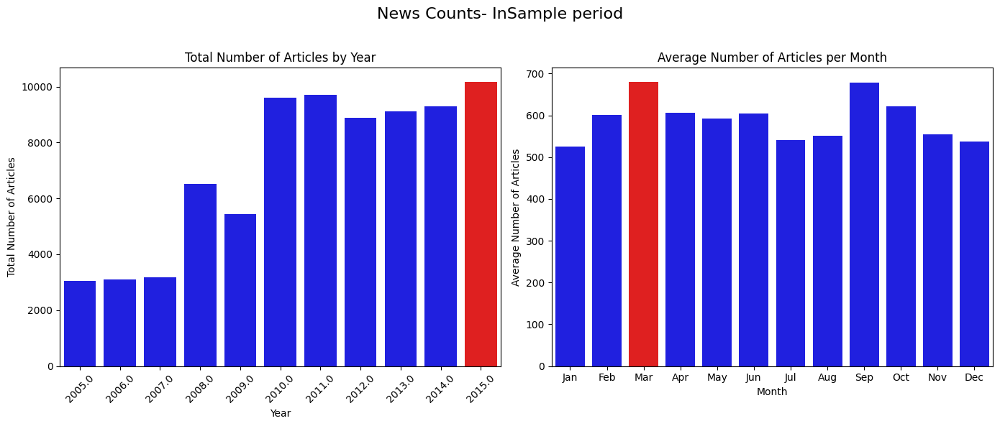

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming in_sample_structured is your DataFrame

# Convert 'announcedate' to datetime if not already done
in_sample_structured['announcedate'] = pd.to_datetime(in_sample_structured['announcedate'])

# Yearly News Count
yearly_count = in_sample_structured.groupby(in_sample_structured['announcedate'].dt.year).size()

# Monthly News Count
monthly_count = in_sample_structured.groupby(in_sample_structured['announcedate'].dt.to_period('M')).size()

# Calculate the average news count per month
monthly_average_count = monthly_count.groupby(monthly_count.index.month).mean()

# Setting up the figure and axes with only 1 row and 2 columns
fig, axs = plt.subplots(1, 2, figsize=(14, 6))

# Plotting Yearly News Count
colors_year = ['red' if value == yearly_count.max() else 'blue' for value in yearly_count.values]
sns.barplot(x=yearly_count.index, y=yearly_count.values, ax=axs[0], palette=colors_year)
axs[0].set_title('Total Number of Articles by Year')
axs[0].set_xlabel('Year')
axs[0].set_ylabel('Total Number of Articles')
axs[0].tick_params(axis='x', rotation=45)  # Tilt the years by 45 degrees

# Plotting Average Monthly News Count with Month Names
# Mapping month index to month names
month_names = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']
colors_month = ['red' if value == monthly_average_count.max() else 'blue' for value in monthly_average_count.values]

sns.barplot(x=monthly_average_count.index, y=monthly_average_count.values, ax=axs[1], palette=colors_month)
axs[1].set_title('Average Number of Articles per Month')
axs[1].set_xlabel('Month')
axs[1].set_ylabel('Average Number of Articles')

# Set month names as x-ticks
axs[1].set_xticklabels(month_names)

# Set the overall title
fig.suptitle('News Counts- InSample period', fontsize=16)

# Adjust layout for better spacing
plt.tight_layout(rect=[0, 0, 1, 0.96])

# Show the plot
plt.show()


<ipython-input-63-8eab9ea9f35e>:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  out_sample_structured['announcedate'] = pd.to_datetime(out_sample_structured['announcedate'])
<ipython-input-63-8eab9ea9f35e>:24: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=yearly_count.index, y=yearly_count.values, ax=axs[0], palette=colors_year)
<ipython-input-63-8eab9ea9f35e>:35: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=monthly_average_count.index, y=month

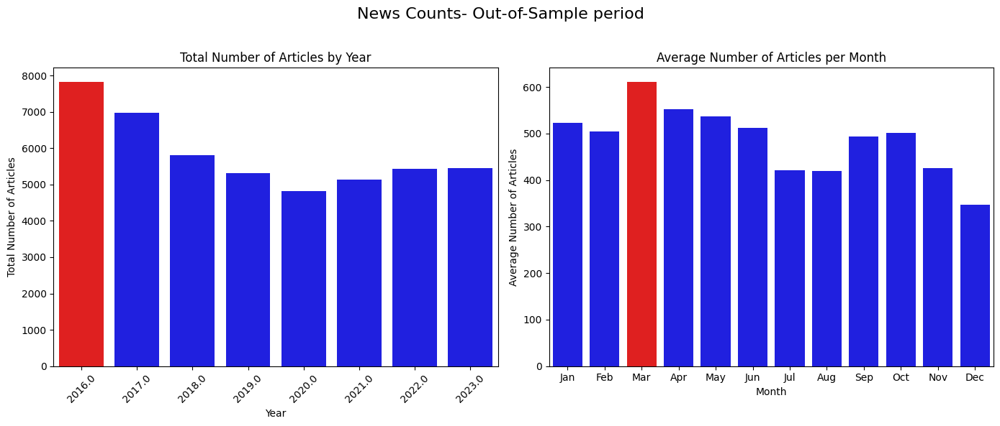

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Assuming in_sample_structured is your DataFrame

# Convert 'announcedate' to datetime if not already done
out_sample_structured['announcedate'] = pd.to_datetime(out_sample_structured['announcedate'])

# Yearly News Count
yearly_count = out_sample_structured.groupby(out_sample_structured['announcedate'].dt.year).size()

# Monthly News Count
monthly_count = out_sample_structured.groupby(out_sample_structured['announcedate'].dt.to_period('M')).size()

# Calculate the average news count per month
monthly_average_count = monthly_count.groupby(monthly_count.index.month).mean()

# Setting up the figure and axes with only 1 row and 2 columns
fig, axs = plt.subplots(1, 2, figsize=(14, 6))

# Plotting Yearly News Count
colors_year = ['red' if value == yearly_count.max() else 'blue' for value in yearly_count.values]
sns.barplot(x=yearly_count.index, y=yearly_count.values, ax=axs[0], palette=colors_year)
axs[0].set_title('Total Number of Articles by Year')
axs[0].set_xlabel('Year')
axs[0].set_ylabel('Total Number of Articles')
axs[0].tick_params(axis='x', rotation=45)  # Tilt the years by 45 degrees

# Plotting Average Monthly News Count with Month Names
# Mapping month index to month names
month_names = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']
colors_month = ['red' if value == monthly_average_count.max() else 'blue' for value in monthly_average_count.values]

sns.barplot(x=monthly_average_count.index, y=monthly_average_count.values, ax=axs[1], palette=colors_month)
axs[1].set_title('Average Number of Articles per Month')
axs[1].set_xlabel('Month')
axs[1].set_ylabel('Average Number of Articles')

# Set month names as x-ticks
axs[1].set_xticklabels(month_names)

# Set the overall title
fig.suptitle('News Counts- Out-of-Sample period', fontsize=16)

# Adjust layout for better spacing
plt.tight_layout(rect=[0, 0, 1, 0.96])

# Show the plot
plt.show()


#### Distribution of News Coverage by Ticker

In [ ]:
combined_sample = pd.concat([in_sample_structured, out_sample_structured], ignore_index=True)

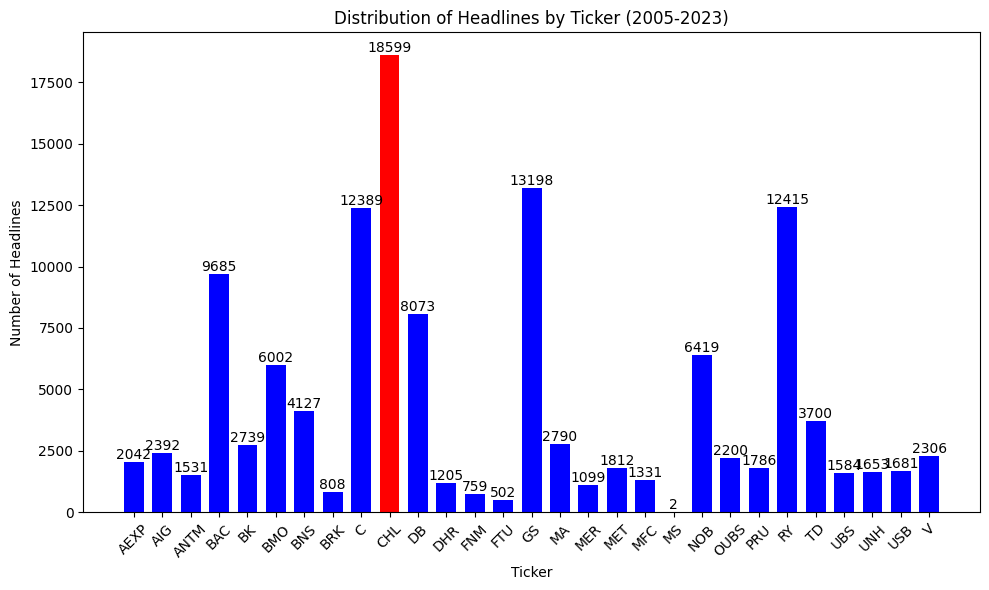

In [ ]:
# Count the number of headlines for each ticker
headline_counts = combined_sample.groupby('ticker').size()

# Find the ticker with the maximum count
max_ticker = headline_counts.idxmax()
max_count = headline_counts.max()

# Create a color list with 'blue' and 'red' for the highest bar
colors = ['red' if ticker == max_ticker else 'blue' for ticker in headline_counts.index]

# Create a bar plot
plt.figure(figsize=(10, 6))
bar_width = 0.7  # Adjust this value to make the bars thicker or thinner
bars = plt.bar(headline_counts.index, headline_counts, width=bar_width, color=colors)

# Adding titles and labels
plt.title('Distribution of Headlines by Ticker (2005-2023)')
plt.xlabel('Ticker')
plt.ylabel('Number of Headlines')
plt.xticks(rotation=45)

# Annotate the number on top of each bar
for bar in bars:
    yval = bar.get_height()
    plt.text(
        bar.get_x() + bar.get_width() / 2,  # x position of the text (center of the bar)
        yval,  # y position of the text (on top of the bar)
        int(yval),  # text to display (number of headlines)
        ha='center',  # horizontal alignment
        va='bottom',  # vertical alignment
        fontsize=10,  # font size
        color='black'  # text color
    )

# Display the plot
plt.tight_layout()
plt.show()

#Step 4: Tokenization and Visualization


#### 4.1 Tokenization of Text Data - insample

In [ ]:
# unique_comp_names = in_sample_structured_NoHeadline['']

In [ ]:
# Remove 'No_Headlines' from analysis
in_sample_structured_NoHeadline = in_sample_structured[in_sample_structured['headline'] != 'No_Headlines']

# List of stopwords
stop_words = stopwords.words('english')

def tokenize_text(headlines):
    vectorizer = CountVectorizer(stop_words=stop_words)
    X = vectorizer.fit_transform(headlines)
    token_counts = pd.DataFrame(X.toarray(), columns=vectorizer.get_feature_names_out())
    return token_counts.sum().sort_values(ascending=False)

# Tokenize for each stock and all together
token_counts_per_stock = {}
for ticker in in_sample_structured_NoHeadline['ticker'].unique():
    headlines = in_sample_structured_NoHeadline[in_sample_structured_NoHeadline['ticker'] == ticker]['headline']
    token_counts_per_stock[ticker] = tokenize_text(headlines)

# Tokenize for all stocks together
all_headlines = in_sample_structured_NoHeadline['headline']
total_token_counts_in = tokenize_text(all_headlines)

Wordcloud

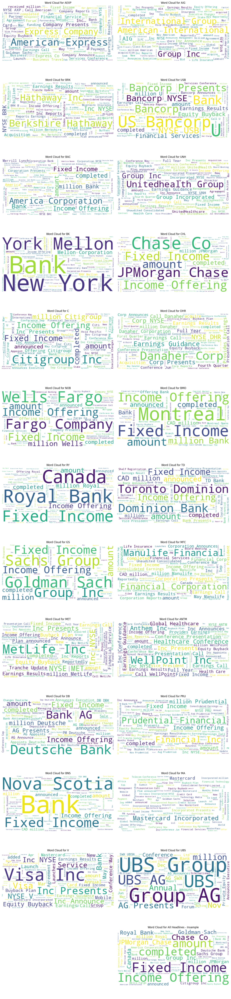

In [ ]:
# Function to generate and plot word cloud with specified size
def plot_word_cloud(ax, text, title):
    wordcloud = WordCloud(stopwords=stop_words, background_color='white').generate(text)
    ax.imshow(wordcloud, interpolation='bilinear')
    ax.axis('off')
    ax.set_title(title)

# Calculate optimal subplot layout
num_plots = len(token_counts_per_stock) + 1  # Number of stocks + all headlines
cols = 2  # Number of columns in the layout
rows = (num_plots - 1) // cols + 1  # Calculate number of rows needed

# Adjust figure size based on the number of subplots
fig_width = 15  # Width of the figure
fig_height = rows * 5  # Height of the figure, adjusted based on the number of rows

fig, axs = plt.subplots(rows, cols, figsize=(fig_width, fig_height))

# Generate word clouds for each stock
for i, ticker in enumerate(token_counts_per_stock.keys()):
    row = i // cols
    col = i % cols
    text = ' '.join(in_sample_structured[in_sample_structured['ticker'] == ticker]['headline'])
    plot_word_cloud(axs[row, col], text, f'Word Cloud for {ticker}')

# Generate word cloud for all headlines together
all_text = ' '.join(in_sample_structured['headline'])
plot_word_cloud(axs[rows-1, cols-1], all_text, 'Word Cloud for All Headlines - Insample')

# Hide any extra subplots
for i in range(len(token_counts_per_stock), rows * cols):
    axs.flatten()[i].axis('off')

plt.tight_layout()
plt.show()

Displaying Top Tokens - Insample

In [ ]:
import pandas as pd

# Function to display top tokens as a table, excluding numerical tokens
def display_top_tokens(token_counts, title, n=20):
    # Convert the token counts to a DataFrame with columns 'Tokens' and 'Frequency'
    token_counts_df = token_counts.reset_index()
    token_counts_df.columns = ['Tokens', 'Frequency']

    # Remove any tokens that contain numerical values
    token_counts_df = token_counts_df[~token_counts_df['Tokens'].str.contains(r'\d')]

    # Get the top n tokens after filtering
    top_tokens = token_counts_df.head(n)

    print(f"Top {n} tokens for {title}:")
    display(top_tokens)
    print()

# Display top tokens for each stock
for ticker, counts in token_counts_per_stock.items():
    display_top_tokens(counts, ticker)

# Display top tokens for all headlines together
display_top_tokens(total_token_counts_in, 'All Headlines')


Top 20 tokens for AEXP:


,Tokens,Frequency
0,american,724
1,express,717
2,company,548
3,presents,175
5,conference,163
10,nyse,97
12,axp,92
13,earnings,92
14,oct,84
15,summit,82



Top 20 tokens for AIG:


,Tokens,Frequency
0,inc,658
1,group,644
2,american,621
3,international,620
5,aig,155
6,presents,143
7,conference,136
8,insurance,128
9,nyse,107
10,announces,100



Top 20 tokens for BRK:


,Tokens,Frequency
0,berkshire,350
1,hathaway,340
2,inc,334
3,nyse,101
4,brk,77
5,income,76
6,fixed,76
7,offering,76
8,amount,68
9,announced,68



Top 20 tokens for USB:


,Tokens,Frequency
0,bancorp,504
1,conference,189
2,bank,168
3,presents,152
9,financial,103
11,annual,87
12,usb,86
13,nyse,86
15,earnings,81
16,inc,77



Top 20 tokens for BAC:


,Tokens,Frequency
0,bank,3600
1,america,3584
2,corporation,2927
3,fixed,1379
4,income,1354
5,offering,1338
6,conference,942
7,amount,885
8,completed,844
9,million,823



Top 20 tokens for UNH:


,Tokens,Frequency
0,unitedhealth,649
1,group,645
2,incorporated,577
3,offering,184
4,income,182
5,fixed,182
7,co,143
8,presents,135
9,added,131
10,conference,122



Top 20 tokens for BK:


,Tokens,Frequency
0,mellon,861
1,bank,760
2,new,743
3,york,720
4,corporation,688
5,conference,192
6,presents,171
8,million,170
9,bny,166
10,fixed,164



Top 20 tokens for CHL:


,Tokens,Frequency
0,jpmorgan,4379
1,chase,4186
2,co,4075
3,fixed,1780
4,income,1771
5,offering,1754
6,million,1344
7,amount,1285
8,completed,1217
9,conference,1053



Top 20 tokens for C:


,Tokens,Frequency
0,inc,4036
1,citigroup,3817
2,fixed,1434
3,income,1419
4,offering,1387
5,million,1027
6,conference,953
8,amount,910
9,completed,836
10,citi,774



Top 20 tokens for DHR:


,Tokens,Frequency
0,danaher,480
1,corporation,416
2,conference,124
3,nyse,121
4,dhr,114
5,earnings,97
6,annual,83
8,presents,80
11,results,67
13,quarter,62



Top 20 tokens for NOB:


,Tokens,Frequency
0,fargo,2538
1,wells,2538
2,company,2180
3,fixed,1279
4,income,1276
5,offering,1265
6,million,811
7,amount,792
8,completed,769
9,announced,570



Top 20 tokens for BMO:


,Tokens,Frequency
0,bank,2544
1,montreal,2485
2,offering,2059
3,income,2055
4,fixed,2055
5,amount,1649
6,million,1609
7,completed,1133
8,announced,982
9,cad,467



Top 20 tokens for RY:


,Tokens,Frequency
0,bank,3047
1,canada,2993
2,royal,2974
3,fixed,2453
4,income,2452
5,offering,2452
6,amount,2052
7,million,1983
8,completed,1700
9,announced,814



Top 20 tokens for TD:


,Tokens,Frequency
0,bank,2197
1,toronto,2058
2,dominion,2051
3,income,1620
4,fixed,1620
5,offering,1615
6,amount,1049
7,million,990
8,completed,815
9,announced,770



Top 20 tokens for GS:


,Tokens,Frequency
0,goldman,3960
1,sachs,3924
2,inc,3610
3,group,3404
4,offering,1849
5,fixed,1826
6,income,1822
7,million,1333
8,amount,1297
9,completed,1208



Top 20 tokens for MFC:


,Tokens,Frequency
0,financial,538
1,manulife,527
2,corporation,486
3,tsx,100
4,announces,90
7,conference,80
8,presents,77
9,earnings,74
10,results,71
12,inc,68



Top 20 tokens for MET:


,Tokens,Frequency
0,metlife,596
1,inc,542
3,conference,154
4,presents,136
7,nyse,101
8,met,96
10,annual,90
12,may,86
13,insurance,83
15,earnings,79



Top 20 tokens for ANTM:


,Tokens,Frequency
0,inc,600
1,anthem,424
2,health,222
3,conference,143
5,elevance,128
6,presents,121
7,earnings,103
8,healthcare,102
10,annual,95
12,nyse,89



Top 20 tokens for DB:


,Tokens,Frequency
0,bank,2266
1,deutsche,2190
2,aktiengesellschaft,1280
3,income,890
4,fixed,890
5,offering,855
6,amount,688
7,million,658
8,announced,481
9,completed,453



Top 20 tokens for PRU:


,Tokens,Frequency
0,inc,563
1,financial,542
2,prudential,509
4,conference,130
6,presents,125
7,nyse,122
8,pru,98
11,announced,86
14,insurance,72
15,buyback,70



Top 20 tokens for BNS:


,Tokens,Frequency
0,bank,1974
1,scotia,1930
2,nova,1906
3,offering,1401
4,fixed,1400
5,income,1400
6,amount,1231
7,million,1179
8,completed,741
9,announced,706



Top 20 tokens for MA:


,Tokens,Frequency
0,mastercard,1404
1,incorporated,964
2,presents,397
4,conference,275
5,inc,270
10,million,217
12,oct,198
13,announced,186
15,summit,169
16,jun,164



Top 20 tokens for V:


,Tokens,Frequency
0,visa,1098
1,inc,1041
2,presents,292
3,conference,273
7,announced,197
10,million,167
13,technology,158
14,jun,146
15,funding,133
16,mar,127



Top 20 tokens for UBS:


,Tokens,Frequency
0,group,1043
1,ubs,873
2,ag,701
3,ltd,562
4,co,540
5,announced,468
6,funding,406
7,cny,367
8,investors,323
9,billion,260



Top 20 tokens for All Headlines:


,Tokens,Frequency
0,offering,35721
1,income,35671
2,fixed,35656
3,million,32490
4,amount,31337
5,bank,29173
6,completed,28899
7,inc,20775
8,co,13714
9,jpmorgan,12290


#### 4.2 Tokenization of Text Data - Outsample

In [ ]:
# Remove 'No_Headlines' from analysis
out_sample_structured_NoHeadline = out_sample_structured[out_sample_structured['headline'] != 'No_Headlines']

# List of stopwords
stop_words = stopwords.words('english')

def tokenize_text(headlines):
    vectorizer = CountVectorizer(stop_words=stop_words)
    X = vectorizer.fit_transform(headlines)
    token_counts = pd.DataFrame(X.toarray(), columns=vectorizer.get_feature_names_out())
    return token_counts.sum().sort_values(ascending=False)

# Tokenize for each stock and all together
token_counts_per_stock = {}
for ticker in out_sample_structured_NoHeadline['ticker'].unique():
    headlines = out_sample_structured_NoHeadline[out_sample_structured_NoHeadline['ticker'] == ticker]['headline']
    token_counts_per_stock[ticker] = tokenize_text(headlines)

# Tokenize for all stocks together
all_headlines_outsample = out_sample_structured_NoHeadline['headline']
total_token_counts_out = tokenize_text(all_headlines_outsample)

Wordcloud

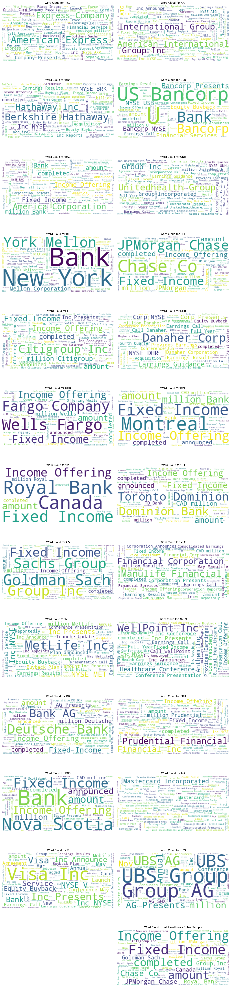

In [ ]:
# Function to generate and plot word cloud with specified size
def plot_word_cloud(ax, text, title):
    wordcloud = WordCloud(stopwords=stop_words, background_color='white').generate(text)
    ax.imshow(wordcloud, interpolation='bilinear')
    ax.axis('off')
    ax.set_title(title)

# Calculate optimal subplot layout
num_plots = len(token_counts_per_stock) + 1  # Number of stocks + all headlines
cols = 2  # Number of columns in the layout
rows = (num_plots - 1) // cols + 1  # Calculate number of rows needed

# Adjust figure size based on the number of subplots
fig_width = 15  # Width of the figure
fig_height = rows * 5  # Height of the figure, adjusted based on the number of rows

fig, axs = plt.subplots(rows, cols, figsize=(fig_width, fig_height))

# Generate word clouds for each stock
for i, ticker in enumerate(token_counts_per_stock.keys()):
    row = i // cols
    col = i % cols
    text = ' '.join(in_sample_structured[in_sample_structured['ticker'] == ticker]['headline'])
    plot_word_cloud(axs[row, col], text, f'Word Cloud for {ticker}')

# Generate word cloud for all headlines together
all_text = ' '.join(in_sample_structured['headline'])
plot_word_cloud(axs[rows-1, cols-1], all_text, 'Word Cloud for All Headlines - Out-of-Sample')

# Hide any extra subplots
for i in range(len(token_counts_per_stock), rows * cols):
    axs.flatten()[i].axis('off')

plt.tight_layout()
plt.show()

Displaying Top Tokens - Out-sample

In [ ]:
import pandas as pd

# Function to display top tokens as a table, excluding numerical tokens
def display_top_tokens(token_counts, title, n=10):
    # Convert the token counts to a DataFrame with columns 'Tokens' and 'Frequency'
    token_counts_df = token_counts.reset_index()
    token_counts_df.columns = ['Tokens', 'Frequency']

    # Remove any tokens that contain numerical values
    token_counts_df = token_counts_df[~token_counts_df['Tokens'].str.contains(r'\d')]

    # Get the top n tokens after filtering
    top_tokens = token_counts_df.head(n)

    print(f"Top {n} tokens for {title}:")
    display(top_tokens)
    print()

# Display top tokens for each stock
for ticker, counts in token_counts_per_stock.items():
    display_top_tokens(counts, ticker)

# Display top tokens for all headlines together
display_top_tokens(total_token_counts_out, 'All Headlines')


Top 10 tokens for AEXP:


,Tokens,Frequency
0,american,724
1,express,717
2,company,548
3,presents,175
5,conference,163
10,nyse,97
12,axp,92
13,earnings,92
14,oct,84
15,summit,82



Top 10 tokens for AIG:


,Tokens,Frequency
0,inc,658
1,group,644
2,american,621
3,international,620
5,aig,155
6,presents,143
7,conference,136
8,insurance,128
9,nyse,107
10,announces,100



Top 10 tokens for BRK:


,Tokens,Frequency
0,berkshire,350
1,hathaway,340
2,inc,334
3,nyse,101
4,brk,77
5,income,76
6,fixed,76
7,offering,76
8,amount,68
9,announced,68



Top 10 tokens for USB:


,Tokens,Frequency
0,bancorp,504
1,conference,189
2,bank,168
3,presents,152
9,financial,103
11,annual,87
12,usb,86
13,nyse,86
15,earnings,81
16,inc,77



Top 10 tokens for BAC:


,Tokens,Frequency
0,bank,3600
1,america,3584
2,corporation,2927
3,fixed,1379
4,income,1354
5,offering,1338
6,conference,942
7,amount,885
8,completed,844
9,million,823



Top 10 tokens for UNH:


,Tokens,Frequency
0,unitedhealth,649
1,group,645
2,incorporated,577
3,offering,184
4,income,182
5,fixed,182
7,co,143
8,presents,135
9,added,131
10,conference,122



Top 10 tokens for BK:


,Tokens,Frequency
0,mellon,861
1,bank,760
2,new,743
3,york,720
4,corporation,688
5,conference,192
6,presents,171
8,million,170
9,bny,166
10,fixed,164



Top 10 tokens for CHL:


,Tokens,Frequency
0,jpmorgan,4379
1,chase,4186
2,co,4075
3,fixed,1780
4,income,1771
5,offering,1754
6,million,1344
7,amount,1285
8,completed,1217
9,conference,1053



Top 10 tokens for C:


,Tokens,Frequency
0,inc,4036
1,citigroup,3817
2,fixed,1434
3,income,1419
4,offering,1387
5,million,1027
6,conference,953
8,amount,910
9,completed,836
10,citi,774



Top 10 tokens for DHR:


,Tokens,Frequency
0,danaher,480
1,corporation,416
2,conference,124
3,nyse,121
4,dhr,114
5,earnings,97
6,annual,83
8,presents,80
11,results,67
13,quarter,62



Top 10 tokens for NOB:


,Tokens,Frequency
0,fargo,2538
1,wells,2538
2,company,2180
3,fixed,1279
4,income,1276
5,offering,1265
6,million,811
7,amount,792
8,completed,769
9,announced,570



Top 10 tokens for BMO:


,Tokens,Frequency
0,bank,2544
1,montreal,2485
2,offering,2059
3,income,2055
4,fixed,2055
5,amount,1649
6,million,1609
7,completed,1133
8,announced,982
9,cad,467



Top 10 tokens for RY:


,Tokens,Frequency
0,bank,3047
1,canada,2993
2,royal,2974
3,fixed,2453
4,income,2452
5,offering,2452
6,amount,2052
7,million,1983
8,completed,1700
9,announced,814



Top 10 tokens for TD:


,Tokens,Frequency
0,bank,2197
1,toronto,2058
2,dominion,2051
3,income,1620
4,fixed,1620
5,offering,1615
6,amount,1049
7,million,990
8,completed,815
9,announced,770



Top 10 tokens for GS:


,Tokens,Frequency
0,goldman,3960
1,sachs,3924
2,inc,3610
3,group,3404
4,offering,1849
5,fixed,1826
6,income,1822
7,million,1333
8,amount,1297
9,completed,1208



Top 10 tokens for MFC:


,Tokens,Frequency
0,financial,538
1,manulife,527
2,corporation,486
3,tsx,100
4,announces,90
7,conference,80
8,presents,77
9,earnings,74
10,results,71
12,inc,68



Top 10 tokens for MET:


,Tokens,Frequency
0,metlife,596
1,inc,542
3,conference,154
4,presents,136
7,nyse,101
8,met,96
10,annual,90
12,may,86
13,insurance,83
15,earnings,79



Top 10 tokens for ANTM:


,Tokens,Frequency
0,inc,600
1,anthem,424
2,health,222
3,conference,143
5,elevance,128
6,presents,121
7,earnings,103
8,healthcare,102
10,annual,95
12,nyse,89



Top 10 tokens for DB:


,Tokens,Frequency
0,bank,2266
1,deutsche,2190
2,aktiengesellschaft,1280
3,income,890
4,fixed,890
5,offering,855
6,amount,688
7,million,658
8,announced,481
9,completed,453



Top 10 tokens for PRU:


,Tokens,Frequency
0,inc,563
1,financial,542
2,prudential,509
4,conference,130
6,presents,125
7,nyse,122
8,pru,98
11,announced,86
14,insurance,72
15,buyback,70



Top 10 tokens for BNS:


,Tokens,Frequency
0,bank,1974
1,scotia,1930
2,nova,1906
3,offering,1401
4,fixed,1400
5,income,1400
6,amount,1231
7,million,1179
8,completed,741
9,announced,706



Top 10 tokens for MA:


,Tokens,Frequency
0,mastercard,1404
1,incorporated,964
2,presents,397
4,conference,275
5,inc,270
10,million,217
12,oct,198
13,announced,186
15,summit,169
16,jun,164



Top 10 tokens for V:


,Tokens,Frequency
0,visa,1098
1,inc,1041
2,presents,292
3,conference,273
7,announced,197
10,million,167
13,technology,158
14,jun,146
15,funding,133
16,mar,127



Top 10 tokens for UBS:


,Tokens,Frequency
0,group,1043
1,ubs,873
2,ag,701
3,ltd,562
4,co,540
5,announced,468
6,funding,406
7,cny,367
8,investors,323
9,billion,260



Top 10 tokens for All Headlines:


,Tokens,Frequency
0,bank,17430
1,fixed,17251
2,income,17185
3,offering,17122
4,inc,13733
5,million,13128
6,amount,12430
7,completed,10341
8,announced,8820
9,conference,7191


#Step 5: Modelling - Rolling Window


####1. DistilBERT

In [ ]:
# Load accuracy metric
metric = load_metric('accuracy', trust_remote_code=True)

# Define a function to prepare the data
def prepare_data(df, tokenizer, max_length=512):
    texts = df['headline'].tolist()
    labels = df['label'].tolist()
    encodings = tokenizer(texts, truncation=True, padding='max_length', max_length=max_length, return_tensors='pt')
    return encodings, labels

# Custom Dataset class
class CustomDataset(torch.utils.data.Dataset):
    def __init__(self, encodings, labels):
        self.encodings = encodings
        self.labels = torch.tensor(labels)

    def __getitem__(self, idx):
        item = {key: val[idx] for key, val in self.encodings.items()}
        item['labels'] = self.labels[idx]
        return item

    def __len__(self):
        return len(self.labels)

def train_and_evaluate_model(train_df, eval_df, model_name, tokenizer, permco, year):
    model = DistilBertForSequenceClassification.from_pretrained(model_name, num_labels=3)

    train_encodings, train_labels = prepare_data(train_df, tokenizer)
    eval_encodings, eval_labels = prepare_data(eval_df, tokenizer)

    train_dataset = CustomDataset(train_encodings, train_labels)
    eval_dataset = CustomDataset(eval_encodings, eval_labels)

    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model.to(device)

    # Define output directory based on permco and year
    # output_dir = f'/content/drive/MyDrive/PostGrad/Projects/Fine-Tuned-Model-Rolling/{model_name}/{permco}/{year}'
    output_dir = f'{base_path}/BM16_LLMs/Finance/models/fine-tuned/{model_name}/{permco}/{year}'

    training_args = TrainingArguments(
        output_dir=output_dir,
        num_train_epochs=3,
        per_device_train_batch_size=8,
        per_device_eval_batch_size=16,
        logging_dir='./logs',
        logging_steps=10,
        eval_strategy='epoch',
        save_strategy='no'
    )

    trainer = Trainer(
        model=model,
        args=training_args,
        train_dataset=train_dataset,
        eval_dataset=eval_dataset,
        compute_metrics=lambda p: metric.compute(predictions=np.argmax(p.predictions, axis=1), references=p.label_ids)
    )

    trainer.train()
    eval_results = trainer.evaluate(eval_dataset=eval_dataset)

    # Save model and tokenizer
    os.makedirs(output_dir, exist_ok=True)
    model.save_pretrained(output_dir)
    tokenizer.save_pretrained(output_dir)

    # Return evaluation results
    return eval_results['eval_accuracy']

# Function to perform rolling window forecast for individual permcos
def rolling_window_forecast(in_sample_data, out_sample_data, tokenizer, model_name, window_size=10):
    accuracies = []

    permcos = in_sample_data['permco'].unique()

    for permco in permcos:
        print(f"Processing permco: {permco}")

        permco_in_sample = in_sample_data[in_sample_data['permco'] == permco]
        permco_out_sample = out_sample_data[out_sample_data['permco'] == permco]

        for year in range(2016, 2024):
            train_data = permco_in_sample[(permco_in_sample['start_date'].dt.year >= (year - 11)) & (permco_in_sample['start_date'].dt.year < (year - 1))]
            eval_data = permco_out_sample[permco_out_sample['start_date'].dt.year == year]

            if train_data.empty or eval_data.empty:
                continue

            accuracy = train_and_evaluate_model(train_data, eval_data, model_name, tokenizer, permco, year)

            accuracies.append({
                'permco': permco,
                'year': year,
                'accuracy': accuracy
            })

    accuracies_df = pd.DataFrame(accuracies)
    return accuracies_df

# Main execution
if __name__ == "__main__":

    tokenizer = DistilBertTokenizer.from_pretrained('distilbert-base-uncased')
    model_name = 'distilbert-base-uncased'

    accuracies_df_DistilBERT = rolling_window_forecast(in_sample_structured, out_sample_structured, tokenizer, model_name)

    # Save accuracies to a separate dataframe or CSV file
    accuracies_df_DistilBERT.to_csv(f'{base_path}/BM16_LLMs/Finance/results/fine-tuned/accuracies_DistilBERT.csv', index=False)


Processing permco: 90


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.726900,0.740744,0.444444
2,0.704200,0.727725,0.444444
3,0.662500,0.770586,0.456790


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.659200,0.604390,0.731481
2,0.676400,0.668577,0.592593
3,0.634300,0.780237,0.398148


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.727100,0.714730,0.416667
2,0.725100,0.686330,0.583333
3,0.669100,0.702030,0.527778


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.685800,0.698394,0.555556
2,0.681100,0.694477,0.555556
3,0.667100,0.693953,0.539683


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.729300,0.716766,0.456522
2,0.668100,0.742792,0.456522
3,0.685800,0.774179,0.413043


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.685600,0.666580,0.633028
2,0.657600,0.672401,0.541284
3,0.608700,0.698450,0.513761


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.716500,0.739514,0.434783
2,0.719500,0.755782,0.434783
3,0.655100,0.762479,0.460870


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.702000,0.767158,0.469027
2,0.624100,0.770792,0.469027
3,0.590700,0.748657,0.424779


Processing permco: 137


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.681900,0.690254,0.570175
2,0.660300,0.708538,0.517544
3,0.646500,0.748533,0.500000


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.702900,0.699801,0.469565
2,0.684400,0.709611,0.443478
3,0.552400,0.770213,0.469565


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.697600,0.693835,0.562842
2,0.695900,0.724666,0.497268
3,0.625300,0.768142,0.502732


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.728800,0.714876,0.500000
2,0.680000,0.723856,0.490385
3,0.559400,0.768730,0.500000


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.690000,0.667225,0.625000
2,0.706300,0.682453,0.613636
3,0.569000,0.684476,0.613636


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.706900,0.688675,0.574468
2,0.680500,0.689506,0.563830
3,0.644800,0.696699,0.595745


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.729400,0.771041,0.315789
2,0.662100,0.757852,0.385965
3,0.669100,0.818221,0.385965


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.701800,0.672549,0.619048
2,0.666100,0.690529,0.619048
3,0.594900,0.681269,0.619048


Processing permco: 540


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.733500,0.728478,0.333333
2,0.673900,0.824235,0.261905
3,0.639900,0.840617,0.238095


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.742500,0.710272,0.419355
2,0.687100,0.726806,0.483871
3,0.653200,0.660676,0.645161


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.712800,0.694608,0.558140
2,0.686600,0.695923,0.511628
3,0.695000,0.690946,0.604651


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.698600,0.718971,0.511111
2,0.655400,0.727274,0.466667
3,0.581600,0.761974,0.488889


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.711000,0.631141,0.714286
2,0.741300,0.702382,0.619048
3,0.634200,0.670624,0.619048


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.722700,0.686025,0.600000
2,0.659800,0.694725,0.525000
3,0.592400,0.721219,0.475000


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.743300,0.727637,0.552239
2,0.643600,0.767243,0.582090
3,0.543400,0.777524,0.582090


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.744900,0.709469,0.641509
2,0.655200,0.729384,0.566038
3,0.635700,0.769050,0.509434


Processing permco: 1645


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.685800,0.719695,0.490000
2,0.674000,0.720430,0.490000
3,0.551900,0.740207,0.510000


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.703800,0.696154,0.544643
2,0.666800,0.710619,0.500000
3,0.673800,0.683904,0.571429


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.726000,0.664857,0.699029
2,0.735900,0.660723,0.660194
3,0.679300,0.673006,0.631068


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.714200,0.689719,0.546512
2,0.661800,0.702671,0.534884
3,0.598900,0.692828,0.616279


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.695700,0.789736,0.404762
2,0.691100,0.693977,0.547619
3,0.656300,0.718107,0.476190


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.713700,0.687844,0.592920
2,0.642000,0.691629,0.584071
3,0.600000,0.741809,0.486726


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.696500,0.722505,0.481013
2,0.711400,0.716117,0.569620
3,0.604900,0.726344,0.544304


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.719300,0.723774,0.461538
2,0.734200,0.697922,0.519231
3,0.664000,0.710868,0.471154


Processing permco: 1869
Processing permco: 3151


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.701500,0.746342,0.450382
2,0.691100,0.715442,0.425573
3,0.633300,0.716042,0.463740


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.720300,0.700445,0.421189
2,0.691300,0.682923,0.578811
3,0.692700,0.686431,0.501292


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.698700,0.699927,0.498998
2,0.738400,0.693712,0.496994
3,0.696800,0.692719,0.513026


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.695600,0.685421,0.594203
2,0.688200,0.694589,0.519669
3,0.671100,0.704938,0.467909


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.712000,0.696256,0.494318
2,0.706700,0.695511,0.477273
3,0.696700,0.727675,0.465909


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.696900,0.651346,0.726496
2,0.701000,0.733572,0.273504
3,0.692300,0.673727,0.510684


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.699200,0.704918,0.535922
2,0.721800,0.691577,0.533981
3,0.669000,0.701844,0.479612


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.698400,0.814999,0.373303
2,0.717000,0.721639,0.411765
3,0.696500,0.735954,0.447964


Processing permco: 7267


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.690500,0.705874,0.507692
2,0.713000,0.754543,0.523077
3,0.669000,0.784455,0.569231


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.680100,0.783768,0.336538
2,0.628000,0.797271,0.346154
3,0.603500,0.869084,0.423077


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.669300,0.776396,0.426471
2,0.675300,0.653973,0.647059
3,0.682700,0.655167,0.602941


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.705600,0.658166,0.601695
2,0.676500,0.649005,0.618644
3,0.595100,0.704835,0.576271


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.712400,0.678742,0.601504
2,0.684200,0.675243,0.578947
3,0.697900,0.658994,0.661654


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.694700,0.802096,0.302817
2,0.643900,0.756421,0.373239
3,0.621800,0.872630,0.330986


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.727700,0.717975,0.482353
2,0.626200,0.731268,0.576471
3,0.592200,0.765391,0.458824


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.709900,0.704319,0.575758
2,0.662800,0.727757,0.560606
3,0.596200,0.751982,0.500000


Processing permco: 20265


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.692000,0.732066,0.409836
2,0.675300,0.689777,0.590164
3,0.722500,0.715369,0.500000


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.686200,0.687965,0.594203
2,0.697200,0.711812,0.449275
3,0.610200,0.732030,0.492754


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.705600,0.678656,0.621795
2,0.712500,0.723696,0.391026
3,0.679300,0.700485,0.480769


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.736000,0.701559,0.465649
2,0.685800,0.728836,0.496183
3,0.619200,0.761006,0.458015


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.741600,0.719943,0.514085
2,0.666300,0.718335,0.471831
3,0.674500,0.782894,0.422535


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.690600,0.740242,0.468208
2,0.687400,0.697874,0.502890
3,0.681500,0.690398,0.502890


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.713200,0.706518,0.472441
2,0.693500,0.723813,0.425197
3,0.631900,0.766619,0.440945


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.705000,0.721588,0.459184
2,0.708800,0.711637,0.479592
3,0.623400,0.772090,0.540816


Processing permco: 20436


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.684700,0.717374,0.395648
2,0.676700,0.740693,0.386746
3,0.662500,0.738099,0.442136


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.696900,0.708758,0.369048
2,0.678300,0.648734,0.658163
3,0.662300,0.646419,0.653061


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.695700,0.698440,0.450658
2,0.698600,0.704591,0.450658
3,0.707300,0.720709,0.450658


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.698900,0.690508,0.548822
2,0.700200,0.697655,0.548822
3,0.681000,0.719278,0.538721


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.666400,0.703411,0.508021
2,0.696400,0.706919,0.508021
3,0.649800,0.733380,0.508021


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.689200,0.690627,0.588710
2,0.700000,0.694845,0.479032
3,0.674300,0.730031,0.522581


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.709600,0.701014,0.477314
2,0.705400,0.697904,0.477314
3,0.685700,0.702971,0.477314


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.701900,0.687371,0.563748
2,0.699500,0.686336,0.563748
3,0.647200,0.712920,0.563748


Processing permco: 20483


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.703000,0.701496,0.487075
2,0.708300,0.713361,0.474830
3,0.588900,0.789693,0.468027


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.703000,0.694423,0.479167
2,0.629300,0.760445,0.533654
3,0.597900,0.821039,0.541667


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.679500,0.749244,0.433770
2,0.699600,0.723444,0.406114
3,0.620900,0.750308,0.471616


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.680700,0.641872,0.681752
2,0.658500,0.653390,0.579562
3,0.597700,0.734860,0.531387


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.694200,0.694540,0.496337
2,0.687200,0.704588,0.518315
3,0.661300,0.716740,0.538462


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.710200,0.695812,0.532182
2,0.677500,0.727372,0.494505
3,0.646400,0.766448,0.477237


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.677500,0.719891,0.370705
2,0.704100,0.724964,0.446655
3,0.671100,0.729358,0.468354


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.697400,0.698904,0.443497
2,0.709500,0.706577,0.454158
3,0.680000,0.723903,0.477612


Processing permco: 20557


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.725000,0.690913,0.591549
2,0.683900,0.663867,0.690141
3,0.679000,0.713486,0.436620


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.713300,0.718847,0.500000
2,0.682700,0.731833,0.354167
3,0.667100,0.788255,0.395833


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.707900,0.711259,0.400000
2,0.712700,0.729164,0.418182
3,0.649400,0.753549,0.363636


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.722200,0.706308,0.529412
2,0.697200,0.708039,0.529412
3,0.674100,0.700243,0.447059


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.726200,0.662108,0.679612
2,0.686300,0.668522,0.621359
3,0.709000,0.681253,0.524272


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.702200,0.726149,0.530120
2,0.686300,0.692064,0.590361
3,0.671200,0.724167,0.602410


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.679800,0.742838,0.418182
2,0.705500,0.735939,0.418182
3,0.653600,0.676796,0.636364


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.753600,0.746463,0.430556
2,0.705700,0.706550,0.472222
3,0.622800,0.719474,0.458333


Processing permco: 20695
Processing permco: 21190
Processing permco: 21224


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,No log,1.062731,0.000000
2,No log,1.108163,0.000000
3,No log,1.148354,0.000000


Processing permco: 21305


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.647800,0.737245,0.450909


Epoch,Training Loss,Validation Loss,Accuracy
1,0.647800,0.737245,0.450909
2,0.706200,0.717226,0.480000
3,0.696400,0.731145,0.481818


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.694900,0.695498,0.503484
2,0.684700,0.693411,0.526132
3,0.664800,0.706751,0.510453


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.708300,0.696994,0.483784
2,0.697800,0.697384,0.537838
3,0.673700,0.718530,0.470270


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.681800,0.699648,0.524242
2,0.700500,0.697770,0.472727
3,0.656100,0.723756,0.445455


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.699300,0.722841,0.479339
2,0.679000,0.694974,0.520661
3,0.631400,0.754118,0.490358


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.682900,0.641160,0.678414
2,0.669800,0.643094,0.682819
3,0.666900,0.694438,0.585903


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.692800,0.716370,0.466667
2,0.712200,0.694388,0.515789
3,0.682100,0.720145,0.463158


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.724600,0.697011,0.498155
2,0.708400,0.702648,0.512915
3,0.631000,0.702876,0.516605


Processing permco: 29146


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.714100,0.694500,0.468839
2,0.690600,0.690922,0.556657
3,0.689200,0.687969,0.558074


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.708000,0.696755,0.480609
2,0.677700,0.686529,0.544321
3,0.640500,0.697988,0.533241


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.676500,0.687525,0.583333
2,0.676900,0.702424,0.470588
3,0.667700,0.745172,0.490196


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.698900,0.686035,0.621053
2,0.650400,0.778925,0.378947
3,0.681500,0.749196,0.405263


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.771900,0.701613,0.438144
2,0.686300,0.701522,0.515464
3,0.695500,0.712079,0.515464


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.680600,0.729547,0.420690
2,0.676800,0.700219,0.462069
3,0.680600,0.729622,0.420690


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.636500,0.713593,0.547368
2,0.706100,0.708790,0.428070
3,0.669400,0.695057,0.533333


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.746500,0.693214,0.525157
2,0.694700,0.720836,0.522013
3,0.681400,0.725187,0.550314


Processing permco: 29151


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.680300,0.686683,0.562084
2,0.684300,0.698134,0.451220
3,0.695100,0.693388,0.506652


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.708400,0.702884,0.408750
2,0.706000,0.701734,0.405000
3,0.689300,0.701526,0.405000


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.711800,0.693275,0.561086
2,0.690500,0.688244,0.561086
3,0.709300,0.699443,0.470588


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.690900,0.693241,0.521739
2,0.691900,0.705708,0.478261
3,0.680000,0.700021,0.502415


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.696200,0.697377,0.509091
2,0.690800,0.694498,0.490909
3,0.700300,0.698185,0.533333


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.689800,0.703500,0.427586
2,0.700700,0.693032,0.496552
3,0.689200,0.703526,0.427586


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.720900,0.678748,0.584665
2,0.692500,0.697937,0.415335
3,0.704000,0.682125,0.584665


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.683000,0.701878,0.441975
2,0.696300,0.690102,0.558025
3,0.688100,0.693163,0.558025


Processing permco: 29152


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.717400,0.698208,0.497207
2,0.679300,0.695014,0.508380
3,0.595600,0.686820,0.558659


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.725300,0.699086,0.511905
2,0.699400,0.695950,0.502976
3,0.674100,0.697592,0.520833


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.716000,0.698657,0.488971
2,0.707300,0.698790,0.503676
3,0.693200,0.702334,0.488971


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.693000,0.702362,0.476395
2,0.696400,0.703006,0.467811
3,0.670200,0.703405,0.502146


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.705300,0.655078,0.649635
2,0.699700,0.682471,0.671533
3,0.698800,0.696611,0.430657


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.717100,0.664370,0.671429
2,0.694700,0.675104,0.652381
3,0.715000,0.735468,0.347619


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.706000,0.751891,0.426554
2,0.685800,0.713750,0.432203
3,0.727000,0.700438,0.457627


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.715000,0.719071,0.479070
2,0.674700,0.696221,0.511628
3,0.677400,0.699186,0.465116


Processing permco: 35048


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.707500,0.693896,0.489301
2,0.697400,0.698362,0.489301
3,0.667800,0.716254,0.496434


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.707000,0.695001,0.493204
2,0.663100,0.725132,0.493204
3,0.649300,0.718233,0.570874


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.691400,0.714059,0.363322
2,0.701000,0.720928,0.363322
3,0.683900,0.742543,0.363322


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.700300,0.697806,0.485651
2,0.682100,0.722302,0.492274
3,0.689300,0.770710,0.543046


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.680500,0.715273,0.498551
2,0.694000,0.700227,0.498551
3,0.679800,0.703389,0.498551


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.657200,0.706880,0.542650
2,0.668000,0.691476,0.542650
3,0.694500,0.688848,0.542650


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.695200,0.693751,0.488215
2,0.687700,0.733937,0.400673
3,0.664000,0.710713,0.400673


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.688700,0.724739,0.456483
2,0.665600,0.744510,0.456483
3,0.685200,0.717910,0.456483


Processing permco: 35276


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.715000,0.713968,0.516854
2,0.684300,0.705340,0.494382
3,0.644900,0.729616,0.460674


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.717300,0.688126,0.567901
2,0.705800,0.684484,0.567901
3,0.670500,0.679194,0.543210


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.692200,0.802889,0.400000
2,0.702100,0.693893,0.588889
3,0.667100,0.741806,0.377778


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.695200,0.753909,0.434211
2,0.708900,0.710895,0.447368
3,0.681000,0.759984,0.460526


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.727700,0.710869,0.470588
2,0.683300,0.697752,0.529412
3,0.666600,0.725473,0.470588


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.734000,0.732722,0.260274
2,0.701000,0.687157,0.657534
3,0.694500,0.670078,0.726027


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.704100,0.695064,0.606557
2,0.709500,0.702300,0.426230
3,0.673500,0.687983,0.606557


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.718700,0.741944,0.487179
2,0.715900,0.722206,0.487179
3,0.683100,0.697512,0.538462


Processing permco: 37138


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.668300,0.668124,0.591837
2,0.698400,0.684642,0.520408
3,0.652300,0.685267,0.591837


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.693400,0.706179,0.475410
2,0.689300,0.688651,0.557377
3,0.605100,0.681569,0.565574


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.720200,0.699030,0.422414
2,0.718800,0.728167,0.439655
3,0.618300,0.764097,0.439655


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.719700,0.670765,0.653846
2,0.719700,0.879348,0.326923
3,0.614800,0.857359,0.394231


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.690400,0.713554,0.465753
2,0.635400,0.802729,0.424658
3,0.632800,0.908595,0.424658


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.687000,0.670374,0.604938
2,0.641900,0.784983,0.419753
3,0.591600,0.737171,0.518519


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.693800,0.749113,0.400000
2,0.803800,0.715407,0.523077
3,0.639600,0.819927,0.430769


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.680200,0.838796,0.417910
2,0.640300,0.890278,0.462687
3,0.616000,0.933368,0.462687


Processing permco: 37504
Processing permco: 42273


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.747800,0.723889,0.400000
2,0.641400,0.682810,0.600000
3,0.657800,0.669979,0.625000


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.713000,0.691639,0.493827
2,0.699000,0.725937,0.407407
3,0.628000,0.664819,0.530864


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.723700,0.728907,0.475610
2,0.689600,0.702201,0.512195
3,0.679200,0.712665,0.512195


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.717500,0.727299,0.312500
2,0.697800,0.714346,0.387500
3,0.645900,0.796740,0.387500


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.720900,0.702337,0.387500
2,0.679000,0.776055,0.375000
3,0.678500,0.914865,0.350000


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.732900,0.759318,0.357143
2,0.718200,0.755795,0.404762
3,0.608400,0.841287,0.396825


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.705100,0.756220,0.378947
2,0.667400,0.862773,0.378947
3,0.600000,0.742068,0.494737


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.723900,0.713963,0.442105
2,0.666200,0.696665,0.578947
3,0.663100,0.707671,0.536842


Processing permco: 42291


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.701700,0.755470,0.428875
2,0.695600,0.690141,0.552017
3,0.661500,0.701066,0.543524


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.729600,0.719902,0.473684
2,0.694800,0.696664,0.473684
3,0.683900,0.701800,0.469108


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.685300,0.695970,0.450980
2,0.689500,0.681306,0.622549
3,0.691400,0.727589,0.441176


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.690600,0.696781,0.508418
2,0.691600,0.702305,0.474747
3,0.675700,0.717249,0.454545


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.711900,0.693400,0.507299
2,0.701800,0.693362,0.500000
3,0.687800,0.676142,0.565693


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.699800,0.708110,0.451613
2,0.703400,0.698520,0.424731
3,0.703500,0.723199,0.494624


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.709700,0.704557,0.474790
2,0.678400,0.682585,0.567227
3,0.691200,0.704522,0.554622


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.711000,0.701824,0.480769
2,0.678400,0.689472,0.542308
3,0.665400,0.696260,0.507692


Processing permco: 42524


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.717600,0.708770,0.428571
2,0.691400,0.684056,0.591837
3,0.678300,0.706249,0.530612


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.708600,0.712218,0.436170
2,0.689600,0.715165,0.531915
3,0.626300,0.733713,0.521277


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.732300,0.714305,0.459459
2,0.699700,0.702095,0.531532
3,0.656400,0.707617,0.495495


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.690700,0.680450,0.541176
2,0.693700,0.780641,0.341176
3,0.703900,0.719975,0.517647


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.683700,0.688271,0.619048
2,0.720800,0.725431,0.447619
3,0.591200,0.739646,0.476190


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.687100,0.727894,0.402778
2,0.669300,0.738863,0.402778
3,0.629700,0.638461,0.666667


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.728600,0.786790,0.446154
2,0.709000,0.751614,0.400000
3,0.705300,0.766797,0.461538


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.716100,0.658770,0.640000
2,0.681300,0.723451,0.440000
3,0.657000,0.660318,0.666667


Processing permco: 43264


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.695600,0.686096,0.580000
2,0.707300,0.691172,0.547273
3,0.661100,0.707299,0.569091


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.684800,0.646066,0.663984
2,0.704400,0.700501,0.408451
3,0.682200,0.685858,0.585513


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.693500,0.747068,0.426778
2,0.663200,0.734831,0.426778
3,0.693900,0.709653,0.493724


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.687500,0.673476,0.615819
2,0.675800,0.676123,0.615819
3,0.678100,0.694986,0.536723


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.684600,0.699079,0.457143
2,0.700800,0.758877,0.451429
3,0.687900,0.720549,0.451429


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.682700,0.670201,0.617284
2,0.693200,0.683784,0.549383
3,0.683300,0.689406,0.598765


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.673800,0.711276,0.486631
2,0.690400,0.696063,0.486631
3,0.695700,0.694981,0.486631


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.701500,0.693825,0.528409
2,0.668300,0.688468,0.585227
3,0.674900,0.714127,0.443182


Processing permco: 50700


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.712500,0.692217,0.542484
2,0.681500,0.710219,0.392157
3,0.619500,0.747148,0.437908


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.671000,0.653952,0.647059
2,0.654000,0.665264,0.620321
3,0.543100,0.700324,0.577540


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.687100,0.753504,0.433180
2,0.662000,0.743125,0.423963
3,0.626500,0.798907,0.447005


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.720800,0.663671,0.638298
2,0.651000,0.715671,0.535461
3,0.686700,0.717663,0.539007


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.690200,0.707876,0.505929
2,0.690500,0.745334,0.521739
3,0.657500,0.806295,0.505929


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.654600,0.738908,0.559567
2,0.677000,0.707324,0.563177
3,0.587600,0.695146,0.613718


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.659800,0.845730,0.410480
2,0.633100,0.867783,0.401747
3,0.616300,0.848981,0.458515


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.702800,0.693193,0.571429
2,0.714100,0.703474,0.563025
3,0.494400,0.749408,0.504202


Processing permco: 52983


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.705900,0.749978,0.376147
2,0.621300,0.863462,0.422018
3,0.535200,0.808795,0.458716


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.716300,0.658603,0.683871
2,0.642700,0.637446,0.683871
3,0.571600,0.727731,0.554839


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.716300,0.662355,0.644809
2,0.642700,0.674142,0.617486
3,0.571600,0.769631,0.535519


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.716300,0.662003,0.623116
2,0.642700,0.650921,0.653266
3,0.571600,0.741049,0.542714


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.633400,0.611650,0.639344
2,0.662200,0.602093,0.631148
3,0.555200,0.582550,0.643443


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.724400,0.724175,0.459459
2,0.686200,0.692406,0.567568
3,0.578500,0.736664,0.491892


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.708300,0.744519,0.320856
2,0.695600,0.894119,0.368984
3,0.558000,0.869671,0.406417


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.693800,0.676915,0.614130
2,0.645000,0.734215,0.434783
3,0.578100,0.720368,0.516304


Processing permco: 55100


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,No log,0.885131,0.591241
2,No log,0.865939,0.591241
3,0.758300,0.878018,0.591241


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.744600,0.714401,0.527132
2,0.675000,0.753974,0.542636
3,0.593800,0.732309,0.620155


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.744600,0.721305,0.536424
2,0.675000,0.772703,0.529801
3,0.593800,0.822424,0.470199


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.744600,0.729141,0.544000
2,0.675000,0.773102,0.472000
3,0.593800,0.779490,0.504000


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.744600,0.728132,0.508475
2,0.675000,0.768003,0.502825
3,0.593800,0.782192,0.531073


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.744600,0.752331,0.438053
2,0.675000,0.800730,0.455752
3,0.593800,0.802749,0.438053


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.744600,0.734793,0.515625
2,0.675000,0.763814,0.531250
3,0.593800,0.807385,0.437500


Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.744600,0.737210,0.409091
2,0.675000,0.781428,0.404040
3,0.593800,0.728668,0.606061


In [ ]:
accuracies_df_DistilBERT

,permco,year,accuracy
0,90,2016,0.456790
1,90,2017,0.398148
2,90,2018,0.527778
3,90,2019,0.539683
4,90,2020,0.413043
...,...,...,...
188,55100,2019,0.504000
189,55100,2020,0.531073
190,55100,2021,0.438053
191,55100,2022,0.437500


####2. BERT

In [ ]:
import os
import torch
import pandas as pd
import numpy as np
from transformers import BertTokenizer, BertForSequenceClassification
from transformers import Trainer, TrainingArguments
from datasets import load_metric
from sklearn.metrics import accuracy_score

# Load accuracy metric
metric = load_metric('accuracy', trust_remote_code=True)

# Define a function to prepare the data
def prepare_data(df, tokenizer, max_length=512):
    texts = df['headline'].tolist()
    labels = df['label'].tolist()
    encodings = tokenizer(texts, truncation=True, padding='max_length', max_length=max_length, return_tensors='pt')
    return encodings, labels

# Custom Dataset class
class CustomDataset(torch.utils.data.Dataset):
    def __init__(self, encodings, labels):
        self.encodings = encodings
        self.labels = torch.tensor(labels)

    def __getitem__(self, idx):
        item = {key: val[idx] for key, val in self.encodings.items()}
        item['labels'] = self.labels[idx]
        return item

    def __len__(self):
        return len(self.labels)

def train_and_evaluate_model(train_df, eval_df, model_name, tokenizer, permco, year):
    model = BertForSequenceClassification.from_pretrained(model_name, num_labels=3)

    train_encodings, train_labels = prepare_data(train_df, tokenizer)
    eval_encodings, eval_labels = prepare_data(eval_df, tokenizer)

    train_dataset = CustomDataset(train_encodings, train_labels)
    eval_dataset = CustomDataset(eval_encodings, eval_labels)

    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model.to(device)

    training_args = TrainingArguments(
        output_dir = f'{base_path}/BM16_LLMs/Finance/models/fine-tuned/{model_name}/{permco}/{year}',
        #output_dir=f'/content/drive/MyDrive/PostGrad/Projects/Fine-Tuned-Model-Rolling/{model_name}/{permco}/{year}',
        num_train_epochs=3,
        per_device_train_batch_size=8,
        per_device_eval_batch_size=16,
        logging_dir='./logs',
        logging_steps=10,
        eval_strategy='epoch',
        save_strategy='no'  # Disable checkpoint saving
    )

    trainer = Trainer(
        model=model,
        args=training_args,
        train_dataset=train_dataset,
        eval_dataset=eval_dataset,
        compute_metrics=lambda p: metric.compute(predictions=np.argmax(p.predictions, axis=1), references=p.label_ids)
    )

    trainer.train()
    eval_results = trainer.evaluate(eval_dataset=eval_dataset)

    # Save model and tokenizer
    os.makedirs(training_args.output_dir, exist_ok=True)
    model.save_pretrained(training_args.output_dir)
    tokenizer.save_pretrained(training_args.output_dir)

    # Return evaluation results
    return eval_results['eval_accuracy']

# Function to perform rolling window forecast for individual permcos
def rolling_window_forecast(in_sample_data, out_sample_data, tokenizer, model_name, window_size=10):
    accuracies = []

    permcos = in_sample_data['permco'].unique()

    for permco in permcos:
        print(f"Processing permco: {permco}")

        permco_in_sample = in_sample_data[in_sample_data['permco'] == permco]
        permco_out_sample = out_sample_data[out_sample_data['permco'] == permco]

        for year in range(2016, 2024):
            train_data = permco_in_sample[(permco_in_sample['start_date'].dt.year >= (year - 11)) & (permco_in_sample['start_date'].dt.year < (year - 1))]
            eval_data = permco_out_sample[permco_out_sample['start_date'].dt.year == year]

            if train_data.empty or eval_data.empty:
                continue

            accuracy = train_and_evaluate_model(train_data, eval_data, model_name, tokenizer, permco, year)

            accuracies.append({
                'permco': permco,
                'year': year,
                'accuracy': accuracy
            })

    accuracies_df = pd.DataFrame(accuracies)
    return accuracies_df

# Main execution
if __name__ == "__main__":
    # Example usage
    # in_sample_structured = pd.read_csv('in_sample_structured.csv', parse_dates=['start_date', 'end_date'])
    # out_sample_structured = pd.read_csv('out_sample_structured.csv', parse_dates=['start_date', 'end_date'])

    tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')
    model_name = 'bert-base-uncased'

    accuracies_BERT = rolling_window_forecast(in_sample_structured, out_sample_structured, tokenizer, model_name)

    # Save accuracies to a separate dataframe or CSV file
    accuracies_BERT.to_csv(f'{base_path}/BM16_LLMs/Finance/results/fine-tuned/accuracies_BERT.csv', index=False)


Processing permco: 90


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.698100,0.728316,0.444444
2,0.685500,0.737653,0.444444
3,0.701400,0.765140,0.432099


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.679400,0.594374,0.731481
2,0.670400,0.659565,0.629630
3,0.629700,0.790828,0.416667


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.721900,0.707106,0.416667
2,0.726200,0.682010,0.583333
3,0.675500,0.686093,0.562500


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.677700,0.696530,0.523810
2,0.662800,0.688869,0.555556
3,0.658000,0.684042,0.547619


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.720700,0.710646,0.456522
2,0.688100,0.753846,0.456522
3,0.685700,0.781130,0.478261


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.697300,0.670492,0.633028
2,0.683800,0.662593,0.633028
3,0.543300,0.739552,0.458716


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.703000,0.733826,0.434783
2,0.749000,0.743994,0.434783
3,0.721700,0.798515,0.434783


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.691300,0.750391,0.469027
2,0.644800,0.819587,0.469027
3,0.604000,0.800969,0.469027


Processing permco: 137


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.693400,0.689417,0.508772
2,0.680100,0.711178,0.456140
3,0.694300,0.741924,0.517544


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.714100,0.696214,0.547826
2,0.705400,0.715886,0.478261
3,0.594100,0.731699,0.521739


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.701600,0.698575,0.448087
2,0.689000,0.715035,0.387978
3,0.654800,0.786844,0.448087


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.762700,0.714178,0.519231
2,0.716900,0.750468,0.509615
3,0.588500,0.782305,0.500000


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.679400,0.680913,0.625000
2,0.706100,0.673231,0.625000
3,0.565800,0.705589,0.602273


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.698600,0.690590,0.574468
2,0.692600,0.690292,0.574468
3,0.634100,0.714421,0.553191


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.707000,0.722349,0.315789
2,0.641400,0.735007,0.368421
3,0.645500,0.752311,0.473684


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.735200,0.667143,0.619048
2,0.635900,0.707029,0.619048
3,0.618600,0.682892,0.619048


Processing permco: 540


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.727000,0.683047,0.666667
2,0.683400,0.759100,0.261905
3,0.692600,0.762245,0.261905


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.735300,0.710737,0.548387
2,0.660900,0.740761,0.451613
3,0.593100,0.634460,0.580645


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.698600,0.718264,0.511628
2,0.666100,0.716596,0.441860
3,0.627000,0.786854,0.465116


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.714900,0.738472,0.488889
2,0.730500,0.748041,0.400000
3,0.674200,0.819633,0.466667


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.711700,0.667188,0.690476
2,0.734500,0.675666,0.666667
3,0.630400,0.676414,0.714286


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.726500,0.684026,0.650000
2,0.665700,0.691270,0.550000
3,0.610300,0.681993,0.675000


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.739600,0.734701,0.552239
2,0.619100,0.794423,0.552239
3,0.542400,0.788891,0.552239


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.780500,0.727902,0.471698
2,0.638400,0.736701,0.528302
3,0.596400,0.773574,0.490566


Processing permco: 1645


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.676800,0.762890,0.490000
2,0.690800,0.711254,0.500000
3,0.603600,0.761934,0.470000


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.709400,0.699361,0.500000
2,0.657900,0.711535,0.500000
3,0.695200,0.682454,0.553571


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.708500,0.713214,0.359223
2,0.746100,0.648269,0.669903
3,0.714800,0.681528,0.631068


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.716900,0.699360,0.488372
2,0.694800,0.698703,0.523256
3,0.644400,0.707972,0.581395


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.707800,0.753174,0.404762
2,0.699900,0.701203,0.559524
3,0.647600,0.726767,0.511905


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.753000,0.687644,0.610619
2,0.683000,0.683226,0.610619
3,0.679800,0.697525,0.557522


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.698700,0.718803,0.506329
2,0.741800,0.718605,0.443038
3,0.642200,0.726329,0.594937


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.728900,0.739935,0.480769
2,0.727000,0.714697,0.538462
3,0.653100,0.734333,0.471154


Processing permco: 1869
Processing permco: 3151


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.688300,0.755296,0.450382
2,0.691700,0.702747,0.467557
3,0.664900,0.710657,0.465649


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.695900,0.696201,0.447028
2,0.690700,0.675973,0.578811
3,0.698900,0.687107,0.503876


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.722200,0.699292,0.498998
2,0.733400,0.693597,0.501002
3,0.682800,0.693557,0.501002


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.729600,0.686907,0.594203
2,0.719000,0.692220,0.465839
3,0.687800,0.696516,0.482402


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.722900,0.702811,0.494318
2,0.695000,0.694358,0.494318
3,0.663400,0.695149,0.494318


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.685500,0.662921,0.726496
2,0.708000,0.751139,0.273504
3,0.685800,0.705602,0.273504


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.694400,0.703679,0.535922
2,0.714200,0.695624,0.464078
3,0.683000,0.697009,0.481553


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.678200,0.813007,0.373303
2,0.696400,0.715983,0.373303
3,0.692700,0.711990,0.373303


Processing permco: 7267


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.706500,0.726311,0.553846
2,0.694100,0.746642,0.538462
3,0.656600,0.804834,0.569231


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.707100,0.769678,0.346154
2,0.677700,0.780607,0.355769
3,0.578100,0.866506,0.471154


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.697000,0.759495,0.426471
2,0.668900,0.641763,0.639706
3,0.695000,0.700137,0.566176


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.706300,0.692097,0.635593
2,0.683200,0.721534,0.474576
3,0.594100,0.901608,0.355932


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.701700,0.668053,0.661654
2,0.728000,0.710739,0.458647
3,0.648900,0.726660,0.436090


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.726800,0.837388,0.281690
2,0.640300,0.886004,0.338028
3,0.641600,0.805359,0.507042


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.725900,0.725307,0.517647
2,0.626800,0.717167,0.552941
3,0.585300,0.736468,0.505882


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.728700,0.707619,0.575758
2,0.698200,0.727479,0.439394
3,0.603000,0.753528,0.515152


Processing permco: 20265


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.686200,0.706192,0.401639
2,0.702400,0.684036,0.590164
3,0.715000,0.688246,0.590164


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.706400,0.693578,0.565217
2,0.676000,0.709408,0.413043
3,0.648200,0.684571,0.550725


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.718600,0.687942,0.589744
2,0.692700,0.703369,0.378205
3,0.708500,0.677876,0.621795


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.708400,0.709533,0.503817
2,0.694600,0.722069,0.496183
3,0.638100,0.772706,0.488550


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.714900,0.712916,0.514085
2,0.692500,0.700150,0.514085
3,0.716300,0.692516,0.485915


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.700300,0.739112,0.468208
2,0.676900,0.699249,0.473988
3,0.665100,0.687067,0.508671


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.715600,0.700942,0.527559
2,0.709700,0.720851,0.425197
3,0.654800,0.740714,0.488189


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.731300,0.701984,0.459184
2,0.688800,0.690613,0.510204
3,0.653800,0.714693,0.530612


Processing permco: 20436


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.710800,0.715960,0.395648
2,0.687600,0.748431,0.395648
3,0.686400,0.733497,0.395648


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.701300,0.706171,0.370748
2,0.681600,0.652244,0.658163
3,0.711600,0.664542,0.658163


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.696000,0.733698,0.450658
2,0.697100,0.701539,0.450658
3,0.695500,0.702728,0.450658


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.708800,0.692333,0.526936
2,0.687100,0.689400,0.548822
3,0.713100,0.688902,0.548822


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.700300,0.711684,0.508021
2,0.727900,0.696914,0.508021
3,0.664200,0.701740,0.508021


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.695000,0.681314,0.588710
2,0.694500,0.695027,0.411290
3,0.721800,0.678785,0.588710


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.760900,0.704226,0.477314
2,0.693100,0.695235,0.477314
3,0.684600,0.702400,0.477314


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.697600,0.685565,0.563748
2,0.707200,0.686331,0.563748
3,0.636700,0.686781,0.563748


Processing permco: 20483


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.703200,0.693408,0.514286
2,0.696700,0.693951,0.485714
3,0.701500,0.693809,0.485714


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.678100,0.703244,0.467949
2,0.664900,0.691889,0.532051
3,0.691700,0.691821,0.532051


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.700700,0.722062,0.411936
2,0.672900,0.730042,0.411936
3,0.675000,0.704132,0.411936


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.683900,0.641534,0.681752
2,0.681800,0.634503,0.670073
3,0.690700,0.666951,0.629197


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.708900,1.771362,0.296703
2,0.721100,0.700619,0.487179
3,0.685600,0.688659,0.558608


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.717200,0.693589,0.532182
2,0.679700,0.739543,0.466248
3,0.675200,0.757264,0.469388


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.691200,0.719479,0.367089
2,0.665200,0.729094,0.491863
3,0.641800,0.714717,0.520796


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.706100,0.700264,0.430704
2,0.741300,0.705880,0.430704
3,0.691000,0.718544,0.430704


Processing permco: 20557


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.741000,0.687635,0.676056
2,0.689200,0.699674,0.478873
3,0.655500,0.724252,0.422535


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.712400,0.728356,0.500000
2,0.670600,0.731300,0.416667
3,0.685400,0.793526,0.395833


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.727000,0.722049,0.490909
2,0.697100,0.733304,0.381818
3,0.639200,0.737847,0.454545


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.731900,0.698514,0.552941
2,0.729900,0.694714,0.458824
3,0.674600,0.681567,0.470588


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.708000,0.686542,0.699029
2,0.707000,0.674466,0.660194
3,0.721600,0.705564,0.563107


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.710600,0.717960,0.530120
2,0.681800,0.737507,0.421687
3,0.670400,0.874454,0.361446


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.701200,0.732131,0.418182
2,0.633400,0.735617,0.418182
3,0.672100,0.676773,0.600000


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.752300,0.723443,0.500000
2,0.697100,0.727449,0.500000
3,0.614000,0.707245,0.513889


Processing permco: 20695
Processing permco: 21190
Processing permco: 21224


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,No log,1.212390,0.000000
2,No log,1.262331,0.000000
3,No log,1.300282,0.000000


Processing permco: 21305


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.682400,0.742795,0.447273
2,0.717600,0.715222,0.478182
3,0.677700,0.714696,0.492727


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.710400,0.695745,0.503484
2,0.693900,0.694126,0.496516
3,0.707800,0.698203,0.496516


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.698500,0.693387,0.521622
2,0.708000,0.700383,0.462162
3,0.690800,0.706058,0.494595


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.681500,0.711913,0.524242
2,0.690800,0.691686,0.539394
3,0.686400,0.710515,0.512121


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.724900,0.718176,0.479339
2,0.706700,0.694358,0.479339
3,0.715800,0.705532,0.479339


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.691400,0.644155,0.678414
2,0.663700,0.630937,0.678414
3,0.662100,0.665631,0.621145


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.700300,0.742568,0.466667
2,0.720400,0.691775,0.533333
3,0.690800,0.716442,0.466667


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.693600,0.698897,0.487085
2,0.723100,0.705117,0.512915
3,0.672700,0.698880,0.512915


Processing permco: 29146


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.710100,0.695527,0.456091
2,0.666700,0.690100,0.536827
3,0.673500,0.693883,0.522663


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.699300,0.699463,0.480609
2,0.713800,0.692938,0.519391
3,0.700400,0.697256,0.519391


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.717000,0.683663,0.583333
2,0.703500,0.699959,0.397059
3,0.705300,0.689809,0.583333


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.706200,0.678209,0.621053
2,0.664700,0.769915,0.384211
3,0.676600,0.705523,0.447368


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.720200,0.704444,0.438144
2,0.709500,0.687377,0.561856
3,0.698300,0.687529,0.561856


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.683300,0.742290,0.420690
2,0.697000,0.696335,0.420690
3,0.707500,0.720724,0.420690


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.657600,0.711903,0.547368
2,0.741800,0.705192,0.452632
3,0.644200,0.697052,0.512281


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.741500,0.687299,0.581761
2,0.711500,0.687205,0.581761
3,0.697400,0.691017,0.506289


Processing permco: 29151


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.678200,0.692545,0.562084
2,0.699100,0.698555,0.437916
3,0.684500,0.696981,0.437916


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.723700,0.720714,0.405000
2,0.708200,0.706855,0.405000
3,0.683000,0.701321,0.405000


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.687600,0.687886,0.561086
2,0.688500,0.686429,0.561086
3,0.699400,0.693793,0.479638


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.689200,0.693829,0.521739
2,0.691000,0.715393,0.478261
3,0.693700,0.695765,0.516908


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.672500,0.696734,0.509091
2,0.715100,0.694023,0.490909
3,0.709300,0.693202,0.509091


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.698000,0.697192,0.427586
2,0.689900,0.687882,0.572414
3,0.695400,0.693830,0.427586


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.724900,0.681565,0.584665
2,0.689800,0.702622,0.415335
3,0.724500,0.686270,0.584665


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.691800,0.703685,0.441975
2,0.703000,0.695774,0.558025
3,0.702700,0.690512,0.558025


Processing permco: 29152


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.699500,0.692613,0.536313
2,0.717400,0.690598,0.516760
3,0.665400,0.688503,0.539106


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.706000,0.699333,0.517857
2,0.714700,0.695232,0.514881
3,0.688200,0.695054,0.520833


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.725500,0.698710,0.492647
2,0.719200,0.699779,0.507353
3,0.725400,0.697942,0.470588


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.700300,0.709205,0.476395
2,0.701000,0.694616,0.519313
3,0.696800,0.695351,0.523605


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.753300,0.659822,0.649635
2,0.717600,0.688789,0.664234
3,0.681500,0.710686,0.394161


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.693700,0.661904,0.671429
2,0.709900,0.675076,0.671429
3,0.703700,0.720490,0.328571


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.736400,0.729105,0.426554
2,0.728200,0.712076,0.426554
3,0.686700,0.691559,0.587571


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.736100,0.717564,0.488372
2,0.704400,0.696242,0.511628
3,0.686100,0.699543,0.476744


Processing permco: 35048


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.711500,0.692783,0.512126
2,0.685900,0.716913,0.489301
3,0.669600,0.728849,0.489301


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.698600,0.693808,0.506796
2,0.658400,0.710442,0.493204
3,0.686400,0.697078,0.493204


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.698500,0.707313,0.363322
2,0.700800,0.720201,0.363322
3,0.682400,0.720503,0.363322


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.711800,0.709134,0.485651
2,0.717700,0.697615,0.485651
3,0.699000,0.705055,0.485651


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.713900,0.710781,0.498551
2,0.712600,0.701346,0.498551
3,0.669400,0.698129,0.498551


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.679500,0.697678,0.542650
2,0.668100,0.690857,0.542650
3,0.715400,0.689815,0.542650


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.688700,0.696801,0.400673
2,0.683800,0.726491,0.400673
3,0.689600,0.710638,0.400673


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.685600,0.725385,0.456483
2,0.656700,0.758860,0.456483
3,0.690700,0.715098,0.456483


Processing permco: 35276


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.739100,0.709352,0.460674
2,0.694900,0.696079,0.539326
3,0.687300,0.697468,0.539326


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.698700,0.684675,0.567901
2,0.732300,0.674411,0.567901
3,0.680700,0.665059,0.592593


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.693100,0.795694,0.400000
2,0.707200,0.726242,0.400000
3,0.700700,0.740315,0.411111


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.706900,0.725689,0.434211
2,0.685400,0.701697,0.500000
3,0.682900,0.722073,0.460526


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.739600,0.715447,0.470588
2,0.700700,0.689326,0.588235
3,0.693800,0.740123,0.500000


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.764100,0.814638,0.260274
2,0.697400,0.674783,0.698630
3,0.679900,0.646870,0.739726


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.720000,0.692743,0.573770
2,0.699900,0.685748,0.573770
3,0.671300,0.681913,0.557377


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.720400,0.732571,0.487179
2,0.725300,0.704532,0.525641
3,0.684300,0.706685,0.500000


Processing permco: 37138


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.697300,0.679326,0.581633
2,0.697300,0.686778,0.540816
3,0.663500,0.689273,0.591837


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.702300,0.715432,0.475410
2,0.702400,0.697374,0.524590
3,0.668600,0.692343,0.516393


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.725800,0.709252,0.474138
2,0.718000,0.710689,0.379310
3,0.636600,0.727258,0.482759


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.726600,0.688149,0.673077
2,0.763600,0.867609,0.346154
3,0.611000,0.844273,0.355769


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.683200,0.722070,0.452055
2,0.699700,0.720399,0.410959
3,0.680200,0.801185,0.410959


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.723000,0.669019,0.617284
2,0.657900,0.750381,0.382716
3,0.687800,0.714817,0.506173


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.705200,0.743408,0.323077
2,0.797600,0.717768,0.476923
3,0.641600,0.864465,0.400000


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.736600,0.754480,0.432836
2,0.678900,0.736165,0.462687
3,0.633200,0.803124,0.432836


Processing permco: 37504
Processing permco: 42273


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.719000,0.716985,0.400000
2,0.667100,0.677381,0.600000
3,0.663100,0.646009,0.625000


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.681100,0.680753,0.691358
2,0.685100,0.731001,0.407407
3,0.679500,0.681293,0.481481


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.714500,0.710766,0.475610
2,0.700900,0.699184,0.536585
3,0.734000,0.703493,0.548780


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.704800,0.704393,0.525000
2,0.703700,0.694818,0.587500
3,0.660800,0.812829,0.375000


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.752100,0.714122,0.487500
2,0.705700,0.779324,0.362500
3,0.700000,0.883731,0.350000


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.720500,0.759792,0.373016
2,0.735300,0.755170,0.373016
3,0.665400,0.792911,0.388889


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.698200,0.782057,0.389474
2,0.663700,1.062182,0.378947
3,0.579100,0.757583,0.515789


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.713000,0.709070,0.442105
2,0.663000,0.685795,0.673684
3,0.673200,0.722569,0.473684


Processing permco: 42291


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.700800,0.735207,0.428875
2,0.709600,0.696220,0.428875
3,0.680000,0.693677,0.571125


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.699600,0.712223,0.473684
2,0.718800,0.695834,0.473684
3,0.715500,0.706951,0.475973


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.689900,0.692739,0.551471
2,0.679300,0.681078,0.622549
3,0.665400,0.713422,0.428922


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.678200,0.693699,0.508418
2,0.694000,0.695826,0.491582
3,0.689200,0.701484,0.464646


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.704300,0.693744,0.500000
2,0.699900,0.698368,0.500000
3,0.709000,0.693958,0.500000


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.691800,0.705058,0.451613
2,0.701000,0.708734,0.451613
3,0.699800,0.693567,0.537634


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.726900,0.707665,0.474790
2,0.697400,0.689219,0.567227
3,0.705400,0.687201,0.542017


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.724100,0.703600,0.446154
2,0.673900,0.687484,0.557692
3,0.657600,0.702003,0.488462


Processing permco: 42524


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.695500,0.707472,0.448980
2,0.711200,0.694149,0.448980
3,0.689700,0.708433,0.530612


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.693000,0.708571,0.436170
2,0.727100,0.696753,0.563830
3,0.641600,0.731898,0.510638


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.713600,0.700829,0.432432
2,0.697900,0.729375,0.432432
3,0.623300,0.744014,0.531532


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.706800,0.682150,0.647059
2,0.722200,0.764155,0.400000
3,0.717100,0.730091,0.494118


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.695600,0.695594,0.552381
2,0.731700,0.698193,0.457143
3,0.601600,0.749225,0.447619


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.697700,0.678862,0.583333
2,0.658800,0.632912,0.708333
3,0.616600,0.560477,0.763889


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.740500,0.802846,0.446154
2,0.695100,0.772806,0.353846
3,0.710300,0.808743,0.384615


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.703400,0.656846,0.613333
2,0.706300,0.696268,0.586667
3,0.675500,0.659021,0.573333


Processing permco: 43264


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.691100,0.682933,0.580000
2,0.700700,0.707218,0.420000
3,0.687900,0.681207,0.580000


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.702600,0.645827,0.663984
2,0.709300,0.696183,0.418511
3,0.692400,0.682595,0.583501


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.666200,0.748600,0.426778
2,0.701000,0.751870,0.426778
3,0.686100,0.715431,0.476987


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.687100,0.671725,0.615819
2,0.687400,0.677264,0.615819
3,0.689300,0.693337,0.531073


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.689200,0.704378,0.451429
2,0.715900,0.748234,0.451429
3,0.682800,0.733708,0.451429


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.680800,0.671390,0.617284
2,0.669400,0.679281,0.617284
3,0.702700,0.684710,0.617284


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.708500,0.708313,0.486631
2,0.715900,0.699323,0.486631
3,0.706800,0.693966,0.486631


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.704300,0.690591,0.579545
2,0.664600,0.686570,0.585227
3,0.682300,0.709372,0.414773


Processing permco: 50700


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.712300,0.687397,0.535948
2,0.674000,0.711859,0.411765
3,0.557100,0.785094,0.424837


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.681900,0.664775,0.647059
2,0.647800,0.675356,0.561497
3,0.547100,0.700543,0.593583


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.715000,0.730325,0.377880
2,0.686600,0.763521,0.566820
3,0.623800,0.841477,0.451613


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.716900,0.687121,0.546099
2,0.677300,0.802475,0.429078
3,0.712400,0.758100,0.574468


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.707600,0.724364,0.521739
2,0.711900,0.744754,0.498024
3,0.666500,0.827706,0.517787


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.632600,0.755372,0.559567
2,0.685000,0.729936,0.559567
3,0.583200,0.745271,0.566787


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.654600,0.852135,0.410480
2,0.623800,0.867344,0.401747
3,0.586500,0.850070,0.545852


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.714400,0.702787,0.558824
2,0.707900,0.700634,0.558824
3,0.553100,0.756822,0.487395


Processing permco: 52983


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.704900,0.736193,0.376147
2,0.602600,0.909376,0.449541
3,0.558000,0.804678,0.477064


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.726200,0.624133,0.683871


Epoch,Training Loss,Validation Loss,Accuracy
1,0.726200,0.624133,0.683871
2,0.659600,0.644580,0.683871
3,0.602500,0.804848,0.548387


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.726200,0.648943,0.661202
2,0.659600,0.650716,0.661202
3,0.602500,0.812481,0.530055


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.726200,0.639914,0.653266
2,0.659600,0.651786,0.663317
3,0.602500,0.821589,0.487437


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.657300,0.644843,0.639344
2,0.708800,0.607616,0.635246
3,0.605100,0.571372,0.651639


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.717300,0.706409,0.459459
2,0.710400,0.699495,0.459459
3,0.691400,0.687414,0.540541


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.701900,0.743525,0.336898
2,0.719900,0.878434,0.401070
3,0.541300,0.937734,0.406417


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.705800,0.684744,0.614130
2,0.694100,0.770956,0.402174
3,0.634100,0.709996,0.527174


Processing permco: 55100


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,No log,0.847257,0.591241
2,No log,0.830698,0.591241
3,0.675600,0.835554,0.591241


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.754300,0.697446,0.596899
2,0.669900,0.715137,0.596899
3,0.638000,0.721112,0.596899


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.754300,0.732567,0.503311
2,0.669900,0.742052,0.536424
3,0.638000,0.811624,0.456954


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.754300,0.715943,0.568000
2,0.669900,0.733343,0.560000
3,0.638000,0.768107,0.536000


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.754300,0.742504,0.480226
2,0.669900,0.783513,0.463277
3,0.638000,0.796646,0.480226


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.754300,0.735719,0.473451
2,0.669900,0.789839,0.464602
3,0.638000,0.785300,0.451327


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.754300,0.722361,0.554688
2,0.669900,0.729957,0.535156
3,0.638000,0.765366,0.550781


Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.754300,0.731426,0.469697
2,0.669900,0.782163,0.489899
3,0.638000,0.724775,0.515152


In [ ]:
accuracies_BERT

,permco,year,accuracy
0,90,2016,0.432099
1,90,2017,0.416667
2,90,2018,0.562500
3,90,2019,0.547619
4,90,2020,0.478261
...,...,...,...
188,55100,2019,0.536000
189,55100,2020,0.480226
190,55100,2021,0.451327
191,55100,2022,0.550781


####RoBERTa

In [ ]:
# Load accuracy metric
metric = load_metric('accuracy', trust_remote_code=True)

# Define a function to prepare the data
def prepare_data(df, tokenizer, max_length=512):
    texts = df['headline'].tolist()
    labels = df['label'].tolist()
    encodings = tokenizer(texts, truncation=True, padding='max_length', max_length=max_length, return_tensors='pt')
    return encodings, labels

# Custom Dataset class
class CustomDataset(torch.utils.data.Dataset):
    def __init__(self, encodings, labels):
        self.encodings = encodings
        self.labels = torch.tensor(labels)

    def __getitem__(self, idx):
        item = {key: val[idx] for key, val in self.encodings.items()}
        item['labels'] = self.labels[idx]
        return item

    def __len__(self):
        return len(self.labels)

def train_and_evaluate_model(train_df, eval_df, model_name, tokenizer, permco, year):
    model = RobertaForSequenceClassification.from_pretrained(model_name, num_labels=3)

    train_encodings, train_labels = prepare_data(train_df, tokenizer)
    eval_encodings, eval_labels = prepare_data(eval_df, tokenizer)

    train_dataset = CustomDataset(train_encodings, train_labels)
    eval_dataset = CustomDataset(eval_encodings, eval_labels)

    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model.to(device)

    # Define output directory based on permco and year
    output_dir = f'{base_path}/BM16_LLMs/Finance/models/fine-tuned/{model_name}/{permco}/{year}'
    #output_dir = f'/content/drive/MyDrive/PostGrad/Projects/Fine-Tuned-Model-Rolling/{model_name}/{permco}/{year}'

    training_args = TrainingArguments(
        output_dir=output_dir,
        num_train_epochs=3,
        per_device_train_batch_size=8,
        per_device_eval_batch_size=16,
        logging_dir='./logs',
        logging_steps=10,
        eval_strategy='epoch',
        save_strategy='no',  # Don't save at each epoch
        # load_best_model_at_end=True,
        # metric_for_best_model='eval_loss',  # Use evaluation loss to find the best model
        # greater_is_better=False,  # Lower evaluation loss is better
        # disable_tqdm=False,
        # push_to_hub=False
    )

    # early_stopping_callback = EarlyStoppingCallback(early_stopping_patience=3)

    trainer = Trainer(
        model=model,
        args=training_args,
        train_dataset=train_dataset,
        eval_dataset=eval_dataset,
        compute_metrics=lambda p: metric.compute(predictions=np.argmax(p.predictions, axis=1), references=p.label_ids)

    )

    trainer.train()
    eval_results = trainer.evaluate(eval_dataset=eval_dataset)

    # Manually save the best model and tokenizer if needed
    model.save_pretrained(output_dir)
    tokenizer.save_pretrained(output_dir)

    # Return evaluation results
    return eval_results['eval_accuracy']

# Function to perform rolling window forecast for individual permcos
def rolling_window_forecast(in_sample_data, out_sample_data, tokenizer, model_name):
    accuracies = []

    permcos = in_sample_data['permco'].unique()

    for permco in permcos:
        print(f"Processing permco: {permco}")

        permco_in_sample = in_sample_data[in_sample_data['permco'] == permco]
        permco_out_sample = out_sample_data[out_sample_data['permco'] == permco]

        for year in range(2016, 2024):
            train_data = permco_in_sample[(permco_in_sample['start_date'].dt.year >= (year - 11)) & (permco_in_sample['start_date'].dt.year < (year - 1))]
            eval_data = permco_out_sample[permco_out_sample['start_date'].dt.year == year]

            if train_data.empty or eval_data.empty:
                continue

            accuracy = train_and_evaluate_model(train_data, eval_data, model_name, tokenizer, permco, year)

            accuracies.append({
                'permco': permco,
                'year': year,
                'accuracy': accuracy
            })

    accuracies_df = pd.DataFrame(accuracies)
    return accuracies_df

# Main execution
if __name__ == "__main__":

    tokenizer = RobertaTokenizer.from_pretrained('roberta-base')
    model_name = 'roberta-base'

    accuracies_RoBERTa = rolling_window_forecast(in_sample_structured, out_sample_structured, tokenizer, model_name)

    # Save accuracies to a separate dataframe or CSV file
    accuracies_RoBERTa.to_csv(f'{base_path}/BM16_LLMs/Finance/results/fine-tuned/accuracies_RoBERTa.csv', index=False)

Processing permco: 90


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.710100,0.709368,0.444444
2,0.695500,0.723957,0.444444
3,0.691300,0.754104,0.432099


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.704700,0.602633,0.731481
2,0.703100,0.612631,0.731481
3,0.694500,0.661507,0.731481


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.734300,0.747907,0.416667
2,0.713800,0.682470,0.583333
3,0.714000,0.680670,0.583333


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.680300,0.693319,0.555556
2,0.668300,0.688626,0.555556
3,0.678500,0.690190,0.555556


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.716700,0.706955,0.456522
2,0.691500,0.746711,0.456522
3,0.722300,0.746219,0.445652


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.709200,0.671882,0.633028
2,0.654800,0.676703,0.587156
3,0.674400,0.660473,0.642202


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.739200,0.749452,0.434783
2,0.717500,0.750106,0.434783
3,0.697700,0.732591,0.434783


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.707700,0.748099,0.469027
2,0.661300,0.787015,0.469027
3,0.659600,0.741383,0.469027


Processing permco: 137


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.703500,0.684708,0.578947
2,0.700800,0.691294,0.578947
3,0.723000,0.685410,0.578947


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.686700,0.692219,0.556522
2,0.708600,0.691071,0.556522
3,0.691300,0.700858,0.478261


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.710100,0.702769,0.437158
2,0.702700,0.700567,0.437158
3,0.689600,0.703475,0.437158


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.707800,0.698339,0.471154
2,0.690400,0.728722,0.471154
3,0.709000,0.702269,0.471154


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.715500,0.679286,0.625000
2,0.699300,0.669899,0.625000
3,0.622700,0.673448,0.613636


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.690400,0.689729,0.574468
2,0.693300,0.685513,0.574468
3,0.693100,0.687442,0.574468


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.712700,0.683155,0.684211
2,0.673500,0.740640,0.315789
3,0.709600,0.759615,0.315789


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.714800,0.702374,0.619048
2,0.690900,0.720342,0.619048
3,0.654200,0.665779,0.619048


Processing permco: 540


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.725400,0.729456,0.452381
2,0.706300,0.814462,0.261905
3,0.689700,0.780886,0.261905


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.739900,0.710648,0.580645
2,0.696000,0.753503,0.419355
3,0.707900,0.696572,0.419355


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.738800,0.715810,0.465116
2,0.720700,0.697206,0.465116
3,0.750300,0.697744,0.534884


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.725600,0.705283,0.511111
2,0.729800,0.696395,0.444444
3,0.702100,0.706848,0.466667


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.745600,0.689188,0.714286
2,0.744300,0.721369,0.357143
3,0.697700,0.737936,0.380952


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.734800,0.689747,0.675000
2,0.693100,0.682531,0.600000
3,0.648100,0.703095,0.575000


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.801400,0.779126,0.552239
2,0.727000,0.710672,0.552239
3,0.725200,0.709452,0.552239


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.727100,0.808790,0.490566
2,0.640300,0.813587,0.433962
3,0.591200,0.983215,0.396226


Processing permco: 1645


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.679200,0.737474,0.490000
2,0.699800,0.709672,0.490000
3,0.694100,0.697753,0.490000


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.709200,0.700017,0.500000
2,0.672300,0.717436,0.500000
3,0.687100,0.692487,0.508929


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.740600,0.703024,0.300971
2,0.732900,0.658023,0.699029
3,0.694000,0.671280,0.699029


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.723400,0.694805,0.534884
2,0.672000,0.702044,0.465116
3,0.689900,0.702501,0.465116


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.703500,0.803005,0.404762
2,0.718700,0.684900,0.595238
3,0.674800,0.702057,0.440476


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.743000,0.676749,0.610619
2,0.671000,0.670849,0.610619
3,0.703600,0.675205,0.610619


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.709000,0.713696,0.481013
2,0.680100,0.698347,0.518987
3,0.666800,0.702214,0.506329


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.763900,0.693624,0.538462
2,0.771200,0.698888,0.461538
3,0.691800,0.696467,0.480769


Processing permco: 1869
Processing permco: 3151


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.694700,0.746068,0.450382
2,0.708700,0.694945,0.450382
3,0.703700,0.698906,0.450382


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.693000,0.696959,0.421189
2,0.701600,0.682059,0.578811
3,0.694400,0.692001,0.578811


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.733900,0.703894,0.498998
2,0.725700,0.693408,0.501002
3,0.693400,0.693652,0.501002


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.705200,0.694795,0.405797
2,0.692200,0.701067,0.405797
3,0.691000,0.693216,0.594203


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.695500,0.703456,0.494318
2,0.692800,0.694799,0.494318
3,0.700600,0.694892,0.494318


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.693500,0.636824,0.726496
2,0.693300,0.756595,0.273504
3,0.705700,0.718078,0.273504


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss


Epoch,Training Loss,Validation Loss,Accuracy
1,0.709600,0.698911,0.535922
2,0.699900,0.696409,0.464078
3,0.677000,0.699117,0.464078


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.685000,0.842157,0.373303
2,0.683500,0.726477,0.373303
3,0.694300,0.712277,0.373303


Processing permco: 7267


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.733300,0.695049,0.553846
2,0.685400,0.695687,0.553846
3,0.682000,0.690983,0.584615


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.694800,0.667951,0.653846
2,0.716400,0.755018,0.346154
3,0.639000,0.826353,0.384615


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.685600,0.804658,0.426471
2,0.674600,0.711319,0.426471
3,0.689300,0.705581,0.426471


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.721600,0.674968,0.618644
2,0.667400,0.632323,0.652542
3,0.689200,0.666373,0.635593


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.691300,0.676307,0.578947
2,0.690500,0.720197,0.421053
3,0.706000,0.673037,0.654135


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.709700,0.660443,0.718310
2,0.716800,0.622355,0.718310
3,0.676900,0.726060,0.281690


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.725700,0.716618,0.482353
2,0.674200,0.737126,0.564706
3,0.628800,0.787725,0.494118


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.721600,0.695242,0.575758
2,0.640800,0.838420,0.439394
3,0.619900,0.925413,0.454545


Processing permco: 20265


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.698800,0.726815,0.409836
2,0.690700,0.687018,0.590164
3,0.715700,0.687184,0.590164


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.701600,0.695992,0.413043
2,0.698400,0.711665,0.413043
3,0.707000,0.692207,0.586957


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.704600,0.681441,0.621795
2,0.712500,0.699936,0.378205
3,0.717600,0.677256,0.621795


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.704000,0.717730,0.503817
2,0.705800,0.695661,0.503817
3,0.693900,0.694858,0.503817


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.745400,0.726689,0.514085
2,0.673400,0.697706,0.514085
3,0.689800,0.695110,0.485915


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.710400,0.709129,0.468208
2,0.693300,0.698025,0.468208
3,0.704600,0.692162,0.531792


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.713700,0.700219,0.527559
2,0.710400,0.700540,0.472441
3,0.677900,0.701697,0.409449


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.710200,0.695867,0.459184
2,0.707100,0.693590,0.571429
3,0.694100,0.696859,0.459184


Processing permco: 20436


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.690000,0.731294,0.395648
2,0.691100,0.723024,0.395648
3,0.689300,0.705245,0.395648


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.706600,0.707781,0.341837
2,0.695900,0.664323,0.658163
3,0.702800,0.666102,0.658163


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.699400,0.705163,0.450658
2,0.693900,0.697305,0.450658
3,0.698000,0.702624,0.450658


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.723400,0.693739,0.451178
2,0.688600,0.689726,0.548822
3,0.694200,0.689489,0.548822


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.693400,0.701147,0.508021
2,0.698200,0.696584,0.508021
3,0.678000,0.696411,0.508021


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.709100,0.679319,0.588710
2,0.697000,0.686902,0.588710
3,0.695400,0.679898,0.588710


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.739900,0.702261,0.477314
2,0.692000,0.692786,0.522686
3,0.688700,0.699960,0.477314


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.716200,0.685682,0.563748
2,0.714700,0.685357,0.563748
3,0.659000,0.685260,0.563748


Processing permco: 20483


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.712200,0.693710,0.485714
2,0.702200,0.693205,0.514286
3,0.688100,0.693741,0.485714


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.689500,0.701823,0.467949
2,0.680000,0.691332,0.532051
3,0.699900,0.691531,0.532051


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.690400,0.724270,0.411936
2,0.696200,0.722146,0.411936
3,0.695300,0.699740,0.411936


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.681300,0.638021,0.681752
2,0.679300,0.642716,0.681752
3,0.675000,0.671699,0.681752


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.702200,0.697780,0.441392
2,0.682800,0.698132,0.441392
3,0.707100,0.686561,0.558608


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.698600,0.695148,0.532182
2,0.699300,0.693003,0.532182
3,0.682200,0.691393,0.532182


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.702700,0.737964,0.367089
2,0.691500,0.722716,0.367089
3,0.694300,0.710171,0.367089


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.700700,0.700498,0.430704
2,0.699800,0.702161,0.430704
3,0.681500,0.724560,0.430704


Processing permco: 20557


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.722000,0.714500,0.338028
2,0.704900,0.659395,0.690141
3,0.697000,0.653933,0.690141


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.711500,0.726314,0.500000
2,0.698200,0.696535,0.500000
3,0.681700,0.698558,0.500000


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.704800,0.698212,0.509091
2,0.708400,0.694138,0.509091
3,0.690600,0.694871,0.509091


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.729300,0.695331,0.529412
2,0.705300,0.702957,0.470588
3,0.715900,0.693032,0.529412


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.732600,0.668603,0.679612
2,0.704800,0.684982,0.621359
3,0.685900,0.706696,0.407767


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.684200,0.756967,0.530120
2,0.707500,0.712184,0.469880
3,0.674400,0.699381,0.457831


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.707900,0.779470,0.418182
2,0.675600,0.700159,0.454545
3,0.698700,0.671729,0.690909


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.707500,0.727398,0.430556
2,0.706600,0.708847,0.513889
3,0.631200,0.729355,0.486111


Processing permco: 20695
Processing permco: 21190
Processing permco: 21224


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,No log,1.183850,0.000000
2,No log,1.230417,0.000000
3,No log,1.262015,0.000000


Processing permco: 21305


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.657200,0.744987,0.450909
2,0.723300,0.711352,0.450909
3,0.704600,0.696121,0.450909


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.715900,0.694771,0.503484
2,0.715000,0.693895,0.496516
3,0.709500,0.698512,0.496516


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.717400,0.696910,0.456757
2,0.683000,0.702620,0.456757
3,0.687100,0.703455,0.456757


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.693100,0.706456,0.524242
2,0.690000,0.692494,0.524242
3,0.686500,0.692815,0.524242


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.694700,0.712230,0.479339
2,0.706100,0.699363,0.479339
3,0.679200,0.704612,0.479339


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.683700,0.632972,0.678414
2,0.673800,0.634250,0.678414
3,0.689100,0.651200,0.678414


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.691700,0.784363,0.466667
2,0.705900,0.692107,0.533333
3,0.693200,0.710866,0.466667


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.691800,0.700390,0.487085
2,0.705200,0.700643,0.512915
3,0.665900,0.697591,0.512915


Processing permco: 29146


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.706400,0.699184,0.456091
2,0.711700,0.698847,0.456091
3,0.689000,0.690553,0.542493


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.703900,0.695467,0.480609
2,0.698700,0.692716,0.519391
3,0.689400,0.698280,0.519391


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.686000,0.679980,0.583333
2,0.684600,0.686031,0.583333
3,0.672800,0.681859,0.583333


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.700400,0.725582,0.378947
2,0.661300,0.788063,0.378947
3,0.704200,0.707473,0.378947


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.741400,0.719758,0.438144
2,0.700500,0.686734,0.561856
3,0.697600,0.691388,0.561856


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.696600,0.730311,0.420690
2,0.703800,0.697333,0.420690
3,0.706000,0.720530,0.420690


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.603100,0.731609,0.547368
2,0.706600,0.699945,0.452632
3,0.682800,0.689923,0.547368


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.771800,0.696945,0.503145
2,0.692200,0.688427,0.581761
3,0.697500,0.692900,0.503145


Processing permco: 29151


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.663100,0.690622,0.562084
2,0.696000,0.707975,0.437916
3,0.700400,0.696241,0.437916


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.716700,0.698276,0.405000
2,0.710600,0.703571,0.405000
3,0.691000,0.706904,0.405000


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.697200,0.689919,0.561086
2,0.683000,0.686079,0.561086
3,0.701000,0.688941,0.561086


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.691600,0.693768,0.478261
2,0.695900,0.710581,0.478261
3,0.697300,0.695091,0.478261


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.690700,0.697444,0.509091
2,0.691900,0.693651,0.490909
3,0.695900,0.693255,0.490909


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.705900,0.696136,0.427586
2,0.697600,0.694326,0.427586
3,0.694100,0.695387,0.427586


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.727000,0.679345,0.584665
2,0.703800,0.707617,0.415335
3,0.707400,0.685397,0.584665


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.703800,0.718056,0.441975
2,0.695600,0.691666,0.558025
3,0.697500,0.690660,0.558025


Processing permco: 29152


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.698400,0.692901,0.536313
2,0.698700,0.693020,0.494413
3,0.683300,0.690689,0.536313


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.719000,0.699654,0.517857
2,0.703400,0.693732,0.517857
3,0.691600,0.694552,0.517857


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.699900,0.696706,0.492647
2,0.718900,0.694616,0.507353
3,0.714400,0.694342,0.492647


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.715800,0.705429,0.476395
2,0.683300,0.705121,0.476395
3,0.696600,0.694063,0.506438


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.726000,0.661619,0.649635
2,0.699900,0.699191,0.350365
3,0.668700,0.716062,0.350365


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.674600,0.653421,0.671429
2,0.698900,0.670740,0.671429
3,0.714100,0.724665,0.328571


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.708300,0.768923,0.426554
2,0.703000,0.729660,0.426554
3,0.696800,0.696492,0.426554


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.721300,0.707802,0.479070
2,0.692700,0.693188,0.520930
3,0.700200,0.693269,0.520930


Processing permco: 35048


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.708800,0.693891,0.489301
2,0.691200,0.698139,0.489301
3,0.687000,0.702874,0.489301


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.701300,0.694721,0.506796
2,0.678100,0.715829,0.493204
3,0.695200,0.696635,0.493204


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.704100,0.697891,0.363322
2,0.688100,0.703687,0.363322
3,0.695000,0.722387,0.363322


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.721400,0.700965,0.485651
2,0.717100,0.698405,0.485651
3,0.705300,0.701083,0.485651


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.688700,0.717041,0.498551
2,0.683200,0.703750,0.498551
3,0.674900,0.698360,0.498551


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.681600,0.705201,0.542650
2,0.669700,0.690790,0.542650
3,0.692400,0.689703,0.542650


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.709400,0.691177,0.599327
2,0.670200,0.736176,0.400673
3,0.694100,0.710139,0.400673


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.686200,0.743872,0.456483
2,0.663300,0.740365,0.456483
3,0.680000,0.714910,0.456483


Processing permco: 35276


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.751600,0.702739,0.460674
2,0.692500,0.690550,0.539326
3,0.715500,0.690143,0.539326


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.728500,0.686093,0.567901
2,0.723000,0.686167,0.567901
3,0.684400,0.686189,0.567901


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.728800,0.799213,0.400000
2,0.748400,0.680643,0.600000
3,0.706600,0.708635,0.400000


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.726300,0.802848,0.434211
2,0.691500,0.701653,0.434211
3,0.690000,0.708628,0.434211


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.715500,0.737098,0.470588
2,0.701300,0.694854,0.470588
3,0.695900,0.711136,0.470588


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.707400,0.825331,0.260274
2,0.688900,0.706916,0.301370
3,0.685300,0.661557,0.739726


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.718800,0.692582,0.557377
2,0.709700,0.693810,0.557377
3,0.706400,0.689311,0.557377


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.745500,0.768675,0.487179
2,0.706600,0.742796,0.487179
3,0.688200,0.690497,0.512821


Processing permco: 37138


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.676300,0.675952,0.581633
2,0.711700,0.695971,0.418367
3,0.687400,0.706515,0.418367


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.683300,0.703674,0.475410
2,0.698700,0.692876,0.467213
3,0.707000,0.690919,0.491803


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.707000,0.701374,0.422414
2,0.740000,0.722149,0.422414
3,0.703200,0.692629,0.577586


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.748000,0.653764,0.653846
2,0.748100,0.740529,0.346154
3,0.704000,0.716299,0.307692


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.719900,0.707456,0.383562
2,0.690400,0.696308,0.534247
3,0.708100,0.763799,0.424658


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.721000,0.673706,0.617284
2,0.654300,0.761524,0.382716
3,0.707300,0.680727,0.617284


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.714100,0.782799,0.400000
2,0.748900,0.691993,0.584615
3,0.671200,0.774060,0.430769


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.691900,0.744152,0.447761
2,0.722500,0.703899,0.432836
3,0.692700,0.704417,0.432836


Processing permco: 37504
Processing permco: 42273


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.756200,0.700525,0.400000
2,0.647400,0.681480,0.600000
3,0.690400,0.694214,0.550000


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.713200,0.713242,0.407407
2,0.688900,0.736101,0.407407
3,0.689500,0.698987,0.407407


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.715300,0.736521,0.475610
2,0.690900,0.695228,0.475610
3,0.711500,0.711375,0.475610


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.696100,0.722637,0.312500
2,0.709800,0.728045,0.312500
3,0.680800,0.759560,0.312500


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.737800,0.685218,0.562500
2,0.713400,0.676029,0.662500
3,0.707800,0.822860,0.237500


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.718400,0.779378,0.373016
2,0.749500,0.713586,0.373016
3,0.674500,0.749142,0.373016


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.709300,0.880783,0.378947
2,0.684600,0.868052,0.378947
3,0.640300,0.748012,0.463158


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.719600,0.724299,0.442105
2,0.677300,0.712840,0.442105
3,0.697400,0.706317,0.442105


Processing permco: 42291


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.692500,0.748970,0.428875
2,0.701600,0.694544,0.428875
3,0.693600,0.692526,0.571125


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.719500,0.742822,0.473684
2,0.684700,0.693309,0.526316
3,0.698900,0.694859,0.473684


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.698800,0.685751,0.563725
2,0.694700,0.678783,0.622549
3,0.704900,0.697190,0.377451


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.706100,0.696852,0.508418
2,0.690200,0.693805,0.491582
3,0.702100,0.693704,0.491582


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.704900,0.694006,0.500000
2,0.708100,0.697526,0.500000
3,0.706000,0.694097,0.500000


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.689700,0.709790,0.451613
2,0.703300,0.705885,0.451613
3,0.692200,0.693967,0.505376


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.718400,0.707462,0.474790
2,0.703100,0.693697,0.525210
3,0.696300,0.694084,0.474790


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.734200,0.706468,0.446154
2,0.702600,0.688825,0.553846
3,0.690200,0.694880,0.446154


Processing permco: 42524


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.722700,0.722984,0.408163
2,0.695500,0.697787,0.448980
3,0.690100,0.698699,0.448980


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.720200,0.724581,0.436170
2,0.724500,0.690742,0.563830
3,0.692400,0.707864,0.468085


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.732200,0.696045,0.540541
2,0.698200,0.714529,0.459459
3,0.701200,0.694224,0.540541


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.708200,0.651974,0.647059
2,0.705400,0.742183,0.388235
3,0.699500,0.693512,0.505882


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.753600,0.693055,0.552381
2,0.711400,0.678159,0.638095
3,0.677900,0.691994,0.476190


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.700400,0.689224,0.652778
2,0.726200,0.856776,0.263889
3,0.707200,0.669611,0.736111


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.735300,0.785114,0.446154
2,0.703300,0.793771,0.400000
3,0.721000,0.776648,0.476923


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.730100,0.685816,0.613333
2,0.714100,0.707429,0.386667
3,0.686100,0.657848,0.653333


Processing permco: 43264


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.691700,0.685397,0.580000
2,0.715900,0.705050,0.420000
3,0.673600,0.682287,0.580000


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.709100,0.642763,0.663984
2,0.706800,0.677119,0.663984
3,0.685200,0.685589,0.663984


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.697600,0.739263,0.426778
2,0.697300,0.742837,0.426778
3,0.687900,0.689633,0.560669


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.695200,0.667481,0.615819
2,0.675500,0.668070,0.615819
3,0.695200,0.683350,0.615819


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.709800,0.696587,0.457143
2,0.698500,0.746444,0.451429
3,0.684000,0.718088,0.451429


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.702900,0.673722,0.617284
2,0.690700,0.673410,0.617284
3,0.678200,0.684575,0.617284


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.694100,0.719101,0.486631
2,0.692500,0.712153,0.486631
3,0.714000,0.700725,0.486631


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.708000,0.681628,0.585227
2,0.673700,0.680712,0.585227
3,0.668100,0.711351,0.414773


Processing permco: 50700


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.705400,0.691732,0.542484
2,0.711000,0.693816,0.542484
3,0.690100,0.691730,0.542484


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.685900,0.652398,0.647059
2,0.659500,0.653206,0.647059
3,0.671500,0.658058,0.647059


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.708800,0.746973,0.433180
2,0.714000,0.690624,0.566820
3,0.705500,0.700084,0.566820


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.722700,0.667248,0.638298
2,0.727000,0.724577,0.361702
3,0.700000,0.670201,0.627660


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.685400,0.704194,0.498024
2,0.708900,0.698447,0.498024
3,0.680500,0.705519,0.498024


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.635000,0.732463,0.559567
2,0.712900,0.706209,0.559567
3,0.647800,0.717762,0.577617


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.659800,0.959581,0.410480
2,0.668900,0.819611,0.410480
3,0.677700,0.787305,0.414847


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.757700,0.696459,0.558824
2,0.723300,0.699766,0.558824
3,0.675800,0.700214,0.558824


Processing permco: 52983


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.711700,0.789213,0.376147
2,0.665400,0.836339,0.376147
3,0.644100,0.766443,0.366972


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.722900,0.621418,0.690323
2,0.678300,0.623652,0.690323
3,0.713200,0.634506,0.690323


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.722900,0.644998,0.661202
2,0.678300,0.640979,0.661202
3,0.713200,0.647342,0.661202


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.722900,0.645027,0.658291
2,0.678300,0.643373,0.658291
3,0.713200,0.648748,0.658291


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.658300,0.646218,0.639344
2,0.703100,0.677717,0.639344
3,0.712200,0.651970,0.639344


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.717300,0.754770,0.459459
2,0.719300,0.687447,0.535135
3,0.671700,0.687650,0.551351


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.726300,0.664815,0.657754
2,0.696600,0.811374,0.342246
3,0.687600,0.792377,0.315508


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.676300,0.674628,0.614130
2,0.689000,0.735812,0.407609
3,0.676600,0.720369,0.413043


Processing permco: 55100


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,No log,0.937003,0.591241
2,No log,0.880620,0.591241
3,0.829400,0.936198,0.591241


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.761200,0.676816,0.627907
2,0.652400,0.771197,0.503876
3,0.699500,0.771903,0.480620


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.761200,0.710739,0.496689
2,0.652400,0.800153,0.516556
3,0.699500,0.819947,0.483444


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.761200,0.699237,0.560000
2,0.652400,0.778948,0.512000
3,0.699500,0.814864,0.464000


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.761200,0.714873,0.497175
2,0.652400,0.785677,0.468927
3,0.699500,0.752764,0.587571


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.761200,0.716163,0.482301
2,0.652400,0.816358,0.473451
3,0.699500,0.818767,0.486726


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.761200,0.704289,0.550781
2,0.652400,0.764577,0.546875
3,0.699500,0.809645,0.476562


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.761200,0.702231,0.520202
2,0.652400,0.765583,0.469697
3,0.699500,0.749677,0.570707


In [ ]:
accuracies_RoBERTa

,permco,year,accuracy
0,90,2016,0.432099
1,90,2017,0.731481
2,90,2018,0.583333
3,90,2019,0.555556
4,90,2020,0.445652
...,...,...,...
188,55100,2019,0.464000
189,55100,2020,0.587571
190,55100,2021,0.486726
191,55100,2022,0.476562


####DistilRoBERTa

In [ ]:
import os
import torch
import pandas as pd
import numpy as np
from transformers import AutoTokenizer, AutoModelForSequenceClassification, Trainer, TrainingArguments
from transformers import EarlyStoppingCallback
from datasets import load_metric
from sklearn.metrics import accuracy_score

# Load accuracy metric
metric = load_metric('accuracy', trust_remote_code=True)

# Define a function to prepare the data
def prepare_data(df, tokenizer, max_length=512):
    texts = df['headline'].tolist()
    labels = df['label'].tolist()
    encodings = tokenizer(texts, truncation=True, padding='max_length', max_length=max_length, return_tensors='pt')
    return encodings, labels

# Custom Dataset class
class CustomDataset(torch.utils.data.Dataset):
    def __init__(self, encodings, labels):
        self.encodings = encodings
        self.labels = torch.tensor(labels)

    def __getitem__(self, idx):
        item = {key: val[idx] for key, val in self.encodings.items()}
        item['labels'] = self.labels[idx]
        return item

    def __len__(self):
        return len(self.labels)

def train_and_evaluate_model(train_df, eval_df, model_name, tokenizer, permco, year):
    model = AutoModelForSequenceClassification.from_pretrained(model_name, num_labels=3)

    train_encodings, train_labels = prepare_data(train_df, tokenizer)
    eval_encodings, eval_labels = prepare_data(eval_df, tokenizer)

    train_dataset = CustomDataset(train_encodings, train_labels)
    eval_dataset = CustomDataset(eval_encodings, eval_labels)

    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model.to(device)

    # Define output directory based on permco and year
    output_dir = f'{base_path}/BM16_LLMs/Finance/models/fine-tuned/{model_name}/{permco}/{year}'
    #output_dir = f'/content/drive/MyDrive/PostGrad/Projects/Fine-Tuned-Model-Rolling/{model_name}/{permco}/{year}'

    training_args = TrainingArguments(
        output_dir=output_dir,
        num_train_epochs=3,
        per_device_train_batch_size=8,
        per_device_eval_batch_size=16,
        logging_dir='./logs',
        logging_steps=10,
        eval_strategy='epoch',

    )



    trainer = Trainer(
        model=model,
        args=training_args,
        train_dataset=train_dataset,
        eval_dataset=eval_dataset,
        compute_metrics=lambda p: metric.compute(predictions=np.argmax(p.predictions, axis=1), references=p.label_ids)
    )

    trainer.train()
    eval_results = trainer.evaluate(eval_dataset=eval_dataset)

    # Manually save the best model and tokenizer if needed
    model.save_pretrained(output_dir)
    tokenizer.save_pretrained(output_dir)

    # Return evaluation results
    return eval_results['eval_accuracy']

# Function to perform rolling window forecast for individual permcos
def rolling_window_forecast(in_sample_data, out_sample_data, tokenizer, model_name):
    accuracies = []

    permcos = in_sample_data['permco'].unique()

    for permco in permcos:
        print(f"Processing permco: {permco}")

        permco_in_sample = in_sample_data[in_sample_data['permco'] == permco]
        permco_out_sample = out_sample_data[out_sample_data['permco'] == permco]

        for year in range(2016, 2024):
            train_data = permco_in_sample[(permco_in_sample['start_date'].dt.year >= (year - 11)) & (permco_in_sample['start_date'].dt.year < (year - 1))]
            eval_data = permco_out_sample[permco_out_sample['start_date'].dt.year == year]

            if train_data.empty or eval_data.empty:
                continue

            accuracy = train_and_evaluate_model(train_data, eval_data, model_name, tokenizer, permco, year)

            accuracies.append({
                'permco': permco,
                'year': year,
                'accuracy': accuracy
            })

    accuracies_df = pd.DataFrame(accuracies)
    return accuracies_df

# Main execution
if __name__ == "__main__":

    tokenizer = AutoTokenizer.from_pretrained('distilroberta-base')
    model_name = 'distilroberta-base'

    accuracies_DistilRoBERTa = rolling_window_forecast(in_sample_structured, out_sample_structured, tokenizer, model_name)

    # Save accuracies to a separate dataframe or CSV file
    accuracies_DistilRoBERTa.to_csv(f'{base_path}/BM16_LLMs/Finance/results/fine-tuned/accuracies_DistilRoBERTa.csv', index=False)


<ipython-input-6-f2f94c85e15d>:11: FutureWarning: load_metric is deprecated and will be removed in the next major version of datasets. Use 'evaluate.load' instead, from the new library 🤗 Evaluate: https://huggingface.co/docs/evaluate
  metric = load_metric('accuracy', trust_remote_code=True)


/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


tokenizer_config.json:   0%|          | 0.00/25.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/480 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/899k [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/456k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

Processing permco: 90


model.safetensors:   0%|          | 0.00/331M [00:00<?, ?B/s]

Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.698200,0.735687,0.444444
2,0.676900,0.724194,0.444444
3,0.671000,0.757405,0.432099


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.672600,0.593262,0.731481
2,0.706400,0.609611,0.731481
3,0.683900,0.667890,0.675926


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.722500,0.748113,0.416667
2,0.707200,0.687774,0.583333
3,0.662300,0.707481,0.500000


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.689500,0.691949,0.555556
2,0.683700,0.688163,0.555556
3,0.705700,0.689090,0.555556


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.718900,0.712988,0.456522
2,0.675300,0.740737,0.456522
3,0.698100,0.730586,0.456522


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.699300,0.670305,0.633028
2,0.666100,0.665851,0.633028
3,0.683400,0.660907,0.642202


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.724900,0.741926,0.434783
2,0.727400,0.755020,0.434783
3,0.682800,0.751708,0.434783


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.702300,0.765277,0.469027
2,0.673400,0.780926,0.469027
3,0.634300,0.757762,0.442478


Processing permco: 137


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.702600,0.682456,0.578947
2,0.693300,0.700686,0.429825
3,0.695500,0.690317,0.552632


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.714900,0.685423,0.547826
2,0.694100,0.696100,0.460870
3,0.667800,0.764275,0.478261


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.697400,0.705697,0.437158
2,0.703300,0.693367,0.562842
3,0.703000,0.696206,0.557377


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.720400,0.703534,0.461538
2,0.714000,0.706064,0.519231
3,0.647200,0.746760,0.519231


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.684400,0.672134,0.613636
2,0.685800,0.677320,0.625000
3,0.601800,0.672510,0.625000


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.699100,0.685605,0.574468
2,0.688000,0.685519,0.574468
3,0.656400,0.689555,0.574468


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.732100,0.759996,0.315789
2,0.669700,0.761515,0.315789
3,0.703300,0.758864,0.315789


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.722000,0.684683,0.619048
2,0.686000,0.713668,0.619048
3,0.654300,0.670239,0.619048


Processing permco: 540


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.717400,0.647136,0.738095
2,0.700600,0.785903,0.261905
3,0.664700,0.780701,0.333333


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.773800,0.685892,0.580645
2,0.697400,0.761458,0.419355
3,0.673100,0.687845,0.483871


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.732800,0.704043,0.534884
2,0.693500,0.695395,0.534884
3,0.721500,0.704055,0.511628


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.704600,0.699805,0.511111
2,0.701700,0.700417,0.488889
3,0.694700,0.705940,0.511111


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.699000,0.658985,0.690476
2,0.778900,0.726415,0.333333
3,0.684800,0.681349,0.619048


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.700600,0.688349,0.625000
2,0.676900,0.697710,0.700000
3,0.574900,0.749133,0.450000


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.774000,0.776481,0.552239
2,0.643800,0.807911,0.552239
3,0.610000,0.748153,0.537313


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.733900,0.737997,0.490566
2,0.652600,0.747194,0.509434
3,0.621900,0.765629,0.528302


Processing permco: 1645


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.676500,0.724218,0.490000
2,0.699200,0.703394,0.490000
3,0.693700,0.697384,0.500000


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.713900,0.703740,0.500000
2,0.667300,0.732895,0.500000
3,0.686800,0.686411,0.589286


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.732400,0.681281,0.699029
2,0.760000,0.660888,0.699029
3,0.689600,0.679898,0.631068


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.709300,0.693200,0.534884
2,0.708500,0.706386,0.488372
3,0.687300,0.698716,0.476744


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.705600,0.775697,0.404762
2,0.704000,0.691737,0.571429
3,0.663100,0.705162,0.488095


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.706500,0.673709,0.610619
2,0.672100,0.685133,0.610619
3,0.652100,0.701639,0.548673


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.701400,0.708646,0.481013
2,0.695100,0.704218,0.455696
3,0.664500,0.728534,0.493671


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.747300,0.707416,0.461538
2,0.775500,0.696825,0.509615
3,0.693700,0.698442,0.480769


Processing permco: 1869
Processing permco: 3151


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.681900,0.755893,0.450382
2,0.709400,0.702022,0.450382
3,0.693900,0.706175,0.435115


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.694600,0.706777,0.421189
2,0.695400,0.683182,0.578811
3,0.694700,0.692067,0.475452


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.711200,0.703451,0.498998
2,0.737500,0.693399,0.498998
3,0.695200,0.691327,0.525050


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.707100,0.686436,0.594203
2,0.686200,0.708393,0.405797
3,0.694000,0.690275,0.594203


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.704800,0.698571,0.494318
2,0.679500,0.694345,0.494318
3,0.693500,0.702343,0.465909


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.697100,0.669903,0.726496
2,0.699200,0.758421,0.273504
3,0.714200,0.717712,0.273504


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.713600,0.704446,0.535922
2,0.705500,0.694471,0.464078
3,0.686700,0.698130,0.464078


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.699200,0.824958,0.373303
2,0.690800,0.728366,0.373303
3,0.686200,0.708236,0.373303


Processing permco: 7267


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.710800,0.707269,0.553846
2,0.674700,0.721876,0.553846
3,0.688400,0.736545,0.584615


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.685700,0.703751,0.451923
2,0.685500,0.760406,0.394231
3,0.626200,0.841065,0.432692


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.676700,0.786990,0.426471
2,0.671700,0.637325,0.683824
3,0.694200,0.623727,0.632353


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.706400,0.662890,0.618644
2,0.681000,0.642187,0.627119
3,0.655700,0.663176,0.652542


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.679000,0.673251,0.578947
2,0.714200,0.666625,0.676692
3,0.698500,0.642866,0.654135


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.691700,0.774587,0.323944
2,0.673900,0.856124,0.345070
3,0.650100,0.887407,0.323944


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.709100,0.700466,0.517647
2,0.651900,0.759852,0.505882
3,0.632800,0.783788,0.517647


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.716700,0.720387,0.575758
2,0.717500,0.746043,0.424242
3,0.621500,0.786991,0.439394


Processing permco: 20265


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.698800,0.731908,0.409836
2,0.686400,0.684222,0.590164
3,0.720300,0.703869,0.573770


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.717900,0.718382,0.413043
2,0.703700,0.703826,0.413043
3,0.692600,0.688488,0.586957


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.721500,0.675598,0.621795
2,0.700600,0.697509,0.410256
3,0.689600,0.702937,0.512821


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.711100,0.718117,0.503817
2,0.700800,0.713893,0.442748
3,0.682100,0.736420,0.511450


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.733000,0.755203,0.514085
2,0.682600,0.697128,0.514085
3,0.709100,0.694454,0.485915


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.700800,0.719137,0.468208
2,0.698200,0.696715,0.531792
3,0.682200,0.695820,0.445087


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.724900,0.714589,0.472441
2,0.705300,0.706872,0.472441
3,0.699400,0.711984,0.425197


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.706400,0.702114,0.459184
2,0.701400,0.692451,0.540816
3,0.701100,0.698588,0.438776


Processing permco: 20436


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.699200,0.716852,0.395648
2,0.697200,0.730865,0.395648
3,0.693800,0.723147,0.395648


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.699300,0.703855,0.341837
2,0.696500,0.654437,0.658163
3,0.677400,0.653651,0.658163


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.700400,0.701492,0.450658
2,0.688500,0.700343,0.450658
3,0.706800,0.724112,0.450658


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.684700,0.689901,0.548822
2,0.695600,0.689773,0.548822
3,0.695400,0.690012,0.548822


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.673900,0.703736,0.508021
2,0.689100,0.702876,0.508021
3,0.646700,0.714281,0.508021


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.693500,0.686289,0.588710
2,0.695900,0.693897,0.479032
3,0.689400,0.690493,0.588710


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.741600,0.703684,0.477314
2,0.692900,0.695419,0.477314
3,0.676900,0.709159,0.477314


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.701800,0.685756,0.563748
2,0.698900,0.685197,0.563748
3,0.651800,0.703558,0.563748


Processing permco: 20483


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.695300,0.694441,0.492517
2,0.715600,0.705642,0.495238
3,0.692000,0.721187,0.492517


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.709800,0.705569,0.467949
2,0.683800,0.691566,0.532051
3,0.694200,0.691497,0.532051


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.686500,0.711492,0.411936
2,0.682700,0.701125,0.411936
3,0.681300,0.706206,0.455604


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.688600,0.640082,0.681752
2,0.661000,0.626359,0.681752
3,0.681900,0.661086,0.575182


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.707800,0.701670,0.441392
2,0.723800,0.709157,0.489011
3,0.701000,0.693782,0.543956


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.733200,0.692340,0.532182
2,0.695800,0.694141,0.532182
3,0.686300,0.697938,0.533752


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.699400,0.735392,0.367089
2,0.689900,0.721567,0.386980
3,0.687900,0.715267,0.488246


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.699200,0.705865,0.430704
2,0.704800,0.701823,0.473348
3,0.679500,0.713292,0.439232


Processing permco: 20557


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.751000,0.732402,0.309859
2,0.687300,0.663399,0.690141
3,0.706800,0.652732,0.690141


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.712000,0.709610,0.500000
2,0.692200,0.712953,0.375000
3,0.680400,0.779840,0.437500


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.711400,0.701047,0.509091
2,0.696400,0.697609,0.400000
3,0.684600,0.705118,0.509091


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.711300,0.697984,0.529412
2,0.709200,0.691518,0.505882
3,0.702900,0.692308,0.458824


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.729200,0.634554,0.679612
2,0.707900,0.697060,0.563107
3,0.683200,0.752054,0.407767


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.687900,0.756369,0.530120
2,0.683200,0.709414,0.421687
3,0.680200,0.730690,0.445783


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.690200,0.752177,0.418182
2,0.643700,0.756822,0.545455
3,0.667000,0.715216,0.600000


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.706500,0.752179,0.486111
2,0.676100,0.743271,0.500000
3,0.598000,0.772714,0.458333


Processing permco: 20695
Processing permco: 21190
Processing permco: 21224


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,No log,1.201378,0.000000
2,No log,1.253805,0.000000
3,No log,1.290070,0.000000


Processing permco: 21305


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.680000,0.732226,0.450909
2,0.710600,0.701188,0.450909
3,0.690300,0.698317,0.478182


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.708300,0.696728,0.503484
2,0.710200,0.694318,0.496516
3,0.692100,0.694758,0.512195


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.707200,0.690894,0.543243
2,0.697200,0.699704,0.456757
3,0.672200,0.714877,0.486486


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.690700,0.706024,0.524242
2,0.697400,0.691480,0.509091
3,0.681700,0.699119,0.503030


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.718500,0.730509,0.479339
2,0.691400,0.694830,0.493113
3,0.680800,0.710359,0.473829


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.689200,0.635987,0.678414
2,0.676600,0.635634,0.678414
3,0.679800,0.652501,0.678414


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.696200,0.723632,0.466667
2,0.707300,0.693186,0.533333
3,0.675100,0.725451,0.466667


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.712400,0.705965,0.487085
2,0.702500,0.702373,0.512915
3,0.686400,0.696783,0.512915


Processing permco: 29146


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.690600,0.691572,0.543909
2,0.699200,0.696373,0.456091
3,0.697000,0.696484,0.470255


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.714900,0.699563,0.480609
2,0.708700,0.692380,0.523546
3,0.679400,0.704123,0.522161


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.671600,0.685630,0.583333
2,0.698200,0.691467,0.544118
3,0.672400,0.705769,0.460784


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.714900,0.686016,0.621053
2,0.669500,0.828467,0.378947
3,0.695900,0.706863,0.394737


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.745100,0.707408,0.438144
2,0.691400,0.688678,0.572165
3,0.706900,0.692669,0.530928


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.697900,0.766376,0.420690
2,0.694100,0.701015,0.400000
3,0.695000,0.717844,0.420690


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.609100,0.716236,0.547368
2,0.717700,0.705333,0.452632
3,0.662600,0.689700,0.547368


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.766800,0.693485,0.503145
2,0.699900,0.691564,0.518868
3,0.700100,0.706742,0.500000


Processing permco: 29151


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.689900,0.688079,0.562084
2,0.688200,0.699193,0.437916
3,0.689800,0.695466,0.437916


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.708900,0.707863,0.405000
2,0.703300,0.704970,0.405000
3,0.682800,0.703764,0.405000


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.698800,0.688532,0.561086
2,0.683900,0.686795,0.561086
3,0.696400,0.691298,0.561086


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.703000,0.692926,0.521739
2,0.707600,0.718720,0.478261
3,0.683500,0.696584,0.478261


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.686400,0.694168,0.509091
2,0.700500,0.694224,0.490909
3,0.701400,0.693646,0.490909


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.712600,0.701915,0.427586
2,0.698400,0.688258,0.572414
3,0.691900,0.696940,0.427586


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.726900,0.681412,0.584665
2,0.698400,0.701559,0.415335


In [ ]:
import os
import torch
import pandas as pd
import numpy as np
from transformers import AutoTokenizer, AutoModelForSequenceClassification, Trainer, TrainingArguments
from datasets import load_metric

# Load accuracy metric
metric = load_metric('accuracy', trust_remote_code=True)

# Define a function to prepare the data
def prepare_data(df, tokenizer, max_length=512):
    texts = df['headline'].tolist()
    labels = df['label'].tolist()
    encodings = tokenizer(texts, truncation=True, padding='max_length', max_length=max_length, return_tensors='pt')
    return encodings, labels

# Custom Dataset class
class CustomDataset(torch.utils.data.Dataset):
    def __init__(self, encodings, labels):
        self.encodings = encodings
        self.labels = torch.tensor(labels)

    def __getitem__(self, idx):
        item = {key: val[idx] for key, val in self.encodings.items()}
        item['labels'] = self.labels[idx]
        return item

    def __len__(self):
        return len(self.labels)

def evaluate_model(eval_df, model_name, tokenizer, permco, year):
    model_path = f'/content/drive/MyDrive/PostGrad/Projects/Fine-Tuned-Model-Rolling/{model_name}/{permco}/{year}'
    if not os.path.exists(model_path):
        return None  # Skip if the model path does not exist

    model = AutoModelForSequenceClassification.from_pretrained(model_path)
    eval_encodings, eval_labels = prepare_data(eval_df, tokenizer)

    eval_dataset = CustomDataset(eval_encodings, eval_labels)

    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model.to(device)

    training_args = TrainingArguments(
        output_dir=model_path,
        per_device_eval_batch_size=16,
        logging_dir='./logs',
        logging_steps=10,
    )

    trainer = Trainer(
        model=model,
        args=training_args,
        eval_dataset=eval_dataset,
        compute_metrics=lambda p: metric.compute(predictions=np.argmax(p.predictions, axis=1), references=p.label_ids)
    )

    eval_results = trainer.evaluate(eval_dataset=eval_dataset)

    # Return evaluation results
    return eval_results['eval_accuracy']

# Function to perform rolling window forecast for individual permcos
def rolling_window_forecast(in_sample_data, out_sample_data, tokenizer, model_name):
    accuracies = []

    permcos = in_sample_data['permco'].unique()

    for permco in permcos:
        print(f"Processing permco: {permco}")

        permco_in_sample = in_sample_data[in_sample_data['permco'] == permco]
        permco_out_sample = out_sample_data[out_sample_data['permco'] == permco]

        for year in range(2016, 2024):
            train_data = permco_in_sample[(permco_in_sample['start_date'].dt.year >= (year - 11)) & (permco_in_sample['start_date'].dt.year < (year - 1))]
            eval_data = permco_out_sample[permco_out_sample['start_date'].dt.year == year]

            if eval_data.empty:
                continue

            accuracy = evaluate_model(eval_data, model_name, tokenizer, permco, year)

            if accuracy is not None:
                accuracies.append({
                    'permco': permco,
                    'year': year,
                    'accuracy': accuracy
                })

    accuracies_df = pd.DataFrame(accuracies)
    return accuracies_df

# Main execution
if __name__ == "__main__":
    tokenizer = AutoTokenizer.from_pretrained('distilroberta-base')
    model_name = 'distilroberta-base'

    accuracies_DistilRoBERTa = rolling_window_forecast(in_sample_structured, out_sample_structured, tokenizer, model_name)

    # Save accuracies to a separate dataframe or CSV file
    accuracies_DistilRoBERTa.to_csv('accuracies_DistilRoBERTa.csv', index=False)


Processing permco: 90


Processing permco: 137


Processing permco: 540


Processing permco: 1645


Processing permco: 1869
Processing permco: 3151


Processing permco: 7267


Processing permco: 20265


Processing permco: 20436


Processing permco: 20483


Processing permco: 20557


Processing permco: 20695
Processing permco: 21190
Processing permco: 21224


Processing permco: 21305


Processing permco: 29146


Processing permco: 29151


Processing permco: 29152
Processing permco: 35048
Processing permco: 35276
Processing permco: 37138
Processing permco: 37504
Processing permco: 42273
Processing permco: 42291
Processing permco: 42524
Processing permco: 43264
Processing permco: 50700
Processing permco: 52983
Processing permco: 55100


In [ ]:
import os
import torch
import pandas as pd
import numpy as np
from transformers import AutoTokenizer, AutoModelForSequenceClassification, Trainer, TrainingArguments
from datasets import load_metric

# Load accuracy metric
metric = load_metric('accuracy', trust_remote_code=True)

# Define a function to prepare the data
def prepare_data(df, tokenizer, max_length=512):
    texts = df['headline'].tolist()
    labels = df['label'].tolist()
    encodings = tokenizer(texts, truncation=True, padding='max_length', max_length=max_length, return_tensors='pt')
    return encodings, labels

# Custom Dataset class
class CustomDataset(torch.utils.data.Dataset):
    def __init__(self, encodings, labels):
        self.encodings = encodings
        self.labels = torch.tensor(labels)

    def __getitem__(self, idx):
        item = {key: val[idx] for key, val in self.encodings.items()}
        item['labels'] = self.labels[idx]
        return item

    def __len__(self):
        return len(self.labels)

def train_and_evaluate_model(train_df, eval_df, model_name, tokenizer, permco, year):
    model = AutoModelForSequenceClassification.from_pretrained(model_name, num_labels=3)

    train_encodings, train_labels = prepare_data(train_df, tokenizer)
    eval_encodings, eval_labels = prepare_data(eval_df, tokenizer)

    train_dataset = CustomDataset(train_encodings, train_labels)
    eval_dataset = CustomDataset(eval_encodings, eval_labels)

    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model.to(device)

    # Define output directory based on permco and year
    output_dir = f'/content/drive/MyDrive/PostGrad/Projects/Fine-Tuned-Model-Rolling/{model_name}/{permco}/{year}'

    training_args = TrainingArguments(
        output_dir=output_dir,
        num_train_epochs=3,
        per_device_train_batch_size=8,
        per_device_eval_batch_size=16,
        logging_dir='./logs',
        logging_steps=10,
        eval_strategy='epoch',
        # save_strategy='epoch',
        # save_total_limit=2,  # Limit the total number of checkpoints
        # load_best_model_at_end=True,
    )

    trainer = Trainer(
        model=model,
        args=training_args,
        train_dataset=train_dataset,
        eval_dataset=eval_dataset,
        compute_metrics=lambda p: metric.compute(predictions=np.argmax(p.predictions, axis=1), references=p.label_ids)
    )

    trainer.train()
    eval_results = trainer.evaluate(eval_dataset=eval_dataset)

    # Manually save the best model and tokenizer if needed
    model.save_pretrained(output_dir)
    tokenizer.save_pretrained(output_dir)

    # Return evaluation results
    return eval_results['eval_accuracy']

# Function to perform rolling window forecast for individual permcos
def rolling_window_forecast(in_sample_data, out_sample_data, tokenizer, model_name):
    accuracies = []

    permcos = in_sample_data['permco'].unique()

    for permco in permcos:
        print(f"Processing permco: {permco}")

        permco_in_sample = in_sample_data[in_sample_data['permco'] == permco]
        permco_out_sample = out_sample_data[out_sample_data['permco'] == permco]

        for year in range(2016, 2024):
            # Check if the model for this permco and year already exists
            output_dir = f'/content/drive/MyDrive/PostGrad/Projects/Fine-Tuned-Model-Rolling/{model_name}/{permco}/{year}'
            if os.path.exists(output_dir):
                print(f"Model for permco {permco} and year {year} already exists. Skipping...")
                continue

            train_data = permco_in_sample[(permco_in_sample['start_date'].dt.year >= (year - 11)) & (permco_in_sample['start_date'].dt.year < (year - 1))]
            eval_data = permco_out_sample[permco_out_sample['start_date'].dt.year == year]

            if train_data.empty or eval_data.empty:
                continue

            accuracy = train_and_evaluate_model(train_data, eval_data, model_name, tokenizer, permco, year)

            accuracies.append({
                'permco': permco,
                'year': year,
                'accuracy': accuracy
            })

    accuracies_df = pd.DataFrame(accuracies)
    return accuracies_df

# Main execution
if __name__ == "__main__":
    # Example usage
    # in_sample_structured = pd.read_csv('in_sample_structured.csv', parse_dates=['start_date', 'end_date'])
    # out_sample_structured = pd.read_csv('out_sample_structured.csv', parse_dates=['start_date', 'end_date'])

    tokenizer = AutoTokenizer.from_pretrained('distilroberta-base')
    model_name = 'distilroberta-base'

    accuracies_DistilRoBERTa2 = rolling_window_forecast(in_sample_structured, out_sample_structured, tokenizer, model_name)

    # Save accuracies to a separate dataframe or CSV file
    accuracies_DistilRoBERTa2.to_csv('accuracies_DistilRoBERTa2.csv', index=False)

Processing permco: 90
Model for permco 90 and year 2016 already exists. Skipping...
Model for permco 90 and year 2017 already exists. Skipping...
Model for permco 90 and year 2018 already exists. Skipping...
Model for permco 90 and year 2019 already exists. Skipping...
Model for permco 90 and year 2020 already exists. Skipping...
Model for permco 90 and year 2021 already exists. Skipping...
Model for permco 90 and year 2022 already exists. Skipping...
Model for permco 90 and year 2023 already exists. Skipping...
Processing permco: 137
Model for permco 137 and year 2016 already exists. Skipping...
Model for permco 137 and year 2017 already exists. Skipping...
Model for permco 137 and year 2018 already exists. Skipping...
Model for permco 137 and year 2019 already exists. Skipping...
Model for permco 137 and year 2020 already exists. Skipping...
Model for permco 137 and year 2021 already exists. Skipping...
Model for permco 137 and year 2022 already exists. Skipping...
Model for permco 1

Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.706000,0.691669,0.536313
2,0.688900,0.690478,0.553073
3,0.664500,0.688877,0.536313


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.719600,0.696869,0.517857
2,0.692300,0.693789,0.517857
3,0.693100,0.693910,0.517857


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.718600,0.708464,0.492647
2,0.715600,0.694667,0.507353
3,0.703700,0.695724,0.474265


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.702600,0.704421,0.476395
2,0.703900,0.698788,0.476395
3,0.697200,0.693876,0.523605


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.720500,0.652181,0.649635
2,0.703800,0.705916,0.350365
3,0.681500,0.704773,0.386861


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.711000,0.652689,0.671429
2,0.728700,0.678085,0.671429
3,0.691100,0.735595,0.328571


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.704800,0.758063,0.426554
2,0.697000,0.737349,0.426554
3,0.695700,0.693980,0.485876


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.731200,0.718083,0.479070
2,0.713400,0.695088,0.520930
3,0.704600,0.694739,0.506977


Processing permco: 35048


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.704400,0.693242,0.510699
2,0.693000,0.705547,0.489301
3,0.685500,0.706568,0.489301


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.708500,0.693871,0.506796
2,0.681700,0.702511,0.493204
3,0.699600,0.700035,0.493204


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.694700,0.722993,0.363322
2,0.687900,0.718581,0.363322
3,0.692600,0.719910,0.363322


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.722200,0.697735,0.485651
2,0.699700,0.696042,0.485651
3,0.706700,0.701724,0.485651


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.704500,0.714399,0.498551
2,0.694500,0.700464,0.498551
3,0.681200,0.702694,0.498551


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.678700,0.708532,0.542650
2,0.670000,0.691015,0.542650
3,0.696000,0.688837,0.542650


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.715900,0.689474,0.599327
2,0.685300,0.733059,0.400673
3,0.690200,0.711280,0.400673


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.685500,0.743342,0.456483
2,0.654500,0.765621,0.456483
3,0.680800,0.714937,0.456483


Processing permco: 35276


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.714800,0.707793,0.460674
2,0.709700,0.691197,0.539326
3,0.694600,0.689840,0.539326


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.737500,0.692641,0.567901
2,0.725800,0.682685,0.567901
3,0.695000,0.682451,0.567901


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.708100,0.898412,0.400000
2,0.731300,0.687447,0.600000
3,0.697900,0.711076,0.400000


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.716100,0.759400,0.434211
2,0.692400,0.697136,0.407895
3,0.684300,0.711051,0.434211


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.720600,0.714089,0.470588
2,0.701800,0.692972,0.529412
3,0.707300,0.713975,0.470588


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.718600,0.937187,0.260274
2,0.694900,0.689760,0.561644
3,0.682000,0.655066,0.739726


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.735100,0.700386,0.442623
2,0.704000,0.688415,0.557377
3,0.720200,0.688393,0.540984


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.716200,0.759882,0.487179
2,0.714700,0.747389,0.487179
3,0.704500,0.696060,0.512821


Processing permco: 37138


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.686300,0.680977,0.581633
2,0.711000,0.689858,0.622449
3,0.674300,0.691011,0.612245


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.717500,0.702766,0.475410
2,0.715000,0.695911,0.508197
3,0.691100,0.688293,0.557377


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.696700,0.700525,0.422414
2,0.720800,0.696184,0.396552
3,0.699800,0.691812,0.577586


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.725400,0.652995,0.653846
2,0.755500,0.816031,0.346154
3,0.679900,0.791685,0.384615


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.684400,0.721318,0.410959
2,0.677800,0.744682,0.479452
3,0.689400,0.810174,0.465753


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.689600,0.666685,0.617284
2,0.649100,0.766537,0.407407
3,0.676100,0.744395,0.506173


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.714800,0.813804,0.400000
2,0.691400,0.733791,0.430769
3,0.642900,0.857283,0.430769


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.677100,0.752814,0.432836
2,0.665800,0.779767,0.462687
3,0.653900,0.813835,0.492537


Processing permco: 37504
Processing permco: 42273


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.738400,0.713037,0.400000
2,0.667600,0.685701,0.600000
3,0.683000,0.689919,0.650000


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.697100,0.689065,0.691358
2,0.700200,0.751394,0.407407
3,0.680600,0.700207,0.407407


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.704300,0.735011,0.475610
2,0.709200,0.701163,0.475610
3,0.701200,0.704402,0.475610


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.684300,0.715826,0.312500
2,0.696200,0.694084,0.562500
3,0.679200,0.762262,0.325000


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.729000,0.698475,0.387500
2,0.732800,0.661921,0.762500
3,0.708800,0.813565,0.237500


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.719800,0.745729,0.373016
2,0.762800,0.691779,0.626984
3,0.688500,0.759433,0.373016


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.699200,0.753390,0.378947
2,0.691800,0.922852,0.378947
3,0.664100,0.710347,0.494737


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.743000,0.718584,0.442105
2,0.657400,0.691292,0.536842
3,0.695700,0.712768,0.442105


Processing permco: 42291


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.702000,0.742106,0.428875
2,0.703500,0.689398,0.571125
3,0.701100,0.692470,0.571125


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.724200,0.717888,0.473684
2,0.700300,0.696154,0.473684
3,0.700900,0.693065,0.526316


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.699200,0.682512,0.622549
2,0.698100,0.674924,0.622549
3,0.692700,0.700344,0.441176


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.697600,0.694953,0.508418
2,0.694300,0.696584,0.491582
3,0.693200,0.694067,0.501684


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.701600,0.694704,0.500000
2,0.685900,0.697884,0.500000
3,0.700900,0.691734,0.507299


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.688700,0.717153,0.451613
2,0.705100,0.700616,0.451613
3,0.691100,0.694478,0.500000


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.718400,0.710623,0.474790
2,0.687500,0.696602,0.474790
3,0.684800,0.693768,0.504202


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.720100,0.703207,0.446154
2,0.697300,0.687931,0.553846
3,0.687800,0.691744,0.519231


Processing permco: 42524


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.696800,0.691167,0.571429
2,0.708300,0.696059,0.551020
3,0.714000,0.697961,0.530612


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.685300,0.712673,0.436170
2,0.712400,0.702697,0.563830
3,0.662800,0.742883,0.457447


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.723700,0.702081,0.459459
2,0.699000,0.711751,0.459459
3,0.683000,0.685999,0.585586


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.693700,0.652334,0.647059
2,0.691600,0.748814,0.376471
3,0.698800,0.696019,0.494118


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.728800,0.690387,0.552381
2,0.699600,0.693697,0.466667
3,0.661300,0.717580,0.466667


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.699600,0.677561,0.763889
2,0.731400,0.826117,0.263889
3,0.684500,0.653383,0.569444


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.731000,0.804120,0.446154
2,0.687600,0.812892,0.338462
3,0.725600,0.794582,0.461538


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.731300,0.695181,0.613333
2,0.693900,0.742885,0.386667
3,0.668500,0.652294,0.666667


Processing permco: 43264


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.686000,0.681993,0.580000
2,0.695700,0.697786,0.412727
3,0.666200,0.687456,0.580000


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.692200,0.647698,0.663984
2,0.696400,0.689517,0.454728
3,0.663100,0.692726,0.440644


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.707200,0.745511,0.426778
2,0.688200,0.740224,0.426778
3,0.684200,0.703147,0.502092


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.703700,0.670982,0.615819
2,0.673900,0.672408,0.615819
3,0.690300,0.691752,0.463277


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.704400,0.692011,0.548571
2,0.689200,0.759451,0.451429
3,0.690700,0.724613,0.451429


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.688500,0.672858,0.617284
2,0.714800,0.677672,0.617284
3,0.677400,0.698433,0.487654


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.679800,0.718736,0.486631
2,0.680300,0.712220,0.486631
3,0.706100,0.699147,0.486631


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.718100,0.684145,0.585227
2,0.686000,0.684498,0.585227
3,0.674900,0.734341,0.414773


Processing permco: 50700


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.727300,0.709454,0.542484
2,0.709400,0.698700,0.366013
3,0.685000,0.700402,0.450980


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.717000,0.656776,0.647059
2,0.662200,0.662804,0.647059
3,0.654300,0.670619,0.598930


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.706000,0.745957,0.433180
2,0.685200,0.711815,0.566820
3,0.708500,0.746103,0.566820


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.726400,0.669918,0.638298
2,0.716100,0.710977,0.436170
3,0.723000,0.700574,0.563830


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.715000,0.747325,0.498024
2,0.680800,0.717045,0.509881
3,0.661900,0.784521,0.498024


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.656100,0.719852,0.559567
2,0.664400,0.727726,0.559567
3,0.642400,0.718484,0.545126


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.674600,0.892047,0.410480
2,0.642100,0.827585,0.410480
3,0.680700,0.805891,0.410480


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.717300,0.689448,0.558824
2,0.702000,0.693657,0.558824
3,0.635200,0.699325,0.558824


Processing permco: 52983


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.696600,0.763206,0.376147
2,0.655400,0.850403,0.376147
3,0.653500,0.785913,0.422018


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.728500,0.674608,0.690323
2,0.691200,0.621246,0.690323
3,0.704100,0.652266,0.632258


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.728500,0.680225,0.661202
2,0.691200,0.646009,0.661202
3,0.704100,0.659199,0.622951


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.728500,0.679485,0.658291
2,0.691200,0.648146,0.658291
3,0.704100,0.660064,0.638191


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.657000,0.641785,0.639344
2,0.687300,0.606427,0.639344
3,0.671000,0.557547,0.696721


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.714500,0.710174,0.524324
2,0.696800,0.685507,0.535135
3,0.619100,0.689266,0.491892


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.716100,0.733675,0.342246
2,0.705500,0.866675,0.331551
3,0.623900,0.862113,0.352941


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.684300,0.676706,0.614130
2,0.678300,0.768713,0.445652
3,0.656300,0.755570,0.413043


Processing permco: 55100


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,No log,0.919016,0.591241
2,No log,0.854829,0.591241
3,0.812900,0.878444,0.591241


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.735400,0.722918,0.418605
2,0.660400,0.736635,0.542636
3,0.631900,0.719225,0.620155


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.735400,0.698890,0.556291
2,0.660400,0.755287,0.516556
3,0.631900,0.838520,0.456954


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.735400,0.717972,0.488000
2,0.660400,0.766459,0.536000
3,0.631900,0.774393,0.488000


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.735400,0.731141,0.491525
2,0.660400,0.805883,0.451977
3,0.631900,0.800115,0.491525


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.735400,0.749654,0.442478
2,0.660400,0.841116,0.429204
3,0.631900,0.817955,0.491150


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.735400,0.709076,0.511719
2,0.660400,0.761561,0.500000
3,0.631900,0.781246,0.570312


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at distilroberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch,Training Loss,Validation Loss,Accuracy
1,0.735400,0.759420,0.378788
2,0.660400,0.841335,0.444444
3,0.631900,0.736611,0.535354


In [ ]:
accuracies_DistilRoBERTa2

,permco,year,accuracy
0,29152,2016,0.536313
1,29152,2017,0.517857
2,29152,2018,0.474265
3,29152,2019,0.523605
4,29152,2020,0.386861
...,...,...,...
83,55100,2019,0.488000
84,55100,2020,0.491525
85,55100,2021,0.491150
86,55100,2022,0.570312


####FinBERT

In [ ]:
# Load accuracy metric
metric = load_metric('accuracy', trust_remote_code=True)

# Define a function to prepare the data
def prepare_data(df, tokenizer, max_length=512):
    texts = df['headline'].tolist()
    labels = df['label'].tolist()
    encodings = tokenizer(texts, truncation=True, padding='max_length', max_length=max_length, return_tensors='pt')
    return encodings, labels

# Custom Dataset class
class CustomDataset(torch.utils.data.Dataset):
    def __init__(self, encodings, labels):
        self.encodings = encodings
        self.labels = torch.tensor(labels)

    def __getitem__(self, idx):
        item = {key: val[idx] for key, val in self.encodings.items()}
        item['labels'] = self.labels[idx]
        return item

    def __len__(self):
        return len(self.labels)

def train_and_evaluate_model(train_df, eval_df, model_name, tokenizer, permco, year):
    model = AutoModelForSequenceClassification.from_pretrained(model_name, num_labels=3)

    train_encodings, train_labels = prepare_data(train_df, tokenizer)
    eval_encodings, eval_labels = prepare_data(eval_df, tokenizer)

    train_dataset = CustomDataset(train_encodings, train_labels)
    eval_dataset = CustomDataset(eval_encodings, eval_labels)

    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model.to(device)

    # Define output directory based on permco and year
    output_dir = f'{base_path}/BM16_LLMs/Finance/models/fine-tuned/{model_name}/{permco}/{year}'
    #output_dir = f'/content/drive/MyDrive/PostGrad/Projects/Fine-Tuned-Model-Rolling/{model_name}/{permco}/{year}'

    training_args = TrainingArguments(
        output_dir=output_dir,
        num_train_epochs=3,
        per_device_train_batch_size=8,
        per_device_eval_batch_size=16,
        logging_dir='./logs',
        logging_steps=10,
        eval_strategy='epoch',
        save_strategy='no'  # Save the model at each epoch
    )

    trainer = Trainer(
        model=model,
        args=training_args,
        train_dataset=train_dataset,
        eval_dataset=eval_dataset,
        compute_metrics=lambda p: metric.compute(predictions=np.argmax(p.predictions, axis=1), references=p.label_ids)
    )

    trainer.train()
    eval_results = trainer.evaluate(eval_dataset=eval_dataset)

    # Save the best model and tokenizer
    os.makedirs(training_args.output_dir, exist_ok=True)
    model.save_pretrained(output_dir)
    tokenizer.save_pretrained(output_dir)

    # Return evaluation results
    return eval_results['eval_accuracy']

# Function to perform rolling window forecast for individual permcos
def rolling_window_forecast(in_sample_data, out_sample_data, tokenizer, model_name):
    accuracies = []

    permcos = in_sample_data['permco'].unique()

    for permco in permcos:
        print(f"Processing permco: {permco}")

        permco_in_sample = in_sample_data[in_sample_data['permco'] == permco]
        permco_out_sample = out_sample_data[out_sample_data['permco'] == permco]

        for year in range(2016, 2024):
            train_data = permco_in_sample[(permco_in_sample['start_date'].dt.year >= (year - 11)) & (permco_in_sample['start_date'].dt.year < (year - 1))]
            eval_data = permco_out_sample[permco_out_sample['start_date'].dt.year == year]

            if train_data.empty or eval_data.empty:
                continue

            accuracy = train_and_evaluate_model(train_data, eval_data, model_name, tokenizer, permco, year)

            accuracies.append({
                'permco': permco,
                'year': year,
                'accuracy': accuracy
            })

    accuracies_df = pd.DataFrame(accuracies)
    return accuracies_df

# Main execution
if __name__ == "__main__":
    tokenizer = AutoTokenizer.from_pretrained('yiyanghkust/finbert-tone')
    model_name = 'yiyanghkust/finbert-tone'

    accuracies_FinBERT = rolling_window_forecast(in_sample_structured, out_sample_structured, tokenizer, model_name)

    # Save accuracies to a separate dataframe or CSV file
    accuracies_FinBERT.to_csv(f'{base_path}/BM16_LLMs/Finance/results/fine-tuned/accuracies_FinBERT.csv', index=False)


<ipython-input-6-d03734b9ba30>:10: FutureWarning: load_metric is deprecated and will be removed in the next major version of datasets. Use 'evaluate.load' instead, from the new library 🤗 Evaluate: https://huggingface.co/docs/evaluate
  metric = load_metric('accuracy', trust_remote_code=True)


/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


config.json:   0%|          | 0.00/533 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/226k [00:00<?, ?B/s]

Processing permco: 90


pytorch_model.bin:   0%|          | 0.00/439M [00:00<?, ?B/s]

Epoch,Training Loss,Validation Loss,Accuracy
1,0.739600,0.740489,0.444444
2,0.792300,0.752007,0.469136
3,0.660400,0.705367,0.530864


Epoch,Training Loss,Validation Loss,Accuracy
1,0.790300,0.612306,0.731481
2,0.751800,0.764475,0.462963
3,0.605200,0.842652,0.416667


Epoch,Training Loss,Validation Loss,Accuracy
1,0.808500,0.675275,0.555556
2,0.790200,0.764318,0.479167
3,0.713700,0.767976,0.548611


Epoch,Training Loss,Validation Loss,Accuracy
1,0.767300,0.684401,0.515873
2,0.589900,0.746040,0.523810
3,0.610400,0.748733,0.611111


Epoch,Training Loss,Validation Loss,Accuracy
1,0.816400,0.733961,0.510870
2,0.661600,0.847237,0.456522
3,0.735000,0.978736,0.467391


Epoch,Training Loss,Validation Loss,Accuracy
1,0.893600,0.769947,0.458716
2,0.698600,0.738146,0.467890
3,0.415100,0.790000,0.568807


Epoch,Training Loss,Validation Loss,Accuracy
1,1.085100,0.751270,0.565217
2,0.783900,0.671089,0.626087
3,0.675400,0.739956,0.469565


Epoch,Training Loss,Validation Loss,Accuracy
1,0.937200,0.891436,0.477876
2,0.735600,1.098074,0.469027
3,0.547700,0.868759,0.530973


Processing permco: 137


Epoch,Training Loss,Validation Loss,Accuracy
1,0.837200,0.818005,0.412281
2,0.714000,0.727829,0.526316
3,0.555900,0.936807,0.482456


Epoch,Training Loss,Validation Loss,Accuracy
1,0.794700,0.715264,0.452174
2,0.795500,0.760853,0.417391
3,0.554700,0.896326,0.478261


Epoch,Training Loss,Validation Loss,Accuracy
1,0.800500,0.752749,0.557377
2,0.706100,0.861124,0.508197
3,0.693000,0.826093,0.464481


Epoch,Training Loss,Validation Loss,Accuracy
1,0.832700,0.843745,0.471154
2,0.774400,0.758475,0.528846
3,0.607100,0.742013,0.519231


Epoch,Training Loss,Validation Loss,Accuracy
1,0.734200,0.660011,0.625000
2,0.792500,0.674998,0.602273
3,0.475300,0.728721,0.568182


Epoch,Training Loss,Validation Loss,Accuracy
1,0.794000,0.709807,0.489362
2,0.778500,0.761542,0.500000
3,0.595400,0.733948,0.521277


Epoch,Training Loss,Validation Loss,Accuracy
1,0.815300,0.677331,0.684211
2,0.808100,0.647386,0.649123
3,0.552800,0.822980,0.473684


Epoch,Training Loss,Validation Loss,Accuracy
1,1.061400,1.383422,0.619048
2,0.642800,0.810857,0.630952
3,0.497300,0.805060,0.595238


Processing permco: 540


Epoch,Training Loss,Validation Loss,Accuracy
1,0.883800,0.868246,0.333333
2,0.732800,0.793134,0.380952
3,0.596100,0.842776,0.357143


Epoch,Training Loss,Validation Loss,Accuracy
1,0.919500,0.833999,0.580645
2,0.874400,0.655614,0.645161
3,0.666600,0.628596,0.612903


Epoch,Training Loss,Validation Loss,Accuracy
1,0.944900,0.795909,0.534884
2,0.817400,0.775310,0.534884
3,0.638700,0.729772,0.511628


Epoch,Training Loss,Validation Loss,Accuracy
1,1.056900,0.760391,0.377778
2,0.833800,0.742064,0.511111
3,0.536000,0.773187,0.600000


Epoch,Training Loss,Validation Loss,Accuracy
1,1.146500,0.787143,0.690476
2,0.693900,0.846990,0.500000
3,0.557700,0.849484,0.595238


Epoch,Training Loss,Validation Loss,Accuracy
1,0.807700,0.723733,0.650000
2,0.686900,0.789972,0.600000
3,0.621400,0.724344,0.650000


Epoch,Training Loss,Validation Loss,Accuracy
1,1.206900,1.047906,0.507463
2,0.739800,1.056861,0.507463
3,0.449200,1.347950,0.462687


Epoch,Training Loss,Validation Loss,Accuracy
1,0.944000,1.148632,0.528302
2,0.716200,1.266070,0.547170
3,0.474400,1.106411,0.547170


Processing permco: 1645


Epoch,Training Loss,Validation Loss,Accuracy
1,0.809200,0.802648,0.560000
2,0.814800,0.752207,0.530000
3,0.478700,0.916422,0.480000


Epoch,Training Loss,Validation Loss,Accuracy
1,0.774000,0.762842,0.500000
2,0.731100,0.705647,0.508929
3,0.677100,0.772725,0.598214


Epoch,Training Loss,Validation Loss,Accuracy
1,0.987600,0.706224,0.699029
2,0.707000,0.633785,0.679612
3,0.655200,0.655801,0.708738


Epoch,Training Loss,Validation Loss,Accuracy
1,1.043600,0.734188,0.465116
2,0.809900,1.190509,0.465116
3,0.667200,0.803853,0.558140


Epoch,Training Loss,Validation Loss,Accuracy
1,0.869600,0.844160,0.404762
2,0.926800,0.972863,0.404762
3,0.600000,0.769183,0.511905


Epoch,Training Loss,Validation Loss,Accuracy
1,0.905600,0.871338,0.610619
2,0.682600,0.814188,0.601770
3,0.662700,0.756803,0.592920


Epoch,Training Loss,Validation Loss,Accuracy
1,0.911500,0.903317,0.468354
2,0.739000,0.805997,0.531646
3,0.598300,0.849141,0.506329


Epoch,Training Loss,Validation Loss,Accuracy
1,1.310200,0.751733,0.509615
2,0.736500,0.908423,0.500000
3,0.618800,0.781003,0.519231


Processing permco: 1869
Processing permco: 3151


Epoch,Training Loss,Validation Loss,Accuracy
1,0.718600,0.692198,0.549618
2,0.702400,0.723526,0.458015
3,0.660900,0.750436,0.456107


Epoch,Training Loss,Validation Loss,Accuracy
1,1.058000,0.990861,0.421189
2,0.742900,0.679768,0.578811
3,0.695000,0.744917,0.452196


Epoch,Training Loss,Validation Loss,Accuracy
1,0.889500,0.740529,0.501002
2,0.716900,0.705986,0.501002
3,0.668500,0.705756,0.543086


Epoch,Training Loss,Validation Loss,Accuracy
1,0.863800,0.757659,0.405797
2,0.692400,0.876944,0.476190
3,0.613200,0.754867,0.532091


Epoch,Training Loss,Validation Loss,Accuracy
1,0.932200,0.708009,0.494318
2,0.752900,0.708978,0.477273
3,0.650100,0.771920,0.428977


Epoch,Training Loss,Validation Loss,Accuracy
1,0.818200,0.597187,0.726496
2,0.866100,0.659251,0.660256
3,0.747500,0.706288,0.557692


Epoch,Training Loss,Validation Loss,Accuracy
1,0.776700,0.716718,0.535922
2,0.786500,0.753978,0.466019
3,0.629400,0.742968,0.475728


Epoch,Training Loss,Validation Loss,Accuracy
1,0.724300,0.661747,0.626697
2,0.777500,0.828843,0.395928
3,0.699000,0.837657,0.538462


Processing permco: 7267


Epoch,Training Loss,Validation Loss,Accuracy
1,0.925700,0.833802,0.523077
2,0.746400,0.794427,0.507692
3,0.696000,0.813904,0.507692


Epoch,Training Loss,Validation Loss,Accuracy
1,0.758500,0.747990,0.634615
2,0.950400,0.767105,0.625000
3,0.594300,0.902689,0.423077


Epoch,Training Loss,Validation Loss,Accuracy
1,0.793300,0.926800,0.419118
2,0.795300,0.749568,0.529412
3,0.650000,0.946281,0.463235


Epoch,Training Loss,Validation Loss,Accuracy
1,0.805400,0.750759,0.618644
2,0.675300,0.652588,0.627119
3,0.616700,0.818639,0.508475


Epoch,Training Loss,Validation Loss,Accuracy
1,0.830100,0.652547,0.639098
2,0.819600,0.668032,0.654135
3,0.648700,0.769978,0.496241


Epoch,Training Loss,Validation Loss,Accuracy
1,0.951600,1.606730,0.281690
2,0.749200,1.053211,0.345070
3,0.630200,0.988675,0.380282


Epoch,Training Loss,Validation Loss,Accuracy
1,0.915100,1.241041,0.494118
2,0.676700,0.841936,0.576471
3,0.577100,0.808856,0.517647


Epoch,Training Loss,Validation Loss,Accuracy
1,1.087300,0.957438,0.515152
2,0.872600,1.057877,0.409091
3,0.526500,0.865991,0.484848


Processing permco: 20265


Epoch,Training Loss,Validation Loss,Accuracy
1,0.808200,0.911520,0.409836
2,0.786000,0.692473,0.540984
3,0.609700,0.724961,0.532787


Epoch,Training Loss,Validation Loss,Accuracy
1,0.806600,0.706001,0.586957
2,0.771100,0.719865,0.492754
3,0.608600,0.781159,0.478261


Epoch,Training Loss,Validation Loss,Accuracy
1,0.858400,0.832963,0.621795
2,0.729800,0.712055,0.589744
3,0.533500,0.874119,0.500000


Epoch,Training Loss,Validation Loss,Accuracy
1,0.710600,0.700445,0.557252
2,0.778400,0.730136,0.488550
3,0.632500,0.893832,0.511450


Epoch,Training Loss,Validation Loss,Accuracy
1,0.810000,1.030204,0.514085
2,0.674600,0.758095,0.542254
3,0.586000,0.855433,0.401408


Epoch,Training Loss,Validation Loss,Accuracy
1,0.794900,0.759143,0.514451
2,0.668400,0.713610,0.578035
3,0.662500,0.797312,0.416185


Epoch,Training Loss,Validation Loss,Accuracy
1,0.773300,0.737361,0.551181
2,0.767700,0.968216,0.480315
3,0.636800,0.819806,0.480315


Epoch,Training Loss,Validation Loss,Accuracy
1,0.740700,0.789870,0.459184
2,0.719900,0.813505,0.438776
3,0.471100,1.001941,0.418367


Processing permco: 20436


Epoch,Training Loss,Validation Loss,Accuracy
1,0.858900,0.732871,0.395648
2,0.707100,0.757162,0.391691
3,0.673400,0.747344,0.407517


Epoch,Training Loss,Validation Loss,Accuracy
1,0.737200,0.753170,0.341837
2,0.766400,0.640895,0.658163
3,0.679800,0.672048,0.634354


Epoch,Training Loss,Validation Loss,Accuracy
1,0.784000,0.771381,0.450658
2,0.817100,0.782782,0.486842
3,0.758200,0.831828,0.476974


Epoch,Training Loss,Validation Loss,Accuracy
1,0.760400,0.705778,0.548822
2,0.734400,0.694003,0.454545
3,0.765200,0.688496,0.548822


Epoch,Training Loss,Validation Loss,Accuracy
1,0.729900,0.693619,0.508021
2,0.749300,0.708003,0.508021
3,0.655500,0.773329,0.509804


Epoch,Training Loss,Validation Loss,Accuracy
1,0.798600,0.713091,0.411290


In [ ]:
import os
import torch
import pandas as pd
import numpy as np
from transformers import AutoTokenizer, AutoModelForSequenceClassification, Trainer, TrainingArguments
from datasets import load_metric

# Load accuracy metric
metric = load_metric('accuracy', trust_remote_code=True)

# Define a function to prepare the data
def prepare_data(df, tokenizer, max_length=512):
    texts = df['headline'].tolist()
    labels = df['label'].tolist()
    encodings = tokenizer(texts, truncation=True, padding='max_length', max_length=max_length, return_tensors='pt')
    return encodings, labels

# Custom Dataset class
class CustomDataset(torch.utils.data.Dataset):
    def __init__(self, encodings, labels):
        self.encodings = encodings
        self.labels = torch.tensor(labels)

    def __getitem__(self, idx):
        item = {key: val[idx] for key, val in self.encodings.items()}
        item['labels'] = self.labels[idx]
        return item

    def __len__(self):
        return len(self.labels)

def evaluate_model(eval_df, model_name, tokenizer, permco, year):
    model_path = f'/content/drive/MyDrive/PostGrad/Projects/Fine-Tuned-Model-Rolling/{model_name}/{permco}/{year}'
    if not os.path.exists(model_path):
        return None  # Skip if the model path does not exist

    model = AutoModelForSequenceClassification.from_pretrained(model_path)
    eval_encodings, eval_labels = prepare_data(eval_df, tokenizer)

    eval_dataset = CustomDataset(eval_encodings, eval_labels)

    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model.to(device)

    training_args = TrainingArguments(
        output_dir=model_path,
        per_device_eval_batch_size=16,
        logging_dir='./logs',
        logging_steps=10,
    )

    trainer = Trainer(
        model=model,
        args=training_args,
        eval_dataset=eval_dataset,
        compute_metrics=lambda p: metric.compute(predictions=np.argmax(p.predictions, axis=1), references=p.label_ids)
    )

    eval_results = trainer.evaluate(eval_dataset=eval_dataset)

    # Return evaluation results
    return eval_results['eval_accuracy']

# Function to perform rolling window forecast for individual permcos
def rolling_window_forecast(in_sample_data, out_sample_data, tokenizer, model_name):
    accuracies = []

    permcos = in_sample_data['permco'].unique()

    for permco in permcos:
        print(f"Processing permco: {permco}")

        permco_in_sample = in_sample_data[in_sample_data['permco'] == permco]
        permco_out_sample = out_sample_data[out_sample_data['permco'] == permco]

        for year in range(2016, 2024):
            train_data = permco_in_sample[(permco_in_sample['start_date'].dt.year >= (year - 11)) & (permco_in_sample['start_date'].dt.year < (year - 1))]
            eval_data = permco_out_sample[permco_out_sample['start_date'].dt.year == year]

            if eval_data.empty:
                continue

            accuracy = evaluate_model(eval_data, model_name, tokenizer, permco, year)

            if accuracy is not None:
                accuracies.append({
                    'permco': permco,
                    'year': year,
                    'accuracy': accuracy
                })

    accuracies_df = pd.DataFrame(accuracies)
    return accuracies_df

# Main execution
if __name__ == "__main__":
    tokenizer = AutoTokenizer.from_pretrained('yiyanghkust/finbert-tone')
    model_name = 'yiyanghkust/finbert-tone'

    accuracies_FinBERT = rolling_window_forecast(in_sample_structured, out_sample_structured, tokenizer, model_name)

    # Save accuracies to a separate dataframe or CSV file
    accuracies_FinBERT.to_csv('accuracies_FinBERT.csv', index=False)


<ipython-input-6-68dfbc8f8663>:9: FutureWarning: load_metric is deprecated and will be removed in the next major version of datasets. Use 'evaluate.load' instead, from the new library 🤗 Evaluate: https://huggingface.co/docs/evaluate
  metric = load_metric('accuracy', trust_remote_code=True)


/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


config.json:   0%|          | 0.00/533 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/226k [00:00<?, ?B/s]

Processing permco: 90


Processing permco: 137


Processing permco: 540


Processing permco: 1645


Processing permco: 1869
Processing permco: 3151


Processing permco: 7267


Processing permco: 20265


Processing permco: 20436


Processing permco: 20483


Processing permco: 20557


Processing permco: 20695
Processing permco: 21190
Processing permco: 21224


Processing permco: 21305


Processing permco: 29146


Processing permco: 29151


Processing permco: 29152


Processing permco: 35048


Processing permco: 35276


Processing permco: 37138


Processing permco: 37504
Processing permco: 42273


Processing permco: 42291


Processing permco: 42524


Processing permco: 43264


Processing permco: 50700


Processing permco: 52983


Processing permco: 55100


In [ ]:
accuracies_FinBERT

,permco,year,accuracy
0,90,2016,0.530864
1,90,2017,0.416667
2,90,2018,0.548611
3,90,2019,0.611111
4,90,2020,0.467391
...,...,...,...
188,55100,2019,0.464000
189,55100,2020,0.553672
190,55100,2021,0.473451
191,55100,2022,0.421875


In [ ]:
import os
import torch
import pandas as pd
import numpy as np
from transformers import AutoTokenizer, AutoModelForSequenceClassification, Trainer, TrainingArguments
from datasets import load_metric

# Load accuracy metric
metric = load_metric('accuracy', trust_remote_code=True)

# Define a function to prepare the data
def prepare_data(df, tokenizer, max_length=512):
    texts = df['headline'].tolist()
    labels = df['label'].tolist()
    encodings = tokenizer(texts, truncation=True, padding='max_length', max_length=max_length, return_tensors='pt')
    return encodings, labels

# Custom Dataset class
class CustomDataset(torch.utils.data.Dataset):
    def __init__(self, encodings, labels):
        self.encodings = encodings
        self.labels = torch.tensor(labels)

    def __getitem__(self, idx):
        item = {key: val[idx] for key, val in self.encodings.items()}
        item['labels'] = self.labels[idx]
        return item

    def __len__(self):
        return len(self.labels)

def train_and_evaluate_model(train_df, eval_df, model_name, tokenizer, permco, year):
    model = AutoModelForSequenceClassification.from_pretrained(model_name, num_labels=3)

    train_encodings, train_labels = prepare_data(train_df, tokenizer)
    eval_encodings, eval_labels = prepare_data(eval_df, tokenizer)

    train_dataset = CustomDataset(train_encodings, train_labels)
    eval_dataset = CustomDataset(eval_encodings, eval_labels)

    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model.to(device)

    # Define output directory based on permco and year
    output_dir = f'/content/drive/MyDrive/PostGrad/Projects/Fine-Tuned-Model-Rolling/{model_name}/{permco}/{year}'

    training_args = TrainingArguments(
        output_dir=output_dir,
        num_train_epochs=3,
        per_device_train_batch_size=8,
        per_device_eval_batch_size=16,
        logging_dir='./logs',
        logging_steps=10,
        eval_strategy='epoch',
        # save_strategy='epoch',
        # save_total_limit=2,  # Limit the total number of checkpoints
        # load_best_model_at_end=True,
    )

    trainer = Trainer(
        model=model,
        args=training_args,
        train_dataset=train_dataset,
        eval_dataset=eval_dataset,
        compute_metrics=lambda p: metric.compute(predictions=np.argmax(p.predictions, axis=1), references=p.label_ids)
    )

    trainer.train()
    eval_results = trainer.evaluate(eval_dataset=eval_dataset)

    # Manually save the best model and tokenizer if needed
    model.save_pretrained(output_dir)
    tokenizer.save_pretrained(output_dir)

    # Return evaluation results
    return eval_results['eval_accuracy']

# Function to perform rolling window forecast for individual permcos
def rolling_window_forecast(in_sample_data, out_sample_data, tokenizer, model_name):
    accuracies = []

    permcos = in_sample_data['permco'].unique()

    for permco in permcos:
        print(f"Processing permco: {permco}")

        permco_in_sample = in_sample_data[in_sample_data['permco'] == permco]
        permco_out_sample = out_sample_data[out_sample_data['permco'] == permco]

        for year in range(2016, 2024):
            # Check if the model for this permco and year already exists
            output_dir = f'/content/drive/MyDrive/PostGrad/Projects/Fine-Tuned-Model-Rolling/{model_name}/{permco}/{year}'
            if os.path.exists(output_dir):
                print(f"Model for permco {permco} and year {year} already exists. Skipping...")
                continue

            train_data = permco_in_sample[(permco_in_sample['start_date'].dt.year >= (year - 11)) & (permco_in_sample['start_date'].dt.year < (year - 1))]
            eval_data = permco_out_sample[permco_out_sample['start_date'].dt.year == year]

            if train_data.empty or eval_data.empty:
                continue

            accuracy = train_and_evaluate_model(train_data, eval_data, model_name, tokenizer, permco, year)

            accuracies.append({
                'permco': permco,
                'year': year,
                'accuracy': accuracy
            })

    accuracies_df = pd.DataFrame(accuracies)
    return accuracies_df

# Main execution
if __name__ == "__main__":
    # Example usage
    # in_sample_structured = pd.read_csv('in_sample_structured.csv', parse_dates=['start_date', 'end_date'])
    # out_sample_structured = pd.read_csv('out_sample_structured.csv', parse_dates=['start_date', 'end_date'])

    tokenizer = AutoTokenizer.from_pretrained('yiyanghkust/finbert-tone')
    model_name = 'yiyanghkust/finbert-tone'

    accuracies_FinBERT2 = rolling_window_forecast(in_sample_structured, out_sample_structured, tokenizer, model_name)

    # Save accuracies to a separate dataframe or CSV file
    accuracies_FinBERT2.to_csv('accuracies_FinBERT2.csv', index=False)

Processing permco: 90
Model for permco 90 and year 2016 already exists. Skipping...
Model for permco 90 and year 2017 already exists. Skipping...
Model for permco 90 and year 2018 already exists. Skipping...
Model for permco 90 and year 2019 already exists. Skipping...
Model for permco 90 and year 2020 already exists. Skipping...
Model for permco 90 and year 2021 already exists. Skipping...
Model for permco 90 and year 2022 already exists. Skipping...
Model for permco 90 and year 2023 already exists. Skipping...
Processing permco: 137
Model for permco 137 and year 2016 already exists. Skipping...
Model for permco 137 and year 2017 already exists. Skipping...
Model for permco 137 and year 2018 already exists. Skipping...
Model for permco 137 and year 2019 already exists. Skipping...
Model for permco 137 and year 2020 already exists. Skipping...
Model for permco 137 and year 2021 already exists. Skipping...
Model for permco 137 and year 2022 already exists. Skipping...
Model for permco 1

pytorch_model.bin:   0%|          | 0.00/439M [00:00<?, ?B/s]

Epoch,Training Loss,Validation Loss,Accuracy
1,0.667900,0.830362,0.395648
2,0.642100,0.743909,0.387735
3,0.707600,0.768045,0.404550


Epoch,Training Loss,Validation Loss,Accuracy
1,0.861100,0.880473,0.341837
2,0.750600,0.645885,0.658163
3,0.771400,0.650091,0.658163


Epoch,Training Loss,Validation Loss,Accuracy
1,0.784800,0.789813,0.450658
2,0.798600,0.778888,0.447368
3,0.705300,0.883102,0.458882


Epoch,Training Loss,Validation Loss,Accuracy
1,0.846700,0.696958,0.537037
2,0.834000,0.701722,0.451178
3,0.734700,0.688805,0.548822


Epoch,Training Loss,Validation Loss,Accuracy
1,0.760000,0.695766,0.508021
2,0.754700,0.693811,0.508021
3,0.738700,0.701236,0.508021


Epoch,Training Loss,Validation Loss,Accuracy
1,0.748300,0.725303,0.411290
2,0.794800,0.697807,0.467742
3,0.756600,0.726035,0.532258


Epoch,Training Loss,Validation Loss,Accuracy
1,0.852200,0.770122,0.522686
2,0.758200,0.740698,0.477314
3,0.700400,0.695143,0.477314


Epoch,Training Loss,Validation Loss,Accuracy
1,0.743100,0.701943,0.436252
2,0.771500,0.719634,0.431644
3,0.793900,0.747758,0.536098


Processing permco: 20483


Epoch,Training Loss,Validation Loss,Accuracy
1,0.736400,0.717139,0.485714
2,0.633700,0.807848,0.488435
3,0.703500,0.867869,0.469388


Epoch,Training Loss,Validation Loss,Accuracy
1,0.737900,0.845119,0.467949
2,0.644400,0.737228,0.536859
3,0.646100,0.819781,0.535256


Epoch,Training Loss,Validation Loss,Accuracy
1,0.809400,0.810407,0.406114
2,0.763100,0.700286,0.503639
3,0.594000,0.787841,0.487627


Epoch,Training Loss,Validation Loss,Accuracy
1,0.771600,0.794002,0.318248
2,0.762800,0.649034,0.677372
3,0.619800,0.814276,0.598540


Epoch,Training Loss,Validation Loss,Accuracy
1,0.709100,0.689520,0.512821
2,0.794000,0.698177,0.487179
3,0.792000,0.755878,0.512821


Epoch,Training Loss,Validation Loss,Accuracy
1,0.675100,0.906817,0.463108
2,0.763900,0.843832,0.442700
3,0.648900,0.904509,0.458399


Epoch,Training Loss,Validation Loss,Accuracy
1,0.697100,0.920761,0.367089
2,0.808800,0.994016,0.374322
3,0.552600,0.961836,0.439421


Epoch,Training Loss,Validation Loss,Accuracy
1,0.783900,0.832711,0.430704
2,0.731600,0.795011,0.439232
3,0.696800,0.733507,0.494670


Processing permco: 20557


Epoch,Training Loss,Validation Loss,Accuracy
1,0.807900,1.141468,0.380282
2,0.742900,0.714476,0.549296
3,0.679500,0.870669,0.422535


Epoch,Training Loss,Validation Loss,Accuracy
1,1.007000,0.820445,0.500000
2,0.756000,0.818214,0.520833
3,0.646500,0.791686,0.416667


Epoch,Training Loss,Validation Loss,Accuracy
1,0.954800,0.874998,0.436364
2,0.858900,0.807499,0.418182
3,0.596700,0.980026,0.363636


Epoch,Training Loss,Validation Loss,Accuracy
1,0.983900,0.798023,0.541176
2,0.738000,0.775704,0.588235
3,0.694900,0.722106,0.576471


Epoch,Training Loss,Validation Loss,Accuracy
1,0.910100,1.206101,0.330097
2,0.825500,0.745951,0.485437
3,0.675500,0.896525,0.388350


Epoch,Training Loss,Validation Loss,Accuracy
1,1.054200,0.746596,0.554217
2,0.763200,0.783521,0.518072
3,0.671900,0.880193,0.469880


Epoch,Training Loss,Validation Loss,Accuracy
1,0.831900,0.777731,0.672727
2,0.707200,0.690017,0.618182
3,0.646200,0.819408,0.581818


Epoch,Training Loss,Validation Loss,Accuracy
1,0.878700,0.862914,0.486111
2,0.719000,0.817162,0.486111
3,0.512600,0.840193,0.541667


Processing permco: 20695
Processing permco: 21190
Processing permco: 21224


Epoch,Training Loss,Validation Loss,Accuracy
1,No log,15.114470,0.000000
2,No log,18.027666,0.000000
3,No log,18.741938,0.000000


Processing permco: 21305


Epoch,Training Loss,Validation Loss,Accuracy
1,0.808600,0.844222,0.450909
2,0.922300,0.705396,0.489091
3,0.856500,0.744690,0.500000


Epoch,Training Loss,Validation Loss,Accuracy
1,0.781900,1.002508,0.503484
2,0.783600,0.699741,0.512195
3,0.696200,0.702664,0.503484


Epoch,Training Loss,Validation Loss,Accuracy
1,0.754900,0.695046,0.537838
2,0.775800,0.719426,0.478378
3,0.694400,0.786009,0.464865


Epoch,Training Loss,Validation Loss,Accuracy
1,0.763100,0.706405,0.503030
2,0.870700,0.710352,0.484848
3,0.696400,0.768079,0.466667


Epoch,Training Loss,Validation Loss,Accuracy
1,0.765300,0.949355,0.520661
2,0.760000,0.757335,0.471074
3,0.728600,0.756353,0.468320


Epoch,Training Loss,Validation Loss,Accuracy
1,0.740000,0.644504,0.682819
2,0.668500,0.619862,0.674009
3,0.735100,0.689587,0.585903


Epoch,Training Loss,Validation Loss,Accuracy
1,0.709000,1.015402,0.466667
2,0.767700,0.700388,0.512281
3,0.665500,0.761235,0.459649


Epoch,Training Loss,Validation Loss,Accuracy
1,0.845300,0.699388,0.468635
2,0.772800,0.720721,0.479705
3,0.579700,0.772172,0.487085


Processing permco: 29146


Epoch,Training Loss,Validation Loss,Accuracy
1,0.880700,0.690867,0.539660
2,0.742500,0.684818,0.533994
3,0.694600,0.696619,0.533994


Epoch,Training Loss,Validation Loss,Accuracy
1,0.802800,0.693384,0.519391
2,0.703200,0.691275,0.529086
3,0.717100,0.689746,0.534626


Epoch,Training Loss,Validation Loss,Accuracy
1,0.770200,0.702008,0.563725
2,0.727900,0.730493,0.460784
3,0.710500,0.767319,0.500000


Epoch,Training Loss,Validation Loss,Accuracy
1,0.740400,1.005218,0.378947
2,0.657800,1.001961,0.378947
3,0.759600,0.721967,0.431579


Epoch,Training Loss,Validation Loss,Accuracy
1,0.761200,0.844600,0.561856
2,0.769800,0.729551,0.561856
3,0.705700,0.766661,0.505155


Epoch,Training Loss,Validation Loss,Accuracy
1,0.868300,1.069259,0.420690
2,0.720100,0.780748,0.420690
3,0.712600,0.712397,0.420690


Epoch,Training Loss,Validation Loss,Accuracy
1,0.626900,0.829555,0.547368
2,0.739800,0.706292,0.533333
3,0.686800,0.714274,0.533333


Epoch,Training Loss,Validation Loss,Accuracy
1,0.791100,0.721880,0.581761
2,0.798200,0.778630,0.411950
3,0.714000,0.731838,0.512579


Processing permco: 29151


Epoch,Training Loss,Validation Loss,Accuracy
1,0.725100,0.730631,0.562084
2,0.746300,0.686959,0.562084
3,0.730500,0.695918,0.523282


Epoch,Training Loss,Validation Loss,Accuracy
1,0.772800,0.765725,0.423750
2,0.749700,0.851475,0.405000
3,0.767100,0.698715,0.435000


Epoch,Training Loss,Validation Loss,Accuracy
1,0.716100,0.688959,0.561086
2,0.721900,0.689816,0.561086
3,0.794900,0.712450,0.461538


Epoch,Training Loss,Validation Loss,Accuracy
1,0.760100,0.745364,0.478261
2,0.813700,0.939784,0.478261
3,0.758200,0.709292,0.497585


Epoch,Training Loss,Validation Loss,Accuracy
1,0.703400,0.718823,0.509091
2,0.722200,0.697948,0.521212
3,0.633400,0.703439,0.521212


Epoch,Training Loss,Validation Loss,Accuracy
1,0.838300,0.720142,0.427586
2,0.679200,0.692545,0.572414
3,0.776900,0.699314,0.496552


Epoch,Training Loss,Validation Loss,Accuracy
1,0.819400,0.730595,0.428115
2,0.784500,0.736594,0.415335
3,0.749700,0.682635,0.555911


Epoch,Training Loss,Validation Loss,Accuracy
1,0.686200,0.707199,0.555556
2,0.700300,0.695145,0.555556
3,0.659600,0.699457,0.481481


Processing permco: 29152


Epoch,Training Loss,Validation Loss,Accuracy
1,0.813700,0.837933,0.463687
2,0.815100,0.730007,0.477654
3,0.715200,0.720073,0.480447


Epoch,Training Loss,Validation Loss,Accuracy
1,0.785400,0.914511,0.517857
2,0.718400,0.885829,0.517857
3,0.696900,0.710083,0.500000


Epoch,Training Loss,Validation Loss,Accuracy
1,0.747600,0.746820,0.488971
2,0.782500,0.701776,0.488971
3,0.734700,0.711193,0.518382


Epoch,Training Loss,Validation Loss,Accuracy
1,0.836500,0.701736,0.540773
2,0.851700,0.714280,0.502146
3,0.698900,0.718216,0.523605


Epoch,Training Loss,Validation Loss,Accuracy
1,0.787600,0.848731,0.350365
2,0.752200,0.677617,0.627737
3,0.770800,0.653836,0.671533


Epoch,Training Loss,Validation Loss,Accuracy
1,0.874300,1.212636,0.328571
2,0.742600,0.768370,0.342857
3,0.803900,0.751416,0.442857


Epoch,Training Loss,Validation Loss,Accuracy
1,0.875000,1.167922,0.426554
2,0.708300,0.791116,0.426554
3,0.727100,0.683354,0.570621


Epoch,Training Loss,Validation Loss,Accuracy
1,0.841400,0.700112,0.502326
2,0.824500,0.734664,0.518605
3,0.733500,0.697250,0.474419


Processing permco: 35048


Epoch,Training Loss,Validation Loss,Accuracy
1,0.800300,0.700762,0.489301
2,0.758500,0.970205,0.489301
3,0.730000,0.727021,0.472183


Epoch,Training Loss,Validation Loss,Accuracy
1,0.819700,0.701570,0.493204
2,0.757000,0.698276,0.497087
3,0.708800,0.706575,0.510680


Epoch,Training Loss,Validation Loss,Accuracy
1,0.728800,0.811046,0.363322
2,0.691800,0.698509,0.522491
3,0.722500,0.715716,0.506920


Epoch,Training Loss,Validation Loss,Accuracy
1,0.781600,0.792535,0.485651
2,0.780800,0.709022,0.485651
3,0.749100,0.814807,0.501104


Epoch,Training Loss,Validation Loss,Accuracy
1,0.869800,0.855223,0.501449
2,0.874600,0.713333,0.498551
3,0.697800,0.768472,0.501449


Epoch,Training Loss,Validation Loss,Accuracy
1,0.771400,0.781825,0.457350
2,0.767500,0.747700,0.542650
3,0.804700,0.705394,0.537205


Epoch,Training Loss,Validation Loss,Accuracy
1,0.785500,0.678777,0.599327
2,0.794000,0.674587,0.599327
3,0.748700,0.728575,0.430976


Epoch,Training Loss,Validation Loss,Accuracy
1,0.836500,0.716679,0.456483
2,0.702600,0.738864,0.456483
3,0.739700,0.717742,0.456483


Processing permco: 35276


Epoch,Training Loss,Validation Loss,Accuracy
1,0.863400,0.724865,0.528090
2,0.815500,0.731111,0.404494
3,0.595200,0.791758,0.426966


Epoch,Training Loss,Validation Loss,Accuracy
1,0.871600,0.980956,0.567901
2,0.869800,0.643697,0.629630
3,0.639800,0.671310,0.629630


Epoch,Training Loss,Validation Loss,Accuracy
1,0.968800,0.693438,0.588889
2,0.742400,1.040551,0.400000
3,0.573900,0.847800,0.377778


Epoch,Training Loss,Validation Loss,Accuracy
1,0.805700,1.049076,0.434211
2,0.832000,0.838948,0.421053
3,0.698700,0.976319,0.407895


Epoch,Training Loss,Validation Loss,Accuracy
1,0.896500,0.921710,0.470588
2,0.823000,0.706507,0.544118
3,0.664600,0.802247,0.411765


Epoch,Training Loss,Validation Loss,Accuracy
1,0.888400,0.760931,0.438356
2,0.707400,1.065481,0.301370
3,0.589800,0.711806,0.630137


Epoch,Training Loss,Validation Loss,Accuracy
1,0.964900,0.648538,0.606557
2,0.908100,0.654223,0.639344
3,0.637900,0.691212,0.573770


Epoch,Training Loss,Validation Loss,Accuracy
1,1.114000,0.830395,0.474359
2,0.867300,0.852559,0.448718
3,0.661300,0.913565,0.410256


Processing permco: 37138


Epoch,Training Loss,Validation Loss,Accuracy
1,1.021300,0.764100,0.469388
2,0.737100,0.774038,0.581633
3,0.647000,0.807276,0.489796


Epoch,Training Loss,Validation Loss,Accuracy
1,0.845600,0.940874,0.475410
2,0.738100,0.690311,0.565574
3,0.719400,0.719212,0.532787


Epoch,Training Loss,Validation Loss,Accuracy
1,0.674200,1.010250,0.577586
2,0.983900,1.137554,0.422414
3,0.658900,0.787687,0.534483


Epoch,Training Loss,Validation Loss,Accuracy
1,0.892800,1.003254,0.355769
2,0.755600,0.715296,0.596154
3,0.604300,0.878750,0.442308


Epoch,Training Loss,Validation Loss,Accuracy
1,0.884700,0.715241,0.493151
2,0.804100,0.844536,0.438356
3,0.660100,0.981325,0.369863


Epoch,Training Loss,Validation Loss,Accuracy
1,0.772100,0.744930,0.617284
2,0.776900,1.040053,0.382716
3,0.652800,0.782742,0.506173


Epoch,Training Loss,Validation Loss,Accuracy
1,0.832400,0.796345,0.384615
2,0.889800,0.835594,0.400000
3,0.650100,1.009842,0.400000


Epoch,Training Loss,Validation Loss,Accuracy
1,1.001900,1.331128,0.567164
2,0.665500,1.124922,0.402985
3,0.563200,0.916493,0.373134


Processing permco: 37504
Processing permco: 42273


Epoch,Training Loss,Validation Loss,Accuracy
1,0.808900,0.813893,0.375000
2,0.713800,0.746828,0.550000
3,0.632800,0.701927,0.525000


Epoch,Training Loss,Validation Loss,Accuracy
1,0.942900,0.977209,0.419753
2,0.713400,0.740686,0.469136
3,0.582900,0.798629,0.444444


Epoch,Training Loss,Validation Loss,Accuracy
1,1.052800,0.886141,0.475610
2,0.767700,0.669456,0.609756
3,0.706300,0.726043,0.560976


Epoch,Training Loss,Validation Loss,Accuracy
1,0.777000,1.640236,0.312500
2,0.803700,0.866223,0.387500
3,0.607400,1.018079,0.375000


Epoch,Training Loss,Validation Loss,Accuracy
1,0.903600,0.815883,0.362500
2,0.756600,0.769496,0.387500
3,0.667600,0.784660,0.437500


Epoch,Training Loss,Validation Loss,Accuracy
1,0.923200,1.019717,0.492063
2,0.732400,1.388786,0.388889
3,0.624000,1.028572,0.388889


Epoch,Training Loss,Validation Loss,Accuracy
1,1.029800,1.200296,0.400000
2,0.891900,1.201743,0.378947
3,0.644300,0.817556,0.494737


Epoch,Training Loss,Validation Loss,Accuracy
1,0.901900,1.242372,0.452632
2,0.683700,0.828517,0.557895
3,0.618600,0.840622,0.473684


Processing permco: 42291


Epoch,Training Loss,Validation Loss,Accuracy
1,0.854400,1.011849,0.428875
2,0.955100,0.709809,0.435244
3,0.702200,0.728184,0.539278


Epoch,Training Loss,Validation Loss,Accuracy
1,0.937200,0.693476,0.526316
2,0.874200,0.722756,0.526316
3,0.726400,0.748740,0.469108


Epoch,Training Loss,Validation Loss,Accuracy
1,0.720700,0.672217,0.622549
2,0.725400,0.692304,0.549020
3,0.798200,0.726576,0.531863


Epoch,Training Loss,Validation Loss,Accuracy
1,0.707600,0.726097,0.508418
2,0.693000,0.706291,0.474747
3,0.722100,0.721978,0.505051


Epoch,Training Loss,Validation Loss,Accuracy
1,0.964900,0.848810,0.500000
2,0.787600,0.678540,0.562044
3,0.751500,0.697887,0.569343


Epoch,Training Loss,Validation Loss,Accuracy
1,0.907500,0.719269,0.548387
2,0.848000,0.748376,0.451613
3,0.681100,0.760688,0.467742


Epoch,Training Loss,Validation Loss,Accuracy
1,0.943600,0.696459,0.525210
2,0.712400,0.700589,0.525210
3,0.620700,0.684312,0.630252


Epoch,Training Loss,Validation Loss,Accuracy
1,0.878000,0.773181,0.446154
2,0.678300,0.702699,0.553846
3,0.620900,0.709452,0.542308


Processing permco: 42524


Epoch,Training Loss,Validation Loss,Accuracy
1,0.768500,0.697303,0.448980
2,0.705600,0.778294,0.408163
3,0.667800,0.790673,0.469388


Epoch,Training Loss,Validation Loss,Accuracy
1,0.795400,0.988590,0.468085
2,0.764300,0.796710,0.457447
3,0.622200,0.782293,0.563830


Epoch,Training Loss,Validation Loss,Accuracy
1,1.130700,0.820881,0.423423
2,0.756900,0.740612,0.486486
3,0.704300,0.764351,0.513514


Epoch,Training Loss,Validation Loss,Accuracy
1,0.828800,0.795436,0.376471
2,0.782800,0.812012,0.423529
3,0.653200,0.838277,0.388235


Epoch,Training Loss,Validation Loss,Accuracy
1,1.083800,1.098442,0.447619
2,0.789900,0.780819,0.495238
3,0.588500,0.861311,0.457143


Epoch,Training Loss,Validation Loss,Accuracy
1,0.756900,0.646799,0.666667
2,0.845800,1.096965,0.291667
3,0.592000,0.616339,0.597222


Epoch,Training Loss,Validation Loss,Accuracy
1,0.866800,1.471337,0.430769
2,0.721600,1.189050,0.400000
3,0.684500,0.839195,0.415385


Epoch,Training Loss,Validation Loss,Accuracy
1,0.830000,0.734875,0.613333
2,0.828400,0.675554,0.600000
3,0.655200,0.717705,0.680000


Processing permco: 43264


Epoch,Training Loss,Validation Loss,Accuracy
1,0.815700,0.745748,0.418182
2,0.819900,0.823750,0.429091
3,0.680400,0.720991,0.536364


Epoch,Training Loss,Validation Loss,Accuracy
1,0.746800,0.776899,0.382294
2,0.748600,0.681611,0.571429
3,0.708900,0.671317,0.577465


Epoch,Training Loss,Validation Loss,Accuracy
1,0.759500,0.815524,0.426778
2,0.674500,0.716562,0.543933
3,0.717600,0.749914,0.489540


Epoch,Training Loss,Validation Loss,Accuracy
1,0.893600,0.691327,0.615819
2,0.775400,0.719607,0.378531
3,0.799200,0.682007,0.615819


Epoch,Training Loss,Validation Loss,Accuracy
1,0.768800,0.693433,0.537143
2,0.806600,0.852210,0.451429
3,0.758400,0.743503,0.462857


Epoch,Training Loss,Validation Loss,Accuracy
1,0.748100,0.721081,0.617284
2,0.778700,0.681920,0.617284
3,0.679300,0.712080,0.623457


Epoch,Training Loss,Validation Loss,Accuracy
1,0.926500,0.741139,0.486631
2,0.743100,0.720950,0.491979
3,0.738800,0.723753,0.481283


Epoch,Training Loss,Validation Loss,Accuracy
1,0.841300,0.748253,0.409091
2,0.708500,0.761188,0.403409
3,0.732200,0.752371,0.471591


Processing permco: 50700


Epoch,Training Loss,Validation Loss,Accuracy
1,0.767400,1.057706,0.542484
2,0.918000,0.783461,0.477124
3,0.493400,0.887298,0.470588


Epoch,Training Loss,Validation Loss,Accuracy
1,0.862100,0.974043,0.363636
2,0.728500,0.759008,0.518717
3,0.575000,0.839377,0.550802


Epoch,Training Loss,Validation Loss,Accuracy
1,0.753100,1.319734,0.341014
2,0.773900,1.121150,0.525346
3,0.544400,1.354300,0.516129


Epoch,Training Loss,Validation Loss,Accuracy
1,0.819600,0.902360,0.620567
2,0.797600,1.094452,0.411348
3,0.556000,1.054655,0.592199


Epoch,Training Loss,Validation Loss,Accuracy
1,1.186900,1.164488,0.498024
2,0.701700,1.279874,0.486166
3,0.590100,1.552876,0.513834


Epoch,Training Loss,Validation Loss,Accuracy
1,0.636600,0.741160,0.570397
2,0.655100,1.010513,0.523466
3,0.675400,0.990603,0.530686


Epoch,Training Loss,Validation Loss,Accuracy
1,0.695200,1.060679,0.419214
2,0.704300,1.036402,0.423581
3,0.577400,1.086828,0.462882


Epoch,Training Loss,Validation Loss,Accuracy
1,0.748100,0.939159,0.554622
2,0.809400,0.747549,0.411765
3,0.524700,0.787177,0.537815


Processing permco: 52983


Epoch,Training Loss,Validation Loss,Accuracy
1,0.835300,0.816802,0.376147
2,0.792800,0.708726,0.577982
3,0.575900,0.784178,0.422018


Epoch,Training Loss,Validation Loss,Accuracy
1,0.821300,0.634891,0.683871
2,0.710900,0.713417,0.567742
3,0.581100,0.844121,0.503226


Epoch,Training Loss,Validation Loss,Accuracy
1,0.821300,0.683575,0.650273
2,0.710900,0.737626,0.530055
3,0.581100,0.867718,0.475410


Epoch,Training Loss,Validation Loss,Accuracy
1,0.821300,0.638988,0.658291
2,0.710900,0.713801,0.562814
3,0.581100,0.849121,0.457286


Epoch,Training Loss,Validation Loss,Accuracy
1,0.638100,0.519041,0.655738
2,0.671400,0.522011,0.647541
3,0.627300,0.572532,0.635246


Epoch,Training Loss,Validation Loss,Accuracy
1,0.927200,0.766677,0.486486
2,0.675400,0.807291,0.518919
3,0.485200,0.808454,0.545946


Epoch,Training Loss,Validation Loss,Accuracy
1,0.801900,0.725882,0.534759
2,0.736700,1.471242,0.336898
3,0.562100,1.775548,0.358289


Epoch,Training Loss,Validation Loss,Accuracy
1,0.930500,0.787716,0.614130
2,0.709900,0.749974,0.521739
3,0.573000,0.804228,0.505435


Processing permco: 55100


Epoch,Training Loss,Validation Loss,Accuracy
1,No log,1.919380,0.532847
2,No log,3.452583,0.591241
3,1.214700,3.659806,0.591241


Epoch,Training Loss,Validation Loss,Accuracy
1,1.361400,0.859840,0.596899
2,0.540600,0.828131,0.612403
3,0.492000,1.056908,0.465116


Epoch,Training Loss,Validation Loss,Accuracy
1,1.361400,1.070151,0.470199
2,0.540600,1.095537,0.397351
3,0.492000,1.247001,0.463576


Epoch,Training Loss,Validation Loss,Accuracy
1,1.361400,0.940271,0.488000
2,0.540600,0.836641,0.592000
3,0.492000,1.052557,0.464000


Epoch,Training Loss,Validation Loss,Accuracy
1,1.361400,0.978344,0.502825
2,0.540600,0.921686,0.570621
3,0.492000,1.003146,0.553672


Epoch,Training Loss,Validation Loss,Accuracy
1,1.361400,0.886457,0.517699
2,0.540600,1.054621,0.477876
3,0.492000,1.190046,0.473451


Epoch,Training Loss,Validation Loss,Accuracy
1,1.361400,0.991556,0.429688
2,0.540600,1.209239,0.425781
3,0.492000,1.247419,0.421875


Epoch,Training Loss,Validation Loss,Accuracy
1,1.361400,0.783241,0.606061
2,0.540600,0.789181,0.631313
3,0.492000,1.002612,0.530303


#Step 6: VISUALIZATION -Rolling

In [ ]:
bert = pd.read_csv(f'{base_path}/BM16_LLMs/Finance/results/fine-tuned/accuracies_BERT.csv')
roberta = pd.read_csv(f'{base_path}/BM16_LLMs/Finance/results/fine-tuned/accuracies_RoBERTa.csv')
distilbert = pd.read_csv(f'{base_path}/BM16_LLMs/Finance/results/fine-tuned/accuracies_DistilBERT.csv')
distilroberta = pd.read_csv(f'{base_path}/BM16_LLMs/Finance/results/fine-tuned/accuracies_DistilRoBERTa.csv')
finbert = pd.read_csv(f'{base_path}/BM16_LLMs/Finance/results/fine-tuned/accuracies_FinBERT.csv')

In [ ]:
bert = bert.rename(columns={'accuracy': 'BERT'})
roberta = roberta.rename(columns={'accuracy': 'RoBERTa'})
distilbert = distilbert.rename(columns={'accuracy': 'DistilBERT'})
distilroberta = distilroberta.rename(columns={'accuracy': 'DistilRoBERTa'})
finbert = finbert.rename(columns={'accuracy': 'FinBERT'})

In [ ]:
final = pd.merge(bert, roberta, on=['permco','year'])

In [ ]:
final = pd.merge(final, distilbert, on=['permco','year'])

In [ ]:
final = pd.merge(final, distilroberta, on=['permco','year'])
final = pd.merge(final, finbert, on=['permco','year'])

In [ ]:
final

,permco,year,BERT,RoBERTa,DistilBERT,DistilRoBERTa,FinBERT
0,90,2016,0.432099,0.432099,0.456790,0.432099,0.530864
1,90,2017,0.416667,0.731481,0.398148,0.675926,0.416667
2,90,2018,0.562500,0.583333,0.527778,0.500000,0.548611
3,90,2019,0.547619,0.555556,0.539683,0.555556,0.611111
4,90,2020,0.478261,0.445652,0.413043,0.456522,0.467391
...,...,...,...,...,...,...,...
188,55100,2019,0.536000,0.464000,0.504000,0.488000,0.464000
189,55100,2020,0.480226,0.587571,0.531073,0.491525,0.553672
190,55100,2021,0.451327,0.486726,0.438053,0.491150,0.473451
191,55100,2022,0.550781,0.476562,0.437500,0.570312,0.421875


In [ ]:
permco_to_ticker = in_sample_structured.groupby('permco')['ticker'].first().reset_index()

In [ ]:
# Merge the mapping with the final accuracy dataframe
finalv2 = final.merge(permco_to_ticker, on='permco', how='left')
finalv2 = finalv2[['ticker','year','BERT', 'RoBERTa', 'DistilBERT', 'DistilRoBERTa', 'FinBERT']]

In [ ]:
finalv2

,ticker,year,BERT,RoBERTa,DistilBERT,DistilRoBERTa,FinBERT
0,AEXP,2016,0.432099,0.432099,0.456790,0.432099,0.530864
1,AEXP,2017,0.416667,0.731481,0.398148,0.675926,0.416667
2,AEXP,2018,0.562500,0.583333,0.527778,0.500000,0.548611
3,AEXP,2019,0.547619,0.555556,0.539683,0.555556,0.611111
4,AEXP,2020,0.478261,0.445652,0.413043,0.456522,0.467391
...,...,...,...,...,...,...,...
188,UBS,2019,0.536000,0.464000,0.504000,0.488000,0.464000
189,UBS,2020,0.480226,0.587571,0.531073,0.491525,0.553672
190,UBS,2021,0.451327,0.486726,0.438053,0.491150,0.473451
191,UBS,2022,0.550781,0.476562,0.437500,0.570312,0.421875


##### Ticker wise Accuracy plots

In [ ]:
# tickers = ['AEXP', 'AIG', 'BRK', 'USB', 'BAC', 'UNH', 'BK', 'CHL', 'C', 'DHR',
#        'NOB', 'BMO', 'RY', 'TD', 'GS', 'MFC', 'MET', 'ANTM', 'DB',
#        'PRU', 'BNS', 'MA', 'V', 'UBS']

In [ ]:
tickers

['AEXP',
 'AIG',
 'BRK',
 'USB',
 'BAC',
 'UNH',
 'BK',
 'CHL',
 'C',
 'DHR',
 'NOB',
 'BMO',
 'RY',
 'TD',
 'GS',
 'MFC',
 'MET',
 'ANTM',
 'DB',
 'PRU',
 'BNS',
 'MA',
 'V',
 'UBS']

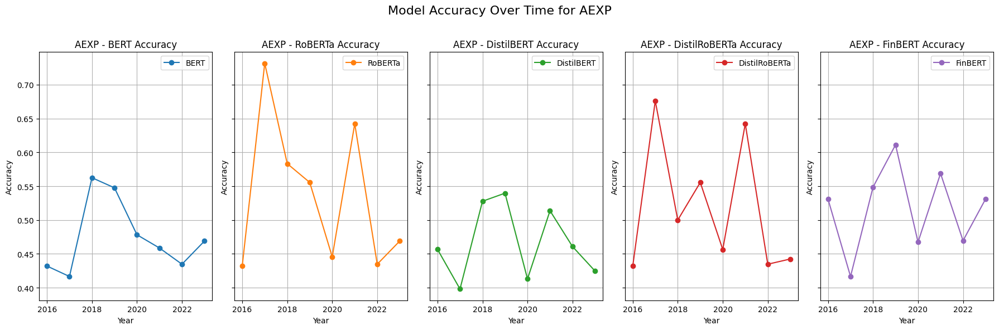

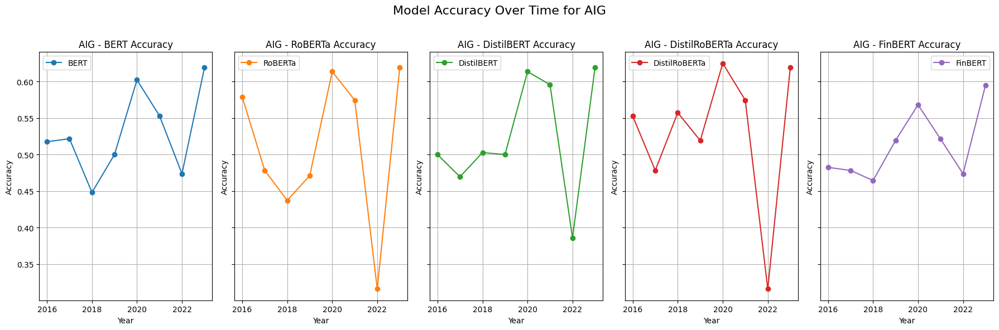

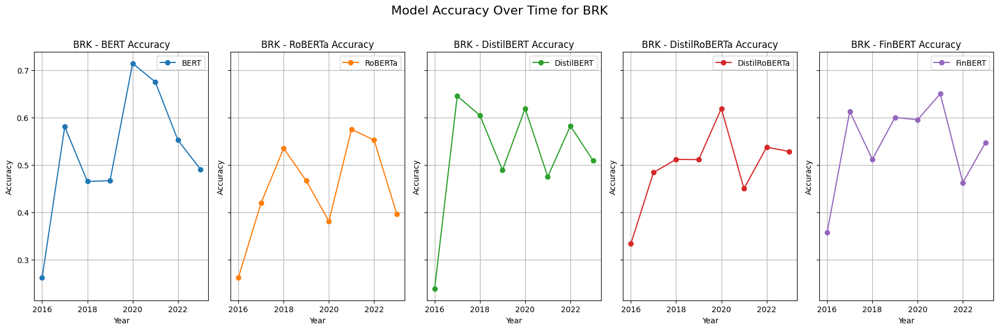

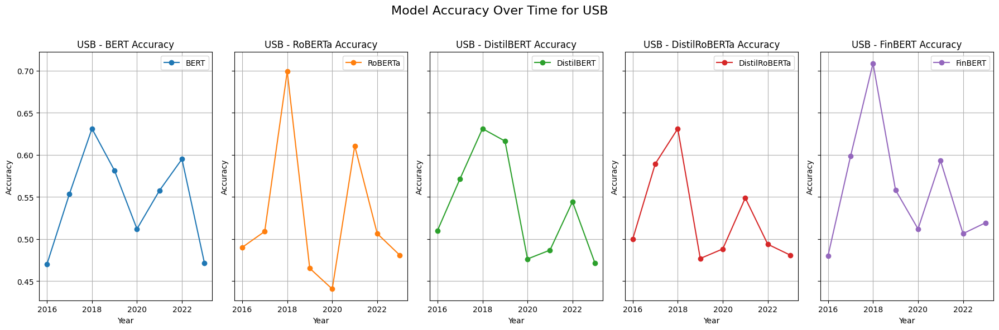

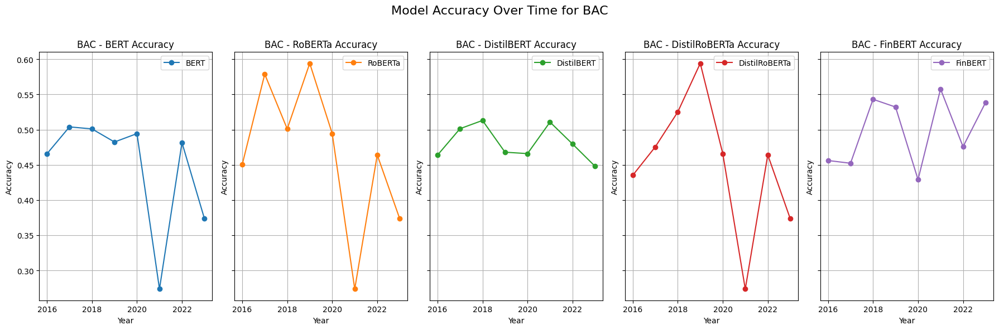

...

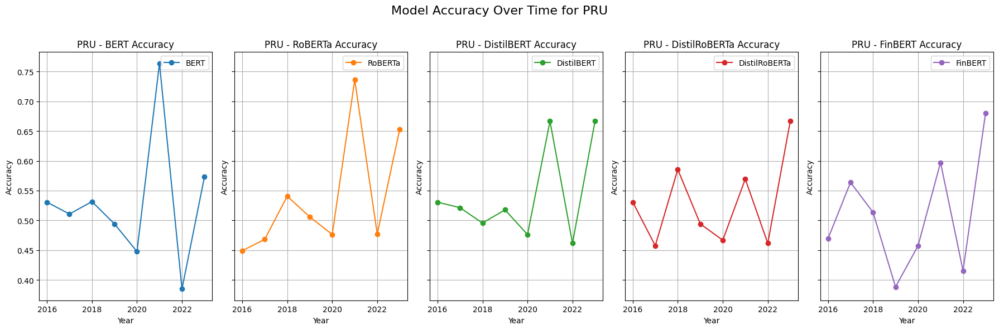

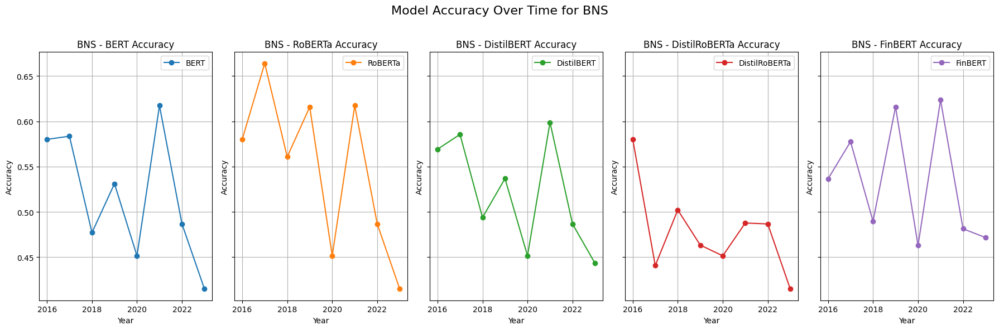

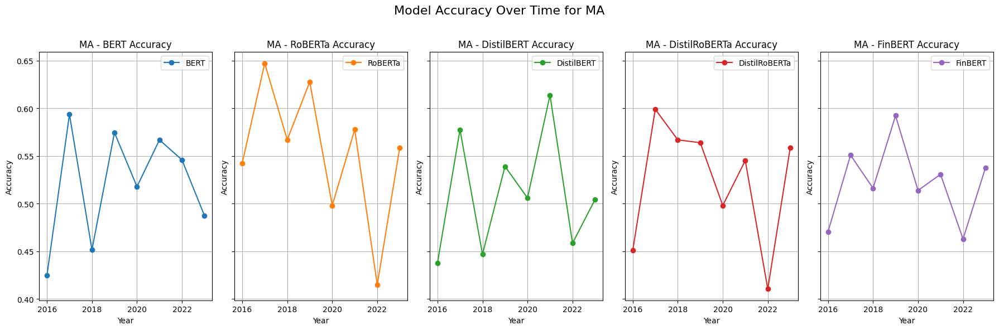

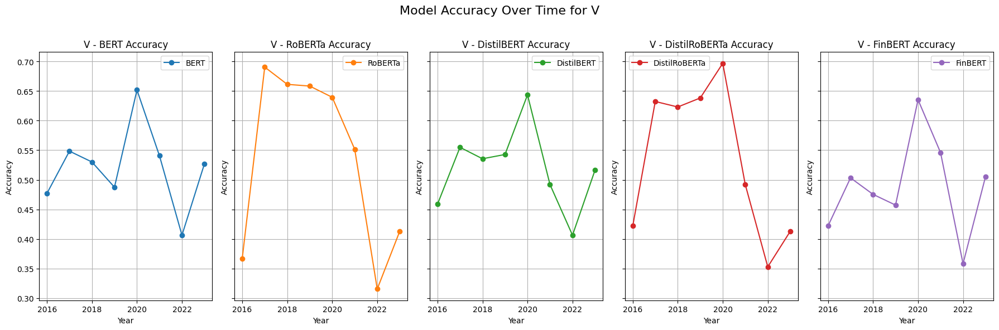

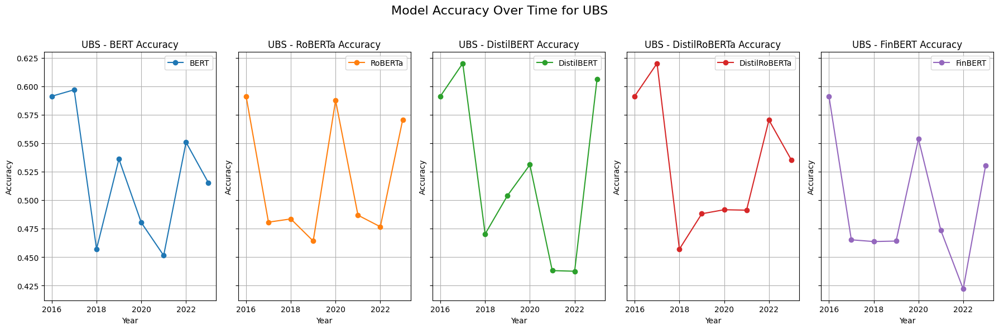

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Extract unique tickers from the DataFrame
tickers = finalv2['ticker'].unique()
tickers = [ticker for ticker in tickers if ticker != 'MS']
# Extract models
models = ['BERT', 'RoBERTa', 'DistilBERT', 'DistilRoBERTa', 'FinBERT']

# Loop through each ticker
for ticker in tickers:
    # Filter DataFrame for the current ticker
    ticker_df = finalv2[finalv2['ticker'] == ticker]

    # Plotting using matplotlib
    fig, axes = plt.subplots(nrows=1, ncols=len(models), figsize=(18, 6), sharey=True)

    # Iterate over each model
    for i, model in enumerate(models):
        ax = axes[i]
        model_data = ticker_df[['year', model]]
        ax.plot(model_data['year'], model_data[model], marker='o', color=f'C{i}', label=model)
        ax.set_xlabel('Year')
        ax.set_ylabel('Accuracy')
        ax.set_title(f'{ticker} - {model} Accuracy')
        ax.grid(True)
        ax.legend()

    # Adjust layout and show the plot for the current ticker
    plt.suptitle(f'Model Accuracy Over Time for {ticker}', fontsize=16)
    plt.tight_layout(rect=[0, 0, 1, 0.96])  # Adjust layout to make space for the title
    plt.show()


In [ ]:
# Extract unique tickers
tickers = finalv2['ticker'].unique()

##### Mean Accuracy and Best Model - Year wise

In [ ]:
# Compute the mean accuracy for each year for every model
mean_accuracies = final.groupby('year').mean().reset_index()

# Find the best model for each year
mean_accuracies['Best Model'] = mean_accuracies[['BERT', 'RoBERTa', 'DistilBERT', 'DistilRoBERTa', 'FinBERT']].idxmax(axis=1)

In [ ]:
mean_accuracies = mean_accuracies[['year','BERT','RoBERTa','DistilBERT','DistilRoBERTa','FinBERT','Best Model']]

In [ ]:
mean_accuracies

,year,BERT,RoBERTa,DistilBERT,DistilRoBERTa,FinBERT,Best Model
0,2016,0.480930,0.501002,0.489795,0.518975,0.474963,DistilRoBERTa
1,2017,0.521617,0.549227,0.535019,0.550375,0.522078,RoBERTa
2,2018,0.492628,0.531493,0.495207,0.535849,0.508537,RoBERTa
3,2019,0.493161,0.530136,0.505810,0.528411,0.519694,RoBERTa
4,2020,0.504393,0.505659,0.515422,0.521706,0.508226,DistilBERT
5,2021,0.516920,0.547933,0.521982,0.522009,0.526442,RoBERTa
6,2022,0.502946,0.488108,0.497974,0.503828,0.496395,BERT
7,2023,0.495853,0.508698,0.524230,0.519714,0.515971,DistilBERT


##### Mean Accuracy - Year wise visualisation

In [ ]:
df_long = mean_accuracies

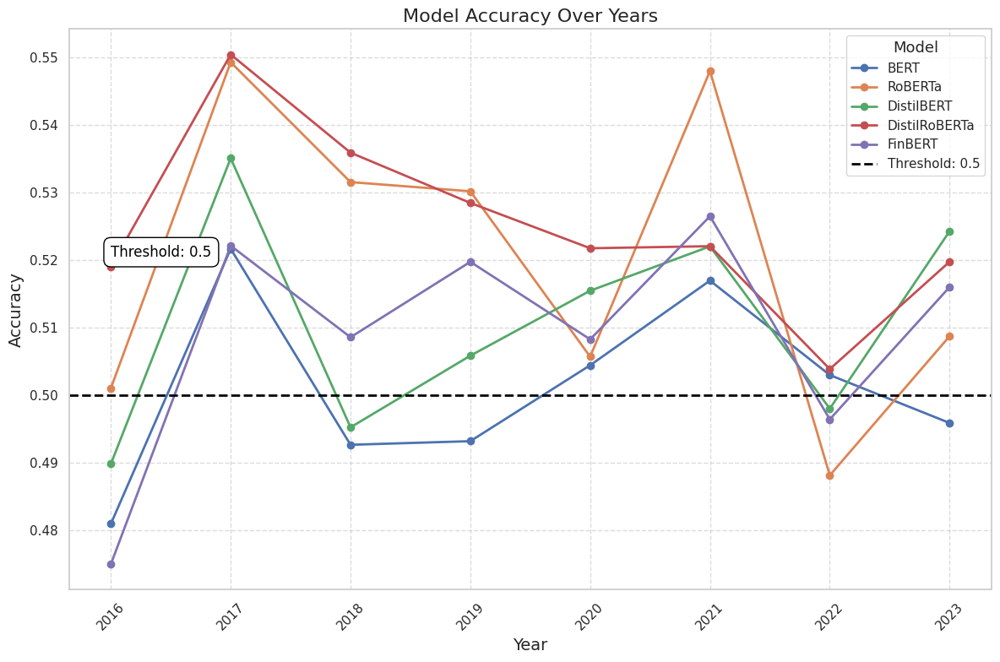

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Sample threshold value
threshold_value = 0.5

# Drop 'Best Model' column if it exists (uncomment if needed)
mean_accuracies_without_best = mean_accuracies.drop(columns=['Best Model'], errors='ignore')

# Melt the DataFrame to a long format
df_long = mean_accuracies_without_best.melt(id_vars='year', var_name='Model', value_name='Accuracy')

# Set up the matplotlib figure and seaborn style
plt.figure(figsize=(12, 8))
sns.set(style="whitegrid")

# Plot each model's accuracy over the years
for model in df_long['Model'].unique():
    model_data = df_long[df_long['Model'] == model]
    plt.plot(model_data['year'], model_data['Accuracy'], marker='o', linestyle='-', label=model, linewidth=2)

# Add a horizontal threshold line with enhanced styling
plt.axhline(y=threshold_value, color='black', linestyle='--', linewidth=2, label=f'Threshold: {threshold_value}')

# Annotate the threshold line
plt.text(df_long['year'].min(), threshold_value + 0.02, f'Threshold: {threshold_value}',
         color='black', fontsize=12, ha='left', va='bottom', bbox=dict(facecolor='white', edgecolor='black', boxstyle='round,pad=0.5'))

# Add title and labels
plt.title('Model Accuracy Over Years', fontsize=16)
plt.xlabel('Year', fontsize=14)
plt.ylabel('Accuracy', fontsize=14)
plt.legend(title='Model', title_fontsize='13', fontsize='11')
plt.grid(True, linestyle='--', alpha=0.7)

# Adjust x-axis ticks for better readability
plt.xticks(rotation=45)

# Show plot
plt.tight_layout()
plt.show()


##### Overall Model accuracy

In [ ]:
mean_accuracies

,year,BERT,RoBERTa,DistilBERT,DistilRoBERTa,FinBERT,Best Model
0,2016,0.480930,0.501002,0.489795,0.518975,0.474963,DistilRoBERTa
1,2017,0.521617,0.549227,0.535019,0.550375,0.522078,RoBERTa
2,2018,0.492628,0.531493,0.495207,0.535849,0.508537,RoBERTa
3,2019,0.493161,0.530136,0.505810,0.528411,0.519694,RoBERTa
4,2020,0.504393,0.505659,0.515422,0.521706,0.508226,DistilBERT
5,2021,0.516920,0.547933,0.521982,0.522009,0.526442,RoBERTa
6,2022,0.502946,0.488108,0.497974,0.503828,0.496395,BERT
7,2023,0.495853,0.508698,0.524230,0.519714,0.515971,DistilBERT


In [ ]:
# Compute the mean accuracy for each model
mean_model_accuracies = mean_accuracies[['BERT', 'RoBERTa', 'DistilBERT', 'DistilRoBERTa', 'FinBERT']].mean().reset_index()

# Rename columns for clarity
mean_model_accuracies.columns = ['Model', 'Mean Accuracy']

mean_model_accuracies

,Model,Mean Accuracy
0,BERT,0.501056
1,RoBERTa,0.520282
2,DistilBERT,0.510680
3,DistilRoBERTa,0.525109
4,FinBERT,0.509038


#####Ticker-wise accuracy and best model

In [ ]:
# Group by permco and calculate the mean for each model
mean_accuracies_permco = final.groupby('permco').mean().reset_index()

# Drop the 'year' column as it's not needed for the mean calculation
mean_accuracies_permco = mean_accuracies_permco.drop(columns=['year'])

In [ ]:
# Merge the mapping with the final accuracy dataframe
mean_accuracies_permco = mean_accuracies_permco.merge(permco_to_ticker, on='permco', how='left')
mean_accuracies_permco = mean_accuracies_permco[['ticker','BERT', 'RoBERTa', 'DistilBERT', 'DistilRoBERTa', 'FinBERT']]

# Find the best model for each year
mean_accuracies_permco['Best Model'] = mean_accuracies_permco[['BERT', 'RoBERTa', 'DistilBERT', 'DistilRoBERTa', 'FinBERT']].idxmax(axis=1)

In [ ]:
mean_accuracies_permco = mean_accuracies_permco[mean_accuracies_permco['ticker']!= 'MS']

In [ ]:
mean_accuracies_permco

,ticker,BERT,RoBERTa,DistilBERT,DistilRoBERTa,FinBERT,Best Model
0,AEXP,0.474959,0.536767,0.466856,0.517446,0.517999,RoBERTa
1,AIG,0.529446,0.511058,0.523336,0.530226,0.512851,DistilRoBERTa
2,BRK,0.525803,0.448403,0.520296,0.496826,0.542096,FinBERT
3,USB,0.546444,0.525158,0.538394,0.526038,0.559435,FinBERT
4,BAC,0.446951,0.466200,0.481267,0.450827,0.498042,FinBERT
5,UNH,0.490832,0.489473,0.515373,0.529665,0.472687,DistilRoBERTa
6,BK,0.533078,0.523634,0.479841,0.497497,0.467347,BERT
7,CHL,0.523885,0.523885,0.519530,0.523885,0.515514,BERT
8,C,0.504799,0.500004,0.496795,0.507568,0.499515,DistilRoBERTa
9,DHR,0.472743,0.533908,0.483066,0.500930,0.470128,RoBERTa


#####Frequency of Best Model

In [ ]:
import plotly.express as px
import pandas as pd

fig = px.histogram(
    mean_accuracies_permco,
    x='Best Model',
    title='Frequency of Best Models',
    labels={'Best Model': 'Model', 'count': 'Count'},
    color='Best Model'
)

# Adjust the size
fig.update_layout(
    width=800,
    height=600
)

# Show the count on top of each bin
fig.update_traces(texttemplate='%{y}', textposition='outside')

fig.show()

##### Accuracies of Model by ticker

In [ ]:
mean_accuracies_permco = mean_accuracies_permco[mean_accuracies_permco['ticker']!= 'MS']

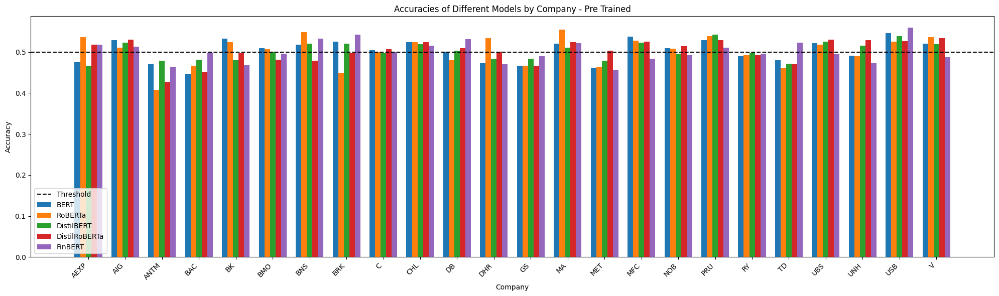

In [ ]:
# Filter out rows where all accuracies are NaN
merged_df = mean_accuracies_permco.dropna(subset=['BERT', 'RoBERTa', 'DistilBERT', 'DistilRoBERTa', 'FinBERT'], how='all')

# Sort by 'ticker' for better visualization
merged_df = merged_df.sort_values(by='ticker')

# Prepare data for plotting
models = ['BERT', 'RoBERTa', 'DistilBERT', 'DistilRoBERTa', 'FinBERT']
x = np.arange(len(merged_df['ticker']))  # the label locations
width = 0.15  # the width of the bars

# Plotting
fig, ax = plt.subplots(figsize=(20, 6))

# Plot each model's bar
for i, model in enumerate(models):
    ax.bar(x + i*width, merged_df[model], width, label=model)

# Add a threshold line
threshold = 0.5
ax.axhline(y=threshold, color='black', linestyle='--', label='Threshold')

# Customize the plot
ax.set_title('Accuracies of Different Models by Company - Pre Trained')
ax.set_xlabel('Company')
ax.set_ylabel('Accuracy')
ax.set_xticks(x + width * (len(models) - 1) / 2)
ax.set_xticklabels(merged_df['ticker'], rotation=45, ha='right')
ax.legend()

# Show plot
plt.tight_layout()
plt.show()

#Step 7: SENTIMENT SCORES - ROLLING

####BERT

In [ ]:
def predict_sentiment(model, tokenizer, texts):
    encodings = tokenizer(texts, truncation=True, padding='max_length', max_length=512, return_tensors='pt')
    input_ids = encodings['input_ids'].to(model.device)
    attention_mask = encodings['attention_mask'].to(model.device)

    with torch.no_grad():
        outputs = model(input_ids, attention_mask=attention_mask)
        logits = outputs.logits
        probs = torch.nn.functional.softmax(logits, dim=-1)

    return probs[:, 1].cpu().numpy()  # Assuming class 1 is positive sentiment

# Directory containing fine-tuned models
#model_base_path = '/content/drive/MyDrive/PostGrad/Projects/Fine-Tuned-Model-Rolling/bert-base-uncased'
model_base_path = f'{base_path}/BM16_LLMs/Finance/models/fine-tuned/bert-base-uncased'

# Predict sentiment scores for out-sample data permco-wise
out_sample_structured['sentiment_score_BERT'] = np.nan

permcos = out_sample_structured['permco'].unique()
for permco in permcos:
    print(f"Processing permco: {permco}")

    # Extract unique start dates for the current permco
    start_dates = out_sample_structured[out_sample_structured['permco'] == permco]['start_date'].dt.year.unique()

    for year in start_dates:
        print(f"Processing year: {year}")

        # Load the model and tokenizer for the current permco and year
        model_path = f"{model_base_path}/{permco}/{year}"
        model = BertForSequenceClassification.from_pretrained(model_path)
        tokenizer = BertTokenizer.from_pretrained(model_path)
        device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        model.to(device)
        model.eval()

        # Filter out-sample data for the current permco and year
        permco_year_data = out_sample_structured[(out_sample_structured['permco'] == permco) & (out_sample_structured['start_date'].dt.year == year)]
        texts = permco_year_data['headline'].tolist()

        # Predict sentiment scores with progress bar
        permco_scores = []
        for i in tqdm(range(0, len(texts), 32), desc=f"Scoring headlines for permco {permco}, year {year}"):
            batch_texts = texts[i:i+32]
            batch_scores = predict_sentiment(model, tokenizer, batch_texts)
            permco_scores.extend(batch_scores)

        # Update the sentiment scores in the dataframe
        out_sample_structured.loc[(out_sample_structured['permco'] == permco) & (out_sample_structured['start_date'].dt.year == year), 'sentiment_score_BERT'] = permco_scores

# Display the updated dataframe with sentiment scores
out_sample_structured


Processing permco: 90
Processing year: 2016


Scoring headlines for permco 90, year 2016: 100%|██████████| 3/3 [00:02<00:00,  1.26it/s]


Processing year: 2017


Scoring headlines for permco 90, year 2017: 100%|██████████| 4/4 [00:01<00:00,  2.90it/s]


Processing year: 2018


Scoring headlines for permco 90, year 2018: 100%|██████████| 5/5 [00:01<00:00,  2.70it/s]


Processing year: 2019


Scoring headlines for permco 90, year 2019: 100%|██████████| 4/4 [00:01<00:00,  2.47it/s]


Processing year: 2020


Scoring headlines for permco 90, year 2020: 100%|██████████| 3/3 [00:01<00:00,  2.51it/s]


Processing year: 2021


Scoring headlines for permco 90, year 2021: 100%|██████████| 4/4 [00:01<00:00,  2.85it/s]


Processing year: 2022


Scoring headlines for permco 90, year 2022: 100%|██████████| 4/4 [00:01<00:00,  2.69it/s]


Processing year: 2023


Scoring headlines for permco 90, year 2023: 100%|██████████| 4/4 [00:01<00:00,  2.71it/s]


Processing permco: 137
Processing year: 2016


Scoring headlines for permco 137, year 2016: 100%|██████████| 4/4 [00:01<00:00,  2.69it/s]


Processing year: 2017


Scoring headlines for permco 137, year 2017: 100%|██████████| 4/4 [00:01<00:00,  2.64it/s]


Processing year: 2018


Scoring headlines for permco 137, year 2018: 100%|██████████| 6/6 [00:02<00:00,  2.46it/s]


Processing year: 2019


Scoring headlines for permco 137, year 2019: 100%|██████████| 4/4 [00:01<00:00,  2.91it/s]


Processing year: 2020


Scoring headlines for permco 137, year 2020: 100%|██████████| 3/3 [00:01<00:00,  2.58it/s]


Processing year: 2021


Scoring headlines for permco 137, year 2021: 100%|██████████| 3/3 [00:01<00:00,  2.40it/s]


Processing year: 2022


Scoring headlines for permco 137, year 2022: 100%|██████████| 2/2 [00:00<00:00,  2.68it/s]


Processing year: 2023


Scoring headlines for permco 137, year 2023: 100%|██████████| 3/3 [00:01<00:00,  2.68it/s]


Processing permco: 540
Processing year: 2016


Scoring headlines for permco 540, year 2016: 100%|██████████| 2/2 [00:00<00:00,  3.66it/s]


Processing year: 2017


Scoring headlines for permco 540, year 2017: 100%|██████████| 1/1 [00:00<00:00,  2.41it/s]


Processing year: 2018


Scoring headlines for permco 540, year 2018: 100%|██████████| 2/2 [00:00<00:00,  3.54it/s]


Processing year: 2019


Scoring headlines for permco 540, year 2019: 100%|██████████| 2/2 [00:00<00:00,  3.43it/s]


Processing year: 2020


Scoring headlines for permco 540, year 2020: 100%|██████████| 2/2 [00:00<00:00,  3.64it/s]


Processing year: 2021


Scoring headlines for permco 540, year 2021: 100%|██████████| 2/2 [00:00<00:00,  3.82it/s]


Processing year: 2022


Scoring headlines for permco 540, year 2022: 100%|██████████| 3/3 [00:00<00:00,  3.40it/s]


Processing year: 2023


Scoring headlines for permco 540, year 2023: 100%|██████████| 2/2 [00:00<00:00,  2.83it/s]


Processing permco: 1645
Processing year: 2016


Scoring headlines for permco 1645, year 2016: 100%|██████████| 4/4 [00:01<00:00,  3.01it/s]


Processing year: 2017


Scoring headlines for permco 1645, year 2017: 100%|██████████| 4/4 [00:01<00:00,  2.65it/s]


Processing year: 2018


Scoring headlines for permco 1645, year 2018: 100%|██████████| 4/4 [00:01<00:00,  2.89it/s]


Processing year: 2019


Scoring headlines for permco 1645, year 2019: 100%|██████████| 3/3 [00:01<00:00,  2.59it/s]


Processing year: 2020


Scoring headlines for permco 1645, year 2020: 100%|██████████| 3/3 [00:01<00:00,  2.65it/s]


Processing year: 2021


Scoring headlines for permco 1645, year 2021: 100%|██████████| 4/4 [00:01<00:00,  2.61it/s]


Processing year: 2022


Scoring headlines for permco 1645, year 2022: 100%|██████████| 3/3 [00:01<00:00,  2.84it/s]


Processing year: 2023


Scoring headlines for permco 1645, year 2023: 100%|██████████| 4/4 [00:01<00:00,  2.84it/s]


Processing permco: 3151
Processing year: 2016


Scoring headlines for permco 3151, year 2016: 100%|██████████| 17/17 [00:07<00:00,  2.37it/s]


Processing year: 2017


Scoring headlines for permco 3151, year 2017: 100%|██████████| 13/13 [00:05<00:00,  2.43it/s]


Processing year: 2018


Scoring headlines for permco 3151, year 2018: 100%|██████████| 16/16 [00:06<00:00,  2.42it/s]


Processing year: 2019


Scoring headlines for permco 3151, year 2019: 100%|██████████| 16/16 [00:06<00:00,  2.42it/s]


Processing year: 2020


Scoring headlines for permco 3151, year 2020: 100%|██████████| 11/11 [00:04<00:00,  2.28it/s]


Processing year: 2021


Scoring headlines for permco 3151, year 2021: 100%|██████████| 15/15 [00:06<00:00,  2.39it/s]


Processing year: 2022


Scoring headlines for permco 3151, year 2022: 100%|██████████| 17/17 [00:07<00:00,  2.39it/s]


Processing year: 2023


Scoring headlines for permco 3151, year 2023: 100%|██████████| 14/14 [00:06<00:00,  2.28it/s]


Processing permco: 7267
Processing year: 2016


Scoring headlines for permco 7267, year 2016: 100%|██████████| 3/3 [00:00<00:00,  3.17it/s]


Processing year: 2017


Scoring headlines for permco 7267, year 2017: 100%|██████████| 4/4 [00:01<00:00,  2.79it/s]


Processing year: 2018


Scoring headlines for permco 7267, year 2018: 100%|██████████| 5/5 [00:01<00:00,  2.67it/s]


Processing year: 2019


Scoring headlines for permco 7267, year 2019: 100%|██████████| 4/4 [00:01<00:00,  2.47it/s]


Processing year: 2020


Scoring headlines for permco 7267, year 2020: 100%|██████████| 5/5 [00:01<00:00,  2.74it/s]


Processing year: 2021


Scoring headlines for permco 7267, year 2021: 100%|██████████| 5/5 [00:01<00:00,  2.57it/s]


Processing year: 2022


Scoring headlines for permco 7267, year 2022: 100%|██████████| 3/3 [00:01<00:00,  2.55it/s]


Processing year: 2023


Scoring headlines for permco 7267, year 2023: 100%|██████████| 3/3 [00:00<00:00,  3.37it/s]


Processing permco: 20265
Processing year: 2016


Scoring headlines for permco 20265, year 2016: 100%|██████████| 4/4 [00:01<00:00,  2.39it/s]


Processing year: 2017


Scoring headlines for permco 20265, year 2017: 100%|██████████| 5/5 [00:01<00:00,  2.66it/s]


Processing year: 2018


Scoring headlines for permco 20265, year 2018: 100%|██████████| 5/5 [00:02<00:00,  2.36it/s]


Processing year: 2019


Scoring headlines for permco 20265, year 2019: 100%|██████████| 5/5 [00:01<00:00,  2.78it/s]


Processing year: 2020


Scoring headlines for permco 20265, year 2020: 100%|██████████| 5/5 [00:01<00:00,  2.63it/s]


Processing year: 2021


Scoring headlines for permco 20265, year 2021: 100%|██████████| 6/6 [00:02<00:00,  2.51it/s]


Processing year: 2022


Scoring headlines for permco 20265, year 2022: 100%|██████████| 4/4 [00:01<00:00,  2.29it/s]


Processing year: 2023


Scoring headlines for permco 20265, year 2023: 100%|██████████| 4/4 [00:01<00:00,  2.98it/s]


Processing permco: 20436
Processing year: 2016


Scoring headlines for permco 20436, year 2016: 100%|██████████| 32/32 [00:13<00:00,  2.29it/s]


Processing year: 2017


Scoring headlines for permco 20436, year 2017: 100%|██████████| 19/19 [00:08<00:00,  2.37it/s]


Processing year: 2018


Scoring headlines for permco 20436, year 2018: 100%|██████████| 19/19 [00:08<00:00,  2.29it/s]


Processing year: 2019


Scoring headlines for permco 20436, year 2019: 100%|██████████| 19/19 [00:08<00:00,  2.33it/s]


Processing year: 2020


Scoring headlines for permco 20436, year 2020: 100%|██████████| 18/18 [00:07<00:00,  2.31it/s]


Processing year: 2021


Scoring headlines for permco 20436, year 2021: 100%|██████████| 20/20 [00:08<00:00,  2.30it/s]


Processing year: 2022


Scoring headlines for permco 20436, year 2022: 100%|██████████| 18/18 [00:07<00:00,  2.32it/s]


Processing year: 2023


Scoring headlines for permco 20436, year 2023: 100%|██████████| 21/21 [00:09<00:00,  2.30it/s]


Processing permco: 20483
Processing year: 2016


Scoring headlines for permco 20483, year 2016: 100%|██████████| 23/23 [00:10<00:00,  2.26it/s]


Processing year: 2017


Scoring headlines for permco 20483, year 2017: 100%|██████████| 20/20 [00:08<00:00,  2.34it/s]


Processing year: 2018


Scoring headlines for permco 20483, year 2018: 100%|██████████| 22/22 [00:09<00:00,  2.30it/s]


Processing year: 2019


Scoring headlines for permco 20483, year 2019: 100%|██████████| 22/22 [00:09<00:00,  2.26it/s]


Processing year: 2020


Scoring headlines for permco 20483, year 2020: 100%|██████████| 18/18 [00:07<00:00,  2.36it/s]


Processing year: 2021


Scoring headlines for permco 20483, year 2021: 100%|██████████| 20/20 [00:08<00:00,  2.22it/s]


Processing year: 2022


Scoring headlines for permco 20483, year 2022: 100%|██████████| 18/18 [00:07<00:00,  2.29it/s]


Processing year: 2023


Scoring headlines for permco 20483, year 2023: 100%|██████████| 15/15 [00:06<00:00,  2.26it/s]


Processing permco: 20557
Processing year: 2016


Scoring headlines for permco 20557, year 2016: 100%|██████████| 3/3 [00:00<00:00,  3.03it/s]


Processing year: 2017


Scoring headlines for permco 20557, year 2017: 100%|██████████| 2/2 [00:00<00:00,  2.99it/s]


Processing year: 2018


Scoring headlines for permco 20557, year 2018: 100%|██████████| 2/2 [00:00<00:00,  2.61it/s]


Processing year: 2019


Scoring headlines for permco 20557, year 2019: 100%|██████████| 3/3 [00:01<00:00,  2.44it/s]


Processing year: 2020


Scoring headlines for permco 20557, year 2020: 100%|██████████| 4/4 [00:01<00:00,  2.74it/s]


Processing year: 2021


Scoring headlines for permco 20557, year 2021: 100%|██████████| 3/3 [00:01<00:00,  2.56it/s]


Processing year: 2022


Scoring headlines for permco 20557, year 2022: 100%|██████████| 2/2 [00:00<00:00,  2.59it/s]


Processing year: 2023


Scoring headlines for permco 20557, year 2023: 100%|██████████| 3/3 [00:01<00:00,  2.97it/s]


Processing permco: 21224
Processing year: 2016


Scoring headlines for permco 21224, year 2016: 100%|██████████| 1/1 [00:00<00:00, 75.64it/s]


Processing permco: 21305
Processing year: 2016


Scoring headlines for permco 21305, year 2016: 100%|██████████| 18/18 [00:07<00:00,  2.32it/s]


Processing year: 2017


Scoring headlines for permco 21305, year 2017: 100%|██████████| 18/18 [00:08<00:00,  2.22it/s]


Processing year: 2018


Scoring headlines for permco 21305, year 2018: 100%|██████████| 12/12 [00:05<00:00,  2.29it/s]


Processing year: 2019


Scoring headlines for permco 21305, year 2019: 100%|██████████| 11/11 [00:04<00:00,  2.36it/s]


Processing year: 2020


Scoring headlines for permco 21305, year 2020: 100%|██████████| 12/12 [00:04<00:00,  2.42it/s]


Processing year: 2021


Scoring headlines for permco 21305, year 2021: 100%|██████████| 8/8 [00:03<00:00,  2.48it/s]


Processing year: 2022


Scoring headlines for permco 21305, year 2022: 100%|██████████| 9/9 [00:04<00:00,  2.23it/s]


Processing year: 2023


Scoring headlines for permco 21305, year 2023: 100%|██████████| 9/9 [00:03<00:00,  2.38it/s]


Processing permco: 29146
Processing year: 2016


Scoring headlines for permco 29146, year 2016: 100%|██████████| 23/23 [00:10<00:00,  2.28it/s]


Processing year: 2017


Scoring headlines for permco 29146, year 2017: 100%|██████████| 23/23 [00:10<00:00,  2.28it/s]


Processing year: 2018


Scoring headlines for permco 29146, year 2018: 100%|██████████| 7/7 [00:02<00:00,  2.49it/s]


Processing year: 2019


Scoring headlines for permco 29146, year 2019: 100%|██████████| 6/6 [00:02<00:00,  2.27it/s]


Processing year: 2020


Scoring headlines for permco 29146, year 2020: 100%|██████████| 7/7 [00:02<00:00,  2.66it/s]


Processing year: 2021


Scoring headlines for permco 29146, year 2021: 100%|██████████| 5/5 [00:02<00:00,  2.45it/s]


Processing year: 2022


Scoring headlines for permco 29146, year 2022: 100%|██████████| 9/9 [00:04<00:00,  2.21it/s]


Processing year: 2023


Scoring headlines for permco 29146, year 2023: 100%|██████████| 10/10 [00:04<00:00,  2.24it/s]


Processing permco: 29151
Processing year: 2016


Scoring headlines for permco 29151, year 2016: 100%|██████████| 29/29 [00:12<00:00,  2.31it/s]


Processing year: 2017


Scoring headlines for permco 29151, year 2017: 100%|██████████| 25/25 [00:11<00:00,  2.21it/s]


Processing year: 2018


Scoring headlines for permco 29151, year 2018: 100%|██████████| 7/7 [00:03<00:00,  2.26it/s]


Processing year: 2019


Scoring headlines for permco 29151, year 2019: 100%|██████████| 7/7 [00:02<00:00,  2.44it/s]


Processing year: 2020


Scoring headlines for permco 29151, year 2020: 100%|██████████| 6/6 [00:02<00:00,  2.68it/s]


Processing year: 2021


Scoring headlines for permco 29151, year 2021: 100%|██████████| 5/5 [00:02<00:00,  2.48it/s]


Processing year: 2022


Scoring headlines for permco 29151, year 2022: 100%|██████████| 10/10 [00:04<00:00,  2.25it/s]


Processing year: 2023


Scoring headlines for permco 29151, year 2023: 100%|██████████| 13/13 [00:05<00:00,  2.25it/s]


Processing permco: 29152
Processing year: 2016


Scoring headlines for permco 29152, year 2016: 100%|██████████| 12/12 [00:05<00:00,  2.35it/s]


Processing year: 2017


Scoring headlines for permco 29152, year 2017: 100%|██████████| 11/11 [00:04<00:00,  2.32it/s]


Processing year: 2018


Scoring headlines for permco 29152, year 2018: 100%|██████████| 9/9 [00:03<00:00,  2.34it/s]


Processing year: 2019


Scoring headlines for permco 29152, year 2019: 100%|██████████| 8/8 [00:03<00:00,  2.48it/s]


Processing year: 2020


Scoring headlines for permco 29152, year 2020: 100%|██████████| 5/5 [00:01<00:00,  2.59it/s]


Processing year: 2021


Scoring headlines for permco 29152, year 2021: 100%|██████████| 7/7 [00:02<00:00,  2.35it/s]


Processing year: 2022


Scoring headlines for permco 29152, year 2022: 100%|██████████| 12/12 [00:05<00:00,  2.38it/s]


Processing year: 2023


Scoring headlines for permco 29152, year 2023: 100%|██████████| 14/14 [00:06<00:00,  2.28it/s]


Processing permco: 35048
Processing year: 2016


Scoring headlines for permco 35048, year 2016: 100%|██████████| 22/22 [00:09<00:00,  2.21it/s]


Processing year: 2017


Scoring headlines for permco 35048, year 2017: 100%|██████████| 17/17 [00:07<00:00,  2.36it/s]


Processing year: 2018


Scoring headlines for permco 35048, year 2018: 100%|██████████| 19/19 [00:08<00:00,  2.36it/s]


Processing year: 2019


Scoring headlines for permco 35048, year 2019: 100%|██████████| 15/15 [00:06<00:00,  2.32it/s]


Processing year: 2020


Scoring headlines for permco 35048, year 2020: 100%|██████████| 11/11 [00:04<00:00,  2.29it/s]


Processing year: 2021


Scoring headlines for permco 35048, year 2021: 100%|██████████| 18/18 [00:07<00:00,  2.31it/s]


Processing year: 2022


Scoring headlines for permco 35048, year 2022: 100%|██████████| 19/19 [00:08<00:00,  2.23it/s]


Processing year: 2023


Scoring headlines for permco 35048, year 2023: 100%|██████████| 18/18 [00:07<00:00,  2.26it/s]


Processing permco: 35276
Processing year: 2016


Scoring headlines for permco 35276, year 2016: 100%|██████████| 3/3 [00:01<00:00,  2.41it/s]


Processing year: 2017


Scoring headlines for permco 35276, year 2017: 100%|██████████| 3/3 [00:01<00:00,  2.64it/s]


Processing year: 2018


Scoring headlines for permco 35276, year 2018: 100%|██████████| 3/3 [00:01<00:00,  2.40it/s]


Processing year: 2019


Scoring headlines for permco 35276, year 2019: 100%|██████████| 3/3 [00:01<00:00,  2.87it/s]


Processing year: 2020


Scoring headlines for permco 35276, year 2020: 100%|██████████| 3/3 [00:00<00:00,  3.20it/s]


Processing year: 2021


Scoring headlines for permco 35276, year 2021: 100%|██████████| 3/3 [00:01<00:00,  2.97it/s]


Processing year: 2022


Scoring headlines for permco 35276, year 2022: 100%|██████████| 2/2 [00:00<00:00,  2.41it/s]


Processing year: 2023


Scoring headlines for permco 35276, year 2023: 100%|██████████| 3/3 [00:01<00:00,  2.77it/s]


Processing permco: 37138
Processing year: 2016


Scoring headlines for permco 37138, year 2016: 100%|██████████| 4/4 [00:01<00:00,  2.91it/s]


Processing year: 2017


Scoring headlines for permco 37138, year 2017: 100%|██████████| 4/4 [00:01<00:00,  2.33it/s]


Processing year: 2018


Scoring headlines for permco 37138, year 2018: 100%|██████████| 4/4 [00:01<00:00,  2.47it/s]


Processing year: 2019


Scoring headlines for permco 37138, year 2019: 100%|██████████| 4/4 [00:01<00:00,  2.75it/s]


Processing year: 2020


Scoring headlines for permco 37138, year 2020: 100%|██████████| 3/3 [00:01<00:00,  2.99it/s]


Processing year: 2021


Scoring headlines for permco 37138, year 2021: 100%|██████████| 3/3 [00:01<00:00,  2.62it/s]


Processing year: 2022


Scoring headlines for permco 37138, year 2022: 100%|██████████| 3/3 [00:00<00:00,  3.37it/s]


Processing year: 2023


Scoring headlines for permco 37138, year 2023: 100%|██████████| 3/3 [00:00<00:00,  3.29it/s]


Processing permco: 42273
Processing year: 2016


Scoring headlines for permco 42273, year 2016: 100%|██████████| 2/2 [00:00<00:00,  3.69it/s]


Processing year: 2017


Scoring headlines for permco 42273, year 2017: 100%|██████████| 3/3 [00:01<00:00,  2.64it/s]


Processing year: 2018


Scoring headlines for permco 42273, year 2018: 100%|██████████| 3/3 [00:01<00:00,  2.64it/s]


Processing year: 2019


Scoring headlines for permco 42273, year 2019: 100%|██████████| 3/3 [00:01<00:00,  2.68it/s]


Processing year: 2020


Scoring headlines for permco 42273, year 2020: 100%|██████████| 3/3 [00:01<00:00,  2.68it/s]


Processing year: 2021


Scoring headlines for permco 42273, year 2021: 100%|██████████| 4/4 [00:01<00:00,  2.30it/s]


Processing year: 2022


Scoring headlines for permco 42273, year 2022: 100%|██████████| 3/3 [00:01<00:00,  2.25it/s]


Processing year: 2023


Scoring headlines for permco 42273, year 2023: 100%|██████████| 3/3 [00:01<00:00,  2.22it/s]


Processing permco: 42291
Processing year: 2016


Scoring headlines for permco 42291, year 2016: 100%|██████████| 15/15 [00:06<00:00,  2.35it/s]


Processing year: 2017


Scoring headlines for permco 42291, year 2017: 100%|██████████| 14/14 [00:06<00:00,  2.30it/s]


Processing year: 2018


Scoring headlines for permco 42291, year 2018: 100%|██████████| 13/13 [00:05<00:00,  2.28it/s]


Processing year: 2019


Scoring headlines for permco 42291, year 2019: 100%|██████████| 10/10 [00:04<00:00,  2.41it/s]


Processing year: 2020


Scoring headlines for permco 42291, year 2020: 100%|██████████| 9/9 [00:03<00:00,  2.40it/s]


Processing year: 2021


Scoring headlines for permco 42291, year 2021: 100%|██████████| 6/6 [00:02<00:00,  2.33it/s]


Processing year: 2022


Scoring headlines for permco 42291, year 2022: 100%|██████████| 8/8 [00:03<00:00,  2.40it/s]


Processing year: 2023


Scoring headlines for permco 42291, year 2023: 100%|██████████| 9/9 [00:03<00:00,  2.46it/s]


Processing permco: 42524
Processing year: 2016


Scoring headlines for permco 42524, year 2016: 100%|██████████| 2/2 [00:00<00:00,  2.90it/s]


Processing year: 2017


Scoring headlines for permco 42524, year 2017: 100%|██████████| 3/3 [00:01<00:00,  2.32it/s]


Processing year: 2018


Scoring headlines for permco 42524, year 2018: 100%|██████████| 4/4 [00:01<00:00,  2.62it/s]


Processing year: 2019


Scoring headlines for permco 42524, year 2019: 100%|██████████| 3/3 [00:01<00:00,  2.51it/s]


Processing year: 2020


Scoring headlines for permco 42524, year 2020: 100%|██████████| 4/4 [00:01<00:00,  2.77it/s]


Processing year: 2021


Scoring headlines for permco 42524, year 2021: 100%|██████████| 3/3 [00:00<00:00,  3.05it/s]


Processing year: 2022


Scoring headlines for permco 42524, year 2022: 100%|██████████| 3/3 [00:00<00:00,  3.41it/s]


Processing year: 2023


Scoring headlines for permco 42524, year 2023: 100%|██████████| 3/3 [00:01<00:00,  2.92it/s]


Processing permco: 43264
Processing year: 2016


Scoring headlines for permco 43264, year 2016: 100%|██████████| 18/18 [00:07<00:00,  2.37it/s]


Processing year: 2017


Scoring headlines for permco 43264, year 2017: 100%|██████████| 16/16 [00:06<00:00,  2.29it/s]


Processing year: 2018


Scoring headlines for permco 43264, year 2018: 100%|██████████| 8/8 [00:03<00:00,  2.39it/s]


Processing year: 2019


Scoring headlines for permco 43264, year 2019: 100%|██████████| 6/6 [00:02<00:00,  2.42it/s]


Processing year: 2020


Scoring headlines for permco 43264, year 2020: 100%|██████████| 6/6 [00:02<00:00,  2.46it/s]


Processing year: 2021


Scoring headlines for permco 43264, year 2021: 100%|██████████| 6/6 [00:02<00:00,  2.67it/s]


Processing year: 2022


Scoring headlines for permco 43264, year 2022: 100%|██████████| 6/6 [00:02<00:00,  2.31it/s]


Processing year: 2023


Scoring headlines for permco 43264, year 2023: 100%|██████████| 6/6 [00:02<00:00,  2.44it/s]


Processing permco: 50700
Processing year: 2016


Scoring headlines for permco 50700, year 2016: 100%|██████████| 5/5 [00:02<00:00,  2.33it/s]


Processing year: 2017


Scoring headlines for permco 50700, year 2017: 100%|██████████| 6/6 [00:02<00:00,  2.30it/s]


Processing year: 2018


Scoring headlines for permco 50700, year 2018: 100%|██████████| 7/7 [00:03<00:00,  2.31it/s]


Processing year: 2019


Scoring headlines for permco 50700, year 2019: 100%|██████████| 9/9 [00:03<00:00,  2.30it/s]


Processing year: 2020


Scoring headlines for permco 50700, year 2020: 100%|██████████| 8/8 [00:03<00:00,  2.28it/s]


Processing year: 2021


Scoring headlines for permco 50700, year 2021: 100%|██████████| 9/9 [00:03<00:00,  2.32it/s]


Processing year: 2022


Scoring headlines for permco 50700, year 2022: 100%|██████████| 8/8 [00:03<00:00,  2.46it/s]


Processing year: 2023


Scoring headlines for permco 50700, year 2023: 100%|██████████| 8/8 [00:03<00:00,  2.37it/s]


Processing permco: 52983
Processing year: 2016


Scoring headlines for permco 52983, year 2016: 100%|██████████| 4/4 [00:01<00:00,  2.62it/s]


Processing year: 2017


Scoring headlines for permco 52983, year 2017: 100%|██████████| 5/5 [00:02<00:00,  2.29it/s]


Processing year: 2018


Scoring headlines for permco 52983, year 2018: 100%|██████████| 6/6 [00:02<00:00,  2.31it/s]


Processing year: 2019


Scoring headlines for permco 52983, year 2019: 100%|██████████| 7/7 [00:02<00:00,  2.50it/s]


Processing year: 2020


Scoring headlines for permco 52983, year 2020: 100%|██████████| 8/8 [00:03<00:00,  2.33it/s]


Processing year: 2021


Scoring headlines for permco 52983, year 2021: 100%|██████████| 6/6 [00:02<00:00,  2.33it/s]


Processing year: 2022


Scoring headlines for permco 52983, year 2022: 100%|██████████| 6/6 [00:02<00:00,  2.31it/s]


Processing year: 2023


Scoring headlines for permco 52983, year 2023: 100%|██████████| 6/6 [00:02<00:00,  2.37it/s]


Processing permco: 55100
Processing year: 2016


Scoring headlines for permco 55100, year 2016: 100%|██████████| 5/5 [00:01<00:00,  2.66it/s]


Processing year: 2017


Scoring headlines for permco 55100, year 2017: 100%|██████████| 5/5 [00:01<00:00,  2.81it/s]


Processing year: 2018


Scoring headlines for permco 55100, year 2018: 100%|██████████| 5/5 [00:02<00:00,  2.38it/s]


Processing year: 2019


Scoring headlines for permco 55100, year 2019: 100%|██████████| 4/4 [00:01<00:00,  2.32it/s]


Processing year: 2020


Scoring headlines for permco 55100, year 2020: 100%|██████████| 6/6 [00:02<00:00,  2.42it/s]


Processing year: 2021


Scoring headlines for permco 55100, year 2021: 100%|██████████| 8/8 [00:03<00:00,  2.53it/s]


Processing year: 2022


Scoring headlines for permco 55100, year 2022: 100%|██████████| 8/8 [00:03<00:00,  2.25it/s]


Processing year: 2023


Scoring headlines for permco 55100, year 2023: 100%|██████████| 7/7 [00:02<00:00,  2.54it/s]


,permco,ticker,start_date,end_date,announcedate,weekly_ret,adj_prc,headline,direction,label,sentiment_score_BERT
0,90,AEXP,2016-01-04,2016-01-08,NaN,-8.099980,63.63,No_Headlines,Up,1,0.613571
1,90,AEXP,2016-01-11,2016-01-15,2016-01-05,-1.131492,62.91,"American Express Company, Q4 2015 Earnings Cal...",Down,0,0.665805
2,90,AEXP,2016-01-11,2016-01-15,2016-01-05,-1.131492,62.91,"American Express Company to Report Q4, 2015 Re...",Down,0,0.671736
3,90,AEXP,2016-01-11,2016-01-15,2016-01-07,-1.131492,62.91,"Keefe, Bruyette, & Woods, Inc., Keefe, Bruyett...",Down,0,0.662681
4,90,AEXP,2016-01-18,2016-01-22,2016-01-13,-12.478209,55.06,"William Blair & Company, L.L.C., the William B...",Down,0,0.665451
...,...,...,...,...,...,...,...,...,...,...,...
46779,55100,UBS,2023-12-25,2023-12-29,2023-12-17,0.032307,30.90,CRH plc (NYSE:CRH) agreed to acquire 57% stake...,Up,1,0.261508
46780,55100,UBS,2023-12-25,2023-12-29,2023-12-17,0.032307,30.90,CRH plc (NYSE:CRH) agreed to acquire 57.3% sta...,Up,1,0.274058
46781,55100,UBS,2023-12-25,2023-12-29,2023-12-18,0.032307,30.90,"Ledman Optoelectronic Co., Ltd. announced that...",Up,1,0.469334
46782,55100,UBS,2023-12-25,2023-12-29,2023-12-19,0.032307,30.90,UBS Reportedly Wants to Sell Loans That Credit...,Up,1,0.489633


In [ ]:
out_sample_structured.to_csv("out_sample_structured_BERT_sentiment.csv",index=False)

In [ ]:
# Compute the average sentiment score for each permco
combined_score_BERT = out_sample_structured.groupby('permco')['sentiment_score_BERT'].mean().reset_index()

# Rename the column for clarity
combined_score_BERT.rename(columns={'sentiment_score': 'average_sentiment_score'}, inplace=True)

In [ ]:
combined_score_BERT.to_csv(f'{base_path}/BM16_LLMs/Finance/results/fine-tuned/combined_score_BERT.csv',index=False)

####RoBERTa

In [ ]:
import torch
from transformers import RobertaTokenizer, RobertaForSequenceClassification
import pandas as pd
import numpy as np
from tqdm import tqdm

def predict_sentiment(model, tokenizer, texts):
    encodings = tokenizer(texts, truncation=True, padding='max_length', max_length=512, return_tensors='pt')
    input_ids = encodings['input_ids'].to(model.device)
    attention_mask = encodings['attention_mask'].to(model.device)

    with torch.no_grad():
        outputs = model(input_ids, attention_mask=attention_mask)
        logits = outputs.logits
        probs = torch.nn.functional.softmax(logits, dim=-1)

    return probs[:, 1].cpu().numpy()  # Assuming class 1 is positive sentiment

# Directory containing fine-tuned models
model_base_path = f'{base_path}/BM16_LLMs/Finance/models/fine-tuned/roberta-base'
#model_base_path = '/content/drive/MyDrive/PostGrad/Projects/Fine-Tuned-Model-Rolling/roberta-base'

# Predict sentiment scores for out-sample data permco-wise
out_sample_structured['sentiment_score_RoBERTa'] = np.nan

permcos = out_sample_structured['permco'].unique()
for permco in permcos:
    print(f"Processing permco: {permco}")

    # Extract unique start dates for the current permco
    start_dates = out_sample_structured[out_sample_structured['permco'] == permco]['start_date'].dt.year.unique()

    for year in start_dates:
        print(f"Processing year: {year}")

        # Load the model and tokenizer for the current permco and year
        model_path = f"{model_base_path}/{permco}/{year}"
        model = RobertaForSequenceClassification.from_pretrained(model_path)
        tokenizer = RobertaTokenizer.from_pretrained(model_path)
        device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        model.to(device)
        model.eval()

        # Filter out-sample data for the current permco and year
        permco_year_data = out_sample_structured[(out_sample_structured['permco'] == permco) & (out_sample_structured['start_date'].dt.year == year)]
        texts = permco_year_data['headline'].tolist()

        # Predict sentiment scores with progress bar
        permco_scores = []
        for i in tqdm(range(0, len(texts), 32), desc=f"Scoring headlines for permco {permco}, year {year}"):
            batch_texts = texts[i:i+32]
            batch_scores = predict_sentiment(model, tokenizer, batch_texts)
            permco_scores.extend(batch_scores)

        # Update the sentiment scores in the dataframe
        out_sample_structured.loc[(out_sample_structured['permco'] == permco) & (out_sample_structured['start_date'].dt.year == year), 'sentiment_score_RoBERTa'] = permco_scores

# Display the updated dataframe with sentiment scores
out_sample_structured

Processing permco: 90
Processing year: 2016


Scoring headlines for permco 90, year 2016: 100%|██████████| 3/3 [00:01<00:00,  2.08it/s]


Processing year: 2017


Scoring headlines for permco 90, year 2017: 100%|██████████| 4/4 [00:01<00:00,  2.29it/s]


Processing year: 2018


Scoring headlines for permco 90, year 2018: 100%|██████████| 5/5 [00:02<00:00,  2.14it/s]


Processing year: 2019


Scoring headlines for permco 90, year 2019: 100%|██████████| 4/4 [00:02<00:00,  1.96it/s]


Processing year: 2020


Scoring headlines for permco 90, year 2020: 100%|██████████| 3/3 [00:01<00:00,  2.00it/s]


Processing year: 2021


Scoring headlines for permco 90, year 2021: 100%|██████████| 4/4 [00:01<00:00,  2.28it/s]


Processing year: 2022


Scoring headlines for permco 90, year 2022: 100%|██████████| 4/4 [00:01<00:00,  2.15it/s]


Processing year: 2023


Scoring headlines for permco 90, year 2023: 100%|██████████| 4/4 [00:01<00:00,  2.17it/s]


Processing permco: 137
Processing year: 2016


Scoring headlines for permco 137, year 2016: 100%|██████████| 4/4 [00:01<00:00,  2.16it/s]


Processing year: 2017


Scoring headlines for permco 137, year 2017: 100%|██████████| 4/4 [00:01<00:00,  2.15it/s]


Processing year: 2018


Scoring headlines for permco 137, year 2018: 100%|██████████| 6/6 [00:02<00:00,  2.02it/s]


Processing year: 2019


Scoring headlines for permco 137, year 2019: 100%|██████████| 4/4 [00:01<00:00,  2.37it/s]


Processing year: 2020


Scoring headlines for permco 137, year 2020: 100%|██████████| 3/3 [00:01<00:00,  2.10it/s]


Processing year: 2021


Scoring headlines for permco 137, year 2021: 100%|██████████| 3/3 [00:01<00:00,  1.96it/s]


Processing year: 2022


Scoring headlines for permco 137, year 2022: 100%|██████████| 2/2 [00:00<00:00,  2.16it/s]


Processing year: 2023


Scoring headlines for permco 137, year 2023: 100%|██████████| 3/3 [00:01<00:00,  2.19it/s]


Processing permco: 540
Processing year: 2016


Scoring headlines for permco 540, year 2016: 100%|██████████| 2/2 [00:00<00:00,  2.95it/s]


Processing year: 2017


Scoring headlines for permco 540, year 2017: 100%|██████████| 1/1 [00:00<00:00,  1.98it/s]


Processing year: 2018


Scoring headlines for permco 540, year 2018: 100%|██████████| 2/2 [00:00<00:00,  2.90it/s]


Processing year: 2019


Scoring headlines for permco 540, year 2019: 100%|██████████| 2/2 [00:00<00:00,  2.79it/s]


Processing year: 2020


Scoring headlines for permco 540, year 2020: 100%|██████████| 2/2 [00:00<00:00,  2.97it/s]


Processing year: 2021


Scoring headlines for permco 540, year 2021: 100%|██████████| 2/2 [00:00<00:00,  3.09it/s]


Processing year: 2022


Scoring headlines for permco 540, year 2022: 100%|██████████| 3/3 [00:01<00:00,  2.76it/s]


Processing year: 2023


Scoring headlines for permco 540, year 2023: 100%|██████████| 2/2 [00:00<00:00,  2.35it/s]


Processing permco: 1645
Processing year: 2016


Scoring headlines for permco 1645, year 2016: 100%|██████████| 4/4 [00:01<00:00,  2.48it/s]


Processing year: 2017


Scoring headlines for permco 1645, year 2017: 100%|██████████| 4/4 [00:01<00:00,  2.22it/s]


Processing year: 2018


Scoring headlines for permco 1645, year 2018: 100%|██████████| 4/4 [00:01<00:00,  2.41it/s]


Processing year: 2019


Scoring headlines for permco 1645, year 2019: 100%|██████████| 3/3 [00:01<00:00,  2.15it/s]


Processing year: 2020


Scoring headlines for permco 1645, year 2020: 100%|██████████| 3/3 [00:01<00:00,  2.20it/s]


Processing year: 2021


Scoring headlines for permco 1645, year 2021: 100%|██████████| 4/4 [00:01<00:00,  2.19it/s]


Processing year: 2022


Scoring headlines for permco 1645, year 2022: 100%|██████████| 3/3 [00:01<00:00,  2.35it/s]


Processing year: 2023


Scoring headlines for permco 1645, year 2023: 100%|██████████| 4/4 [00:01<00:00,  2.38it/s]


Processing permco: 3151
Processing year: 2016


Scoring headlines for permco 3151, year 2016: 100%|██████████| 17/17 [00:08<00:00,  2.00it/s]


Processing year: 2017


Scoring headlines for permco 3151, year 2017: 100%|██████████| 13/13 [00:06<00:00,  2.06it/s]


Processing year: 2018


Scoring headlines for permco 3151, year 2018: 100%|██████████| 16/16 [00:08<00:00,  1.97it/s]


Processing year: 2019


Scoring headlines for permco 3151, year 2019: 100%|██████████| 16/16 [00:07<00:00,  2.02it/s]


Processing year: 2020


Scoring headlines for permco 3151, year 2020: 100%|██████████| 11/11 [00:05<00:00,  1.91it/s]


Processing year: 2021


Scoring headlines for permco 3151, year 2021: 100%|██████████| 15/15 [00:07<00:00,  1.95it/s]


Processing year: 2022


Scoring headlines for permco 3151, year 2022: 100%|██████████| 17/17 [00:08<00:00,  2.01it/s]


Processing year: 2023


Scoring headlines for permco 3151, year 2023: 100%|██████████| 14/14 [00:07<00:00,  1.92it/s]


Processing permco: 7267
Processing year: 2016


Scoring headlines for permco 7267, year 2016: 100%|██████████| 3/3 [00:01<00:00,  2.78it/s]


Processing year: 2017


Scoring headlines for permco 7267, year 2017: 100%|██████████| 4/4 [00:01<00:00,  2.33it/s]


Processing year: 2018


Scoring headlines for permco 7267, year 2018: 100%|██████████| 5/5 [00:02<00:00,  2.23it/s]


Processing year: 2019


Scoring headlines for permco 7267, year 2019: 100%|██████████| 4/4 [00:01<00:00,  2.06it/s]


Processing year: 2020


Scoring headlines for permco 7267, year 2020: 100%|██████████| 5/5 [00:02<00:00,  2.30it/s]


Processing year: 2021


Scoring headlines for permco 7267, year 2021: 100%|██████████| 5/5 [00:02<00:00,  2.16it/s]


Processing year: 2022


Scoring headlines for permco 7267, year 2022: 100%|██████████| 3/3 [00:01<00:00,  2.15it/s]


Processing year: 2023


Scoring headlines for permco 7267, year 2023: 100%|██████████| 3/3 [00:01<00:00,  2.80it/s]


Processing permco: 20265
Processing year: 2016


Scoring headlines for permco 20265, year 2016: 100%|██████████| 4/4 [00:01<00:00,  2.01it/s]


Processing year: 2017


Scoring headlines for permco 20265, year 2017: 100%|██████████| 5/5 [00:02<00:00,  2.23it/s]


Processing year: 2018


Scoring headlines for permco 20265, year 2018: 100%|██████████| 5/5 [00:02<00:00,  1.96it/s]


Processing year: 2019


Scoring headlines for permco 20265, year 2019: 100%|██████████| 5/5 [00:02<00:00,  2.35it/s]


Processing year: 2020


Scoring headlines for permco 20265, year 2020: 100%|██████████| 5/5 [00:02<00:00,  2.16it/s]


Processing year: 2021


Scoring headlines for permco 20265, year 2021: 100%|██████████| 6/6 [00:02<00:00,  2.14it/s]


Processing year: 2022


Scoring headlines for permco 20265, year 2022: 100%|██████████| 4/4 [00:02<00:00,  1.93it/s]


Processing year: 2023


Scoring headlines for permco 20265, year 2023: 100%|██████████| 4/4 [00:01<00:00,  2.51it/s]


Processing permco: 20436
Processing year: 2016


Scoring headlines for permco 20436, year 2016: 100%|██████████| 32/32 [00:16<00:00,  1.95it/s]


Processing year: 2017


Scoring headlines for permco 20436, year 2017: 100%|██████████| 19/19 [00:09<00:00,  1.98it/s]


Processing year: 2018


Scoring headlines for permco 20436, year 2018: 100%|██████████| 19/19 [00:09<00:00,  1.90it/s]


Processing year: 2019


Scoring headlines for permco 20436, year 2019: 100%|██████████| 19/19 [00:09<00:00,  1.94it/s]


Processing year: 2020


Scoring headlines for permco 20436, year 2020: 100%|██████████| 18/18 [00:09<00:00,  1.95it/s]


Processing year: 2021


Scoring headlines for permco 20436, year 2021: 100%|██████████| 20/20 [00:10<00:00,  1.95it/s]


Processing year: 2022


Scoring headlines for permco 20436, year 2022: 100%|██████████| 18/18 [00:09<00:00,  1.98it/s]


Processing year: 2023


Scoring headlines for permco 20436, year 2023: 100%|██████████| 21/21 [00:10<00:00,  1.94it/s]


Processing permco: 20483
Processing year: 2016


Scoring headlines for permco 20483, year 2016: 100%|██████████| 23/23 [00:12<00:00,  1.88it/s]


Processing year: 2017


Scoring headlines for permco 20483, year 2017: 100%|██████████| 20/20 [00:10<00:00,  1.94it/s]


Processing year: 2018


Scoring headlines for permco 20483, year 2018: 100%|██████████| 22/22 [00:11<00:00,  1.94it/s]


Processing year: 2019


Scoring headlines for permco 20483, year 2019: 100%|██████████| 22/22 [00:11<00:00,  1.93it/s]


Processing year: 2020


Scoring headlines for permco 20483, year 2020: 100%|██████████| 18/18 [00:09<00:00,  1.99it/s]


Processing year: 2021


Scoring headlines for permco 20483, year 2021: 100%|██████████| 20/20 [00:10<00:00,  1.90it/s]


Processing year: 2022


Scoring headlines for permco 20483, year 2022: 100%|██████████| 18/18 [00:09<00:00,  1.97it/s]


Processing year: 2023


Scoring headlines for permco 20483, year 2023: 100%|██████████| 15/15 [00:07<00:00,  1.93it/s]


Processing permco: 20557
Processing year: 2016


Scoring headlines for permco 20557, year 2016: 100%|██████████| 3/3 [00:01<00:00,  2.55it/s]


Processing year: 2017


Scoring headlines for permco 20557, year 2017: 100%|██████████| 2/2 [00:00<00:00,  2.55it/s]


Processing year: 2018


Scoring headlines for permco 20557, year 2018: 100%|██████████| 2/2 [00:00<00:00,  2.15it/s]


Processing year: 2019


Scoring headlines for permco 20557, year 2019: 100%|██████████| 3/3 [00:01<00:00,  2.10it/s]


Processing year: 2020


Scoring headlines for permco 20557, year 2020: 100%|██████████| 4/4 [00:01<00:00,  2.34it/s]


Processing year: 2021


Scoring headlines for permco 20557, year 2021: 100%|██████████| 3/3 [00:01<00:00,  2.18it/s]


Processing year: 2022


Scoring headlines for permco 20557, year 2022: 100%|██████████| 2/2 [00:00<00:00,  2.16it/s]


Processing year: 2023


Scoring headlines for permco 20557, year 2023: 100%|██████████| 3/3 [00:01<00:00,  2.51it/s]


Processing permco: 21224
Processing year: 2016


Scoring headlines for permco 21224, year 2016: 100%|██████████| 1/1 [00:00<00:00, 68.25it/s]


Processing permco: 21305
Processing year: 2016


Scoring headlines for permco 21305, year 2016: 100%|██████████| 18/18 [00:09<00:00,  1.98it/s]


Processing year: 2017


Scoring headlines for permco 21305, year 2017: 100%|██████████| 18/18 [00:09<00:00,  1.90it/s]


Processing year: 2018


Scoring headlines for permco 21305, year 2018: 100%|██████████| 12/12 [00:06<00:00,  1.95it/s]


Processing year: 2019


Scoring headlines for permco 21305, year 2019: 100%|██████████| 11/11 [00:05<00:00,  2.02it/s]


Processing year: 2020


Scoring headlines for permco 21305, year 2020: 100%|██████████| 12/12 [00:06<00:00,  2.00it/s]


Processing year: 2021


Scoring headlines for permco 21305, year 2021: 100%|██████████| 8/8 [00:03<00:00,  2.13it/s]


Processing year: 2022


Scoring headlines for permco 21305, year 2022: 100%|██████████| 9/9 [00:04<00:00,  1.92it/s]


Processing year: 2023


Scoring headlines for permco 21305, year 2023: 100%|██████████| 9/9 [00:04<00:00,  2.02it/s]


Processing permco: 29146
Processing year: 2016


Scoring headlines for permco 29146, year 2016: 100%|██████████| 23/23 [00:11<00:00,  1.98it/s]


Processing year: 2017


Scoring headlines for permco 29146, year 2017: 100%|██████████| 23/23 [00:11<00:00,  1.92it/s]


Processing year: 2018


Scoring headlines for permco 29146, year 2018: 100%|██████████| 7/7 [00:03<00:00,  2.08it/s]


Processing year: 2019


Scoring headlines for permco 29146, year 2019: 100%|██████████| 6/6 [00:03<00:00,  1.91it/s]


Processing year: 2020


Scoring headlines for permco 29146, year 2020: 100%|██████████| 7/7 [00:03<00:00,  2.18it/s]


Processing year: 2021


Scoring headlines for permco 29146, year 2021: 100%|██████████| 5/5 [00:02<00:00,  2.10it/s]


Processing year: 2022


Scoring headlines for permco 29146, year 2022: 100%|██████████| 9/9 [00:04<00:00,  1.93it/s]


Processing year: 2023


Scoring headlines for permco 29146, year 2023: 100%|██████████| 10/10 [00:05<00:00,  1.93it/s]


Processing permco: 29151
Processing year: 2016


Scoring headlines for permco 29151, year 2016: 100%|██████████| 29/29 [00:14<00:00,  1.96it/s]


Processing year: 2017


Scoring headlines for permco 29151, year 2017: 100%|██████████| 25/25 [00:13<00:00,  1.89it/s]


Processing year: 2018


Scoring headlines for permco 29151, year 2018: 100%|██████████| 7/7 [00:03<00:00,  1.93it/s]


Processing year: 2019


Scoring headlines for permco 29151, year 2019: 100%|██████████| 7/7 [00:03<00:00,  2.06it/s]


Processing year: 2020


Scoring headlines for permco 29151, year 2020: 100%|██████████| 6/6 [00:02<00:00,  2.22it/s]


Processing year: 2021


Scoring headlines for permco 29151, year 2021: 100%|██████████| 5/5 [00:02<00:00,  2.09it/s]


Processing year: 2022


Scoring headlines for permco 29151, year 2022: 100%|██████████| 10/10 [00:05<00:00,  1.94it/s]


Processing year: 2023


Scoring headlines for permco 29151, year 2023: 100%|██████████| 13/13 [00:06<00:00,  1.95it/s]


Processing permco: 29152
Processing year: 2016


Scoring headlines for permco 29152, year 2016: 100%|██████████| 12/12 [00:05<00:00,  2.03it/s]


Processing year: 2017


Scoring headlines for permco 29152, year 2017: 100%|██████████| 11/11 [00:05<00:00,  1.99it/s]


Processing year: 2018


Scoring headlines for permco 29152, year 2018: 100%|██████████| 9/9 [00:04<00:00,  2.01it/s]


Processing year: 2019


Scoring headlines for permco 29152, year 2019: 100%|██████████| 8/8 [00:03<00:00,  2.09it/s]


Processing year: 2020


Scoring headlines for permco 29152, year 2020: 100%|██████████| 5/5 [00:02<00:00,  2.22it/s]


Processing year: 2021


Scoring headlines for permco 29152, year 2021: 100%|██████████| 7/7 [00:03<00:00,  2.03it/s]


Processing year: 2022


Scoring headlines for permco 29152, year 2022: 100%|██████████| 12/12 [00:05<00:00,  2.06it/s]


Processing year: 2023


Scoring headlines for permco 29152, year 2023: 100%|██████████| 14/14 [00:07<00:00,  1.98it/s]


Processing permco: 35048
Processing year: 2016


Scoring headlines for permco 35048, year 2016: 100%|██████████| 22/22 [00:11<00:00,  1.91it/s]


Processing year: 2017


Scoring headlines for permco 35048, year 2017: 100%|██████████| 17/17 [00:08<00:00,  2.00it/s]


Processing year: 2018


Scoring headlines for permco 35048, year 2018: 100%|██████████| 19/19 [00:09<00:00,  1.98it/s]


Processing year: 2019


Scoring headlines for permco 35048, year 2019: 100%|██████████| 15/15 [00:07<00:00,  2.00it/s]


Processing year: 2020


Scoring headlines for permco 35048, year 2020: 100%|██████████| 11/11 [00:05<00:00,  1.92it/s]


Processing year: 2021


Scoring headlines for permco 35048, year 2021: 100%|██████████| 18/18 [00:09<00:00,  1.97it/s]


Processing year: 2022


Scoring headlines for permco 35048, year 2022: 100%|██████████| 19/19 [00:09<00:00,  1.93it/s]


Processing year: 2023


Scoring headlines for permco 35048, year 2023: 100%|██████████| 18/18 [00:09<00:00,  1.93it/s]


Processing permco: 35276
Processing year: 2016


Scoring headlines for permco 35276, year 2016: 100%|██████████| 3/3 [00:01<00:00,  2.03it/s]


Processing year: 2017


Scoring headlines for permco 35276, year 2017: 100%|██████████| 3/3 [00:01<00:00,  2.23it/s]


Processing year: 2018


Scoring headlines for permco 35276, year 2018: 100%|██████████| 3/3 [00:01<00:00,  2.00it/s]


Processing year: 2019


Scoring headlines for permco 35276, year 2019: 100%|██████████| 3/3 [00:01<00:00,  2.41it/s]


Processing year: 2020


Scoring headlines for permco 35276, year 2020: 100%|██████████| 3/3 [00:01<00:00,  2.68it/s]


Processing year: 2021


Scoring headlines for permco 35276, year 2021: 100%|██████████| 3/3 [00:01<00:00,  2.50it/s]


Processing year: 2022


Scoring headlines for permco 35276, year 2022: 100%|██████████| 2/2 [00:00<00:00,  2.00it/s]


Processing year: 2023


Scoring headlines for permco 35276, year 2023: 100%|██████████| 3/3 [00:01<00:00,  2.37it/s]


Processing permco: 37138
Processing year: 2016


Scoring headlines for permco 37138, year 2016: 100%|██████████| 4/4 [00:01<00:00,  2.47it/s]


Processing year: 2017


Scoring headlines for permco 37138, year 2017: 100%|██████████| 4/4 [00:02<00:00,  1.99it/s]


Processing year: 2018


Scoring headlines for permco 37138, year 2018: 100%|██████████| 4/4 [00:01<00:00,  2.11it/s]


Processing year: 2019


Scoring headlines for permco 37138, year 2019: 100%|██████████| 4/4 [00:01<00:00,  2.37it/s]


Processing year: 2020


Scoring headlines for permco 37138, year 2020: 100%|██████████| 3/3 [00:01<00:00,  2.52it/s]


Processing year: 2021


Scoring headlines for permco 37138, year 2021: 100%|██████████| 3/3 [00:01<00:00,  2.24it/s]


Processing year: 2022


Scoring headlines for permco 37138, year 2022: 100%|██████████| 3/3 [00:01<00:00,  2.84it/s]


Processing year: 2023


Scoring headlines for permco 37138, year 2023: 100%|██████████| 3/3 [00:01<00:00,  2.76it/s]


Processing permco: 42273
Processing year: 2016


Scoring headlines for permco 42273, year 2016: 100%|██████████| 2/2 [00:00<00:00,  3.02it/s]


Processing year: 2017


Scoring headlines for permco 42273, year 2017: 100%|██████████| 3/3 [00:01<00:00,  2.25it/s]


Processing year: 2018


Scoring headlines for permco 42273, year 2018: 100%|██████████| 3/3 [00:01<00:00,  2.26it/s]


Processing year: 2019


Scoring headlines for permco 42273, year 2019: 100%|██████████| 3/3 [00:01<00:00,  2.30it/s]


Processing year: 2020


Scoring headlines for permco 42273, year 2020: 100%|██████████| 3/3 [00:01<00:00,  2.31it/s]


Processing year: 2021


Scoring headlines for permco 42273, year 2021: 100%|██████████| 4/4 [00:02<00:00,  1.96it/s]


Processing year: 2022


Scoring headlines for permco 42273, year 2022: 100%|██████████| 3/3 [00:01<00:00,  1.96it/s]


Processing year: 2023


Scoring headlines for permco 42273, year 2023: 100%|██████████| 3/3 [00:01<00:00,  1.94it/s]


Processing permco: 42291
Processing year: 2016


Scoring headlines for permco 42291, year 2016: 100%|██████████| 15/15 [00:07<00:00,  1.96it/s]


Processing year: 2017


Scoring headlines for permco 42291, year 2017: 100%|██████████| 14/14 [00:07<00:00,  1.97it/s]


Processing year: 2018


Scoring headlines for permco 42291, year 2018: 100%|██████████| 13/13 [00:06<00:00,  1.95it/s]


Processing year: 2019


Scoring headlines for permco 42291, year 2019: 100%|██████████| 10/10 [00:04<00:00,  2.07it/s]


Processing year: 2020


Scoring headlines for permco 42291, year 2020: 100%|██████████| 9/9 [00:04<00:00,  2.03it/s]


Processing year: 2021


Scoring headlines for permco 42291, year 2021: 100%|██████████| 6/6 [00:03<00:00,  1.97it/s]


Processing year: 2022


Scoring headlines for permco 42291, year 2022: 100%|██████████| 8/8 [00:03<00:00,  2.07it/s]


Processing year: 2023


Scoring headlines for permco 42291, year 2023: 100%|██████████| 9/9 [00:04<00:00,  2.12it/s]


Processing permco: 42524
Processing year: 2016


Scoring headlines for permco 42524, year 2016: 100%|██████████| 2/2 [00:00<00:00,  2.44it/s]


Processing year: 2017


Scoring headlines for permco 42524, year 2017: 100%|██████████| 3/3 [00:01<00:00,  1.94it/s]


Processing year: 2018


Scoring headlines for permco 42524, year 2018: 100%|██████████| 4/4 [00:01<00:00,  2.21it/s]


Processing year: 2019


Scoring headlines for permco 42524, year 2019: 100%|██████████| 3/3 [00:01<00:00,  2.14it/s]


Processing year: 2020


Scoring headlines for permco 42524, year 2020: 100%|██████████| 4/4 [00:01<00:00,  2.34it/s]


Processing year: 2021


Scoring headlines for permco 42524, year 2021: 100%|██████████| 3/3 [00:01<00:00,  2.56it/s]


Processing year: 2022


Scoring headlines for permco 42524, year 2022: 100%|██████████| 3/3 [00:01<00:00,  2.84it/s]


Processing year: 2023


Scoring headlines for permco 42524, year 2023: 100%|██████████| 3/3 [00:01<00:00,  2.47it/s]


Processing permco: 43264
Processing year: 2016


Scoring headlines for permco 43264, year 2016: 100%|██████████| 18/18 [00:08<00:00,  2.02it/s]


Processing year: 2017


Scoring headlines for permco 43264, year 2017: 100%|██████████| 16/16 [00:08<00:00,  1.97it/s]


Processing year: 2018


Scoring headlines for permco 43264, year 2018: 100%|██████████| 8/8 [00:03<00:00,  2.05it/s]


Processing year: 2019


Scoring headlines for permco 43264, year 2019: 100%|██████████| 6/6 [00:02<00:00,  2.06it/s]


Processing year: 2020


Scoring headlines for permco 43264, year 2020: 100%|██████████| 6/6 [00:02<00:00,  2.10it/s]


Processing year: 2021


Scoring headlines for permco 43264, year 2021: 100%|██████████| 6/6 [00:02<00:00,  2.27it/s]


Processing year: 2022


Scoring headlines for permco 43264, year 2022: 100%|██████████| 6/6 [00:03<00:00,  1.96it/s]


Processing year: 2023


Scoring headlines for permco 43264, year 2023: 100%|██████████| 6/6 [00:02<00:00,  2.09it/s]


Processing permco: 50700
Processing year: 2016


Scoring headlines for permco 50700, year 2016: 100%|██████████| 5/5 [00:02<00:00,  1.99it/s]


Processing year: 2017


Scoring headlines for permco 50700, year 2017: 100%|██████████| 6/6 [00:03<00:00,  1.96it/s]


Processing year: 2018


Scoring headlines for permco 50700, year 2018: 100%|██████████| 7/7 [00:03<00:00,  1.97it/s]


Processing year: 2019


Scoring headlines for permco 50700, year 2019: 100%|██████████| 9/9 [00:04<00:00,  1.95it/s]


Processing year: 2020


Scoring headlines for permco 50700, year 2020: 100%|██████████| 8/8 [00:04<00:00,  1.93it/s]


Processing year: 2021


Scoring headlines for permco 50700, year 2021: 100%|██████████| 9/9 [00:04<00:00,  1.98it/s]


Processing year: 2022


Scoring headlines for permco 50700, year 2022: 100%|██████████| 8/8 [00:03<00:00,  2.13it/s]


Processing year: 2023


Scoring headlines for permco 50700, year 2023: 100%|██████████| 8/8 [00:03<00:00,  2.05it/s]


Processing permco: 52983
Processing year: 2016


Scoring headlines for permco 52983, year 2016: 100%|██████████| 4/4 [00:01<00:00,  2.25it/s]


Processing year: 2017


Scoring headlines for permco 52983, year 2017: 100%|██████████| 5/5 [00:02<00:00,  1.97it/s]


Processing year: 2018


Scoring headlines for permco 52983, year 2018: 100%|██████████| 6/6 [00:03<00:00,  1.99it/s]


Processing year: 2019


Scoring headlines for permco 52983, year 2019: 100%|██████████| 7/7 [00:03<00:00,  2.14it/s]


Processing year: 2020


Scoring headlines for permco 52983, year 2020: 100%|██████████| 8/8 [00:04<00:00,  2.00it/s]


Processing year: 2021


Scoring headlines for permco 52983, year 2021: 100%|██████████| 6/6 [00:03<00:00,  1.97it/s]


Processing year: 2022


Scoring headlines for permco 52983, year 2022: 100%|██████████| 6/6 [00:03<00:00,  1.95it/s]


Processing year: 2023


Scoring headlines for permco 52983, year 2023: 100%|██████████| 6/6 [00:03<00:00,  1.96it/s]


Processing permco: 55100
Processing year: 2016


Scoring headlines for permco 55100, year 2016: 100%|██████████| 5/5 [00:02<00:00,  2.23it/s]


Processing year: 2017


Scoring headlines for permco 55100, year 2017: 100%|██████████| 5/5 [00:02<00:00,  2.36it/s]


Processing year: 2018


Scoring headlines for permco 55100, year 2018: 100%|██████████| 5/5 [00:02<00:00,  2.02it/s]


Processing year: 2019


Scoring headlines for permco 55100, year 2019: 100%|██████████| 4/4 [00:02<00:00,  1.93it/s]


Processing year: 2020


Scoring headlines for permco 55100, year 2020: 100%|██████████| 6/6 [00:02<00:00,  2.05it/s]


Processing year: 2021


Scoring headlines for permco 55100, year 2021: 100%|██████████| 8/8 [00:03<00:00,  2.14it/s]


Processing year: 2022


Scoring headlines for permco 55100, year 2022: 100%|██████████| 8/8 [00:04<00:00,  1.89it/s]


Processing year: 2023


Scoring headlines for permco 55100, year 2023: 100%|██████████| 7/7 [00:03<00:00,  2.15it/s]


,permco,ticker,start_date,end_date,announcedate,weekly_ret,adj_prc,headline,direction,label,sentiment_score_BERT,sentiment_score_RoBERTa
0,90,AEXP,2016-01-04,2016-01-08,NaN,-8.099980,63.63,No_Headlines,Up,1,0.613571,0.523485
1,90,AEXP,2016-01-11,2016-01-15,2016-01-05,-1.131492,62.91,"American Express Company, Q4 2015 Earnings Cal...",Down,0,0.665805,0.680102
2,90,AEXP,2016-01-11,2016-01-15,2016-01-05,-1.131492,62.91,"American Express Company to Report Q4, 2015 Re...",Down,0,0.671736,0.649719
3,90,AEXP,2016-01-11,2016-01-15,2016-01-07,-1.131492,62.91,"Keefe, Bruyette, & Woods, Inc., Keefe, Bruyett...",Down,0,0.662681,0.653548
4,90,AEXP,2016-01-18,2016-01-22,2016-01-13,-12.478209,55.06,"William Blair & Company, L.L.C., the William B...",Down,0,0.665451,0.680568
...,...,...,...,...,...,...,...,...,...,...,...,...
46779,55100,UBS,2023-12-25,2023-12-29,2023-12-17,0.032307,30.90,CRH plc (NYSE:CRH) agreed to acquire 57% stake...,Up,1,0.261508,0.199959
46780,55100,UBS,2023-12-25,2023-12-29,2023-12-17,0.032307,30.90,CRH plc (NYSE:CRH) agreed to acquire 57.3% sta...,Up,1,0.274058,0.197466
46781,55100,UBS,2023-12-25,2023-12-29,2023-12-18,0.032307,30.90,"Ledman Optoelectronic Co., Ltd. announced that...",Up,1,0.469334,0.649742
46782,55100,UBS,2023-12-25,2023-12-29,2023-12-19,0.032307,30.90,UBS Reportedly Wants to Sell Loans That Credit...,Up,1,0.489633,0.444589


In [ ]:
out_sample_structured.to_csv("out_sample_structured_RoBERTa_sentiment.csv",index=False)

In [ ]:
# Compute the average sentiment score for each permco
combined_score_RoBERTa = out_sample_structured.groupby('permco')['sentiment_score_RoBERTa'].mean().reset_index()

# Rename the column for clarity
combined_score_RoBERTa.rename(columns={'sentiment_score': 'average_sentiment_score'}, inplace=True)

In [ ]:
combined_score_RoBERTa.to_csv(f'{base_path}/BM16_LLMs/Finance/results/fine-tuned/combined_score_RoBERTa.csv',index=False)

####DistilBERT

In [ ]:
import torch
import pandas as pd
import numpy as np
from tqdm import tqdm
from transformers import DistilBertTokenizer, DistilBertForSequenceClassification

def predict_sentiment(model, tokenizer, texts):
    encodings = tokenizer(texts, truncation=True, padding='max_length', max_length=512, return_tensors='pt')
    input_ids = encodings['input_ids'].to(model.device)
    attention_mask = encodings['attention_mask'].to(model.device)

    with torch.no_grad():
        outputs = model(input_ids, attention_mask=attention_mask)
        logits = outputs.logits
        probs = torch.nn.functional.softmax(logits, dim=-1)

    return probs[:, 1].cpu().numpy()  # Assuming class 1 is positive sentiment

# Directory containing fine-tuned models
model_base_path = f'{base_path}/BM16_LLMs/Finance/models/fine-tuned/distilbert-base-uncased'
#model_base_path = '/content/drive/MyDrive/PostGrad/Projects/Fine-Tuned-Model-Rolling/distilbert-base-uncased'

# Predict sentiment scores for out-sample data permco-wise
out_sample_structured['sentiment_score_DistilBERT'] = np.nan

permcos = out_sample_structured['permco'].unique()
for permco in permcos:
    print(f"Processing permco: {permco}")

    # Extract unique start dates for the current permco
    start_dates = out_sample_structured[out_sample_structured['permco'] == permco]['start_date'].dt.year.unique()

    for year in start_dates:
        print(f"Processing year: {year}")

        # Load the model and tokenizer for the current permco and year
        model_path = f"{model_base_path}/{permco}/{year}"
        model = DistilBertForSequenceClassification.from_pretrained(model_path)
        tokenizer = DistilBertTokenizer.from_pretrained(model_path)
        device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        model.to(device)
        model.eval()

        # Filter out-sample data for the current permco and year
        permco_year_data = out_sample_structured[(out_sample_structured['permco'] == permco) & (out_sample_structured['start_date'].dt.year == year)]
        texts = permco_year_data['headline'].tolist()

        # Predict sentiment scores with progress bar
        permco_scores = []
        for i in tqdm(range(0, len(texts), 32), desc=f"Scoring headlines for permco {permco}, year {year}"):
            batch_texts = texts[i:i+32]
            batch_scores = predict_sentiment(model, tokenizer, batch_texts)
            permco_scores.extend(batch_scores)

        # Update the sentiment scores in the dataframe
        out_sample_structured.loc[(out_sample_structured['permco'] == permco) & (out_sample_structured['start_date'].dt.year == year), 'sentiment_score_DistilBERT'] = permco_scores

# Display the updated dataframe with sentiment scores
out_sample_structured

Processing permco: 90
Processing year: 2016


Scoring headlines for permco 90, year 2016: 100%|██████████| 3/3 [00:01<00:00,  1.66it/s]


Processing year: 2017


Scoring headlines for permco 90, year 2017: 100%|██████████| 4/4 [00:00<00:00,  8.36it/s]


Processing year: 2018


Scoring headlines for permco 90, year 2018: 100%|██████████| 5/5 [00:00<00:00,  8.26it/s]


Processing year: 2019


Scoring headlines for permco 90, year 2019: 100%|██████████| 4/4 [00:00<00:00,  7.32it/s]


Processing year: 2020


Scoring headlines for permco 90, year 2020: 100%|██████████| 3/3 [00:00<00:00,  7.55it/s]


Processing year: 2021


Scoring headlines for permco 90, year 2021: 100%|██████████| 4/4 [00:00<00:00,  8.59it/s]


Processing year: 2022


Scoring headlines for permco 90, year 2022: 100%|██████████| 4/4 [00:00<00:00,  8.07it/s]


Processing year: 2023


Scoring headlines for permco 90, year 2023: 100%|██████████| 4/4 [00:00<00:00,  8.08it/s]


Processing permco: 137
Processing year: 2016


Scoring headlines for permco 137, year 2016: 100%|██████████| 4/4 [00:00<00:00,  8.05it/s]


Processing year: 2017


Scoring headlines for permco 137, year 2017: 100%|██████████| 4/4 [00:00<00:00,  7.90it/s]


Processing year: 2018


Scoring headlines for permco 137, year 2018: 100%|██████████| 6/6 [00:00<00:00,  7.68it/s]


Processing year: 2019


Scoring headlines for permco 137, year 2019: 100%|██████████| 4/4 [00:00<00:00,  8.52it/s]


Processing year: 2020


Scoring headlines for permco 137, year 2020: 100%|██████████| 3/3 [00:00<00:00,  7.43it/s]


Processing year: 2021


Scoring headlines for permco 137, year 2021: 100%|██████████| 3/3 [00:00<00:00,  6.93it/s]


Processing year: 2022


Scoring headlines for permco 137, year 2022: 100%|██████████| 2/2 [00:00<00:00,  7.14it/s]


Processing year: 2023


Scoring headlines for permco 137, year 2023: 100%|██████████| 3/3 [00:00<00:00,  8.10it/s]


Processing permco: 540
Processing year: 2016


Scoring headlines for permco 540, year 2016: 100%|██████████| 2/2 [00:00<00:00,  9.76it/s]


Processing year: 2017


Scoring headlines for permco 540, year 2017: 100%|██████████| 1/1 [00:00<00:00,  6.72it/s]


Processing year: 2018


Scoring headlines for permco 540, year 2018: 100%|██████████| 2/2 [00:00<00:00,  9.70it/s]


Processing year: 2019


Scoring headlines for permco 540, year 2019: 100%|██████████| 2/2 [00:00<00:00,  9.02it/s]


Processing year: 2020


Scoring headlines for permco 540, year 2020: 100%|██████████| 2/2 [00:00<00:00, 10.31it/s]


Processing year: 2021


Scoring headlines for permco 540, year 2021: 100%|██████████| 2/2 [00:00<00:00,  9.92it/s]


Processing year: 2022


Scoring headlines for permco 540, year 2022: 100%|██████████| 3/3 [00:00<00:00,  8.97it/s]


Processing year: 2023


Scoring headlines for permco 540, year 2023: 100%|██████████| 2/2 [00:00<00:00,  7.95it/s]


Processing permco: 1645
Processing year: 2016


Scoring headlines for permco 1645, year 2016: 100%|██████████| 4/4 [00:00<00:00,  9.07it/s]


Processing year: 2017


Scoring headlines for permco 1645, year 2017: 100%|██████████| 4/4 [00:00<00:00,  8.11it/s]


Processing year: 2018


Scoring headlines for permco 1645, year 2018: 100%|██████████| 4/4 [00:00<00:00,  8.96it/s]


Processing year: 2019


Scoring headlines for permco 1645, year 2019: 100%|██████████| 3/3 [00:00<00:00,  7.98it/s]


Processing year: 2020


Scoring headlines for permco 1645, year 2020: 100%|██████████| 3/3 [00:00<00:00,  8.25it/s]


Processing year: 2021


Scoring headlines for permco 1645, year 2021: 100%|██████████| 4/4 [00:00<00:00,  7.93it/s]


Processing year: 2022


Scoring headlines for permco 1645, year 2022: 100%|██████████| 3/3 [00:00<00:00,  8.61it/s]


Processing year: 2023


Scoring headlines for permco 1645, year 2023: 100%|██████████| 4/4 [00:00<00:00,  8.99it/s]


Processing permco: 3151
Processing year: 2016


Scoring headlines for permco 3151, year 2016: 100%|██████████| 17/17 [00:02<00:00,  7.86it/s]


Processing year: 2017


Scoring headlines for permco 3151, year 2017: 100%|██████████| 13/13 [00:01<00:00,  7.96it/s]


Processing year: 2018


Scoring headlines for permco 3151, year 2018: 100%|██████████| 16/16 [00:02<00:00,  7.73it/s]


Processing year: 2019


Scoring headlines for permco 3151, year 2019: 100%|██████████| 16/16 [00:01<00:00,  8.02it/s]


Processing year: 2020


Scoring headlines for permco 3151, year 2020: 100%|██████████| 11/11 [00:01<00:00,  7.48it/s]


Processing year: 2021


Scoring headlines for permco 3151, year 2021: 100%|██████████| 15/15 [00:01<00:00,  7.77it/s]


Processing year: 2022


Scoring headlines for permco 3151, year 2022: 100%|██████████| 17/17 [00:02<00:00,  8.02it/s]


Processing year: 2023


Scoring headlines for permco 3151, year 2023: 100%|██████████| 14/14 [00:01<00:00,  7.71it/s]


Processing permco: 7267
Processing year: 2016


Scoring headlines for permco 7267, year 2016: 100%|██████████| 3/3 [00:00<00:00,  9.19it/s]


Processing year: 2017


Scoring headlines for permco 7267, year 2017: 100%|██████████| 4/4 [00:00<00:00,  8.55it/s]


Processing year: 2018


Scoring headlines for permco 7267, year 2018: 100%|██████████| 5/5 [00:00<00:00,  8.57it/s]


Processing year: 2019


Scoring headlines for permco 7267, year 2019: 100%|██████████| 4/4 [00:00<00:00,  7.86it/s]


Processing year: 2020


Scoring headlines for permco 7267, year 2020: 100%|██████████| 5/5 [00:00<00:00,  8.69it/s]


Processing year: 2021


Scoring headlines for permco 7267, year 2021: 100%|██████████| 5/5 [00:00<00:00,  7.94it/s]


Processing year: 2022


Scoring headlines for permco 7267, year 2022: 100%|██████████| 3/3 [00:00<00:00,  7.97it/s]


Processing year: 2023


Scoring headlines for permco 7267, year 2023: 100%|██████████| 3/3 [00:00<00:00, 10.04it/s]


Processing permco: 20265
Processing year: 2016


Scoring headlines for permco 20265, year 2016: 100%|██████████| 4/4 [00:00<00:00,  7.44it/s]


Processing year: 2017


Scoring headlines for permco 20265, year 2017: 100%|██████████| 5/5 [00:00<00:00,  8.35it/s]


Processing year: 2018


Scoring headlines for permco 20265, year 2018: 100%|██████████| 5/5 [00:00<00:00,  7.52it/s]


Processing year: 2019


Scoring headlines for permco 20265, year 2019: 100%|██████████| 5/5 [00:00<00:00,  8.92it/s]


Processing year: 2020


Scoring headlines for permco 20265, year 2020: 100%|██████████| 5/5 [00:00<00:00,  8.20it/s]


Processing year: 2021


Scoring headlines for permco 20265, year 2021: 100%|██████████| 6/6 [00:00<00:00,  7.98it/s]


Processing year: 2022


Scoring headlines for permco 20265, year 2022: 100%|██████████| 4/4 [00:00<00:00,  7.23it/s]


Processing year: 2023


Scoring headlines for permco 20265, year 2023: 100%|██████████| 4/4 [00:00<00:00,  9.16it/s]


Processing permco: 20436
Processing year: 2016


Scoring headlines for permco 20436, year 2016: 100%|██████████| 32/32 [00:04<00:00,  7.79it/s]


Processing year: 2017


Scoring headlines for permco 20436, year 2017: 100%|██████████| 19/19 [00:02<00:00,  7.92it/s]


Processing year: 2018


Scoring headlines for permco 20436, year 2018: 100%|██████████| 19/19 [00:02<00:00,  7.63it/s]


Processing year: 2019


Scoring headlines for permco 20436, year 2019: 100%|██████████| 19/19 [00:02<00:00,  7.81it/s]


Processing year: 2020


Scoring headlines for permco 20436, year 2020: 100%|██████████| 18/18 [00:02<00:00,  7.81it/s]


Processing year: 2021


Scoring headlines for permco 20436, year 2021: 100%|██████████| 20/20 [00:02<00:00,  7.82it/s]


Processing year: 2022


Scoring headlines for permco 20436, year 2022: 100%|██████████| 18/18 [00:02<00:00,  7.92it/s]


Processing year: 2023


Scoring headlines for permco 20436, year 2023: 100%|██████████| 21/21 [00:02<00:00,  7.87it/s]


Processing permco: 20483
Processing year: 2016


Scoring headlines for permco 20483, year 2016: 100%|██████████| 23/23 [00:02<00:00,  7.70it/s]


Processing year: 2017


Scoring headlines for permco 20483, year 2017: 100%|██████████| 20/20 [00:02<00:00,  7.91it/s]


Processing year: 2018


Scoring headlines for permco 20483, year 2018: 100%|██████████| 22/22 [00:02<00:00,  7.87it/s]


Processing year: 2019


Scoring headlines for permco 20483, year 2019: 100%|██████████| 22/22 [00:02<00:00,  7.82it/s]


Processing year: 2020


Scoring headlines for permco 20483, year 2020: 100%|██████████| 18/18 [00:02<00:00,  8.06it/s]


Processing year: 2021


Scoring headlines for permco 20483, year 2021: 100%|██████████| 20/20 [00:02<00:00,  7.72it/s]


Processing year: 2022


Scoring headlines for permco 20483, year 2022: 100%|██████████| 18/18 [00:02<00:00,  7.99it/s]


Processing year: 2023


Scoring headlines for permco 20483, year 2023: 100%|██████████| 15/15 [00:01<00:00,  7.77it/s]


Processing permco: 20557
Processing year: 2016


Scoring headlines for permco 20557, year 2016: 100%|██████████| 3/3 [00:00<00:00,  8.95it/s]


Processing year: 2017


Scoring headlines for permco 20557, year 2017: 100%|██████████| 2/2 [00:00<00:00,  8.85it/s]


Processing year: 2018


Scoring headlines for permco 20557, year 2018: 100%|██████████| 2/2 [00:00<00:00,  8.09it/s]


Processing year: 2019


Scoring headlines for permco 20557, year 2019: 100%|██████████| 3/3 [00:00<00:00,  7.78it/s]


Processing year: 2020


Scoring headlines for permco 20557, year 2020: 100%|██████████| 4/4 [00:00<00:00,  8.75it/s]


Processing year: 2021


Scoring headlines for permco 20557, year 2021: 100%|██████████| 3/3 [00:00<00:00,  7.89it/s]


Processing year: 2022


Scoring headlines for permco 20557, year 2022: 100%|██████████| 2/2 [00:00<00:00,  8.01it/s]


Processing year: 2023


Scoring headlines for permco 20557, year 2023: 100%|██████████| 3/3 [00:00<00:00,  9.38it/s]


Processing permco: 21224
Processing year: 2016


Scoring headlines for permco 21224, year 2016: 100%|██████████| 1/1 [00:00<00:00, 102.66it/s]


Processing permco: 21305
Processing year: 2016


Scoring headlines for permco 21305, year 2016: 100%|██████████| 18/18 [00:02<00:00,  7.96it/s]


Processing year: 2017


Scoring headlines for permco 21305, year 2017: 100%|██████████| 18/18 [00:02<00:00,  7.68it/s]


Processing year: 2018


Scoring headlines for permco 21305, year 2018: 100%|██████████| 12/12 [00:01<00:00,  7.86it/s]


Processing year: 2019


Scoring headlines for permco 21305, year 2019: 100%|██████████| 11/11 [00:01<00:00,  8.02it/s]


Processing year: 2020


Scoring headlines for permco 21305, year 2020: 100%|██████████| 12/12 [00:01<00:00,  8.01it/s]


Processing year: 2021


Scoring headlines for permco 21305, year 2021: 100%|██████████| 8/8 [00:00<00:00,  8.31it/s]


Processing year: 2022


Scoring headlines for permco 21305, year 2022: 100%|██████████| 9/9 [00:01<00:00,  7.52it/s]


Processing year: 2023


Scoring headlines for permco 21305, year 2023: 100%|██████████| 9/9 [00:01<00:00,  8.06it/s]


Processing permco: 29146
Processing year: 2016


Scoring headlines for permco 29146, year 2016: 100%|██████████| 23/23 [00:02<00:00,  8.01it/s]


Processing year: 2017


Scoring headlines for permco 29146, year 2017: 100%|██████████| 23/23 [00:02<00:00,  7.89it/s]


Processing year: 2018


Scoring headlines for permco 29146, year 2018: 100%|██████████| 7/7 [00:00<00:00,  8.31it/s]


Processing year: 2019


Scoring headlines for permco 29146, year 2019: 100%|██████████| 6/6 [00:00<00:00,  7.49it/s]


Processing year: 2020


Scoring headlines for permco 29146, year 2020: 100%|██████████| 7/7 [00:00<00:00,  8.68it/s]


Processing year: 2021


Scoring headlines for permco 29146, year 2021: 100%|██████████| 5/5 [00:00<00:00,  8.11it/s]


Processing year: 2022


Scoring headlines for permco 29146, year 2022: 100%|██████████| 9/9 [00:01<00:00,  7.64it/s]


Processing year: 2023


Scoring headlines for permco 29146, year 2023: 100%|██████████| 10/10 [00:01<00:00,  7.71it/s]


Processing permco: 29151
Processing year: 2016


Scoring headlines for permco 29151, year 2016: 100%|██████████| 29/29 [00:03<00:00,  7.90it/s]


Processing year: 2017


Scoring headlines for permco 29151, year 2017: 100%|██████████| 25/25 [00:03<00:00,  7.55it/s]


Processing year: 2018


Scoring headlines for permco 29151, year 2018: 100%|██████████| 7/7 [00:00<00:00,  7.69it/s]


Processing year: 2019


Scoring headlines for permco 29151, year 2019: 100%|██████████| 7/7 [00:00<00:00,  8.19it/s]


Processing year: 2020


Scoring headlines for permco 29151, year 2020: 100%|██████████| 6/6 [00:00<00:00,  8.33it/s]


Processing year: 2021


Scoring headlines for permco 29151, year 2021: 100%|██████████| 5/5 [00:00<00:00,  8.05it/s]


Processing year: 2022


Scoring headlines for permco 29151, year 2022: 100%|██████████| 10/10 [00:01<00:00,  7.81it/s]


Processing year: 2023


Scoring headlines for permco 29151, year 2023: 100%|██████████| 13/13 [00:01<00:00,  7.82it/s]


Processing permco: 29152
Processing year: 2016


Scoring headlines for permco 29152, year 2016: 100%|██████████| 12/12 [00:01<00:00,  8.05it/s]


Processing year: 2017


Scoring headlines for permco 29152, year 2017: 100%|██████████| 11/11 [00:01<00:00,  8.01it/s]


Processing year: 2018


Scoring headlines for permco 29152, year 2018: 100%|██████████| 9/9 [00:01<00:00,  7.98it/s]


Processing year: 2019


Scoring headlines for permco 29152, year 2019: 100%|██████████| 8/8 [00:00<00:00,  8.33it/s]


Processing year: 2020


Scoring headlines for permco 29152, year 2020: 100%|██████████| 5/5 [00:00<00:00,  8.46it/s]


Processing year: 2021


Scoring headlines for permco 29152, year 2021: 100%|██████████| 7/7 [00:00<00:00,  7.97it/s]


Processing year: 2022


Scoring headlines for permco 29152, year 2022: 100%|██████████| 12/12 [00:01<00:00,  8.07it/s]


Processing year: 2023


Scoring headlines for permco 29152, year 2023: 100%|██████████| 14/14 [00:01<00:00,  7.88it/s]


Processing permco: 35048
Processing year: 2016


Scoring headlines for permco 35048, year 2016: 100%|██████████| 22/22 [00:02<00:00,  7.65it/s]


Processing year: 2017


Scoring headlines for permco 35048, year 2017: 100%|██████████| 17/17 [00:02<00:00,  8.05it/s]


Processing year: 2018


Scoring headlines for permco 35048, year 2018: 100%|██████████| 19/19 [00:02<00:00,  7.91it/s]


Processing year: 2019


Scoring headlines for permco 35048, year 2019: 100%|██████████| 15/15 [00:01<00:00,  8.00it/s]


Processing year: 2020


Scoring headlines for permco 35048, year 2020: 100%|██████████| 11/11 [00:01<00:00,  7.67it/s]


Processing year: 2021


Scoring headlines for permco 35048, year 2021: 100%|██████████| 18/18 [00:02<00:00,  7.93it/s]


Processing year: 2022


Scoring headlines for permco 35048, year 2022: 100%|██████████| 19/19 [00:02<00:00,  7.71it/s]


Processing year: 2023


Scoring headlines for permco 35048, year 2023: 100%|██████████| 18/18 [00:02<00:00,  7.66it/s]


Processing permco: 35276
Processing year: 2016


Scoring headlines for permco 35276, year 2016: 100%|██████████| 3/3 [00:00<00:00,  7.39it/s]


Processing year: 2017


Scoring headlines for permco 35276, year 2017: 100%|██████████| 3/3 [00:00<00:00,  8.24it/s]


Processing year: 2018


Scoring headlines for permco 35276, year 2018: 100%|██████████| 3/3 [00:00<00:00,  7.55it/s]


Processing year: 2019


Scoring headlines for permco 35276, year 2019: 100%|██████████| 3/3 [00:00<00:00,  8.76it/s]


Processing year: 2020


Scoring headlines for permco 35276, year 2020: 100%|██████████| 3/3 [00:00<00:00,  9.93it/s]


Processing year: 2021


Scoring headlines for permco 35276, year 2021: 100%|██████████| 3/3 [00:00<00:00,  8.84it/s]


Processing year: 2022


Scoring headlines for permco 35276, year 2022: 100%|██████████| 2/2 [00:00<00:00,  7.23it/s]


Processing year: 2023


Scoring headlines for permco 35276, year 2023: 100%|██████████| 3/3 [00:00<00:00,  8.31it/s]


Processing permco: 37138
Processing year: 2016


Scoring headlines for permco 37138, year 2016: 100%|██████████| 4/4 [00:00<00:00,  9.08it/s]


Processing year: 2017


Scoring headlines for permco 37138, year 2017: 100%|██████████| 4/4 [00:00<00:00,  7.72it/s]


Processing year: 2018


Scoring headlines for permco 37138, year 2018: 100%|██████████| 4/4 [00:00<00:00,  7.92it/s]


Processing year: 2019


Scoring headlines for permco 37138, year 2019: 100%|██████████| 4/4 [00:00<00:00,  8.70it/s]


Processing year: 2020


Scoring headlines for permco 37138, year 2020: 100%|██████████| 3/3 [00:00<00:00,  8.75it/s]


Processing year: 2021


Scoring headlines for permco 37138, year 2021: 100%|██████████| 3/3 [00:00<00:00,  8.45it/s]


Processing year: 2022


Scoring headlines for permco 37138, year 2022: 100%|██████████| 3/3 [00:00<00:00,  9.66it/s]


Processing year: 2023


Scoring headlines for permco 37138, year 2023: 100%|██████████| 3/3 [00:00<00:00, 10.17it/s]


Processing permco: 42273
Processing year: 2016


Scoring headlines for permco 42273, year 2016: 100%|██████████| 2/2 [00:00<00:00, 10.69it/s]


Processing year: 2017


Scoring headlines for permco 42273, year 2017: 100%|██████████| 3/3 [00:00<00:00,  8.55it/s]


Processing year: 2018


Scoring headlines for permco 42273, year 2018: 100%|██████████| 3/3 [00:00<00:00,  8.15it/s]


Processing year: 2019


Scoring headlines for permco 42273, year 2019: 100%|██████████| 3/3 [00:00<00:00,  8.29it/s]


Processing year: 2020


Scoring headlines for permco 42273, year 2020: 100%|██████████| 3/3 [00:00<00:00,  8.32it/s]


Processing year: 2021


Scoring headlines for permco 42273, year 2021: 100%|██████████| 4/4 [00:00<00:00,  7.58it/s]


Processing year: 2022


Scoring headlines for permco 42273, year 2022: 100%|██████████| 3/3 [00:00<00:00,  7.27it/s]


Processing year: 2023


Scoring headlines for permco 42273, year 2023: 100%|██████████| 3/3 [00:00<00:00,  7.09it/s]


Processing permco: 42291
Processing year: 2016


Scoring headlines for permco 42291, year 2016: 100%|██████████| 15/15 [00:01<00:00,  7.83it/s]


Processing year: 2017


Scoring headlines for permco 42291, year 2017: 100%|██████████| 14/14 [00:01<00:00,  7.73it/s]


Processing year: 2018


Scoring headlines for permco 42291, year 2018: 100%|██████████| 13/13 [00:01<00:00,  7.65it/s]


Processing year: 2019


Scoring headlines for permco 42291, year 2019: 100%|██████████| 10/10 [00:01<00:00,  7.94it/s]


Processing year: 2020


Scoring headlines for permco 42291, year 2020: 100%|██████████| 9/9 [00:01<00:00,  7.70it/s]


Processing year: 2021


Scoring headlines for permco 42291, year 2021: 100%|██████████| 6/6 [00:00<00:00,  7.54it/s]


Processing year: 2022


Scoring headlines for permco 42291, year 2022: 100%|██████████| 8/8 [00:01<00:00,  7.97it/s]


Processing year: 2023


Scoring headlines for permco 42291, year 2023: 100%|██████████| 9/9 [00:01<00:00,  8.15it/s]


Processing permco: 42524
Processing year: 2016


Scoring headlines for permco 42524, year 2016: 100%|██████████| 2/2 [00:00<00:00,  8.30it/s]


Processing year: 2017


Scoring headlines for permco 42524, year 2017: 100%|██████████| 3/3 [00:00<00:00,  7.11it/s]


Processing year: 2018


Scoring headlines for permco 42524, year 2018: 100%|██████████| 4/4 [00:00<00:00,  8.32it/s]


Processing year: 2019


Scoring headlines for permco 42524, year 2019: 100%|██████████| 3/3 [00:00<00:00,  8.07it/s]


Processing year: 2020


Scoring headlines for permco 42524, year 2020: 100%|██████████| 4/4 [00:00<00:00,  8.82it/s]


Processing year: 2021


Scoring headlines for permco 42524, year 2021: 100%|██████████| 3/3 [00:00<00:00,  9.43it/s]


Processing year: 2022


Scoring headlines for permco 42524, year 2022: 100%|██████████| 3/3 [00:00<00:00,  9.79it/s]


Processing year: 2023


Scoring headlines for permco 42524, year 2023: 100%|██████████| 3/3 [00:00<00:00,  8.73it/s]


Processing permco: 43264
Processing year: 2016


Scoring headlines for permco 43264, year 2016: 100%|██████████| 18/18 [00:02<00:00,  8.01it/s]


Processing year: 2017


Scoring headlines for permco 43264, year 2017: 100%|██████████| 16/16 [00:02<00:00,  7.86it/s]


Processing year: 2018


Scoring headlines for permco 43264, year 2018: 100%|██████████| 8/8 [00:01<00:00,  7.90it/s]


Processing year: 2019


Scoring headlines for permco 43264, year 2019: 100%|██████████| 6/6 [00:00<00:00,  7.94it/s]


Processing year: 2020


Scoring headlines for permco 43264, year 2020: 100%|██████████| 6/6 [00:00<00:00,  8.11it/s]


Processing year: 2021


Scoring headlines for permco 43264, year 2021: 100%|██████████| 6/6 [00:00<00:00,  8.87it/s]


Processing year: 2022


Scoring headlines for permco 43264, year 2022: 100%|██████████| 6/6 [00:00<00:00,  7.66it/s]


Processing year: 2023


Scoring headlines for permco 43264, year 2023: 100%|██████████| 6/6 [00:00<00:00,  8.16it/s]


Processing permco: 50700
Processing year: 2016


Scoring headlines for permco 50700, year 2016: 100%|██████████| 5/5 [00:00<00:00,  7.70it/s]


Processing year: 2017


Scoring headlines for permco 50700, year 2017: 100%|██████████| 6/6 [00:00<00:00,  7.68it/s]


Processing year: 2018


Scoring headlines for permco 50700, year 2018: 100%|██████████| 7/7 [00:00<00:00,  7.56it/s]


Processing year: 2019


Scoring headlines for permco 50700, year 2019: 100%|██████████| 9/9 [00:01<00:00,  7.68it/s]


Processing year: 2020


Scoring headlines for permco 50700, year 2020: 100%|██████████| 8/8 [00:01<00:00,  7.58it/s]


Processing year: 2021


Scoring headlines for permco 50700, year 2021: 100%|██████████| 9/9 [00:01<00:00,  7.72it/s]


Processing year: 2022


Scoring headlines for permco 50700, year 2022: 100%|██████████| 8/8 [00:00<00:00,  8.26it/s]


Processing year: 2023


Scoring headlines for permco 50700, year 2023: 100%|██████████| 8/8 [00:00<00:00,  8.07it/s]


Processing permco: 52983
Processing year: 2016


Scoring headlines for permco 52983, year 2016: 100%|██████████| 4/4 [00:00<00:00,  8.27it/s]


Processing year: 2017


Scoring headlines for permco 52983, year 2017: 100%|██████████| 5/5 [00:00<00:00,  7.71it/s]


Processing year: 2018


Scoring headlines for permco 52983, year 2018: 100%|██████████| 6/6 [00:00<00:00,  7.70it/s]


Processing year: 2019


Scoring headlines for permco 52983, year 2019: 100%|██████████| 7/7 [00:00<00:00,  8.25it/s]


Processing year: 2020


Scoring headlines for permco 52983, year 2020: 100%|██████████| 8/8 [00:01<00:00,  7.79it/s]


Processing year: 2021


Scoring headlines for permco 52983, year 2021: 100%|██████████| 6/6 [00:00<00:00,  7.51it/s]


Processing year: 2022


Scoring headlines for permco 52983, year 2022: 100%|██████████| 6/6 [00:00<00:00,  7.70it/s]


Processing year: 2023


Scoring headlines for permco 52983, year 2023: 100%|██████████| 6/6 [00:00<00:00,  7.68it/s]


Processing permco: 55100
Processing year: 2016


Scoring headlines for permco 55100, year 2016: 100%|██████████| 5/5 [00:00<00:00,  8.79it/s]


Processing year: 2017


Scoring headlines for permco 55100, year 2017: 100%|██████████| 5/5 [00:00<00:00,  9.20it/s]


Processing year: 2018


Scoring headlines for permco 55100, year 2018: 100%|██████████| 5/5 [00:00<00:00,  7.93it/s]


Processing year: 2019


Scoring headlines for permco 55100, year 2019: 100%|██████████| 4/4 [00:00<00:00,  7.39it/s]


Processing year: 2020


Scoring headlines for permco 55100, year 2020: 100%|██████████| 6/6 [00:00<00:00,  7.83it/s]


Processing year: 2021


Scoring headlines for permco 55100, year 2021: 100%|██████████| 8/8 [00:00<00:00,  8.25it/s]


Processing year: 2022


Scoring headlines for permco 55100, year 2022: 100%|██████████| 8/8 [00:01<00:00,  7.28it/s]


Processing year: 2023


Scoring headlines for permco 55100, year 2023: 100%|██████████| 7/7 [00:00<00:00,  8.06it/s]


,permco,ticker,start_date,end_date,announcedate,weekly_ret,adj_prc,headline,direction,label,sentiment_score_DistilBERT
0,90,AEXP,2016-01-04,2016-01-08,NaN,-8.099980,63.63,No_Headlines,Up,1,0.597533
1,90,AEXP,2016-01-11,2016-01-15,2016-01-05,-1.131492,62.91,"American Express Company, Q4 2015 Earnings Cal...",Down,0,0.699437
2,90,AEXP,2016-01-11,2016-01-15,2016-01-05,-1.131492,62.91,"American Express Company to Report Q4, 2015 Re...",Down,0,0.579546
3,90,AEXP,2016-01-11,2016-01-15,2016-01-07,-1.131492,62.91,"Keefe, Bruyette, & Woods, Inc., Keefe, Bruyett...",Down,0,0.555901
4,90,AEXP,2016-01-18,2016-01-22,2016-01-13,-12.478209,55.06,"William Blair & Company, L.L.C., the William B...",Down,0,0.696934
...,...,...,...,...,...,...,...,...,...,...,...
46779,55100,UBS,2023-12-25,2023-12-29,2023-12-17,0.032307,30.90,CRH plc (NYSE:CRH) agreed to acquire 57% stake...,Up,1,0.398708
46780,55100,UBS,2023-12-25,2023-12-29,2023-12-17,0.032307,30.90,CRH plc (NYSE:CRH) agreed to acquire 57.3% sta...,Up,1,0.398063
46781,55100,UBS,2023-12-25,2023-12-29,2023-12-18,0.032307,30.90,"Ledman Optoelectronic Co., Ltd. announced that...",Up,1,0.509777
46782,55100,UBS,2023-12-25,2023-12-29,2023-12-19,0.032307,30.90,UBS Reportedly Wants to Sell Loans That Credit...,Up,1,0.568407


In [ ]:
out_sample_structured.to_csv("out_sample_structured_DistilBERT_sentiment.csv",index=False)

In [ ]:
# Compute the average sentiment score for each permco
combined_score_DistilBERT = out_sample_structured.groupby('permco')['sentiment_score_DistilBERT'].mean().reset_index()

# Rename the column for clarity
combined_score_DistilBERT.rename(columns={'sentiment_score': 'average_sentiment_score'}, inplace=True)
combined_score_DistilBERT

,permco,sentiment_score_DistilBERT
0,90,0.556234
1,137,0.594145
2,540,0.425061
3,1645,0.539479
4,3151,0.514204
5,7267,0.468979
6,20265,0.469637
7,20436,0.574088
8,20483,0.518856
9,20557,0.530022


In [ ]:
combined_score_DistilBERT.to_csv(f'{base_path}/BM16_LLMs/Finance/results/fine-tuned/combined_score_DistilBERT.csv',index=False)

####DistilRoBERTa

In [ ]:
import torch
from transformers import RobertaTokenizer, RobertaForSequenceClassification
import pandas as pd
import numpy as np
from tqdm import tqdm

def predict_sentiment(model, tokenizer, texts):
    encodings = tokenizer(texts, truncation=True, padding='max_length', max_length=512, return_tensors='pt')
    input_ids = encodings['input_ids'].to(model.device)
    attention_mask = encodings['attention_mask'].to(model.device)

    with torch.no_grad():
        outputs = model(input_ids, attention_mask=attention_mask)
        logits = outputs.logits
        probs = torch.nn.functional.softmax(logits, dim=-1)

    return probs[:, 1].cpu().numpy()  # Assuming class 1 is positive sentiment

# Directory containing fine-tuned models
model_base_path = f'{base_path}/BM16_LLMs/Finance/models/fine-tuned/distilroberta-base'
#model_base_path = '/content/drive/MyDrive/PostGrad/Projects/Fine-Tuned-Model-Rolling/distilroberta-base'

# Predict sentiment scores for out-sample data permco-wise
out_sample_structured['sentiment_score_DistilRoBERTa'] = np.nan

permcos = out_sample_structured['permco'].unique()
for permco in permcos:
    print(f"Processing permco: {permco}")

    # Extract unique start dates for the current permco
    start_dates = out_sample_structured[out_sample_structured['permco'] == permco]['start_date'].dt.year.unique()

    for year in start_dates:
        print(f"Processing year: {year}")

        # Load the model and tokenizer for the current permco and year
        model_path = f"{model_base_path}/{permco}/{year}"
        model = RobertaForSequenceClassification.from_pretrained(model_path)
        tokenizer = RobertaTokenizer.from_pretrained(model_path)
        device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        model.to(device)
        model.eval()

        # Filter out-sample data for the current permco and year
        permco_year_data = out_sample_structured[(out_sample_structured['permco'] == permco) & (out_sample_structured['start_date'].dt.year == year)]
        texts = permco_year_data['headline'].tolist()

        # Predict sentiment scores with progress bar
        permco_scores = []
        for i in tqdm(range(0, len(texts), 32), desc=f"Scoring headlines for permco {permco}, year {year}"):
            batch_texts = texts[i:i+32]
            batch_scores = predict_sentiment(model, tokenizer, batch_texts)
            permco_scores.extend(batch_scores)

        # Update the sentiment scores in the dataframe
        out_sample_structured.loc[(out_sample_structured['permco'] == permco) & (out_sample_structured['start_date'].dt.year == year), 'sentiment_score_DistilRoBERTa'] = permco_scores

# Display the updated dataframe with sentiment scores
out_sample_structured

Processing permco: 90
Processing year: 2016


Scoring headlines for permco 90, year 2016: 100%|██████████| 3/3 [00:00<00:00,  6.70it/s]


Processing year: 2017


Scoring headlines for permco 90, year 2017: 100%|██████████| 4/4 [00:00<00:00,  9.02it/s]


Processing year: 2018


Scoring headlines for permco 90, year 2018: 100%|██████████| 5/5 [00:00<00:00,  8.54it/s]


Processing year: 2019


Scoring headlines for permco 90, year 2019: 100%|██████████| 4/4 [00:00<00:00,  7.67it/s]


Processing year: 2020


Scoring headlines for permco 90, year 2020: 100%|██████████| 3/3 [00:00<00:00,  7.80it/s]


Processing year: 2021


Scoring headlines for permco 90, year 2021: 100%|██████████| 4/4 [00:00<00:00,  8.95it/s]


Processing year: 2022


Scoring headlines for permco 90, year 2022: 100%|██████████| 4/4 [00:00<00:00,  8.44it/s]


Processing year: 2023


Scoring headlines for permco 90, year 2023: 100%|██████████| 4/4 [00:00<00:00,  8.40it/s]


Processing permco: 137
Processing year: 2016


Scoring headlines for permco 137, year 2016: 100%|██████████| 4/4 [00:00<00:00,  8.61it/s]


Processing year: 2017


Scoring headlines for permco 137, year 2017: 100%|██████████| 4/4 [00:00<00:00,  8.49it/s]


Processing year: 2018


Scoring headlines for permco 137, year 2018: 100%|██████████| 6/6 [00:00<00:00,  8.15it/s]


Processing year: 2019


Scoring headlines for permco 137, year 2019: 100%|██████████| 4/4 [00:00<00:00,  9.03it/s]


Processing year: 2020


Scoring headlines for permco 137, year 2020: 100%|██████████| 3/3 [00:00<00:00,  7.93it/s]


Processing year: 2021


Scoring headlines for permco 137, year 2021: 100%|██████████| 3/3 [00:00<00:00,  7.79it/s]


Processing year: 2022


Scoring headlines for permco 137, year 2022: 100%|██████████| 2/2 [00:00<00:00,  7.22it/s]


Processing year: 2023


Scoring headlines for permco 137, year 2023: 100%|██████████| 3/3 [00:00<00:00,  8.11it/s]


Processing permco: 540
Processing year: 2016


Scoring headlines for permco 540, year 2016: 100%|██████████| 2/2 [00:00<00:00, 10.17it/s]


Processing year: 2017


Scoring headlines for permco 540, year 2017: 100%|██████████| 1/1 [00:00<00:00,  7.26it/s]


Processing year: 2018


Scoring headlines for permco 540, year 2018: 100%|██████████| 2/2 [00:00<00:00, 10.12it/s]


Processing year: 2019


Scoring headlines for permco 540, year 2019: 100%|██████████| 2/2 [00:00<00:00,  9.46it/s]


Processing year: 2020


Scoring headlines for permco 540, year 2020: 100%|██████████| 2/2 [00:00<00:00,  9.87it/s]


Processing year: 2021


Scoring headlines for permco 540, year 2021: 100%|██████████| 2/2 [00:00<00:00, 10.32it/s]


Processing year: 2022


Scoring headlines for permco 540, year 2022: 100%|██████████| 3/3 [00:00<00:00,  9.63it/s]


Processing year: 2023


Scoring headlines for permco 540, year 2023: 100%|██████████| 2/2 [00:00<00:00,  8.58it/s]


Processing permco: 1645
Processing year: 2016


Scoring headlines for permco 1645, year 2016: 100%|██████████| 4/4 [00:00<00:00,  9.43it/s]


Processing year: 2017


Scoring headlines for permco 1645, year 2017: 100%|██████████| 4/4 [00:00<00:00,  8.27it/s]


Processing year: 2018


Scoring headlines for permco 1645, year 2018: 100%|██████████| 4/4 [00:00<00:00,  9.33it/s]


Processing year: 2019


Scoring headlines for permco 1645, year 2019: 100%|██████████| 3/3 [00:00<00:00,  8.24it/s]


Processing year: 2020


Scoring headlines for permco 1645, year 2020: 100%|██████████| 3/3 [00:00<00:00,  8.29it/s]


Processing year: 2021


Scoring headlines for permco 1645, year 2021: 100%|██████████| 4/4 [00:00<00:00,  8.47it/s]


Processing year: 2022


Scoring headlines for permco 1645, year 2022: 100%|██████████| 3/3 [00:00<00:00,  8.81it/s]


Processing year: 2023


Scoring headlines for permco 1645, year 2023: 100%|██████████| 4/4 [00:00<00:00,  9.18it/s]


Processing permco: 3151
Processing year: 2016


Scoring headlines for permco 3151, year 2016: 100%|██████████| 17/17 [00:02<00:00,  8.36it/s]


Processing year: 2017


Scoring headlines for permco 3151, year 2017: 100%|██████████| 13/13 [00:01<00:00,  8.42it/s]


Processing year: 2018


Scoring headlines for permco 3151, year 2018: 100%|██████████| 16/16 [00:01<00:00,  8.15it/s]


Processing year: 2019


Scoring headlines for permco 3151, year 2019: 100%|██████████| 16/16 [00:01<00:00,  8.53it/s]


Processing year: 2020


Scoring headlines for permco 3151, year 2020: 100%|██████████| 11/11 [00:01<00:00,  7.97it/s]


Processing year: 2021


Scoring headlines for permco 3151, year 2021: 100%|██████████| 15/15 [00:01<00:00,  8.21it/s]


Processing year: 2022


Scoring headlines for permco 3151, year 2022: 100%|██████████| 17/17 [00:02<00:00,  8.38it/s]


Processing year: 2023


Scoring headlines for permco 3151, year 2023: 100%|██████████| 14/14 [00:01<00:00,  8.08it/s]


Processing permco: 7267
Processing year: 2016


Scoring headlines for permco 7267, year 2016: 100%|██████████| 3/3 [00:00<00:00, 10.20it/s]


Processing year: 2017


Scoring headlines for permco 7267, year 2017: 100%|██████████| 4/4 [00:00<00:00,  8.81it/s]


Processing year: 2018


Scoring headlines for permco 7267, year 2018: 100%|██████████| 5/5 [00:00<00:00,  8.96it/s]


Processing year: 2019


Scoring headlines for permco 7267, year 2019: 100%|██████████| 4/4 [00:00<00:00,  8.24it/s]


Processing year: 2020


Scoring headlines for permco 7267, year 2020: 100%|██████████| 5/5 [00:00<00:00,  8.83it/s]


Processing year: 2021


Scoring headlines for permco 7267, year 2021: 100%|██████████| 5/5 [00:00<00:00,  8.65it/s]


Processing year: 2022


Scoring headlines for permco 7267, year 2022: 100%|██████████| 3/3 [00:00<00:00,  7.94it/s]


Processing year: 2023


Scoring headlines for permco 7267, year 2023: 100%|██████████| 3/3 [00:00<00:00,  9.99it/s]


Processing permco: 20265
Processing year: 2016


Scoring headlines for permco 20265, year 2016: 100%|██████████| 4/4 [00:00<00:00,  7.68it/s]


Processing year: 2017


Scoring headlines for permco 20265, year 2017: 100%|██████████| 5/5 [00:00<00:00,  8.70it/s]


Processing year: 2018


Scoring headlines for permco 20265, year 2018: 100%|██████████| 5/5 [00:00<00:00,  7.90it/s]


Processing year: 2019


Scoring headlines for permco 20265, year 2019: 100%|██████████| 5/5 [00:00<00:00,  8.92it/s]


Processing year: 2020


Scoring headlines for permco 20265, year 2020: 100%|██████████| 5/5 [00:00<00:00,  8.51it/s]


Processing year: 2021


Scoring headlines for permco 20265, year 2021: 100%|██████████| 6/6 [00:00<00:00,  8.41it/s]


Processing year: 2022


Scoring headlines for permco 20265, year 2022: 100%|██████████| 4/4 [00:00<00:00,  7.64it/s]


Processing year: 2023


Scoring headlines for permco 20265, year 2023: 100%|██████████| 4/4 [00:00<00:00,  9.77it/s]


Processing permco: 20436
Processing year: 2016


Scoring headlines for permco 20436, year 2016: 100%|██████████| 32/32 [00:03<00:00,  8.20it/s]


Processing year: 2017


Scoring headlines for permco 20436, year 2017: 100%|██████████| 19/19 [00:02<00:00,  8.21it/s]


Processing year: 2018


Scoring headlines for permco 20436, year 2018: 100%|██████████| 19/19 [00:02<00:00,  8.00it/s]


Processing year: 2019


Scoring headlines for permco 20436, year 2019: 100%|██████████| 19/19 [00:02<00:00,  8.20it/s]


Processing year: 2020


Scoring headlines for permco 20436, year 2020: 100%|██████████| 18/18 [00:02<00:00,  8.19it/s]


Processing year: 2021


Scoring headlines for permco 20436, year 2021: 100%|██████████| 20/20 [00:02<00:00,  8.32it/s]


Processing year: 2022


Scoring headlines for permco 20436, year 2022: 100%|██████████| 18/18 [00:02<00:00,  8.35it/s]


Processing year: 2023


Scoring headlines for permco 20436, year 2023: 100%|██████████| 21/21 [00:02<00:00,  8.16it/s]


Processing permco: 20483
Processing year: 2016


Scoring headlines for permco 20483, year 2016: 100%|██████████| 23/23 [00:02<00:00,  8.05it/s]


Processing year: 2017


Scoring headlines for permco 20483, year 2017: 100%|██████████| 20/20 [00:02<00:00,  8.20it/s]


Processing year: 2018


Scoring headlines for permco 20483, year 2018: 100%|██████████| 22/22 [00:02<00:00,  8.25it/s]


Processing year: 2019


Scoring headlines for permco 20483, year 2019: 100%|██████████| 22/22 [00:02<00:00,  8.24it/s]


Processing year: 2020


Scoring headlines for permco 20483, year 2020: 100%|██████████| 18/18 [00:02<00:00,  8.45it/s]


Processing year: 2021


Scoring headlines for permco 20483, year 2021: 100%|██████████| 20/20 [00:02<00:00,  8.03it/s]


Processing year: 2022


Scoring headlines for permco 20483, year 2022: 100%|██████████| 18/18 [00:02<00:00,  8.38it/s]


Processing year: 2023


Scoring headlines for permco 20483, year 2023: 100%|██████████| 15/15 [00:01<00:00,  8.12it/s]


Processing permco: 20557
Processing year: 2016


Scoring headlines for permco 20557, year 2016: 100%|██████████| 3/3 [00:00<00:00,  9.42it/s]


Processing year: 2017


Scoring headlines for permco 20557, year 2017: 100%|██████████| 2/2 [00:00<00:00,  9.36it/s]


Processing year: 2018


Scoring headlines for permco 20557, year 2018: 100%|██████████| 2/2 [00:00<00:00,  7.65it/s]


Processing year: 2019


Scoring headlines for permco 20557, year 2019: 100%|██████████| 3/3 [00:00<00:00,  8.44it/s]


Processing year: 2020


Scoring headlines for permco 20557, year 2020: 100%|██████████| 4/4 [00:00<00:00,  9.01it/s]


Processing year: 2021


Scoring headlines for permco 20557, year 2021: 100%|██████████| 3/3 [00:00<00:00,  8.42it/s]


Processing year: 2022


Scoring headlines for permco 20557, year 2022: 100%|██████████| 2/2 [00:00<00:00,  8.61it/s]


Processing year: 2023


Scoring headlines for permco 20557, year 2023: 100%|██████████| 3/3 [00:00<00:00,  9.70it/s]


Processing permco: 21224
Processing year: 2016


Scoring headlines for permco 21224, year 2016: 100%|██████████| 1/1 [00:00<00:00, 108.78it/s]


Processing permco: 21305
Processing year: 2016


Scoring headlines for permco 21305, year 2016: 100%|██████████| 18/18 [00:02<00:00,  8.46it/s]


Processing year: 2017


Scoring headlines for permco 21305, year 2017: 100%|██████████| 18/18 [00:02<00:00,  8.08it/s]


Processing year: 2018


Scoring headlines for permco 21305, year 2018: 100%|██████████| 12/12 [00:01<00:00,  8.11it/s]


Processing year: 2019


Scoring headlines for permco 21305, year 2019: 100%|██████████| 11/11 [00:01<00:00,  8.43it/s]


Processing year: 2020


Scoring headlines for permco 21305, year 2020: 100%|██████████| 12/12 [00:01<00:00,  8.34it/s]


Processing year: 2021


Scoring headlines for permco 21305, year 2021: 100%|██████████| 8/8 [00:00<00:00,  8.34it/s]


Processing year: 2022


Scoring headlines for permco 21305, year 2022: 100%|██████████| 9/9 [00:01<00:00,  7.98it/s]


Processing year: 2023


Scoring headlines for permco 21305, year 2023: 100%|██████████| 9/9 [00:01<00:00,  8.39it/s]


Processing permco: 29146
Processing year: 2016


Scoring headlines for permco 29146, year 2016: 100%|██████████| 23/23 [00:02<00:00,  8.54it/s]


Processing year: 2017


Scoring headlines for permco 29146, year 2017: 100%|██████████| 23/23 [00:02<00:00,  8.26it/s]


Processing year: 2018


Scoring headlines for permco 29146, year 2018: 100%|██████████| 7/7 [00:00<00:00,  8.71it/s]


Processing year: 2019


Scoring headlines for permco 29146, year 2019: 100%|██████████| 6/6 [00:00<00:00,  8.02it/s]


Processing year: 2020


Scoring headlines for permco 29146, year 2020: 100%|██████████| 7/7 [00:00<00:00,  8.93it/s]


Processing year: 2021


Scoring headlines for permco 29146, year 2021: 100%|██████████| 5/5 [00:00<00:00,  8.34it/s]


Processing year: 2022


Scoring headlines for permco 29146, year 2022: 100%|██████████| 9/9 [00:01<00:00,  7.91it/s]


Processing year: 2023


Scoring headlines for permco 29146, year 2023: 100%|██████████| 10/10 [00:01<00:00,  8.01it/s]


Processing permco: 29151
Processing year: 2016


Scoring headlines for permco 29151, year 2016: 100%|██████████| 29/29 [00:03<00:00,  8.37it/s]


Processing year: 2017


Scoring headlines for permco 29151, year 2017: 100%|██████████| 25/25 [00:03<00:00,  8.08it/s]


Processing year: 2018


Scoring headlines for permco 29151, year 2018: 100%|██████████| 7/7 [00:00<00:00,  8.06it/s]


Processing year: 2019


Scoring headlines for permco 29151, year 2019: 100%|██████████| 7/7 [00:00<00:00,  8.40it/s]


Processing year: 2020


Scoring headlines for permco 29151, year 2020: 100%|██████████| 6/6 [00:00<00:00,  9.03it/s]


Processing year: 2021


Scoring headlines for permco 29151, year 2021: 100%|██████████| 5/5 [00:00<00:00,  8.24it/s]


Processing year: 2022


Scoring headlines for permco 29151, year 2022: 100%|██████████| 10/10 [00:01<00:00,  8.16it/s]


Processing year: 2023


Scoring headlines for permco 29151, year 2023: 100%|██████████| 13/13 [00:01<00:00,  8.22it/s]


Processing permco: 29152
Processing year: 2016


Scoring headlines for permco 29152, year 2016: 100%|██████████| 12/12 [00:01<00:00,  8.55it/s]


Processing year: 2017


Scoring headlines for permco 29152, year 2017: 100%|██████████| 11/11 [00:01<00:00,  8.44it/s]


Processing year: 2018


Scoring headlines for permco 29152, year 2018: 100%|██████████| 9/9 [00:01<00:00,  8.38it/s]


Processing year: 2019


Scoring headlines for permco 29152, year 2019: 100%|██████████| 8/8 [00:00<00:00,  8.48it/s]


Processing year: 2020


Scoring headlines for permco 29152, year 2020: 100%|██████████| 5/5 [00:00<00:00,  8.62it/s]


Processing year: 2021


Scoring headlines for permco 29152, year 2021: 100%|██████████| 7/7 [00:00<00:00,  8.20it/s]


Processing year: 2022


Scoring headlines for permco 29152, year 2022: 100%|██████████| 12/12 [00:01<00:00,  8.66it/s]


Processing year: 2023


Scoring headlines for permco 29152, year 2023: 100%|██████████| 14/14 [00:01<00:00,  8.38it/s]


Processing permco: 35048
Processing year: 2016


Scoring headlines for permco 35048, year 2016: 100%|██████████| 22/22 [00:02<00:00,  8.08it/s]


Processing year: 2017


Scoring headlines for permco 35048, year 2017: 100%|██████████| 17/17 [00:02<00:00,  8.35it/s]


Processing year: 2018


Scoring headlines for permco 35048, year 2018: 100%|██████████| 19/19 [00:02<00:00,  8.43it/s]


Processing year: 2019


Scoring headlines for permco 35048, year 2019: 100%|██████████| 15/15 [00:01<00:00,  8.43it/s]


Processing year: 2020


Scoring headlines for permco 35048, year 2020: 100%|██████████| 11/11 [00:01<00:00,  7.97it/s]


Processing year: 2021


Scoring headlines for permco 35048, year 2021: 100%|██████████| 18/18 [00:02<00:00,  8.26it/s]


Processing year: 2022


Scoring headlines for permco 35048, year 2022: 100%|██████████| 19/19 [00:02<00:00,  8.17it/s]


Processing year: 2023


Scoring headlines for permco 35048, year 2023: 100%|██████████| 18/18 [00:02<00:00,  8.18it/s]


Processing permco: 35276
Processing year: 2016


Scoring headlines for permco 35276, year 2016: 100%|██████████| 3/3 [00:00<00:00,  8.18it/s]


Processing year: 2017


Scoring headlines for permco 35276, year 2017: 100%|██████████| 3/3 [00:00<00:00,  8.30it/s]


Processing year: 2018


Scoring headlines for permco 35276, year 2018: 100%|██████████| 3/3 [00:00<00:00,  8.02it/s]


Processing year: 2019


Scoring headlines for permco 35276, year 2019: 100%|██████████| 3/3 [00:00<00:00,  9.31it/s]


Processing year: 2020


Scoring headlines for permco 35276, year 2020: 100%|██████████| 3/3 [00:00<00:00, 10.39it/s]


Processing year: 2021


Scoring headlines for permco 35276, year 2021: 100%|██████████| 3/3 [00:00<00:00,  9.33it/s]


Processing year: 2022


Scoring headlines for permco 35276, year 2022: 100%|██████████| 2/2 [00:00<00:00,  7.31it/s]


Processing year: 2023


Scoring headlines for permco 35276, year 2023: 100%|██████████| 3/3 [00:00<00:00,  8.55it/s]


Processing permco: 37138
Processing year: 2016


Scoring headlines for permco 37138, year 2016: 100%|██████████| 4/4 [00:00<00:00,  9.17it/s]


Processing year: 2017


Scoring headlines for permco 37138, year 2017: 100%|██████████| 4/4 [00:00<00:00,  7.87it/s]


Processing year: 2018


Scoring headlines for permco 37138, year 2018: 100%|██████████| 4/4 [00:00<00:00,  8.04it/s]


Processing year: 2019


Scoring headlines for permco 37138, year 2019: 100%|██████████| 4/4 [00:00<00:00,  8.81it/s]


Processing year: 2020


Scoring headlines for permco 37138, year 2020: 100%|██████████| 3/3 [00:00<00:00,  9.57it/s]


Processing year: 2021


Scoring headlines for permco 37138, year 2021: 100%|██████████| 3/3 [00:00<00:00,  8.76it/s]


Processing year: 2022


Scoring headlines for permco 37138, year 2022: 100%|██████████| 3/3 [00:00<00:00,  9.92it/s]


Processing year: 2023


Scoring headlines for permco 37138, year 2023: 100%|██████████| 3/3 [00:00<00:00, 10.32it/s]


Processing permco: 42273
Processing year: 2016


Scoring headlines for permco 42273, year 2016: 100%|██████████| 2/2 [00:00<00:00, 11.30it/s]


Processing year: 2017


Scoring headlines for permco 42273, year 2017: 100%|██████████| 3/3 [00:00<00:00,  8.75it/s]


Processing year: 2018


Scoring headlines for permco 42273, year 2018: 100%|██████████| 3/3 [00:00<00:00,  8.53it/s]


Processing year: 2019


Scoring headlines for permco 42273, year 2019: 100%|██████████| 3/3 [00:00<00:00,  9.11it/s]


Processing year: 2020


Scoring headlines for permco 42273, year 2020: 100%|██████████| 3/3 [00:00<00:00,  8.65it/s]


Processing year: 2021


Scoring headlines for permco 42273, year 2021: 100%|██████████| 4/4 [00:00<00:00,  7.61it/s]


Processing year: 2022


Scoring headlines for permco 42273, year 2022: 100%|██████████| 3/3 [00:00<00:00,  7.76it/s]


Processing year: 2023


Scoring headlines for permco 42273, year 2023: 100%|██████████| 3/3 [00:00<00:00,  7.30it/s]


Processing permco: 42291
Processing year: 2016


Scoring headlines for permco 42291, year 2016: 100%|██████████| 15/15 [00:01<00:00,  8.06it/s]


Processing year: 2017


Scoring headlines for permco 42291, year 2017: 100%|██████████| 14/14 [00:01<00:00,  8.07it/s]


Processing year: 2018


Scoring headlines for permco 42291, year 2018: 100%|██████████| 13/13 [00:01<00:00,  8.16it/s]


Processing year: 2019


Scoring headlines for permco 42291, year 2019: 100%|██████████| 10/10 [00:01<00:00,  8.49it/s]


Processing year: 2020


Scoring headlines for permco 42291, year 2020: 100%|██████████| 9/9 [00:01<00:00,  8.30it/s]


Processing year: 2021


Scoring headlines for permco 42291, year 2021: 100%|██████████| 6/6 [00:00<00:00,  8.10it/s]


Processing year: 2022


Scoring headlines for permco 42291, year 2022: 100%|██████████| 8/8 [00:00<00:00,  8.40it/s]


Processing year: 2023


Scoring headlines for permco 42291, year 2023: 100%|██████████| 9/9 [00:01<00:00,  8.48it/s]


Processing permco: 42524
Processing year: 2016


Scoring headlines for permco 42524, year 2016: 100%|██████████| 2/2 [00:00<00:00,  8.87it/s]


Processing year: 2017


Scoring headlines for permco 42524, year 2017: 100%|██████████| 3/3 [00:00<00:00,  7.54it/s]


Processing year: 2018


Scoring headlines for permco 42524, year 2018: 100%|██████████| 4/4 [00:00<00:00,  8.72it/s]


Processing year: 2019


Scoring headlines for permco 42524, year 2019: 100%|██████████| 3/3 [00:00<00:00,  8.48it/s]


Processing year: 2020


Scoring headlines for permco 42524, year 2020: 100%|██████████| 4/4 [00:00<00:00,  8.72it/s]


Processing year: 2021


Scoring headlines for permco 42524, year 2021: 100%|██████████| 3/3 [00:00<00:00,  9.57it/s]


Processing year: 2022


Scoring headlines for permco 42524, year 2022: 100%|██████████| 3/3 [00:00<00:00,  9.87it/s]


Processing year: 2023


Scoring headlines for permco 42524, year 2023: 100%|██████████| 3/3 [00:00<00:00,  8.75it/s]


Processing permco: 43264
Processing year: 2016


Scoring headlines for permco 43264, year 2016: 100%|██████████| 18/18 [00:02<00:00,  8.41it/s]


Processing year: 2017


Scoring headlines for permco 43264, year 2017: 100%|██████████| 16/16 [00:01<00:00,  8.29it/s]


Processing year: 2018


Scoring headlines for permco 43264, year 2018: 100%|██████████| 8/8 [00:00<00:00,  8.39it/s]


Processing year: 2019


Scoring headlines for permco 43264, year 2019: 100%|██████████| 6/6 [00:00<00:00,  8.16it/s]


Processing year: 2020


Scoring headlines for permco 43264, year 2020: 100%|██████████| 6/6 [00:00<00:00,  8.31it/s]


Processing year: 2021


Scoring headlines for permco 43264, year 2021: 100%|██████████| 6/6 [00:00<00:00,  8.88it/s]


Processing year: 2022


Scoring headlines for permco 43264, year 2022: 100%|██████████| 6/6 [00:00<00:00,  7.99it/s]


Processing year: 2023


Scoring headlines for permco 43264, year 2023: 100%|██████████| 6/6 [00:00<00:00,  8.46it/s]


Processing permco: 50700
Processing year: 2016


Scoring headlines for permco 50700, year 2016: 100%|██████████| 5/5 [00:00<00:00,  7.90it/s]


Processing year: 2017


Scoring headlines for permco 50700, year 2017: 100%|██████████| 6/6 [00:00<00:00,  7.74it/s]


Processing year: 2018


Scoring headlines for permco 50700, year 2018: 100%|██████████| 7/7 [00:00<00:00,  7.98it/s]


Processing year: 2019


Scoring headlines for permco 50700, year 2019: 100%|██████████| 9/9 [00:01<00:00,  7.92it/s]


Processing year: 2020


Scoring headlines for permco 50700, year 2020: 100%|██████████| 8/8 [00:01<00:00,  7.70it/s]


Processing year: 2021


Scoring headlines for permco 50700, year 2021: 100%|██████████| 9/9 [00:01<00:00,  8.11it/s]


Processing year: 2022


Scoring headlines for permco 50700, year 2022: 100%|██████████| 8/8 [00:00<00:00,  8.56it/s]


Processing year: 2023


Scoring headlines for permco 50700, year 2023: 100%|██████████| 8/8 [00:00<00:00,  8.27it/s]


Processing permco: 52983
Processing year: 2016


Scoring headlines for permco 52983, year 2016: 100%|██████████| 4/4 [00:00<00:00,  8.90it/s]


Processing year: 2017


Scoring headlines for permco 52983, year 2017: 100%|██████████| 5/5 [00:00<00:00,  7.93it/s]


Processing year: 2018


Scoring headlines for permco 52983, year 2018: 100%|██████████| 6/6 [00:00<00:00,  7.93it/s]


Processing year: 2019


Scoring headlines for permco 52983, year 2019: 100%|██████████| 7/7 [00:00<00:00,  8.63it/s]


Processing year: 2020


Scoring headlines for permco 52983, year 2020: 100%|██████████| 8/8 [00:00<00:00,  8.07it/s]


Processing year: 2021


Scoring headlines for permco 52983, year 2021: 100%|██████████| 6/6 [00:00<00:00,  7.95it/s]


Processing year: 2022


Scoring headlines for permco 52983, year 2022: 100%|██████████| 6/6 [00:00<00:00,  7.75it/s]


Processing year: 2023


Scoring headlines for permco 52983, year 2023: 100%|██████████| 6/6 [00:00<00:00,  7.97it/s]


Processing permco: 55100
Processing year: 2016


Scoring headlines for permco 55100, year 2016: 100%|██████████| 5/5 [00:00<00:00,  8.92it/s]


Processing year: 2017


Scoring headlines for permco 55100, year 2017: 100%|██████████| 5/5 [00:00<00:00,  9.26it/s]


Processing year: 2018


Scoring headlines for permco 55100, year 2018: 100%|██████████| 5/5 [00:00<00:00,  7.99it/s]


Processing year: 2019


Scoring headlines for permco 55100, year 2019: 100%|██████████| 4/4 [00:00<00:00,  7.87it/s]


Processing year: 2020


Scoring headlines for permco 55100, year 2020: 100%|██████████| 6/6 [00:00<00:00,  8.41it/s]


Processing year: 2021


Scoring headlines for permco 55100, year 2021: 100%|██████████| 8/8 [00:00<00:00,  8.67it/s]


Processing year: 2022


Scoring headlines for permco 55100, year 2022: 100%|██████████| 8/8 [00:01<00:00,  7.76it/s]


Processing year: 2023


Scoring headlines for permco 55100, year 2023: 100%|██████████| 7/7 [00:00<00:00,  8.64it/s]


,permco,ticker,start_date,end_date,announcedate,weekly_ret,adj_prc,headline,direction,label,sentiment_score_DistilBERT,sentiment_score_DistilRoBERTa
0,90,AEXP,2016-01-04,2016-01-08,NaN,-8.099980,63.63,No_Headlines,Up,1,0.597533,0.762035
1,90,AEXP,2016-01-11,2016-01-15,2016-01-05,-1.131492,62.91,"American Express Company, Q4 2015 Earnings Cal...",Down,0,0.699437,0.662644
2,90,AEXP,2016-01-11,2016-01-15,2016-01-05,-1.131492,62.91,"American Express Company to Report Q4, 2015 Re...",Down,0,0.579546,0.521705
3,90,AEXP,2016-01-11,2016-01-15,2016-01-07,-1.131492,62.91,"Keefe, Bruyette, & Woods, Inc., Keefe, Bruyett...",Down,0,0.555901,0.596260
4,90,AEXP,2016-01-18,2016-01-22,2016-01-13,-12.478209,55.06,"William Blair & Company, L.L.C., the William B...",Down,0,0.696934,0.612618
...,...,...,...,...,...,...,...,...,...,...,...,...
46779,55100,UBS,2023-12-25,2023-12-29,2023-12-17,0.032307,30.90,CRH plc (NYSE:CRH) agreed to acquire 57% stake...,Up,1,0.398708,0.249464
46780,55100,UBS,2023-12-25,2023-12-29,2023-12-17,0.032307,30.90,CRH plc (NYSE:CRH) agreed to acquire 57.3% sta...,Up,1,0.398063,0.247255
46781,55100,UBS,2023-12-25,2023-12-29,2023-12-18,0.032307,30.90,"Ledman Optoelectronic Co., Ltd. announced that...",Up,1,0.509777,0.429020
46782,55100,UBS,2023-12-25,2023-12-29,2023-12-19,0.032307,30.90,UBS Reportedly Wants to Sell Loans That Credit...,Up,1,0.568407,0.511947


In [ ]:
out_sample_structured.to_csv("out_sample_structured_DistilRoBERTa_sentiment.csv",index=False)

In [ ]:
# Compute the average sentiment score for each permco
combined_score_DistilRoBERTa = out_sample_structured.groupby('permco')['sentiment_score_DistilRoBERTa'].mean().reset_index()

# Rename the column for clarity
combined_score_DistilRoBERTa.rename(columns={'sentiment_score': 'average_sentiment_score'}, inplace=True)
combined_score_DistilRoBERTa

,permco,sentiment_score_DistilRoBERTa
0,90,0.580156
1,137,0.574689
2,540,0.424347
3,1645,0.522854
4,3151,0.502766
5,7267,0.484772
6,20265,0.497045
7,20436,0.577682
8,20483,0.529948
9,20557,0.532092


In [ ]:
combined_score_DistilRoBERTa.to_csv(f'{base_path}/BM16_LLMs/Finance/results/fine-tuned/combined_score_DistilRoBERTa.csv',index=False)

####FinBERT

In [ ]:
import torch
from transformers import BertTokenizer, BertForSequenceClassification
import pandas as pd
import numpy as np
from tqdm import tqdm

def predict_sentiment(model, tokenizer, texts):
    encodings = tokenizer(texts, truncation=True, padding='max_length', max_length=512, return_tensors='pt')
    input_ids = encodings['input_ids'].to(model.device)
    attention_mask = encodings['attention_mask'].to(model.device)

    with torch.no_grad():
        outputs = model(input_ids, attention_mask=attention_mask)
        logits = outputs.logits
        probs = torch.nn.functional.softmax(logits, dim=-1)

    return probs[:, 1].cpu().numpy()  # Assuming class 1 is positive sentiment

# Directory containing fine-tuned models
model_base_path = f'{base_path}/BM16_LLMs/Finance/models/fine-tuned/yiyanghkust/finbert-tone'
#model_base_path = '/content/drive/MyDrive/PostGrad/Projects/Fine-Tuned-Model-Rolling/yiyanghkust/finbert-tone'

# Predict sentiment scores for out-sample data permco-wise
out_sample_structured['sentiment_score_FinBERT'] = np.nan

permcos = out_sample_structured['permco'].unique()
for permco in permcos:
    print(f"Processing permco: {permco}")

    # Extract unique start dates for the current permco
    start_dates = out_sample_structured[out_sample_structured['permco'] == permco]['start_date'].dt.year.unique()

    for year in start_dates:
        print(f"Processing year: {year}")

        # Load the model and tokenizer for the current permco and year
        model_path = f"{model_base_path}/{permco}/{year}"
        model = BertForSequenceClassification.from_pretrained(model_path)
        tokenizer = BertTokenizer.from_pretrained(model_path)
        device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        model.to(device)
        model.eval()

        # Filter out-sample data for the current permco and year
        permco_year_data = out_sample_structured[(out_sample_structured['permco'] == permco) & (out_sample_structured['start_date'].dt.year == year)]
        texts = permco_year_data['headline'].tolist()

        # Predict sentiment scores with progress bar
        permco_scores = []
        for i in tqdm(range(0, len(texts), 32), desc=f"Scoring headlines for permco {permco}, year {year}"):
            batch_texts = texts[i:i+32]
            batch_scores = predict_sentiment(model, tokenizer, batch_texts)
            permco_scores.extend(batch_scores)

        # Update the sentiment scores in the dataframe
        out_sample_structured.loc[(out_sample_structured['permco'] == permco) & (out_sample_structured['start_date'].dt.year == year), 'sentiment_score_FinBERT'] = permco_scores

# Display the updated dataframe with sentiment scores
out_sample_structured

Processing permco: 90
Processing year: 2016


Scoring headlines for permco 90, year 2016: 100%|██████████| 3/3 [00:00<00:00,  4.44it/s]


Processing year: 2017


Scoring headlines for permco 90, year 2017: 100%|██████████| 4/4 [00:00<00:00,  5.53it/s]


Processing year: 2018


Scoring headlines for permco 90, year 2018: 100%|██████████| 5/5 [00:00<00:00,  5.30it/s]


Processing year: 2019


Scoring headlines for permco 90, year 2019: 100%|██████████| 4/4 [00:00<00:00,  4.70it/s]


Processing year: 2020


Scoring headlines for permco 90, year 2020: 100%|██████████| 3/3 [00:00<00:00,  4.87it/s]


Processing year: 2021


Scoring headlines for permco 90, year 2021: 100%|██████████| 4/4 [00:00<00:00,  5.60it/s]


Processing year: 2022


Scoring headlines for permco 90, year 2022: 100%|██████████| 4/4 [00:00<00:00,  5.22it/s]


Processing year: 2023


Scoring headlines for permco 90, year 2023: 100%|██████████| 4/4 [00:00<00:00,  5.34it/s]


Processing permco: 137
Processing year: 2016


Scoring headlines for permco 137, year 2016: 100%|██████████| 4/4 [00:00<00:00,  5.22it/s]


Processing year: 2017


Scoring headlines for permco 137, year 2017: 100%|██████████| 4/4 [00:00<00:00,  5.19it/s]


Processing year: 2018


Scoring headlines for permco 137, year 2018: 100%|██████████| 6/6 [00:01<00:00,  4.95it/s]


Processing year: 2019


Scoring headlines for permco 137, year 2019: 100%|██████████| 4/4 [00:00<00:00,  5.55it/s]


Processing year: 2020


Scoring headlines for permco 137, year 2020: 100%|██████████| 3/3 [00:00<00:00,  5.05it/s]


Processing year: 2021


Scoring headlines for permco 137, year 2021: 100%|██████████| 3/3 [00:00<00:00,  4.60it/s]


Processing year: 2022


Scoring headlines for permco 137, year 2022: 100%|██████████| 2/2 [00:00<00:00,  5.04it/s]


Processing year: 2023


Scoring headlines for permco 137, year 2023: 100%|██████████| 3/3 [00:00<00:00,  5.14it/s]


Processing permco: 540
Processing year: 2016


Scoring headlines for permco 540, year 2016: 100%|██████████| 2/2 [00:00<00:00,  6.68it/s]


Processing year: 2017


Scoring headlines for permco 540, year 2017: 100%|██████████| 1/1 [00:00<00:00,  4.71it/s]


Processing year: 2018


Scoring headlines for permco 540, year 2018: 100%|██████████| 2/2 [00:00<00:00,  6.16it/s]


Processing year: 2019


Scoring headlines for permco 540, year 2019: 100%|██████████| 2/2 [00:00<00:00,  5.97it/s]


Processing year: 2020


Scoring headlines for permco 540, year 2020: 100%|██████████| 2/2 [00:00<00:00,  6.67it/s]


Processing year: 2021


Scoring headlines for permco 540, year 2021: 100%|██████████| 2/2 [00:00<00:00,  6.75it/s]


Processing year: 2022


Scoring headlines for permco 540, year 2022: 100%|██████████| 3/3 [00:00<00:00,  6.48it/s]


Processing year: 2023


Scoring headlines for permco 540, year 2023: 100%|██████████| 2/2 [00:00<00:00,  5.41it/s]


Processing permco: 1645
Processing year: 2016


Scoring headlines for permco 1645, year 2016: 100%|██████████| 4/4 [00:00<00:00,  5.82it/s]


Processing year: 2017


Scoring headlines for permco 1645, year 2017: 100%|██████████| 4/4 [00:00<00:00,  5.24it/s]


Processing year: 2018


Scoring headlines for permco 1645, year 2018: 100%|██████████| 4/4 [00:00<00:00,  5.75it/s]


Processing year: 2019


Scoring headlines for permco 1645, year 2019: 100%|██████████| 3/3 [00:00<00:00,  5.10it/s]


Processing year: 2020


Scoring headlines for permco 1645, year 2020: 100%|██████████| 3/3 [00:00<00:00,  5.28it/s]


Processing year: 2021


Scoring headlines for permco 1645, year 2021: 100%|██████████| 4/4 [00:00<00:00,  5.32it/s]


Processing year: 2022


Scoring headlines for permco 1645, year 2022: 100%|██████████| 3/3 [00:00<00:00,  5.43it/s]


Processing year: 2023


Scoring headlines for permco 1645, year 2023: 100%|██████████| 4/4 [00:00<00:00,  5.78it/s]


Processing permco: 3151
Processing year: 2016


Scoring headlines for permco 3151, year 2016: 100%|██████████| 17/17 [00:03<00:00,  5.06it/s]


Processing year: 2017


Scoring headlines for permco 3151, year 2017: 100%|██████████| 13/13 [00:02<00:00,  5.15it/s]


Processing year: 2018


Scoring headlines for permco 3151, year 2018: 100%|██████████| 16/16 [00:03<00:00,  4.95it/s]


Processing year: 2019


Scoring headlines for permco 3151, year 2019: 100%|██████████| 16/16 [00:03<00:00,  5.11it/s]


Processing year: 2020


Scoring headlines for permco 3151, year 2020: 100%|██████████| 11/11 [00:02<00:00,  4.84it/s]


Processing year: 2021


Scoring headlines for permco 3151, year 2021: 100%|██████████| 15/15 [00:03<00:00,  4.98it/s]


Processing year: 2022


Scoring headlines for permco 3151, year 2022: 100%|██████████| 17/17 [00:03<00:00,  5.09it/s]


Processing year: 2023


Scoring headlines for permco 3151, year 2023: 100%|██████████| 14/14 [00:02<00:00,  4.89it/s]


Processing permco: 7267
Processing year: 2016


Scoring headlines for permco 7267, year 2016: 100%|██████████| 3/3 [00:00<00:00,  6.54it/s]


Processing year: 2017


Scoring headlines for permco 7267, year 2017: 100%|██████████| 4/4 [00:00<00:00,  5.72it/s]


Processing year: 2018


Scoring headlines for permco 7267, year 2018: 100%|██████████| 5/5 [00:00<00:00,  5.49it/s]


Processing year: 2019


Scoring headlines for permco 7267, year 2019: 100%|██████████| 4/4 [00:00<00:00,  5.14it/s]


Processing year: 2020


Scoring headlines for permco 7267, year 2020: 100%|██████████| 5/5 [00:00<00:00,  5.67it/s]


Processing year: 2021


Scoring headlines for permco 7267, year 2021: 100%|██████████| 5/5 [00:00<00:00,  5.15it/s]


Processing year: 2022


Scoring headlines for permco 7267, year 2022: 100%|██████████| 3/3 [00:00<00:00,  5.28it/s]


Processing year: 2023


Scoring headlines for permco 7267, year 2023: 100%|██████████| 3/3 [00:00<00:00,  6.38it/s]


Processing permco: 20265
Processing year: 2016


Scoring headlines for permco 20265, year 2016: 100%|██████████| 4/4 [00:00<00:00,  4.84it/s]


Processing year: 2017


Scoring headlines for permco 20265, year 2017: 100%|██████████| 5/5 [00:00<00:00,  5.37it/s]


Processing year: 2018


Scoring headlines for permco 20265, year 2018: 100%|██████████| 5/5 [00:01<00:00,  4.86it/s]


Processing year: 2019


Scoring headlines for permco 20265, year 2019: 100%|██████████| 5/5 [00:00<00:00,  5.71it/s]


Processing year: 2020


Scoring headlines for permco 20265, year 2020: 100%|██████████| 5/5 [00:00<00:00,  5.14it/s]


Processing year: 2021


Scoring headlines for permco 20265, year 2021: 100%|██████████| 6/6 [00:01<00:00,  5.11it/s]


Processing year: 2022


Scoring headlines for permco 20265, year 2022: 100%|██████████| 4/4 [00:00<00:00,  4.66it/s]


Processing year: 2023


Scoring headlines for permco 20265, year 2023: 100%|██████████| 4/4 [00:00<00:00,  5.98it/s]


Processing permco: 20436
Processing year: 2016


Scoring headlines for permco 20436, year 2016: 100%|██████████| 32/32 [00:06<00:00,  4.94it/s]


Processing year: 2017


Scoring headlines for permco 20436, year 2017: 100%|██████████| 19/19 [00:03<00:00,  5.01it/s]


Processing year: 2018


Scoring headlines for permco 20436, year 2018: 100%|██████████| 19/19 [00:03<00:00,  4.84it/s]


Processing year: 2019


Scoring headlines for permco 20436, year 2019: 100%|██████████| 19/19 [00:03<00:00,  4.95it/s]


Processing year: 2020


Scoring headlines for permco 20436, year 2020: 100%|██████████| 18/18 [00:03<00:00,  4.97it/s]


Processing year: 2021


Scoring headlines for permco 20436, year 2021: 100%|██████████| 20/20 [00:04<00:00,  4.99it/s]


Processing year: 2022


Scoring headlines for permco 20436, year 2022: 100%|██████████| 18/18 [00:03<00:00,  5.06it/s]


Processing year: 2023


Scoring headlines for permco 20436, year 2023: 100%|██████████| 21/21 [00:04<00:00,  5.02it/s]


Processing permco: 20483
Processing year: 2016


Scoring headlines for permco 20483, year 2016: 100%|██████████| 23/23 [00:04<00:00,  4.90it/s]


Processing year: 2017


Scoring headlines for permco 20483, year 2017: 100%|██████████| 20/20 [00:04<00:00,  4.99it/s]


Processing year: 2018


Scoring headlines for permco 20483, year 2018: 100%|██████████| 22/22 [00:04<00:00,  5.01it/s]


Processing year: 2019


Scoring headlines for permco 20483, year 2019: 100%|██████████| 22/22 [00:04<00:00,  5.01it/s]


Processing year: 2020


Scoring headlines for permco 20483, year 2020: 100%|██████████| 18/18 [00:03<00:00,  5.09it/s]


Processing year: 2021


Scoring headlines for permco 20483, year 2021: 100%|██████████| 20/20 [00:04<00:00,  4.87it/s]


Processing year: 2022


Scoring headlines for permco 20483, year 2022: 100%|██████████| 18/18 [00:03<00:00,  5.08it/s]


Processing year: 2023


Scoring headlines for permco 20483, year 2023: 100%|██████████| 15/15 [00:03<00:00,  4.96it/s]


Processing permco: 20557
Processing year: 2016


Scoring headlines for permco 20557, year 2016: 100%|██████████| 3/3 [00:00<00:00,  5.93it/s]


Processing year: 2017


Scoring headlines for permco 20557, year 2017: 100%|██████████| 2/2 [00:00<00:00,  5.77it/s]


Processing year: 2018


Scoring headlines for permco 20557, year 2018: 100%|██████████| 2/2 [00:00<00:00,  4.98it/s]


Processing year: 2019


Scoring headlines for permco 20557, year 2019: 100%|██████████| 3/3 [00:00<00:00,  5.10it/s]


Processing year: 2020


Scoring headlines for permco 20557, year 2020: 100%|██████████| 4/4 [00:00<00:00,  5.79it/s]


Processing year: 2021


Scoring headlines for permco 20557, year 2021: 100%|██████████| 3/3 [00:00<00:00,  5.19it/s]


Processing year: 2022


Scoring headlines for permco 20557, year 2022: 100%|██████████| 2/2 [00:00<00:00,  4.96it/s]


Processing year: 2023


Scoring headlines for permco 20557, year 2023: 100%|██████████| 3/3 [00:00<00:00,  5.85it/s]


Processing permco: 21224
Processing year: 2016


Scoring headlines for permco 21224, year 2016: 100%|██████████| 1/1 [00:00<00:00, 74.22it/s]


Processing permco: 21305
Processing year: 2016


Scoring headlines for permco 21305, year 2016: 100%|██████████| 18/18 [00:03<00:00,  5.10it/s]


Processing year: 2017


Scoring headlines for permco 21305, year 2017: 100%|██████████| 18/18 [00:03<00:00,  4.87it/s]


Processing year: 2018


Scoring headlines for permco 21305, year 2018: 100%|██████████| 12/12 [00:02<00:00,  5.04it/s]


Processing year: 2019


Scoring headlines for permco 21305, year 2019: 100%|██████████| 11/11 [00:02<00:00,  5.16it/s]


Processing year: 2020


Scoring headlines for permco 21305, year 2020: 100%|██████████| 12/12 [00:02<00:00,  5.09it/s]


Processing year: 2021


Scoring headlines for permco 21305, year 2021: 100%|██████████| 8/8 [00:01<00:00,  5.40it/s]


Processing year: 2022


Scoring headlines for permco 21305, year 2022: 100%|██████████| 9/9 [00:01<00:00,  4.85it/s]


Processing year: 2023


Scoring headlines for permco 21305, year 2023: 100%|██████████| 9/9 [00:01<00:00,  5.06it/s]


Processing permco: 29146
Processing year: 2016


Scoring headlines for permco 29146, year 2016: 100%|██████████| 23/23 [00:04<00:00,  5.06it/s]


Processing year: 2017


Scoring headlines for permco 29146, year 2017: 100%|██████████| 23/23 [00:04<00:00,  4.99it/s]


Processing year: 2018


Scoring headlines for permco 29146, year 2018: 100%|██████████| 7/7 [00:01<00:00,  5.18it/s]


Processing year: 2019


Scoring headlines for permco 29146, year 2019: 100%|██████████| 6/6 [00:01<00:00,  4.81it/s]


Processing year: 2020


Scoring headlines for permco 29146, year 2020: 100%|██████████| 7/7 [00:01<00:00,  5.42it/s]


Processing year: 2021


Scoring headlines for permco 29146, year 2021: 100%|██████████| 5/5 [00:00<00:00,  5.11it/s]


Processing year: 2022


Scoring headlines for permco 29146, year 2022: 100%|██████████| 9/9 [00:01<00:00,  4.92it/s]


Processing year: 2023


Scoring headlines for permco 29146, year 2023: 100%|██████████| 10/10 [00:02<00:00,  4.87it/s]


Processing permco: 29151
Processing year: 2016


Scoring headlines for permco 29151, year 2016: 100%|██████████| 29/29 [00:05<00:00,  5.01it/s]


Processing year: 2017


Scoring headlines for permco 29151, year 2017: 100%|██████████| 25/25 [00:05<00:00,  4.88it/s]


Processing year: 2018


Scoring headlines for permco 29151, year 2018: 100%|██████████| 7/7 [00:01<00:00,  4.81it/s]


Processing year: 2019


Scoring headlines for permco 29151, year 2019: 100%|██████████| 7/7 [00:01<00:00,  5.16it/s]


Processing year: 2020


Scoring headlines for permco 29151, year 2020: 100%|██████████| 6/6 [00:01<00:00,  5.52it/s]


Processing year: 2021


Scoring headlines for permco 29151, year 2021: 100%|██████████| 5/5 [00:00<00:00,  5.25it/s]


Processing year: 2022


Scoring headlines for permco 29151, year 2022: 100%|██████████| 10/10 [00:02<00:00,  4.85it/s]


Processing year: 2023


Scoring headlines for permco 29151, year 2023: 100%|██████████| 13/13 [00:02<00:00,  4.97it/s]


Processing permco: 29152
Processing year: 2016


Scoring headlines for permco 29152, year 2016: 100%|██████████| 12/12 [00:02<00:00,  5.20it/s]


Processing year: 2017


Scoring headlines for permco 29152, year 2017: 100%|██████████| 11/11 [00:02<00:00,  5.02it/s]


Processing year: 2018


Scoring headlines for permco 29152, year 2018: 100%|██████████| 9/9 [00:01<00:00,  5.07it/s]


Processing year: 2019


Scoring headlines for permco 29152, year 2019: 100%|██████████| 8/8 [00:01<00:00,  5.27it/s]


Processing year: 2020


Scoring headlines for permco 29152, year 2020: 100%|██████████| 5/5 [00:00<00:00,  5.53it/s]


Processing year: 2021


Scoring headlines for permco 29152, year 2021: 100%|██████████| 7/7 [00:01<00:00,  5.10it/s]


Processing year: 2022


Scoring headlines for permco 29152, year 2022: 100%|██████████| 12/12 [00:02<00:00,  5.25it/s]


Processing year: 2023


Scoring headlines for permco 29152, year 2023: 100%|██████████| 14/14 [00:02<00:00,  5.01it/s]


Processing permco: 35048
Processing year: 2016


Scoring headlines for permco 35048, year 2016: 100%|██████████| 22/22 [00:04<00:00,  4.86it/s]


Processing year: 2017


Scoring headlines for permco 35048, year 2017: 100%|██████████| 17/17 [00:03<00:00,  5.07it/s]


Processing year: 2018


Scoring headlines for permco 35048, year 2018: 100%|██████████| 19/19 [00:03<00:00,  5.09it/s]


Processing year: 2019


Scoring headlines for permco 35048, year 2019: 100%|██████████| 15/15 [00:02<00:00,  5.07it/s]


Processing year: 2020


Scoring headlines for permco 35048, year 2020: 100%|██████████| 11/11 [00:02<00:00,  4.91it/s]


Processing year: 2021


Scoring headlines for permco 35048, year 2021: 100%|██████████| 18/18 [00:03<00:00,  5.03it/s]


Processing year: 2022


Scoring headlines for permco 35048, year 2022: 100%|██████████| 19/19 [00:03<00:00,  4.92it/s]


Processing year: 2023


Scoring headlines for permco 35048, year 2023: 100%|██████████| 18/18 [00:03<00:00,  4.95it/s]


Processing permco: 35276
Processing year: 2016


Scoring headlines for permco 35276, year 2016: 100%|██████████| 3/3 [00:00<00:00,  4.99it/s]


Processing year: 2017


Scoring headlines for permco 35276, year 2017: 100%|██████████| 3/3 [00:00<00:00,  5.44it/s]


Processing year: 2018


Scoring headlines for permco 35276, year 2018: 100%|██████████| 3/3 [00:00<00:00,  4.83it/s]


Processing year: 2019


Scoring headlines for permco 35276, year 2019: 100%|██████████| 3/3 [00:00<00:00,  5.55it/s]


Processing year: 2020


Scoring headlines for permco 35276, year 2020: 100%|██████████| 3/3 [00:00<00:00,  6.27it/s]


Processing year: 2021


Scoring headlines for permco 35276, year 2021: 100%|██████████| 3/3 [00:00<00:00,  5.86it/s]


Processing year: 2022


Scoring headlines for permco 35276, year 2022: 100%|██████████| 2/2 [00:00<00:00,  4.75it/s]


Processing year: 2023


Scoring headlines for permco 35276, year 2023: 100%|██████████| 3/3 [00:00<00:00,  5.44it/s]


Processing permco: 37138
Processing year: 2016


Scoring headlines for permco 37138, year 2016: 100%|██████████| 4/4 [00:00<00:00,  6.11it/s]


Processing year: 2017


Scoring headlines for permco 37138, year 2017: 100%|██████████| 4/4 [00:00<00:00,  4.89it/s]


Processing year: 2018


Scoring headlines for permco 37138, year 2018: 100%|██████████| 4/4 [00:00<00:00,  5.16it/s]


Processing year: 2019


Scoring headlines for permco 37138, year 2019: 100%|██████████| 4/4 [00:00<00:00,  5.68it/s]


Processing year: 2020


Scoring headlines for permco 37138, year 2020: 100%|██████████| 3/3 [00:00<00:00,  6.16it/s]


Processing year: 2021


Scoring headlines for permco 37138, year 2021: 100%|██████████| 3/3 [00:00<00:00,  5.45it/s]


Processing year: 2022


Scoring headlines for permco 37138, year 2022: 100%|██████████| 3/3 [00:00<00:00,  6.45it/s]


Processing year: 2023


Scoring headlines for permco 37138, year 2023: 100%|██████████| 3/3 [00:00<00:00,  6.51it/s]


Processing permco: 42273
Processing year: 2016


Scoring headlines for permco 42273, year 2016: 100%|██████████| 2/2 [00:00<00:00,  6.90it/s]


Processing year: 2017


Scoring headlines for permco 42273, year 2017: 100%|██████████| 3/3 [00:00<00:00,  5.33it/s]


Processing year: 2018


Scoring headlines for permco 42273, year 2018: 100%|██████████| 3/3 [00:00<00:00,  5.34it/s]


Processing year: 2019


Scoring headlines for permco 42273, year 2019: 100%|██████████| 3/3 [00:00<00:00,  5.58it/s]


Processing year: 2020


Scoring headlines for permco 42273, year 2020: 100%|██████████| 3/3 [00:00<00:00,  5.59it/s]


Processing year: 2021


Scoring headlines for permco 42273, year 2021: 100%|██████████| 4/4 [00:00<00:00,  4.87it/s]


Processing year: 2022


Scoring headlines for permco 42273, year 2022: 100%|██████████| 3/3 [00:00<00:00,  4.61it/s]


Processing year: 2023


Scoring headlines for permco 42273, year 2023: 100%|██████████| 3/3 [00:00<00:00,  4.71it/s]


Processing permco: 42291
Processing year: 2016


Scoring headlines for permco 42291, year 2016: 100%|██████████| 15/15 [00:03<00:00,  4.93it/s]


Processing year: 2017


Scoring headlines for permco 42291, year 2017: 100%|██████████| 14/14 [00:02<00:00,  4.96it/s]


Processing year: 2018


Scoring headlines for permco 42291, year 2018: 100%|██████████| 13/13 [00:02<00:00,  4.89it/s]


Processing year: 2019


Scoring headlines for permco 42291, year 2019: 100%|██████████| 10/10 [00:01<00:00,  5.13it/s]


Processing year: 2020


Scoring headlines for permco 42291, year 2020: 100%|██████████| 9/9 [00:01<00:00,  5.05it/s]


Processing year: 2021


Scoring headlines for permco 42291, year 2021: 100%|██████████| 6/6 [00:01<00:00,  4.89it/s]


Processing year: 2022


Scoring headlines for permco 42291, year 2022: 100%|██████████| 8/8 [00:01<00:00,  5.05it/s]


Processing year: 2023


Scoring headlines for permco 42291, year 2023: 100%|██████████| 9/9 [00:01<00:00,  5.28it/s]


Processing permco: 42524
Processing year: 2016


Scoring headlines for permco 42524, year 2016: 100%|██████████| 2/2 [00:00<00:00,  5.78it/s]


Processing year: 2017


Scoring headlines for permco 42524, year 2017: 100%|██████████| 3/3 [00:00<00:00,  4.74it/s]


Processing year: 2018


Scoring headlines for permco 42524, year 2018: 100%|██████████| 4/4 [00:00<00:00,  5.31it/s]


Processing year: 2019


Scoring headlines for permco 42524, year 2019: 100%|██████████| 3/3 [00:00<00:00,  5.24it/s]


Processing year: 2020


Scoring headlines for permco 42524, year 2020: 100%|██████████| 4/4 [00:00<00:00,  5.56it/s]


Processing year: 2021


Scoring headlines for permco 42524, year 2021: 100%|██████████| 3/3 [00:00<00:00,  5.82it/s]


Processing year: 2022


Scoring headlines for permco 42524, year 2022: 100%|██████████| 3/3 [00:00<00:00,  6.49it/s]


Processing year: 2023


Scoring headlines for permco 42524, year 2023: 100%|██████████| 3/3 [00:00<00:00,  5.91it/s]


Processing permco: 43264
Processing year: 2016


Scoring headlines for permco 43264, year 2016: 100%|██████████| 18/18 [00:03<00:00,  5.06it/s]


Processing year: 2017


Scoring headlines for permco 43264, year 2017: 100%|██████████| 16/16 [00:03<00:00,  4.98it/s]


Processing year: 2018


Scoring headlines for permco 43264, year 2018: 100%|██████████| 8/8 [00:01<00:00,  5.16it/s]


Processing year: 2019


Scoring headlines for permco 43264, year 2019: 100%|██████████| 6/6 [00:01<00:00,  5.10it/s]


Processing year: 2020


Scoring headlines for permco 43264, year 2020: 100%|██████████| 6/6 [00:01<00:00,  5.16it/s]


Processing year: 2021


Scoring headlines for permco 43264, year 2021: 100%|██████████| 6/6 [00:01<00:00,  5.57it/s]


Processing year: 2022


Scoring headlines for permco 43264, year 2022: 100%|██████████| 6/6 [00:01<00:00,  4.84it/s]


Processing year: 2023


Scoring headlines for permco 43264, year 2023: 100%|██████████| 6/6 [00:01<00:00,  5.11it/s]


Processing permco: 50700
Processing year: 2016


Scoring headlines for permco 50700, year 2016: 100%|██████████| 5/5 [00:01<00:00,  4.86it/s]


Processing year: 2017


Scoring headlines for permco 50700, year 2017: 100%|██████████| 6/6 [00:01<00:00,  4.84it/s]


Processing year: 2018


Scoring headlines for permco 50700, year 2018: 100%|██████████| 7/7 [00:01<00:00,  4.90it/s]


Processing year: 2019


Scoring headlines for permco 50700, year 2019: 100%|██████████| 9/9 [00:01<00:00,  4.86it/s]


Processing year: 2020


Scoring headlines for permco 50700, year 2020: 100%|██████████| 8/8 [00:01<00:00,  4.84it/s]


Processing year: 2021


Scoring headlines for permco 50700, year 2021: 100%|██████████| 9/9 [00:01<00:00,  4.94it/s]


Processing year: 2022


Scoring headlines for permco 50700, year 2022: 100%|██████████| 8/8 [00:01<00:00,  5.34it/s]


Processing year: 2023


Scoring headlines for permco 50700, year 2023: 100%|██████████| 8/8 [00:01<00:00,  5.12it/s]


Processing permco: 52983
Processing year: 2016


Scoring headlines for permco 52983, year 2016: 100%|██████████| 4/4 [00:00<00:00,  5.37it/s]


Processing year: 2017


Scoring headlines for permco 52983, year 2017: 100%|██████████| 5/5 [00:01<00:00,  4.82it/s]


Processing year: 2018


Scoring headlines for permco 52983, year 2018: 100%|██████████| 6/6 [00:01<00:00,  5.06it/s]


Processing year: 2019


Scoring headlines for permco 52983, year 2019: 100%|██████████| 7/7 [00:01<00:00,  5.37it/s]


Processing year: 2020


Scoring headlines for permco 52983, year 2020: 100%|██████████| 8/8 [00:01<00:00,  5.04it/s]


Processing year: 2021


Scoring headlines for permco 52983, year 2021: 100%|██████████| 6/6 [00:01<00:00,  4.89it/s]


Processing year: 2022


Scoring headlines for permco 52983, year 2022: 100%|██████████| 6/6 [00:01<00:00,  4.92it/s]


Processing year: 2023


Scoring headlines for permco 52983, year 2023: 100%|██████████| 6/6 [00:01<00:00,  4.95it/s]


Processing permco: 55100
Processing year: 2016


Scoring headlines for permco 55100, year 2016: 100%|██████████| 5/5 [00:00<00:00,  5.43it/s]


Processing year: 2017


Scoring headlines for permco 55100, year 2017: 100%|██████████| 5/5 [00:00<00:00,  5.73it/s]


Processing year: 2018


Scoring headlines for permco 55100, year 2018: 100%|██████████| 5/5 [00:01<00:00,  4.98it/s]


Processing year: 2019


Scoring headlines for permco 55100, year 2019: 100%|██████████| 4/4 [00:00<00:00,  4.77it/s]


Processing year: 2020


Scoring headlines for permco 55100, year 2020: 100%|██████████| 6/6 [00:01<00:00,  5.12it/s]


Processing year: 2021


Scoring headlines for permco 55100, year 2021: 100%|██████████| 8/8 [00:01<00:00,  5.24it/s]


Processing year: 2022


Scoring headlines for permco 55100, year 2022: 100%|██████████| 8/8 [00:01<00:00,  4.72it/s]


Processing year: 2023


Scoring headlines for permco 55100, year 2023: 100%|██████████| 7/7 [00:01<00:00,  5.33it/s]


,permco,ticker,start_date,end_date,announcedate,weekly_ret,adj_prc,headline,direction,label,sentiment_score_DistilBERT,sentiment_score_DistilRoBERTa,sentiment_score_FinBERT
0,90,AEXP,2016-01-04,2016-01-08,NaN,-8.099980,63.63,No_Headlines,Up,1,0.597533,0.762035,0.876354
1,90,AEXP,2016-01-11,2016-01-15,2016-01-05,-1.131492,62.91,"American Express Company, Q4 2015 Earnings Cal...",Down,0,0.699437,0.662644,0.580767
2,90,AEXP,2016-01-11,2016-01-15,2016-01-05,-1.131492,62.91,"American Express Company to Report Q4, 2015 Re...",Down,0,0.579546,0.521705,0.339440
3,90,AEXP,2016-01-11,2016-01-15,2016-01-07,-1.131492,62.91,"Keefe, Bruyette, & Woods, Inc., Keefe, Bruyett...",Down,0,0.555901,0.596260,0.340375
4,90,AEXP,2016-01-18,2016-01-22,2016-01-13,-12.478209,55.06,"William Blair & Company, L.L.C., the William B...",Down,0,0.696934,0.612618,0.261973
...,...,...,...,...,...,...,...,...,...,...,...,...,...
46779,55100,UBS,2023-12-25,2023-12-29,2023-12-17,0.032307,30.90,CRH plc (NYSE:CRH) agreed to acquire 57% stake...,Up,1,0.398708,0.249464,0.043374
46780,55100,UBS,2023-12-25,2023-12-29,2023-12-17,0.032307,30.90,CRH plc (NYSE:CRH) agreed to acquire 57.3% sta...,Up,1,0.398063,0.247255,0.035524
46781,55100,UBS,2023-12-25,2023-12-29,2023-12-18,0.032307,30.90,"Ledman Optoelectronic Co., Ltd. announced that...",Up,1,0.509777,0.429020,0.872072
46782,55100,UBS,2023-12-25,2023-12-29,2023-12-19,0.032307,30.90,UBS Reportedly Wants to Sell Loans That Credit...,Up,1,0.568407,0.511947,0.706900


In [ ]:
out_sample_structured.to_csv("out_sample_structured_FinBERT_sentiment.csv",index=False)

In [ ]:
# Compute the average sentiment score for each permco
combined_score_FinBERT = out_sample_structured.groupby('permco')['sentiment_score_FinBERT'].mean().reset_index()

# Rename the column for clarity
combined_score_FinBERT.rename(columns={'sentiment_score': 'average_sentiment_score'}, inplace=True)
combined_score_FinBERT

,permco,sentiment_score_FinBERT
0,90,0.553123
1,137,0.589885
2,540,0.517226
3,1645,0.559539
4,3151,0.523999
5,7267,0.515666
6,20265,0.502834
7,20436,0.581016
8,20483,0.553629
9,20557,0.515831


In [ ]:
combined_score_FinBERT.to_csv(f'{base_path}/BM16_LLMs/Finance/results/fine-tuned/combined_score_FinBERT.csv',index=False)

#Market

In [ ]:
import  numpy as np
import pandas as pd

In [ ]:
top25_in = pd.read_csv(f'{base_path}/BM16_LLMs/Finance/data/top_25_estimation_data.csv')
top25_out = pd.read_csv(f'{base_path}/BM16_LLMs/Finance/data/top_25_out_sample_data.csv')

top25_in['market_cap'] = top25_in['prc'] * top25_in['shrout']

In [ ]:
# Group by permno and ticker, and calculate average market cap
company_market_cap = top25_in.groupby(['permno','permco', 'ticker']).agg(
    market_cap=('market_cap', 'mean'),
    comnam=('comnam', 'first')  # Assuming 'comnam' is constant for each permno-ticker combination
).reset_index()

# Find the most recent ticker for each permno (optional step if multiple tickers exist for the same permno)
company_market_cap = company_market_cap.sort_values(by=['permno', 'ticker']).drop_duplicates(subset=['permno'], keep='last')

In [ ]:
company_market_cap = company_market_cap.sort_values(by='market_cap', ascending=False)

In [ ]:
company_market_cap['ticker'] = company_market_cap['ticker'].replace('JPM', 'CHL')
company_market_cap['ticker'] = company_market_cap['ticker'].replace('AXP', 'AEXP')
company_market_cap['ticker'] = company_market_cap['ticker'].replace('WLP', 'ANTM')

In [ ]:
permco_to_ticker = in_sample_structured.groupby('permco')['ticker'].first().reset_index()

In [ ]:
company_market_cap

,permno,permco,ticker,market_cap,comnam
8,47896,20436,CHL,1.669310e+08,JPMORGAN CHASE & CO
5,38703,21305,WFC,1.604430e+08,WELLS FARGO & CO NEW
15,59408,3151,BAC,1.532665e+08,BANK OF AMERICA CORP
23,70519,20483,TRV,1.488736e+08,TRAVELERS GROUP INC
1,17778,540,BRK,1.285576e+08,BERKSHIRE HATHAWAY INC DEL
17,66800,137,AIG,8.268705e+07,AMERICAN INTERNATIONAL GROUP INC
26,83443,540,BRK,8.256564e+07,BERKSHIRE HATHAWAY INC DEL
3,36469,1869,WB,7.756502e+07,WACHOVIA CORP 2ND NEW
32,88239,37504,UBS,7.131715e+07,U B S AG
25,82654,29151,RY,7.110517e+07,ROYAL BANK CANADA MONTREAL QUE


In [ ]:
market = pd.read_csv(f'{base_path}/BM16_LLMs/Finance/data/market.csv')

In [ ]:
market

,caldt,vwretx,ewretx,totval,totcnt,usdval,usdcnt,spindx,sprtrn
0,2016-01-04,-0.015417,-0.011994,1.833036e+10,504,1.861740e+10,504,2012.66,-0.015304
1,2016-01-05,0.002129,0.001825,1.838508e+10,504,1.833036e+10,504,2016.71,0.002012
2,2016-01-06,-0.012912,-0.018427,1.814769e+10,504,1.838508e+10,504,1990.26,-0.013115
3,2016-01-07,-0.023461,-0.022467,1.772125e+10,504,1.814769e+10,504,1943.09,-0.023700
4,2016-01-08,-0.010901,-0.011437,1.752809e+10,504,1.772125e+10,504,1922.03,-0.010838
...,...,...,...,...,...,...,...,...,...
2007,2023-12-22,0.001708,0.003380,4.154371e+10,503,4.147289e+10,503,4754.63,0.001660
2008,2023-12-26,0.004203,0.005948,4.171833e+10,503,4.154371e+10,503,4774.75,0.004232
2009,2023-12-27,0.001366,0.001170,4.177533e+10,503,4.171833e+10,503,4781.58,0.001430
2010,2023-12-28,0.000299,0.001219,4.178781e+10,503,4.177533e+10,503,4783.35,0.000370


In [ ]:
# Convert 'caldt' to datetime
market['caldt'] = pd.to_datetime(market['caldt'])

# Group by weekly frequency ending on Friday
weekly_market_data = market.groupby(pd.Grouper(key='caldt', freq='W-FRI')).agg({
    'vwretx': (lambda x: (np.exp(np.sum(np.log(1 + x))) - 1) * 100),  # Weekly return calculation for value-weighted returns
    'ewretx': (lambda x: (np.exp(np.sum(np.log(1 + x))) - 1) * 100)   # Weekly return calculation for equal-weighted returns
}).reset_index()

# Rename columns for clarity
weekly_market_data.rename(columns={'caldt': 'end_date', 'vwretx': 'weekly_vwret', 'ewretx': 'weekly_ewret'}, inplace=True)

# Add start_date column (beginning of the week)
weekly_market_data['start_date'] = weekly_market_data['end_date'] - pd.DateOffset(days=4)

# Display the resulting DataFrame
weekly_market_data = weekly_market_data[['start_date','end_date','weekly_ewret','weekly_vwret']]
weekly_market_data

,start_date,end_date,weekly_ewret,weekly_vwret
0,2016-01-04,2016-01-08,-6.112056,-5.927824
1,2016-01-11,2016-01-15,-3.050724,-2.194547
2,2016-01-18,2016-01-22,1.547831,1.433335
3,2016-01-25,2016-01-29,1.998039,1.762255
4,2016-02-01,2016-02-05,-2.430050,-3.136766
...,...,...,...,...
412,2023-11-27,2023-12-01,2.380663,0.770844
413,2023-12-04,2023-12-08,-0.035692,0.213273
414,2023-12-11,2023-12-15,3.905680,2.431286
415,2023-12-18,2023-12-22,0.780669,0.776291


In [ ]:
# Calculate value-weighted returns
weekly_market_data['value_weighted_returnEW'] = weekly_market_data['weekly_ewret'] * 0.01
weekly_market_data['value_weighted_returnVW'] = weekly_market_data['weekly_vwret'] * 0.01

# Calculate log returns
weekly_market_data['log_returnEW'] = np.log(1 + weekly_market_data['value_weighted_returnEW'])
weekly_market_data['log_returnVW'] = np.log(1 + weekly_market_data['value_weighted_returnVW'])

# Calculate cumulative returns
weekly_market_data['cumulative_return'] = (1 + weekly_market_data['log_returnEW']).cumprod() - 1
weekly_market_data['cumulative_returnVW'] = (1 + weekly_market_data['log_returnVW']).cumprod() - 1

In [ ]:
weekly_market_data

,start_date,end_date,weekly_ewret,weekly_vwret,value_weighted_returnEW,value_weighted_returnVW,log_returnEW,log_returnVW,cumulative_return,cumulative_returnVW
0,2016-01-04,2016-01-08,-6.112056,-5.927824,-0.061121,-0.059278,-0.063068,-0.061108,-0.063068,-0.061108
1,2016-01-11,2016-01-15,-3.050724,-2.194547,-0.030507,-0.021945,-0.030982,-0.022190,-0.092096,-0.081942
2,2016-01-18,2016-01-22,1.547831,1.433335,0.015478,0.014333,0.015360,0.014232,-0.078151,-0.068876
3,2016-01-25,2016-01-29,1.998039,1.762255,0.019980,0.017623,0.019783,0.017469,-0.059914,-0.052610
4,2016-02-01,2016-02-05,-2.430050,-3.136766,-0.024300,-0.031368,-0.024601,-0.031870,-0.083041,-0.082804
...,...,...,...,...,...,...,...,...,...,...
412,2023-11-27,2023-12-01,2.380663,0.770844,0.023807,0.007708,0.023528,0.007679,0.711990,0.975433
413,2023-12-04,2023-12-08,-0.035692,0.213273,-0.000357,0.002133,-0.000357,0.002130,0.711379,0.979642
414,2023-12-11,2023-12-15,3.905680,2.431286,0.039057,0.024313,0.038313,0.024022,0.776948,1.027197
415,2023-12-18,2023-12-22,0.780669,0.776291,0.007807,0.007763,0.007776,0.007733,0.790766,1.042873


#Step 7:Combined Portfolio Analysis- Tuned

Calculation of EW and VW portfolios based on top and bottom stocks - without transaction cost

In [ ]:
import pandas as pd
import numpy as np
import warnings
warnings.filterwarnings('ignore')

# Function to sort sentiment data and return top/bottom stocks
def get_top_bottom_stocks(sentiment_data, top_n=3, bottom_n=3):
    sorted_data = sentiment_data.sort_values(by='sentiment_score', ascending=False)
    top_stocks = sorted_data.head(top_n)
    bottom_stocks = sorted_data.tail(bottom_n)
    return top_stocks, bottom_stocks

def create_equal_weighted_portfolio(sentiment_data, out_sample_structured, scaling_factor=0.01, top_n=3, bottom_n=2):
    # Get top and bottom stocks based on sentiment scores
    top_stocks, bottom_stocks = get_top_bottom_stocks(sentiment_data, top_n, bottom_n)
    print(top_stocks)

    # Long portfolio (top N stocks)
    long_portfolio = out_sample_structured[out_sample_structured['ticker'].isin(top_stocks['ticker'])]
    long_portfolio['weight'] = 1 / top_n
    #long_portfolio['weighted_return'] = long_portfolio['weekly_ret'] * long_portfolio['weight'] * scaling_factor
    long_portfolio['weighted_return'] = long_portfolio['weekly_ret'] * scaling_factor

    # Short portfolio (bottom N stocks)
    short_portfolio = out_sample_structured[out_sample_structured['ticker'].isin(bottom_stocks['ticker'])]
    short_portfolio['weight'] = -1 / bottom_n  # Shorting means negative weight
    #short_portfolio['weighted_return'] = short_portfolio['weekly_ret'] * short_portfolio['weight'] * scaling_factor
    short_portfolio['weighted_return'] = short_portfolio['weekly_ret'] * scaling_factor

    # Long-Short portfolio (combine long and short portfolios)
    long_short_portfolio = pd.concat([long_portfolio, short_portfolio])

    # Aggregate returns by date for each portfolio
    long_portfolio_return = long_portfolio.groupby('start_date')['weighted_return'].mean().reset_index()
    short_portfolio_return = short_portfolio.groupby('start_date')['weighted_return'].mean().reset_index()
    long_short_portfolio_return = long_short_portfolio.groupby('start_date')['weighted_return'].mean().reset_index()

    # Calculate log returns and cumulative returns for each portfolio
    for df in [long_portfolio_return, short_portfolio_return, long_short_portfolio_return]:
        df['log_return'] = np.log(1 + df['weighted_return'])
        df['cumulative_return'] = (1 + df['log_return']).cumprod() - 1

    return long_portfolio_return, short_portfolio_return, long_short_portfolio_return

# Function to create value-weighted portfolios
def create_value_weighted_portfolio(sentiment_data, market_cap_data,out_sample_structured,scaling_factor=0.01, top_n=3, bottom_n=2):
    top_stocks, bottom_stocks = get_top_bottom_stocks(sentiment_data, top_n, bottom_n)

    # Long portfolio (top N stocks)
    long_market_caps = market_cap_data[market_cap_data['ticker'].isin(top_stocks['ticker'])]
    total_market_cap_long = long_market_caps['market_cap'].sum()
    long_market_caps['weight'] = long_market_caps['market_cap'] / total_market_cap_long

    long_portfolio = out_sample_structured[out_sample_structured['ticker'].isin(long_market_caps['ticker'])]
    long_portfolio = pd.merge(long_portfolio, long_market_caps[['ticker', 'weight']], on='ticker')
    long_portfolio['weighted_return'] = long_portfolio['weekly_ret'] * long_portfolio['weight'] * scaling_factor

    # Short portfolio (bottom N stocks)
    short_market_caps = market_cap_data[market_cap_data['ticker'].isin(bottom_stocks['ticker'])]
    total_market_cap_short = short_market_caps['market_cap'].sum()
    short_market_caps['weight'] = short_market_caps['market_cap'] / total_market_cap_short

    short_portfolio = out_sample_structured[out_sample_structured['ticker'].isin(short_market_caps['ticker'])]
    short_portfolio = pd.merge(short_portfolio, short_market_caps[['ticker', 'weight']], on='ticker')
    short_portfolio['weight'] = -short_portfolio['weight']  # Shorting means negative weight
    short_portfolio['weighted_return'] = short_portfolio['weekly_ret'] * short_portfolio['weight'] * scaling_factor

    # Long-Short portfolio
    long_short_portfolio = pd.concat([long_portfolio, short_portfolio])

    # Aggregate returns by date
    long_portfolio_return = long_portfolio.groupby('start_date')['weighted_return'].mean().reset_index()
    short_portfolio_return = short_portfolio.groupby('start_date')['weighted_return'].mean().reset_index()
    long_short_portfolio_return = long_short_portfolio.groupby('start_date')['weighted_return'].mean().reset_index()

    # Calculate log returns and cumulative returns
    for df in [long_portfolio_return, short_portfolio_return, long_short_portfolio_return]:
        df['log_return'] = np.log(1 + df['weighted_return'])
        df['cumulative_return'] = (1 + df['log_return']).cumprod() - 1

    return long_portfolio_return, short_portfolio_return, long_short_portfolio_return

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.dates as mdates

# Define paths and model names
models = ['BERT', 'RoBERTa', 'DistilBERT', 'DistilRoBERTa', 'FinBERT']
paths = {
    'BERT': f'{base_path}/BM16_LLMs/Finance/results/fine-tuned/combined_score_BERT.csv',
    'RoBERTa': f'{base_path}/BM16_LLMs/Finance/results/fine-tuned/combined_score_RoBERTa.csv',
    'DistilBERT': f'{base_path}/BM16_LLMs/Finance/results/fine-tuned/combined_score_DistilBERT.csv',
    'DistilRoBERTa': f'{base_path}/BM16_LLMs/Finance/results/fine-tuned/combined_score_DistilRoBERTa.csv',
    'FinBERT': f'{base_path}/BM16_LLMs/Finance/results/fine-tuned/combined_score_FinBERT.csv'
}

# Initialize dictionaries to store results
results_ew = {
    'long': pd.DataFrame(),
    'short': pd.DataFrame(),
    'long_short': pd.DataFrame()
}


results_vw = {
    'long': pd.DataFrame(),
    'short': pd.DataFrame(),
    'long_short': pd.DataFrame()
}

# Define scaling factor and top/bottom N
scaling_factor = 0.01
top_n = 3
bottom_n = 2

# Loop through each model and process
for model in models:
    # Load data
    sentiment_data = pd.read_csv(paths[model])
    sentiment_data = sentiment_data[sentiment_data['permco'] != 21224]
    sentiment_data = sentiment_data.merge(permco_to_ticker, on='permco', how='left')

    # Create equal-weighted portfolios
    long_portfolio_eq, short_portfolio_eq, long_short_portfolio_eq = create_equal_weighted_portfolio(
        sentiment_data, out_sample_structured, scaling_factor, top_n, bottom_n
    )

    # Create value-weighted portfolios
    long_portfolio_vw, short_portfolio_vw, long_short_portfolio_vw = create_value_weighted_portfolio(
        sentiment_data, company_market_cap, out_sample_structured, scaling_factor, top_n, bottom_n
    )

    # Add model column for identifying in plots
    long_portfolio_eq['model'] = model
    short_portfolio_eq['model'] = model
    long_short_portfolio_eq['model'] = model

    # Add model column for identifying in plots
    long_portfolio_vw['model'] = model
    short_portfolio_vw['model'] = model
    long_short_portfolio_vw['model'] = model

    # Append to results
    results_ew['long'] = pd.concat([results_ew['long'], long_portfolio_eq], ignore_index=True)
    results_ew['short'] = pd.concat([results_ew['short'], short_portfolio_eq], ignore_index=True)
    results_ew['long_short'] = pd.concat([results_ew['long_short'], long_short_portfolio_eq], ignore_index=True)

    # Append to results
    results_vw['long'] = pd.concat([results_vw['long'], long_portfolio_vw], ignore_index=True)
    results_vw['short'] = pd.concat([results_vw['short'], short_portfolio_vw], ignore_index=True)
    results_vw['long_short'] = pd.concat([results_vw['long_short'], long_short_portfolio_vw], ignore_index=True)

    permco  sentiment_score ticker
1      137         0.587190    AIG
21   50700         0.585226     MA
0       90         0.575060   AEXP
    permco  sentiment_score ticker
21   50700         0.589894     MA
22   52983         0.587110      V
0       90         0.580124   AEXP
    permco  sentiment_score ticker
1      137         0.594145    AIG
22   52983         0.574338      V
7    20436         0.574088    CHL
    permco  sentiment_score ticker
0       90         0.580156   AEXP
21   50700         0.578436     MA
7    20436         0.577682    CHL
    permco  sentiment_score ticker
21   50700         0.647973     MA
22   52983         0.604391      V
1      137         0.589885    AIG


###visualisation

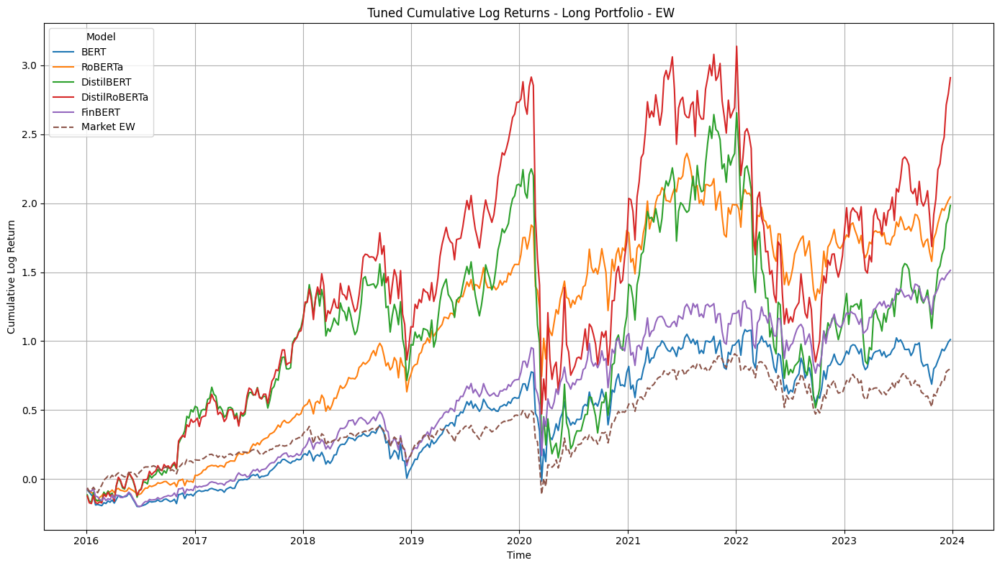

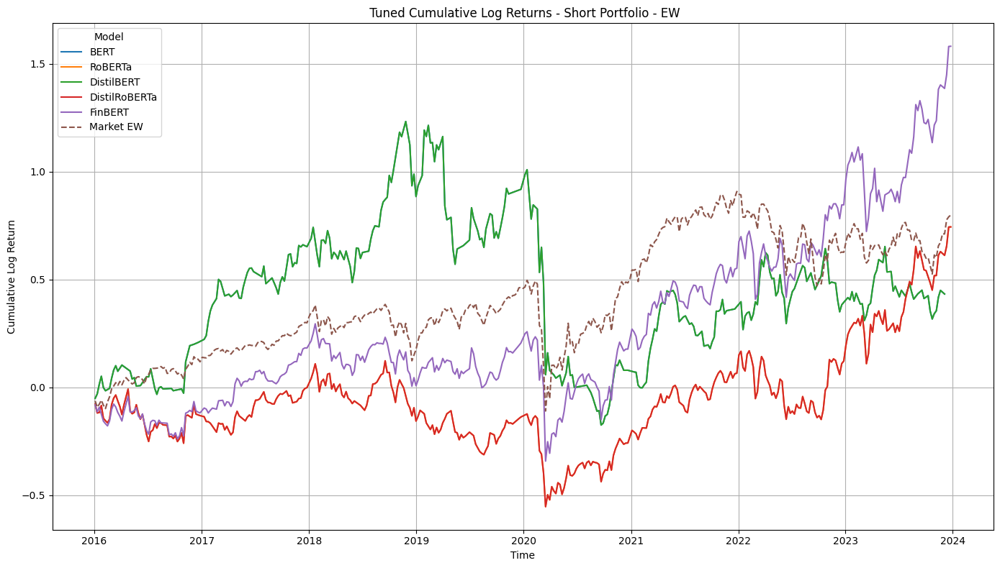

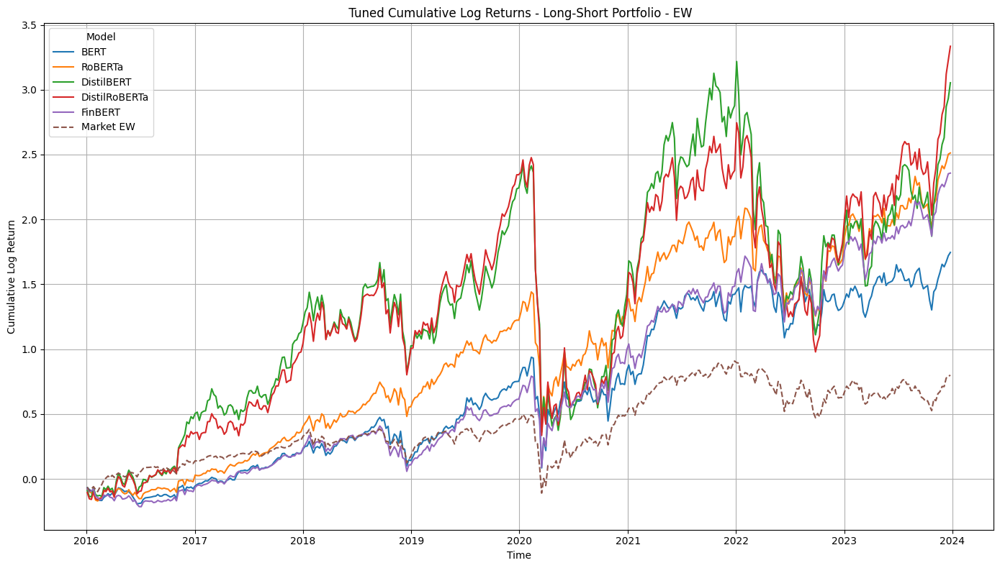

In [ ]:
# Define a function to plot cumulative returns
def plot_cumulative_returns(data, portfolio_type):
    plt.figure(figsize=(14, 8))

    sns.lineplot(data=data, x='start_date', y='cumulative_return', hue='model')

    sns.lineplot(
    data=weekly_market_data,
    x='start_date',
    y='cumulative_return',
    label='Market EW',
    linestyle='--'
)

    # Format x-axis to show years
    plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y'))
    plt.gca().xaxis.set_major_locator(mdates.YearLocator())

    plt.title(f' Tuned Cumulative Log Returns - {portfolio_type} Portfolio - EW')
    plt.xlabel('Time')
    plt.ylabel('Cumulative Log Return')
    plt.grid(True)
    plt.legend(title='Model', loc='best')
    plt.tight_layout()
    plt.show()

# Plot cumulative returns for each portfolio type - EW
plot_cumulative_returns(results_ew['long'], 'Long')
plot_cumulative_returns(results_ew['short'], 'Short')
plot_cumulative_returns(results_ew['long_short'], 'Long-Short')

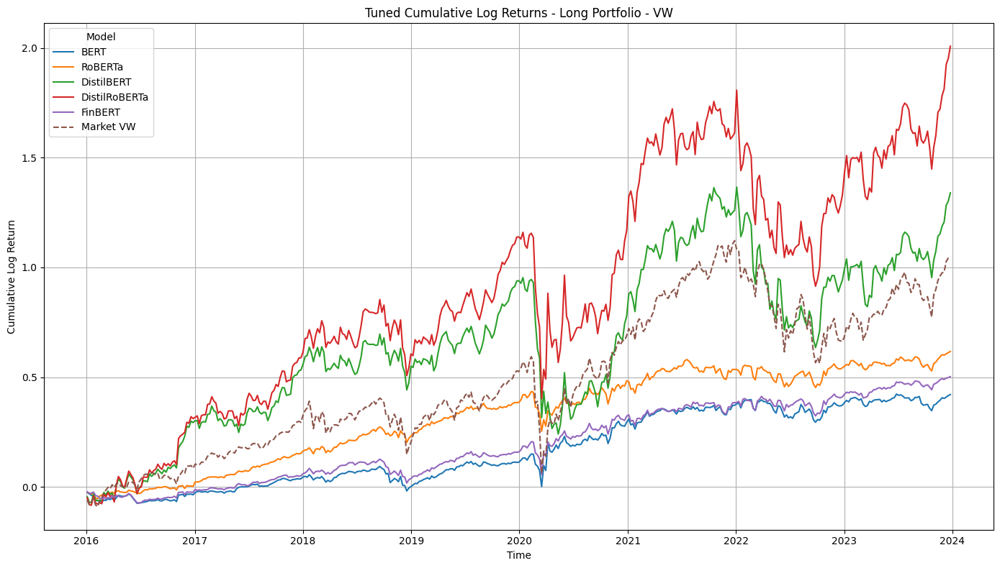

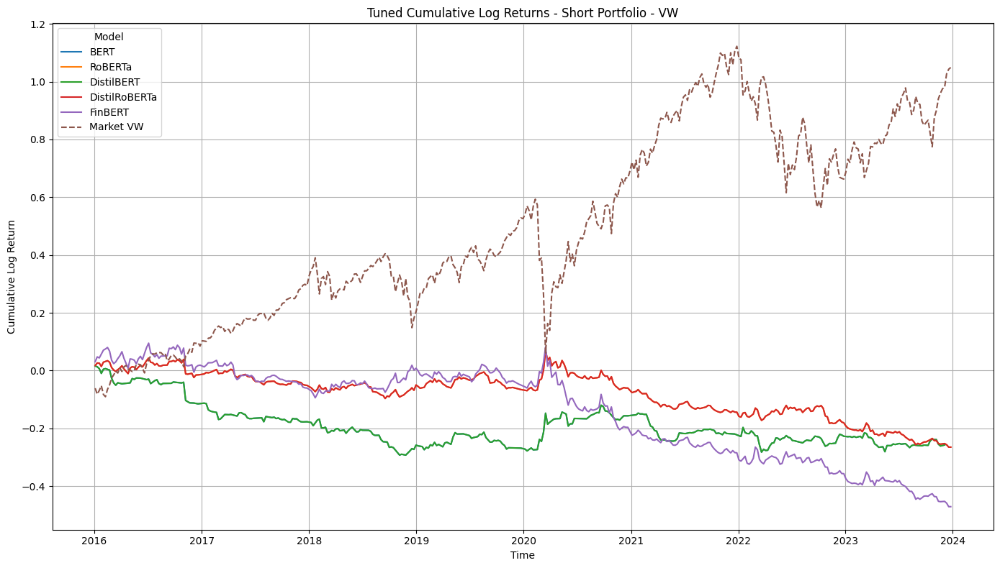

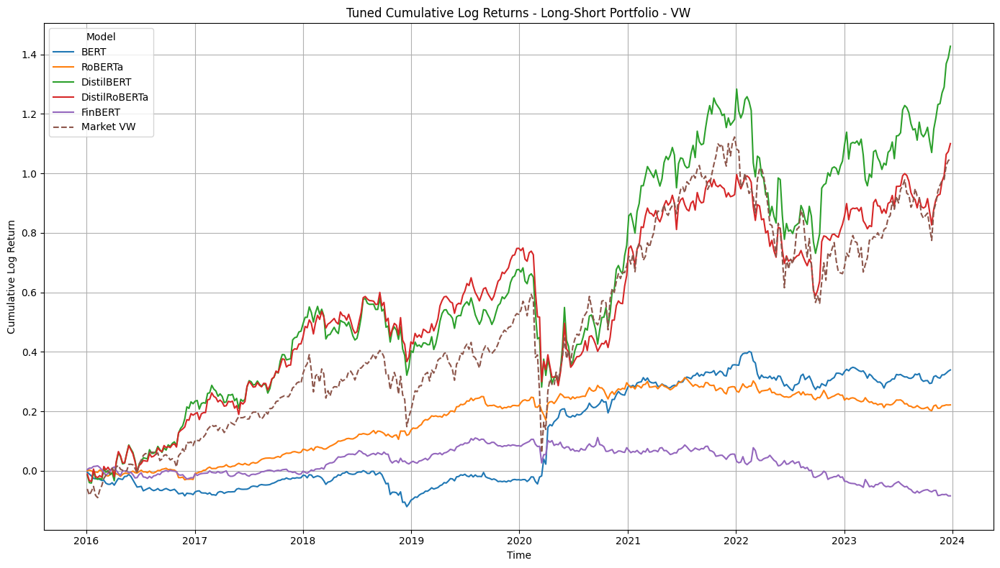

In [ ]:
# Define a function to plot cumulative returns
def plot_cumulative_returns(data, portfolio_type):
    plt.figure(figsize=(14, 8))

    sns.lineplot(data=data, x='start_date', y='cumulative_return', hue='model')

    # Plot market cumulative returns
    sns.lineplot(
    data=weekly_market_data,
    x='start_date',
    y='cumulative_returnVW',
    label='Market VW',
    linestyle='--'
    )

    # Format x-axis to show years
    plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y'))
    plt.gca().xaxis.set_major_locator(mdates.YearLocator())

    plt.title(f'Tuned Cumulative Log Returns - {portfolio_type} Portfolio - VW')
    plt.xlabel('Time')
    plt.ylabel('Cumulative Log Return')
    plt.grid(True)
    plt.legend(title='Model', loc='best')
    plt.tight_layout()
    plt.show()

# Plot cumulative returns for each portfolio type - VW
plot_cumulative_returns(results_vw['long'], 'Long')
plot_cumulative_returns(results_vw['short'], 'Short')
plot_cumulative_returns(results_vw['long_short'], 'Long-Short')

###Sharpe Ratios

In [ ]:
def calculate_sharpe_ratio(returns, risk_free_rate=0.0):
    excess_returns = returns - risk_free_rate
    return np.mean(excess_returns) / np.std(excess_returns) * np.sqrt(52)  # Assuming weekly data

def calculate_portfolio_metrics(long_portfolio_return, short_portfolio_return, long_short_portfolio_return):
    # Calculate Sharpe ratios
    sharpe_long = calculate_sharpe_ratio(long_portfolio_return['weighted_return'])
    sharpe_short = calculate_sharpe_ratio(short_portfolio_return['weighted_return'])
    sharpe_long_short = calculate_sharpe_ratio(long_short_portfolio_return['weighted_return'])

    # Calculate Portfolio Volatility (annualized)
    volatility_long = np.std(long_portfolio_return['weighted_return']) * np.sqrt(52)
    volatility_short = np.std(short_portfolio_return['weighted_return']) * np.sqrt(52)
    volatility_long_short = np.std(long_short_portfolio_return['weighted_return']) * np.sqrt(52)

    return {
        'Sharpe Ratio Long': sharpe_long,
        'Sharpe Ratio Short': sharpe_short,
        'Sharpe Ratio Long-Short': sharpe_long_short,
        'Volatility Long': volatility_long,
        'Volatility Short': volatility_short,
        'Volatility Long-Short': volatility_long_short
    }

Calculation of Portfolio Perfomance Metrics - Sharpe Ratios, Mean Excess returns, and Standard Deviation

In [ ]:
import pandas as pd
import numpy as np

# Define a function to calculate performance metrics
def calculate_performance_metrics(portfolio_returns):
    metrics = {}

    # Mean Return
    metrics['Mean Return'] = portfolio_returns['weighted_return'].mean()

    # Standard Deviation
    metrics['Standard Deviation'] = portfolio_returns['weighted_return'].std()

    # Sharpe Ratio
    metrics['Sharpe Ratio'] = calculate_sharpe_ratio(portfolio_returns['weighted_return'])

    return metrics

# Initialize a list to store results
results = []

# List of models and their paths
models = ['BERT', 'RoBERTa', 'DistilBERT', 'DistilRoBERTa', 'FinBERT']
paths = {
    'BERT': f'{base_path}/BM16_LLMs/Finance/results/fine-tuned/combined_score_BERT.csv',
    'RoBERTa': f'{base_path}/BM16_LLMs/Finance/results/fine-tuned/combined_score_RoBERTa.csv',
    'DistilBERT': f'{base_path}/BM16_LLMs/Finance/results/fine-tuned/combined_score_DistilBERT.csv',
    'DistilRoBERTa': f'{base_path}/BM16_LLMs/Finance/results/fine-tuned/combined_score_DistilRoBERTa.csv',
    'FinBERT': f'{base_path}/BM16_LLMs/Finance/results/fine-tuned/combined_score_FinBERT.csv'
}

for model in models:
    # Load data
    sentiment_data = pd.read_csv(paths[model])
    sentiment_data = sentiment_data.merge(permco_to_ticker, on='permco', how='left')

    # Create portfolios
    long_portfolio_eq, short_portfolio_eq, long_short_portfolio_eq = create_equal_weighted_portfolio(
        sentiment_data, out_sample_structured, scaling_factor, top_n, bottom_n
    )

    long_portfolio_vw, short_portfolio_vw, long_short_portfolio_vw = create_value_weighted_portfolio(
        sentiment_data, company_market_cap, out_sample_structured, scaling_factor, top_n, bottom_n
    )

    # Calculate metrics for Equal-Weighted portfolios
    eq_long_metrics = calculate_performance_metrics(long_portfolio_eq)
    eq_short_metrics = calculate_performance_metrics(short_portfolio_eq)
    eq_long_short_metrics = calculate_performance_metrics(long_short_portfolio_eq)

    # Calculate metrics for Value-Weighted portfolios
    vw_long_metrics = calculate_performance_metrics(long_portfolio_vw)
    vw_short_metrics = calculate_performance_metrics(short_portfolio_vw)
    vw_long_short_metrics = calculate_performance_metrics(long_short_portfolio_vw)

    # Combine metrics into a single row
    row = {
        'Model': model,
        'EW L Ret': eq_long_metrics['Mean Return'],
        'EW S Ret': eq_short_metrics['Mean Return'],
        'EW LS Ret': eq_long_short_metrics['Mean Return'],
        'VW L Ret': vw_long_metrics['Mean Return'],
        'VW S Ret': vw_short_metrics['Mean Return'],
        'VW LS Ret': vw_long_short_metrics['Mean Return'],
        'EW L Std': eq_long_metrics['Standard Deviation'],
        'EW S Std': eq_short_metrics['Standard Deviation'],
        'EW LS Std': eq_long_short_metrics['Standard Deviation'],
        'VW L Std': vw_long_metrics['Standard Deviation'],
        'VW S Std': vw_short_metrics['Standard Deviation'],
        'VW LS Std': vw_long_short_metrics['Standard Deviation'],
        'EW L SR': eq_long_metrics['Sharpe Ratio'],
        'EW S SR': eq_short_metrics['Sharpe Ratio'],
        'EW LS SR': eq_long_short_metrics['Sharpe Ratio'],
        'VW L SR': vw_long_metrics['Sharpe Ratio'],
        'VW S SR': vw_short_metrics['Sharpe Ratio'],
        'VW LS SR': vw_long_short_metrics['Sharpe Ratio'],
    }

    results.append(row)

# Create DataFrame from the results list
metrics_df = pd.DataFrame(results)

# Save the DataFrame to a CSV file if needed
# metrics_df.to_csv(f'{base_path}/BM16_LLMs/Finance/results/fine-tuned/portfolio_performance_metrics.csv', index=False)

# Print the DataFrame
metrics_df

    permco  sentiment_score ticker
1      137         0.587190    AIG
22   50700         0.585226     MA
0       90         0.575060   AEXP
    permco  sentiment_score ticker
22   50700         0.589894     MA
23   52983         0.587110      V
0       90         0.580124   AEXP
    permco  sentiment_score ticker
1      137         0.594145    AIG
23   52983         0.574338      V
7    20436         0.574088    CHL
    permco  sentiment_score ticker
0       90         0.580156   AEXP
22   50700         0.578436     MA
7    20436         0.577682    CHL
    permco  sentiment_score ticker
10   21224         0.999996     MS
22   50700         0.647973     MA
23   52983         0.604391      V


,Model,EW L Ret,EW S Ret,EW LS Ret,VW L Ret,VW S Ret,VW LS Ret,EW L Std,EW S Std,EW LS Std,VW L Std,VW S Std,VW LS Std,EW L SR,EW S SR,EW LS SR,VW L SR,VW S SR,VW LS SR
0,BERT,0.003222,0.002488,0.003535,0.001014,-0.002784,0.000100,0.039300,0.043583,0.037590,0.013052,0.042944,0.013083,0.591947,0.412505,0.679020,0.561040,-0.468459,0.055086
1,RoBERTa,0.003850,0.003432,0.004181,0.001277,-0.000686,0.000520,0.033515,0.044396,0.033655,0.010600,0.010220,0.006338,0.829456,0.558086,0.896882,0.869967,-0.484404,0.592220
2,DistilBERT,0.006268,0.003099,0.006503,0.002870,-0.000748,0.002661,0.059189,0.043312,0.054926,0.028648,0.013979,0.023038,0.764619,0.516707,0.854724,0.723226,-0.386393,0.833975
3,DistilRoBERTa,0.007118,0.003432,0.006595,0.003803,-0.000686,0.002194,0.062431,0.044396,0.054465,0.034677,0.010220,0.020189,0.823180,0.558086,0.874232,0.791782,-0.484404,0.784604
4,FinBERT,0.003890,0.004139,0.004639,0.002023,-0.001362,0.000303,0.034112,0.040584,0.032502,0.016192,0.015344,0.010689,0.823346,0.736292,1.030401,0.902034,-0.641045,0.204459


#Step 8: Portfolio Analysis: Transaction Costs

In [ ]:
market_cap_data_tc = pd.read_csv(f'{base_path}/BM16_LLMs/Finance/data/crsp_2016-2023.csv', dtype={'PRC': 'str', 'SHROUT': 'str'},on_bad_lines='skip')

In [ ]:
# market_cap_data_tc = pd.read_csv("/content/drive/MyDrive/PostGrad/Projects/Transaction Cost/crsp_2016-2023.csv", dtype={'PRC': 'str', 'SHROUT': 'str'},
#                               on_bad_lines='skip')

In [ ]:
market_cap_data_tc

,PERMNO,date,EXCHCD,TICKER,PERMCO,PRC,SHROUT,CFACPR,CFACSHR
0,10001,2016-01-04,2.0,EGAS,7953,7.52000,10505,1.0,1.0
1,10001,2016-01-05,2.0,EGAS,7953,7.42000,10505,1.0,1.0
2,10001,2016-01-06,2.0,EGAS,7953,7.53000,10505,1.0,1.0
3,10001,2016-01-07,2.0,EGAS,7953,7.64000,10505,1.0,1.0
4,10001,2016-01-08,2.0,EGAS,7953,7.79000,10505,1.0,1.0
...,...,...,...,...,...,...,...,...,...
16319688,93436,2023-12-22,3.0,TSLA,53453,252.53999,3178921,1.0,1.0
16319689,93436,2023-12-26,3.0,TSLA,53453,256.60999,3178921,1.0,1.0
16319690,93436,2023-12-27,3.0,TSLA,53453,261.44000,3178921,1.0,1.0
16319691,93436,2023-12-28,3.0,TSLA,53453,253.17999,3178921,1.0,1.0


In [ ]:
df2 = out_sample_structured

In [ ]:
# Convert PRC and SHROUT to numeric, forcing errors to NaN
market_cap_data_tc['PRC'] = pd.to_numeric(market_cap_data_tc['PRC'], errors='coerce')
market_cap_data_tc['SHROUT'] = pd.to_numeric(market_cap_data_tc['SHROUT'], errors='coerce')

# Drop rows where PRC or SHROUT couldn't be converted to numbers
market_cap_data_tc.dropna(subset=['PRC', 'SHROUT'], inplace=True)

# Filter for NYSE stocks (EXCHCD == 1)
market_cap_data_tc = market_cap_data_tc[market_cap_data_tc['EXCHCD'] == 1]

# Handle the date column and ensure consistency
market_cap_data_tc['date'] = pd.to_datetime(market_cap_data_tc['date'], errors='coerce')
market_cap_data_tc['date'] = market_cap_data_tc['date'].dt.tz_localize(None)
market_cap_data_tc.dropna(subset=['date'], inplace=True)

# Calculate Market Cap
market_cap_data_tc['Market_Cap'] = market_cap_data_tc['PRC'] * market_cap_data_tc['SHROUT']

# Create a list of permnos to filter
permno_list = [
    47896, 38703, 59408, 70519, 17778, 66800, 83443, 36469, 88239, 82654,
    15054, 86868, 92611, 59176, 92655, 83835, 66157, 52919, 89428, 69032,
    89199, 91233, 87842, 87212, 49656, 49680, 81284, 51043, 89179, 89258
]

# Filter market_cap_data based on permno list
filtered_market_cap_data = market_cap_data_tc[market_cap_data_tc['PERMNO'].isin(permno_list)]

# Classify Stocks Based on Market Cap
filtered_market_cap_data['Classification'] = filtered_market_cap_data.groupby('date')['Market_Cap'].transform(
    lambda x: np.where(x >= x.median(), 'Large', 'Small')
)

# Rename TICKER to Ticker
filtered_market_cap_data.rename(columns={'TICKER': 'Ticker'}, inplace=True)

In [ ]:
filtered_market_cap_data

,PERMNO,date,EXCHCD,Ticker,PERMCO,PRC,SHROUT,CFACPR,CFACSHR,Market_Cap,Classification
2981977,15054,2016-01-04,1.0,UBS,55100,19.13000,3758844.0,1.0,1.0,7.190669e+07,Small
2981978,15054,2016-01-05,1.0,UBS,55100,19.02000,3758844.0,1.0,1.0,7.149321e+07,Small
2981979,15054,2016-01-06,1.0,UBS,55100,18.78000,3758844.0,1.0,1.0,7.059109e+07,Small
2981980,15054,2016-01-07,1.0,UBS,55100,18.30000,3758844.0,1.0,1.0,6.878685e+07,Small
2981981,15054,2016-01-08,1.0,UBS,55100,17.37000,3758844.0,1.0,1.0,6.529112e+07,Small
...,...,...,...,...,...,...,...,...,...,...,...
15590600,92655,2023-12-22,1.0,UNH,7267,520.31000,924925.0,1.0,1.0,4.812477e+08,Large
15590601,92655,2023-12-26,1.0,UNH,7267,520.03003,924925.0,1.0,1.0,4.809888e+08,Large
15590602,92655,2023-12-27,1.0,UNH,7267,522.78998,924925.0,1.0,1.0,4.835415e+08,Large
15590603,92655,2023-12-28,1.0,UNH,7267,524.90002,924925.0,1.0,1.0,4.854932e+08,Large


In [ ]:
# Ensure 'start_date' and 'date' are in the same format for merging
df2['start_date'] = pd.to_datetime(df2['start_date'], errors='coerce').dt.tz_localize(None)
filtered_market_cap_data['date'] = pd.to_datetime(filtered_market_cap_data['date'], errors='coerce').dt.tz_localize(None)

In [ ]:
# Merge `updated_out_sample` with the filtered market cap data on 'ticker' and 'start_date'/'date'
merged_df = pd.merge(df2, filtered_market_cap_data[['PERMCO', 'date', 'Ticker', 'Market_Cap', 'Classification']],
                     left_on=['permco', 'start_date'],
                     right_on=['PERMCO', 'date'],
                     how='left')

In [ ]:
merged_df

,permco,ticker,start_date,end_date,announcedate,weekly_ret,adj_prc,headline,direction,PERMCO,date,Ticker,Market_Cap,Classification
0,90,AEXP,2016-01-04,2016-01-08,NaT,-8.099980,63.63,No_Headlines,Up,90.0,2016-01-04,AXP,66525187.14,Small
1,90,AEXP,2016-01-11,2016-01-15,2016-01-05,-1.131492,62.91,"American Express Company, Q4 2015 Earnings Cal...",Down,90.0,2016-01-11,AXP,63040956.30,Small
2,90,AEXP,2016-01-11,2016-01-15,2016-01-05,-1.131492,62.91,"American Express Company to Report Q4, 2015 Re...",Down,90.0,2016-01-11,AXP,63040956.30,Small
3,90,AEXP,2016-01-11,2016-01-15,2016-01-07,-1.131492,62.91,"Keefe, Bruyette, & Woods, Inc., Keefe, Bruyett...",Down,90.0,2016-01-11,AXP,63040956.30,Small
4,90,AEXP,2016-01-18,2016-01-22,2016-01-13,-12.478209,55.06,"William Blair & Company, L.L.C., the William B...",Down,NaN,NaT,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
47121,55100,UBS,2023-12-25,2023-12-29,2023-12-17,0.032307,30.90,CRH plc (NYSE:CRH) agreed to acquire 57% stake...,Up,NaN,NaT,NaN,NaN,NaN
47122,55100,UBS,2023-12-25,2023-12-29,2023-12-17,0.032307,30.90,CRH plc (NYSE:CRH) agreed to acquire 57.3% sta...,Up,NaN,NaT,NaN,NaN,NaN
47123,55100,UBS,2023-12-25,2023-12-29,2023-12-18,0.032307,30.90,"Ledman Optoelectronic Co., Ltd. announced that...",Up,NaN,NaT,NaN,NaN,NaN
47124,55100,UBS,2023-12-25,2023-12-29,2023-12-19,0.032307,30.90,UBS Reportedly Wants to Sell Loans That Credit...,Up,NaN,NaT,NaN,NaN,NaN


In [ ]:
unique_tickers = merged_df['ticker'].unique()
unique_tickers

array(['AEXP', 'AIG', 'BRK', 'USB', 'BAC', 'UNH', 'BK', 'CHL', 'C', 'DHR',
       'MS', 'NOB', 'BMO', 'RY', 'TD', 'GS', 'MFC', 'MET', 'ANTM', 'DB',
       'PRU', 'BNS', 'MA', 'V', 'UBS'], dtype=object)

In [ ]:
import pandas as pd
import numpy as np

# Adjust Returns with Transaction Costs
def adjust_returns(row, large_cap_cost=11.21, small_cap_cost=21.27):
    if row['Classification'] == 'Large':
        cost = large_cap_cost
    elif row['Classification'] == 'Small':
        cost = small_cap_cost
    else:
        return np.nan  # If classification is missing, return NaN

    return row['weekly_ret'] - abs(row['weekly_ret'] * cost * 0.0001)

merged_df['return_with_txn_cost'] = merged_df.apply(adjust_returns, axis=1)

# Drop the Ticker and date columns from the merged DataFrame
merged_df.drop(columns=['Ticker', 'date', 'PERMCO', 'Market_Cap'], inplace=True)

Calculation of EW and VW portfolios based on top and bottom stocks - with transaction cost

In [ ]:
import pandas as pd
import numpy as np
import warnings
warnings.filterwarnings('ignore')

# Function to sort sentiment data and return top/bottom stocks
def get_top_bottom_stocks(sentiment_data, top_n=3, bottom_n=3):
    sorted_data = sentiment_data.sort_values(by='sentiment_score', ascending=False)
    top_stocks = sorted_data.head(top_n)
    bottom_stocks = sorted_data.tail(bottom_n)
    return top_stocks, bottom_stocks

def create_equal_weighted_portfolio(sentiment_data, out_sample_structured, scaling_factor=0.01, top_n=3, bottom_n=2):
    # Get top and bottom stocks based on sentiment scores
    top_stocks, bottom_stocks = get_top_bottom_stocks(sentiment_data, top_n, bottom_n)
    print(top_stocks)

    # Long portfolio (top N stocks)
    long_portfolio = out_sample_structured[out_sample_structured['ticker'].isin(top_stocks['ticker'])]
    long_portfolio['weight'] = 1 / top_n
    #long_portfolio['weighted_return'] = long_portfolio['weekly_ret'] * long_portfolio['weight'] * scaling_factor
    long_portfolio['weighted_return'] = long_portfolio['return_with_txn_cost'] * scaling_factor

    # Short portfolio (bottom N stocks)
    short_portfolio = out_sample_structured[out_sample_structured['ticker'].isin(bottom_stocks['ticker'])]
    short_portfolio['weight'] = -1 / bottom_n  # Shorting means negative weight
    #short_portfolio['weighted_return'] = short_portfolio['weekly_ret'] * short_portfolio['weight'] * scaling_factor
    short_portfolio['weighted_return'] = short_portfolio['return_with_txn_cost'] * scaling_factor

    # Long-Short portfolio (combine long and short portfolios)
    long_short_portfolio = pd.concat([long_portfolio, short_portfolio])

    # Aggregate returns by date for each portfolio
    long_portfolio_return = long_portfolio.groupby('start_date')['weighted_return'].mean().reset_index()
    short_portfolio_return = short_portfolio.groupby('start_date')['weighted_return'].mean().reset_index()
    long_short_portfolio_return = long_short_portfolio.groupby('start_date')['weighted_return'].mean().reset_index()

    # Calculate log returns and cumulative returns for each portfolio
    for df in [long_portfolio_return, short_portfolio_return, long_short_portfolio_return]:
        df['log_return'] = np.log(1 + df['weighted_return'])
        df['cumulative_return'] = (1 + df['log_return']).cumprod() - 1

    return long_portfolio_return, short_portfolio_return, long_short_portfolio_return

# Function to create value-weighted portfolios
def create_value_weighted_portfolio(sentiment_data, market_cap_data,out_sample_structured,scaling_factor=0.01, top_n=3, bottom_n=2):
    top_stocks, bottom_stocks = get_top_bottom_stocks(sentiment_data, top_n, bottom_n)

    # Long portfolio (top N stocks)
    long_market_caps = market_cap_data[market_cap_data['ticker'].isin(top_stocks['ticker'])]
    total_market_cap_long = long_market_caps['market_cap'].sum()
    long_market_caps['weight'] = long_market_caps['market_cap'] / total_market_cap_long

    long_portfolio = out_sample_structured[out_sample_structured['ticker'].isin(long_market_caps['ticker'])]
    long_portfolio = pd.merge(long_portfolio, long_market_caps[['ticker', 'weight']], on='ticker')
    long_portfolio['weighted_return'] = long_portfolio['return_with_txn_cost'] * long_portfolio['weight'] * scaling_factor

    # Short portfolio (bottom N stocks)
    short_market_caps = market_cap_data[market_cap_data['ticker'].isin(bottom_stocks['ticker'])]
    total_market_cap_short = short_market_caps['market_cap'].sum()
    short_market_caps['weight'] = short_market_caps['market_cap'] / total_market_cap_short

    short_portfolio = out_sample_structured[out_sample_structured['ticker'].isin(short_market_caps['ticker'])]
    short_portfolio = pd.merge(short_portfolio, short_market_caps[['ticker', 'weight']], on='ticker')
    short_portfolio['weight'] = -short_portfolio['weight']  # Shorting means negative weight
    short_portfolio['weighted_return'] = short_portfolio['return_with_txn_cost'] * short_portfolio['weight'] * scaling_factor

    # Long-Short portfolio
    long_short_portfolio = pd.concat([long_portfolio, short_portfolio])

    # Aggregate returns by date
    long_portfolio_return = long_portfolio.groupby('start_date')['weighted_return'].mean().reset_index()
    short_portfolio_return = short_portfolio.groupby('start_date')['weighted_return'].mean().reset_index()
    long_short_portfolio_return = long_short_portfolio.groupby('start_date')['weighted_return'].mean().reset_index()

    # Calculate log returns and cumulative returns
    for df in [long_portfolio_return, short_portfolio_return, long_short_portfolio_return]:
        df['log_return'] = np.log(1 + df['weighted_return'])
        df['cumulative_return'] = (1 + df['log_return']).cumprod() - 1

    return long_portfolio_return, short_portfolio_return, long_short_portfolio_return

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.dates as mdates

# Define paths and model names
models = ['BERT', 'RoBERTa', 'DistilBERT', 'DistilRoBERTa', 'FinBERT']
paths = {
    'BERT': f'{base_path}/BM16_LLMs/Finance/results/fine-tuned/combined_score_BERT.csv',
    'RoBERTa': f'{base_path}/BM16_LLMs/Finance/results/fine-tuned/combined_score_RoBERTa.csv',
    'DistilBERT': f'{base_path}/BM16_LLMs/Finance/results/fine-tuned/combined_score_DistilBERT.csv',
    'DistilRoBERTa': f'{base_path}/BM16_LLMs/Finance/results/fine-tuned/combined_score_DistilRoBERTa.csv',
    'FinBERT': f'{base_path}/BM16_LLMs/Finance/results/fine-tuned/combined_score_FinBERT.csv'
}


# Initialize dictionaries to store results
results_ew = {
    'long': pd.DataFrame(),
    'short': pd.DataFrame(),
    'long_short': pd.DataFrame()
}


results_vw = {
    'long': pd.DataFrame(),
    'short': pd.DataFrame(),
    'long_short': pd.DataFrame()
}

# Define scaling factor and top/bottom N
scaling_factor = 0.01
top_n = 3
bottom_n = 2

# Loop through each model and process
for model in models:
    # Load data
    sentiment_data = pd.read_csv(paths[model])
    sentiment_data = sentiment_data[sentiment_data['permco'] != 21224]
    sentiment_data = sentiment_data.merge(permco_to_ticker, on='permco', how='left')

    # Create equal-weighted portfolios
    long_portfolio_eq, short_portfolio_eq, long_short_portfolio_eq = create_equal_weighted_portfolio(
        sentiment_data, merged_df, scaling_factor, top_n, bottom_n
    )

    # Create value-weighted portfolios
    long_portfolio_vw, short_portfolio_vw, long_short_portfolio_vw = create_value_weighted_portfolio(
        sentiment_data, company_market_cap, merged_df, scaling_factor, top_n, bottom_n
    )

    # Add model column for identifying in plots
    long_portfolio_eq['model'] = model
    short_portfolio_eq['model'] = model
    long_short_portfolio_eq['model'] = model

    # Add model column for identifying in plots
    long_portfolio_vw['model'] = model
    short_portfolio_vw['model'] = model
    long_short_portfolio_vw['model'] = model

    # Append to results
    results_ew['long'] = pd.concat([results_ew['long'], long_portfolio_eq], ignore_index=True)
    results_ew['short'] = pd.concat([results_ew['short'], short_portfolio_eq], ignore_index=True)
    results_ew['long_short'] = pd.concat([results_ew['long_short'], long_short_portfolio_eq], ignore_index=True)

    # Append to results
    results_vw['long'] = pd.concat([results_vw['long'], long_portfolio_vw], ignore_index=True)
    results_vw['short'] = pd.concat([results_vw['short'], short_portfolio_vw], ignore_index=True)
    results_vw['long_short'] = pd.concat([results_vw['long_short'], long_short_portfolio_vw], ignore_index=True)

    permco  sentiment_score ticker
1      137         0.587190    AIG
21   50700         0.585226     MA
0       90         0.575060   AEXP
    permco  sentiment_score ticker
21   50700         0.589894     MA
22   52983         0.587110      V
0       90         0.580124   AEXP
    permco  sentiment_score ticker
1      137         0.594145    AIG
22   52983         0.574338      V
7    20436         0.574088    CHL
    permco  sentiment_score ticker
0       90         0.580156   AEXP
21   50700         0.578436     MA
7    20436         0.577682    CHL
    permco  sentiment_score ticker
21   50700         0.647973     MA
22   52983         0.604391      V
1      137         0.589885    AIG


##visualization - Transaction Costs

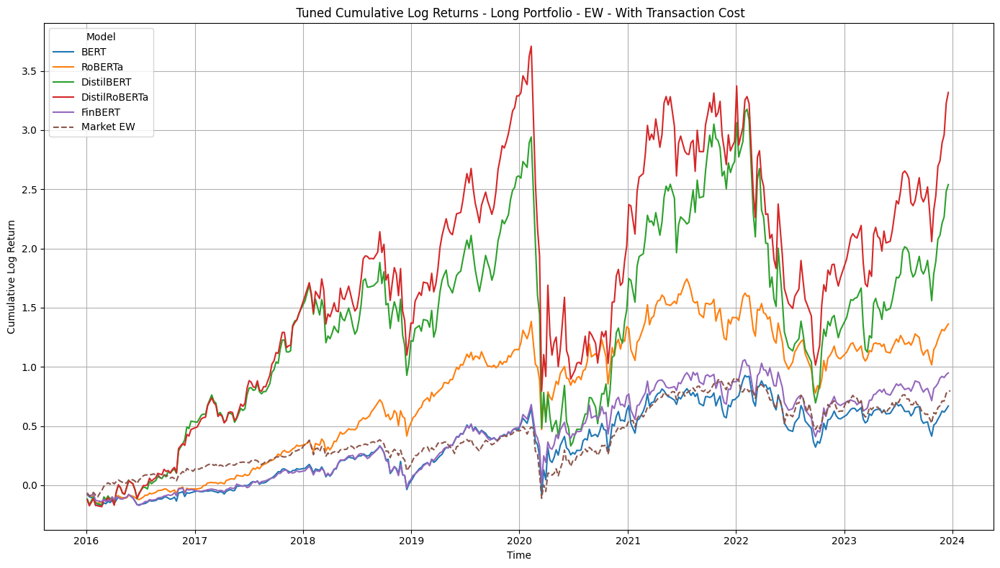

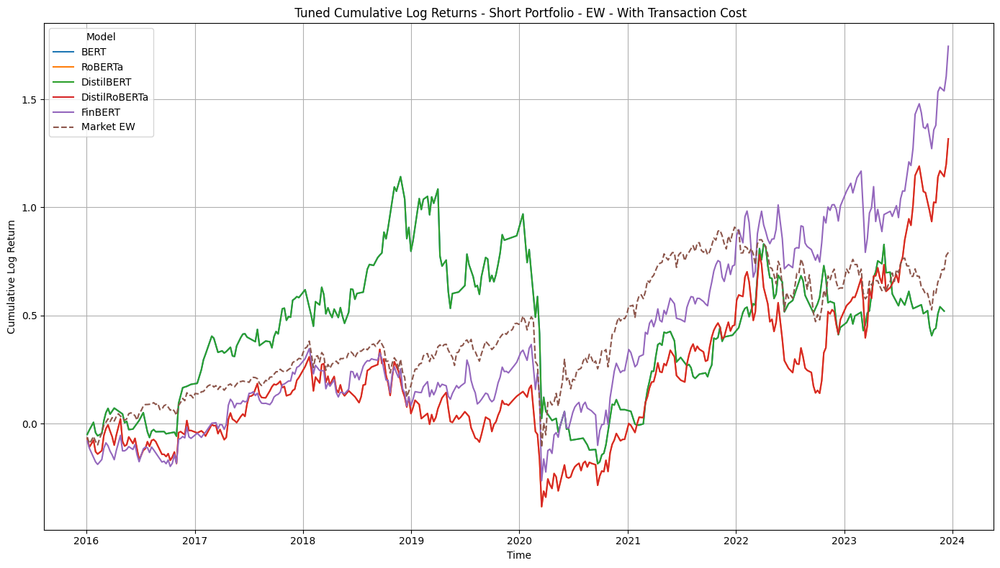

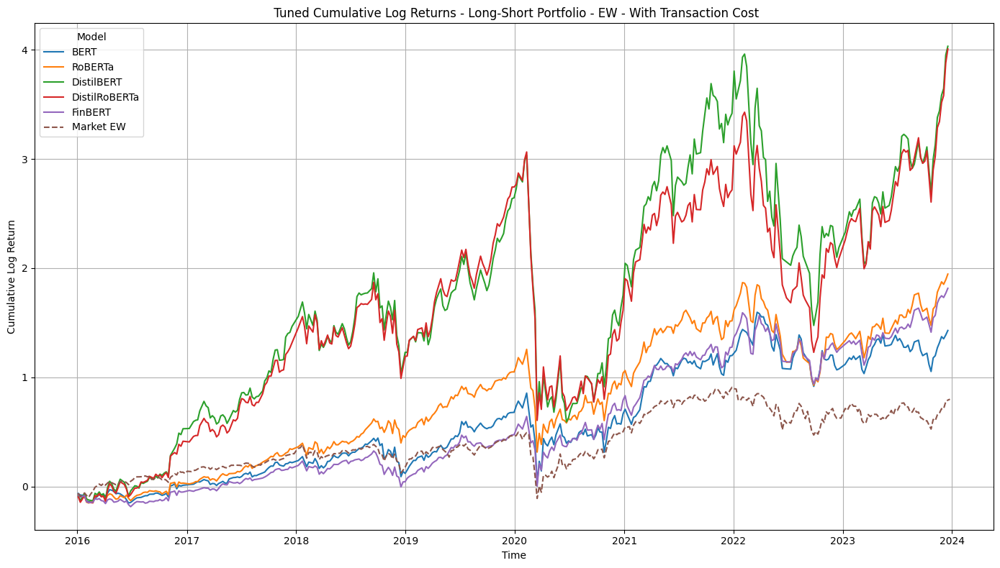

In [ ]:
# Define a function to plot cumulative returns
def plot_cumulative_returns(data, portfolio_type):
    plt.figure(figsize=(14, 8))

    sns.lineplot(data=data, x='start_date', y='cumulative_return', hue='model')

    sns.lineplot(
    data=weekly_market_data,
    x='start_date',
    y='cumulative_return',
    label='Market EW',
    linestyle='--'
)

    # Format x-axis to show years
    plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y'))
    plt.gca().xaxis.set_major_locator(mdates.YearLocator())

    plt.title(f' Tuned Cumulative Log Returns - {portfolio_type} Portfolio - EW - With Transaction Cost')
    plt.xlabel('Time')
    plt.ylabel('Cumulative Log Return')
    plt.grid(True)
    plt.legend(title='Model', loc='best')
    plt.tight_layout()
    plt.show()

# Plot cumulative returns for each portfolio type - EW
plot_cumulative_returns(results_ew['long'], 'Long')
plot_cumulative_returns(results_ew['short'], 'Short')
plot_cumulative_returns(results_ew['long_short'], 'Long-Short')

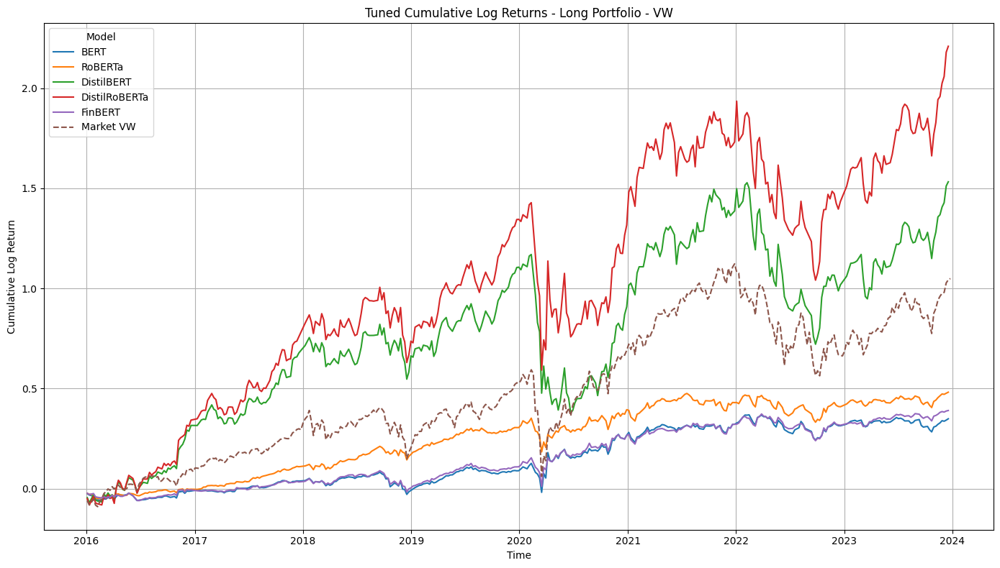

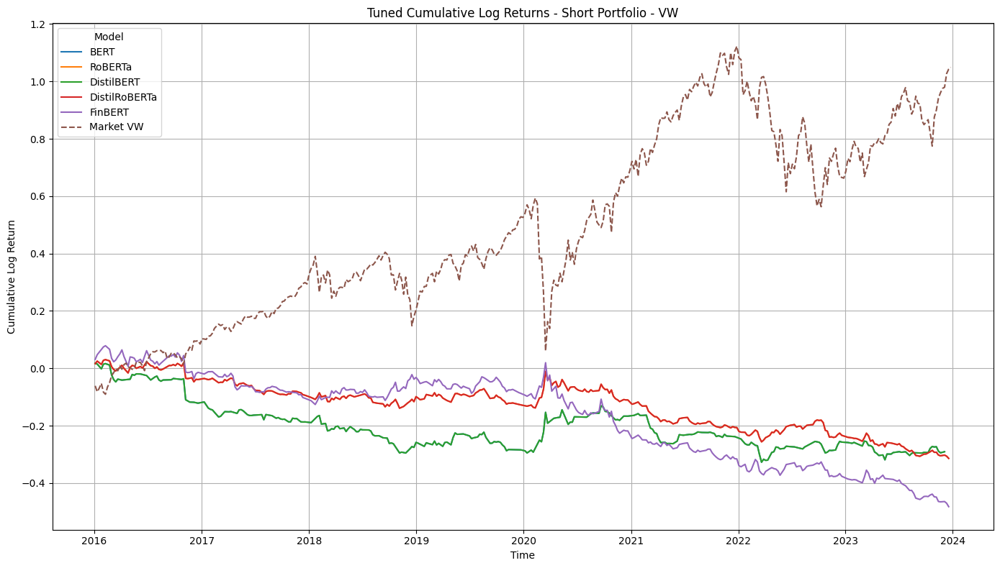

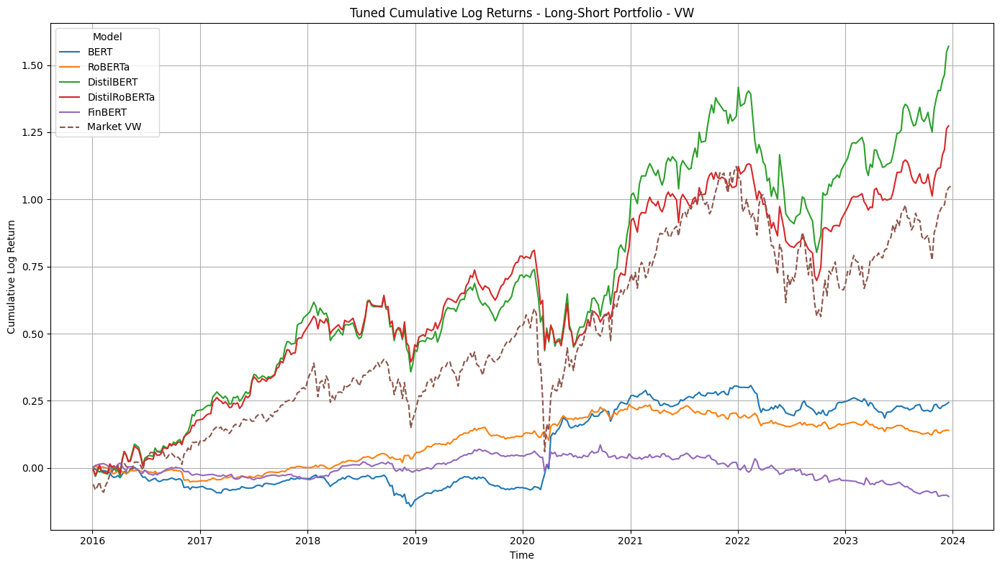

In [ ]:
# Define a function to plot cumulative returns
def plot_cumulative_returns(data, portfolio_type):
    plt.figure(figsize=(14, 8))

    sns.lineplot(data=data, x='start_date', y='cumulative_return', hue='model')

    # Plot market cumulative returns
    sns.lineplot(
    data=weekly_market_data,
    x='start_date',
    y='cumulative_returnVW',
    label='Market VW',
    linestyle='--'
    )

    # Format x-axis to show years
    plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y'))
    plt.gca().xaxis.set_major_locator(mdates.YearLocator())

    plt.title(f'Tuned Cumulative Log Returns - {portfolio_type} Portfolio - VW')
    plt.xlabel('Time')
    plt.ylabel('Cumulative Log Return')
    plt.grid(True)
    plt.legend(title='Model', loc='best')
    plt.tight_layout()
    plt.show()

# Plot cumulative returns for each portfolio type - VW
plot_cumulative_returns(results_vw['long'], 'Long')
plot_cumulative_returns(results_vw['short'], 'Short')
plot_cumulative_returns(results_vw['long_short'], 'Long-Short')

##Sharpe Ratios - Transaction Costs

Calculation of Portfolio Perfomance Metrics - Sharpe Ratios, Mean Excess returns, and Standard Deviation

In [ ]:
def calculate_sharpe_ratio(returns, risk_free_rate=0.0):
    excess_returns = returns - risk_free_rate
    return np.mean(excess_returns) / np.std(excess_returns) * np.sqrt(52)  # Assuming weekly data

def calculate_portfolio_metrics(long_portfolio_return, short_portfolio_return, long_short_portfolio_return):
    # Calculate Sharpe ratios
    sharpe_long = calculate_sharpe_ratio(long_portfolio_return['weighted_return'])
    sharpe_short = calculate_sharpe_ratio(short_portfolio_return['weighted_return'])
    sharpe_long_short = calculate_sharpe_ratio(long_short_portfolio_return['weighted_return'])

    # Calculate Portfolio Volatility (annualized)
    volatility_long = np.std(long_portfolio_return['weighted_return']) * np.sqrt(52)
    volatility_short = np.std(short_portfolio_return['weighted_return']) * np.sqrt(52)
    volatility_long_short = np.std(long_short_portfolio_return['weighted_return']) * np.sqrt(52)

    return {
        'Sharpe Ratio Long': sharpe_long,
        'Sharpe Ratio Short': sharpe_short,
        'Sharpe Ratio Long-Short': sharpe_long_short,
        'Volatility Long': volatility_long,
        'Volatility Short': volatility_short,
        'Volatility Long-Short': volatility_long_short
    }

In [ ]:
import pandas as pd
import numpy as np

# Define a function to calculate performance metrics
def calculate_performance_metrics(portfolio_returns):
    metrics = {}

    # Mean Return
    metrics['Mean Return'] = portfolio_returns['weighted_return'].mean()

    # Standard Deviation
    metrics['Standard Deviation'] = portfolio_returns['weighted_return'].std()

    # Sharpe Ratio
    metrics['Sharpe Ratio'] = calculate_sharpe_ratio(portfolio_returns['weighted_return'])

    return metrics

# Initialize a list to store results
results = []

# List of models and their paths
models = ['BERT', 'RoBERTa', 'DistilBERT', 'DistilRoBERTa', 'FinBERT']
paths = {
    'BERT': f'{base_path}/BM16_LLMs/Finance/results/fine-tuned/combined_score_BERT.csv',
    'RoBERTa': f'{base_path}/BM16_LLMs/Finance/results/fine-tuned/combined_score_RoBERTa.csv',
    'DistilBERT': f'{base_path}/BM16_LLMs/Finance/results/fine-tuned/combined_score_DistilBERT.csv',
    'DistilRoBERTa': f'{base_path}/BM16_LLMs/Finance/results/fine-tuned/combined_score_DistilRoBERTa.csv',
    'FinBERT': f'{base_path}/BM16_LLMs/Finance/results/fine-tuned/combined_score_FinBERT.csv'
}

for model in models:
    # Load data
    sentiment_data = pd.read_csv(paths[model])
    sentiment_data = sentiment_data.merge(permco_to_ticker, on='permco', how='left')

    # Create portfolios
    long_portfolio_eq, short_portfolio_eq, long_short_portfolio_eq = create_equal_weighted_portfolio(
        sentiment_data, merged_df, scaling_factor, top_n, bottom_n
    )

    long_portfolio_vw, short_portfolio_vw, long_short_portfolio_vw = create_value_weighted_portfolio(
        sentiment_data, company_market_cap, merged_df, scaling_factor, top_n, bottom_n
    )

    # Calculate metrics for Equal-Weighted portfolios
    eq_long_metrics = calculate_performance_metrics(long_portfolio_eq)
    eq_short_metrics = calculate_performance_metrics(short_portfolio_eq)
    eq_long_short_metrics = calculate_performance_metrics(long_short_portfolio_eq)

    # Calculate metrics for Value-Weighted portfolios
    vw_long_metrics = calculate_performance_metrics(long_portfolio_vw)
    vw_short_metrics = calculate_performance_metrics(short_portfolio_vw)
    vw_long_short_metrics = calculate_performance_metrics(long_short_portfolio_vw)

    # Combine metrics into a single row
    row = {
        'Model': model,
        'EW L Ret': eq_long_metrics['Mean Return'],
        'EW S Ret': eq_short_metrics['Mean Return'],
        'EW LS Ret': eq_long_short_metrics['Mean Return'],
        'VW L Ret': vw_long_metrics['Mean Return'],
        'VW S Ret': vw_short_metrics['Mean Return'],
        'VW LS Ret': vw_long_short_metrics['Mean Return'],
        'EW L Std': eq_long_metrics['Standard Deviation'],
        'EW S Std': eq_short_metrics['Standard Deviation'],
        'EW LS Std': eq_long_short_metrics['Standard Deviation'],
        'VW L Std': vw_long_metrics['Standard Deviation'],
        'VW S Std': vw_short_metrics['Standard Deviation'],
        'VW LS Std': vw_long_short_metrics['Standard Deviation'],
        'EW L SR': eq_long_metrics['Sharpe Ratio'],
        'EW S SR': eq_short_metrics['Sharpe Ratio'],
        'EW LS SR': eq_long_short_metrics['Sharpe Ratio'],
        'VW L SR': vw_long_metrics['Sharpe Ratio'],
        'VW S SR': vw_short_metrics['Sharpe Ratio'],
        'VW LS SR': vw_long_short_metrics['Sharpe Ratio'],
    }

    results.append(row)

# Create DataFrame from the results list
metrics_df = pd.DataFrame(results)

# Save the DataFrame to a CSV file if needed
#metrics_df.to_csv(f'{base_path}/BM16_LLMs/Finance/results/fine-tuned/portfolio_performance_metrics_txncost.csv', index=False)

# Print the DataFrame
metrics_df

    permco  sentiment_score ticker
1      137         0.587190    AIG
22   50700         0.585226     MA
0       90         0.575060   AEXP
    permco  sentiment_score ticker
22   50700         0.589894     MA
23   52983         0.587110      V
0       90         0.580124   AEXP
    permco  sentiment_score ticker
1      137         0.594145    AIG
23   52983         0.574338      V
7    20436         0.574088    CHL
    permco  sentiment_score ticker
0       90         0.580156   AEXP
22   50700         0.578436     MA
7    20436         0.577682    CHL
    permco  sentiment_score ticker
10   21224         0.999996     MS
22   50700         0.647973     MA
23   52983         0.604391      V


,Model,EW L Ret,EW S Ret,EW LS Ret,VW L Ret,VW S Ret,VW LS Ret,EW L Std,EW S Std,EW LS Std,VW L Std,VW S Std,VW LS Std,EW L SR,EW S SR,EW LS SR,VW L SR,VW S SR,VW LS SR
0,BERT,0.003061,0.002590,0.003524,0.000990,-0.002921,-0.000013,0.041099,0.044799,0.039253,0.013659,0.044100,0.013583,0.537869,0.417753,0.648269,0.523452,-0.478736,-0.006886
1,RoBERTa,0.003569,0.004528,0.004166,0.001184,-0.000957,0.000396,0.034849,0.045657,0.035076,0.011005,0.010920,0.006668,0.739508,0.716229,0.857685,0.777054,-0.632828,0.429338
2,DistilBERT,0.007208,0.003602,0.007536,0.003357,-0.000963,0.003006,0.060425,0.045267,0.055333,0.029191,0.015693,0.021713,0.861372,0.574802,0.983422,0.830402,-0.443213,0.999679
3,DistilRoBERTa,0.008005,0.004528,0.007508,0.004352,-0.000957,0.002575,0.064253,0.045657,0.055374,0.035612,0.010920,0.019184,0.899627,0.716229,0.979005,0.882495,-0.632828,0.969382
4,FinBERT,0.003409,0.004691,0.004506,0.001796,-0.001594,0.000126,0.035314,0.041643,0.033401,0.016726,0.015692,0.010898,0.697130,0.813394,0.974180,0.775383,-0.733608,0.083194
